# Euclid Grizli Pipeline using grizli 1.6.0 (2023.0217)

### Euclid Parameters and Requirements
https://sci.esa.int/web/euclid/-/euclid-nisp-instrument

https://www.euclid.caltech.edu/page/technical-details

### Wide Survey Imaging
(20,000 deg^2 = 2pi sr)

RIZ <= 24.5 AB (10 sigma, extended source)

YJH <= 24 AB (5 sigma)

### Deep Survey Imaging
(40 deg^2)

RIZ <= 26.5 AB (10 sigma)

YJH <= 26 AB (5 sigma)


https://sci.esa.int/c/portal/doc.cfm?fobjectid=46064

https://www.euclid.caltech.edu/page/62

https://ui.adsabs.harvard.edu/abs/2022A%26A...662A.112E/abstract

# Table of Contents

1. Setup
    1. [Import Python modules](#Import-Python-modules)
    2. [Install templates for redshift fitting](#Install-templates-for-redshift-fitting)
    3. [Python Helper Functions](#Python-Helper-Functions) 
    4. [Path to my simulation directories](#Path-to-my-simulation-directories)
2. [Find sources in the direct image](#Find-sources-in-the-direct-image)
3. [Read SExtractor Photometry of Direct Images](#Read-SExtractor-Photometry-of-Direct-Images)
4. [Euclid object simulation](#Euclid-object-simulation)
5. [Check simulation](#Check-simulation)
6. [Show direct images and slitless spectra](#Show-direct-images-and-slitless-spectra)
7. [Loop over all objects and fit their redshifts](#Loop-over-all-objects-and-fit-their-redshifts)
8. [Inspect Redshift Fitting Results](#Inspect-Redshift-Fitting-Results)
9. [Extract a single 2D spectrum](#Extract-a-single-2D-spectrum)
10. [1D Spectral Extraction](#1D-Spectral-Extraction)
11. [Display Redshift Fit](#Display-Redshift-Fit)

Appendix - Old
1. [aXeSIM predictions based on conf file](#aXeSIM-predictions-based-on-conf-file)
2. [Show 2D beam](#Show-2D-beam)
3. [Simple SN calculations based on the spcontetc](#Simple-SN-calculations-based-on-the-spcontetc)
4. [Simple SN calculations based on the pzcaletc](#Simple-SN-calculations-based-on-the-pzcaletc)
5. [Simple SN calculations based on the apttables2021](#Simple-SN-calculations-based-on-the-apttables2021)
6. [Roman and Euclid Sensitivity Function](#Roman-and-Euclid-Sensitivity-Function)
7. [Velocity resolution](#Velocity-resolution)
8. [Fit redshift to source](#Fit-redshift-to-source)
9. [Coordinates Check](#Coordinates-check)
10. [SED Check](#SED-check)

[top](#Table-of-Contents)

# Setup

In [1]:
%matplotlib inline

## Import Python modules
[top](#Table-of-Contents)

In [2]:
import grizli_functions
#from grizli_functions import wcs_pixel_scale, check_sims, create_circular_mask
from grizli_functions import wcs_pixel_scale, check_sims

# import jwst failure is ok!

`import jwst` failed so JWST processing will not work!



An error occurred (ExpiredToken) when calling the ListObjectsV2 operation: The provided token has expired.


In [ ]:
# Only use if you are editing the Python code while running the Jupyter notebook.
import importlib
importlib.reload(grizli_functions)

In [3]:
import os, sys, time
from collections import OrderedDict

import matplotlib as mpl    
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

from IPython.display import Image

mpl.rcParams['figure.figsize'] = (10.0, 6.0)
mpl.rcParams['font.size'] = 14
mpl.rcParams['savefig.dpi'] = 72

import numpy as np
#from math import cos, sin, atan2, pi
from math import sqrt, log

import astropy
import astropy.io.fits as pyfits
import astropy.wcs as pywcs
from astropy.table import Table, join
from astropy.modeling import models

import drizzlepac
import photutils

import grizli
import grizli.model
import grizli.multifit
from grizli import utils, multifit, fitting
import grizli.fake_image
from grizli.pipeline import auto_script
from grizli import prep

print('\n Python version: ', sys.version)
print('\n Grizli version: ', grizli.__version__)
print('\n Astropy version: ', astropy.__version__)



The following task in the stsci.skypac package can be run with TEAL:
                                    skymatch                                    
The following tasks in the drizzlepac package can be run with TEAL:
    astrodrizzle       config_testbed      imagefindpars           mapreg       
       photeq            pixreplace           pixtopix            pixtosky      
  refimagefindpars       resetbits          runastrodriz          skytopix      
     tweakback            tweakreg           updatenpol

 Python version:  3.9.13 (main, Aug 25 2022, 18:24:45) 
[Clang 12.0.0 ]

 Grizli version:  1.6.0.dev42

 Astropy version:  5.1


In [ ]:
# check versions

# matplotlib
# IPython
# numpy
# astropy
# drizzlepac
# photutils
# grizli

## Install templates for redshift fitting
[top](#Table-of-Contents)

Run only once for the install

#### WFC3 and ACS calibs

In [ ]:
grizli.utils.fetch_default_calibs()

#### WFC3 PSF and Pickles stars

In [ ]:
grizli.utils.fetch_config_files()

#### Templates used in fitting

In [ ]:
grizli.utils.symlink_templates(force=False)

# Python Helper Functions
[top](#Table-of-Contents)

These will eventually be replaced by grizli_functions library

In [ ]:
def display_grizli(root, id, w0=0.8, w1=1.7, labels=1, y0=-1, y1=-1):
    
    # constants
    fontsize = 8
    #y0 = -1e-18
    #y1 = 3.5e-18
    lw = 2
    

    f_full = '{0}_{1:05d}.full.fits'.format(root, id)
    #print(f_full)
    full_hdu = pyfits.open(f_full)
    #print(full_hdu.info())
    head = full_hdu[0].header
    zfit_stack = Table(full_hdu['ZFIT_STACK'].data)
    zfit_head = full_hdu['ZFIT_STACK'].header
    templ = Table(full_hdu['TEMPL'].data)
    print()
    
    #print(head)
    ndfilts = head["NDFILT"] # number of direct image filters
    for i in range(ndfilts):
        print(head["DFILT%02d" % (i+1)])
        
        direct = full_hdu[5+(2*i)].data
        #print(direct)
        #print(direct.shape)    
    
    #head["REDSHIFT"] # redshift
    #head["NUMLINES"] # number of emission lines
    

    f_1d = '{0}_{1:05d}.1D.fits'.format(root, id)
    #print(f_1d)
    oned_hdu = pyfits.open(f_1d)
    #print(oned_hdu[1].header)
    print(oned_hdu.info())
    grism = Table(oned_hdu['RED'].data)
    grism.show_in_notebook()
    print(grism.colnames)
    #print()
    
    
    
    f_2d = '{0}_{1:05d}.stack.fits'.format(root, id)
    #print(f_2d)
    twod_hdu = pyfits.open(f_2d)
    #print(twod_hdu.info())
    #print()

    
    fig = plt.figure(figsize=(12,10))
    #           row column
    gs = GridSpec(3, 4, hspace=0.4)

    p1 = fig.add_subplot(gs[:1, 0:2])
    p2 = fig.add_subplot(gs[:1, 2:])
    p3 = fig.add_subplot(gs[1, :])
    p4 = fig.add_subplot(gs[2, :])


    # Z_MAP, CHIMIN and DOF
    
    p1.text(0.95, 0.96, root + '\n'+'ID={0:<5d}  z={1:.4f}'.format(id, zfit_head['z_map']), ha='right', va='top', transform=p1.transAxes, fontsize=9)

    zmi, zma = zfit_stack['zgrid'].min(), zfit_stack['zgrid'].max()
    if (zma-zmi) > 5:
        ticks = np.arange(np.ceil(zmi), np.floor(zma)+0.5, 1)
        lz = np.log(1+zfit_stack['zgrid'])
        p1.plot(lz, np.log10(zfit_stack['pdf']), color='k')
        p1.set_xticks(np.log(1+ticks))
        p1.set_xticklabels(np.cast[int](ticks))
        p1.set_xlim(lz.min(), lz.max())
    else:
        p1.plot(zfit_stack['zgrid'], np.log10(zfit_stack['pdf']), color='k')
        p1.set_xlim(zmi, zma)

    p1.set_xlabel(r'$z$')
    p1.set_ylabel(r'$\log\ p(z)$'+' / '+ r'$\chi^2=\frac{{{0:.0f}}}{{{1:d}}}={2:.2f}$'.format(zfit_head['chimin'], zfit_head['DoF'], zfit_head['chimin']/zfit_head['DoF']))
    p1.set_yticks([1,4,9,16,25])

    pzmax = np.log10(zfit_stack['pdf'].max())
    p1.set_ylim(pzmax-6, pzmax+0.9)
    p1.grid()
    p1.yaxis.set_major_locator(MultipleLocator(base=1))
    
    
    
    #pz_max = np.log10(zfit_stack['pdf'].max())
    
    #p1.plot(zfit_stack['zgrid'], np.log10(zfit_stack['pdf']), label='Stacked')
    #p1.set_xlim(0.0, 3); 
    ##p1.semilogy(); 
    #p1.grid()
    ##p1.set_ylim(1.e-50, 1e4)
    #p1.set_ylim(pz_max-6, pz_max+0.9)
    #p1.set_xlabel('z'); p1.set_ylabel('PDF(z)'); #plt.legend()

    p2.plot(zfit_stack['zgrid'], zfit_stack['risk'], label='Stacked')
    p2.set_xlim(0.0, 3); p2.semilogy(); p2.grid()
    p2.set_xlabel('z'); p2.set_ylabel('risk'); #p3.legend()
    
    #print('Continuum template, cont1d: ', templ['continuum'].__class__)
    #print(templ.colnames)
    
    
    if y0 < 0: y0 = np.min(templ['continuum'] + templ['full'])
    if y1 < 0: y1 = np.max(templ['continuum'] + templ['full'])
    
    
    p3.plot(templ['wave']/1.e4, templ['continuum'], label='continuum')
    p3.plot(templ['wave']/1.e4, templ['full'], label='total')
    p3.set_xlim(w0, w1); p3.set_ylim(y0,y1);#p3.set_ylim(0,1.e-17) 
    p3.grid()
    p3.set_xlabel(r'$\lambda$ (microns)')
    p3.set_ylabel(r'F$_\lambda$ (erg/s/cm$^2$/$\AA$)')
    #p3.legend()
    
    
        
    z0 = zfit_head['z_map']

    for line,wemit in emlines:
        wobs = (1+z0)*wemit
        #FWHM = vel * wobs / c_km
        if wobs/1e4 > w0 and wobs/1e4 < w1:

            p4.plot([wobs/1e4,wobs/1e4],[y0,y1],":",lw=lw,c="b")
        
            if labels:
                p4.text(wobs/1e4,0.7*y1,line,fontsize=fontsize,
                        rotation='vertical',
                        horizontalalignment='center',
                        verticalalignment='center')
    
        
        
    p4.errorbar(grism['wave']/1e4, grism['flux']/grism['flat'], yerr=grism["err"]/grism['flat'], 
                color="g", marker='.', linestyle='None', alpha=0.5) 
                
    p4.plot(grism['wave']/1e4, grism['line']/grism['flat'], color="r", alpha=0.5)  
    
    p4.plot(grism['wave']/1e4, grism['contam']/grism['flat'], color="b", alpha=0.5)
    
    p4.set_xlim(w0, w1); p4.set_ylim(y0,y1);
    #p4.semilogy(); 
    p4.grid()
    p4.set_xlabel(r'$\lambda$ (microns)')
    p4.set_ylabel(r'F$_\lambda$ (erg/s/cm$^2$/$\AA$)')
    
    # Gabe's routine
    multifit.show_drizzle_HDU(twod_hdu)
    

In [4]:
def add_noise(hdu, scale=1.0, background=0.5, exptime=1.e4, nexp=10, readnoise=10., seed=None):

    head = hdu['SCI'].header
    naxis = (head['NAXIS1'], head['NAXIS2'])

    # Simple error model of read noise and sky background
    var = nexp*readnoise**2 + background*exptime

    # electrons / s
    rms = np.sqrt(var)/exptime

    poisson = hdu['ERR'].data*exptime

    hdu['ERR'].data = np.sqrt(poisson**2 + var)/exptime


    for name in ['SCI', 'ERR', 'DQ']:
        hdu[name].header['EXPTIME'] = exptime
        hdu[name].header['NEXP'] = nexp
        hdu[name].header['BUNIT'] = 'ELECTRONS/S'
        hdu[name].header['BACKGR'] = background
        hdu[name].header['CALCRMS'] = rms, 'Variance used for random noise'

    if seed is not None:
        np.random.seed(seed)
        hdu['ERR'].header['SEED'] = seed, 'Random seed'

    hdu['SCI'].data *= scale
    hdu['SCI'].data += np.random.normal(size=np.array(naxis).T)*rms

    return hdu

def add_noise2(hdu, background=0.5, exptime=1.e4, readnoise=10., seed=None):
    # background [e-/s]
    # readnoise [e-]

    head = hdu['SCI'].header
    naxis = (head['NAXIS1'], head['NAXIS2'])
    
    # N_src  # count rate from src [e-/s]
    # N_sky  # count rate from sky [e-/s]
    # N_dark # dark current
    # N_RN   # readnoise
    # t      # exposure time
    # npix   # number of pixels in aperture
    
    # signal = N_src*t
    # noise = np.sqrt(N_src*t + npix*(N_sky*t + N_dark*t + N_RN**2))
    
    for name in ['SCI', 'ERR', 'DQ']:
        hdu[name].header['EXPTIME'] = exptime
        #hdu[name].header['NEXP'] = nexp
        hdu[name].header['BUNIT'] = 'ELECTRONS/S'
        hdu[name].header['BACKGR'] = background
        #hdu[name].header['CALCRMS'] = rms, 'Variance used for random noise'

    if seed is not None:
        np.random.seed(seed)
        hdu['ERR'].header['SEED'] = seed, 'Random seed'
    
    signal = hdu['SCI'].data                                    # [e-]
    noise = np.sqrt(signal*exptime + background*exptime + readnoise**2) # [e-]
    #noise = signal + background*exptime + readnoise**2 # [e-]
    #noise = np.sqrt(background*exptime + readnoise**2)         # [e-]
    
    hdu['ERR'].data = noise/exptime # [e-/s]
    
    total_signal = np.random.poisson(lam=noise, size=noise.shape).astype("float64") # [e-]
    #total_signal = signal + noise
    final_signal = total_signal/exptime # [e-/s]

    hdu['SCI'].data = final_signal

    
    return hdu

def fake_noise(hdu, rms, exptime=1.e4):
    
    head = hdu['SCI'].header
    naxis = (head['NAXIS1'], head['NAXIS2'])
    
    signal = hdu['SCI'].data # [e-] very close to the counts
    
    noise = np.random.normal(size=np.array(naxis).T)*rms # [e-/s]

    hdu['ERR'].data = noise
    hdu['SCI'].data = signal/exptime+noise
    
    return hdu

In [5]:
emlines = [["OVI",         1038.0],         # 0
           ["Ly$\\alpha$", 1215.67],        # 1
           ["CIV",     1550.0],             # 2
           ["CIII]",   1909.],              # 3
           ["CII]",    2327.],              # 4
           ["MgII",    2796.4],             # 5
           ["MgII",    2803.5],             # 6
           ["NeV",     3326.],              # 7
           ["[OII]",   3727.],  # O2        # 8
           ["[NeIII]", 3868.7],             # 9
           ["H$\gamma$",  4340.5],  # Hg    # 10
           ["[OIII]",  4363.0],  # O31      # 11
           ["H$\\beta$",   4861.3],  # Hb   # 12
           ["[OIII]",  4959.0],  # O32      # 13
           ["[OIII]",  5007.0],  # O33      # 14
           ["[NII]",   6548.1],             # 15
           ["H$\\alpha$",  6562.8],  # Ha   # 16
           ["[NII]",   6583.0],             # 17
           ["[SII]",   6717.0],             # 18
           ["[SII]",   6731.0],             # 19
           ["P$\\delta$", 10049.8],  # Pd   # 20
           ["P$\\gamma$", 10938.0],  # Pg   # 21
           ["P$\\beta$",  12818.1],  # Pb   # 22
           ["P$\\alpha$", 18750.1],  # Pa   # 23 
           ["Br$\\delta$", 19440.0],  # Br-d (wikipedia, not exact)
           ["Br$\\gamma$", 21660.0],  # Br-g (wikipedia, not exact)
           ["Br$\\beta$",  26250.0],  # Br-b (wikipedia, not exact)
           ["Br$\\alpha$", 40510.0],  # Br-a (wikipedia, not exact) 
          ]

# http://hyperphysics.phy-astr.gsu.edu/hbase/Tables/hydspec.html
# http://articles.adsabs.harvard.edu//full/1934ApJ....80...19M/0000022.000.html


## (TESTING) Reload Core Grizli Python Functions - SKIP

Only use if you are editing the Python code while running the Jupyter notebook.

In [ ]:
import importlib
importlib.reload(grizli.grismconf)

In [ ]:
import importlib
importlib.reload(grizli.pipeline.auto_script)

In [ ]:
import importlib
importlib.reload(grizli.model)

In [ ]:
import importlib
importlib.reload(grizli.multifit)

In [ ]:
import importlib
importlib.reload(grizli.fitting)

In [ ]:
import importlib
importlib.reload(grizli.utils)

## Path to my simulation directories
[top](#Table-of-Contents)

In [6]:
#os.chdir('../')
os.chdir('/Users/gwalth/data/Roman/grizli/sims/')
#os.chdir('/local/RomanSims/grizli/sims/') # cygnusd
HOME_PATH = os.getcwd()
print('HOME_PATH = ', HOME_PATH)
root = "Euclid"

HOME_PATH =  /Users/gwalth/data/Roman/grizli/sims


## Directory Structure

I was structing it similar to Grizli with Prep, RAW and Extraction directories.  If this were real mission data, the stage that we recieved from Anihita would have been drizzled images and spectra which would go into the Prep directories.

This is just showing that we have the right directories and we can find all of the files.

In [7]:
# Clean
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

!rm *_direct.fits
!rm *_slitless.fits
!rm *_wcs.fits
!rm *_final*.fits
!rm *_final.cat
!rm Euclid_GrismFLT.pickle

In [8]:
import glob

os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
slitless_files = glob.glob('EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits')
slitless_files.sort()
print(slitless_files)
print(len(slitless_files))

#slitless = slitless_files[0]

['EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits']
1


## Write individual files for each extension of the slitless spectra
Grizli is easier to manage when writing out all of the files.  At some point we'll want to read the data extensions directly into Grizli, this is currently a kludge.

In [9]:
all_det = []

for i in range(0,4): 
    for j in range(0,4):
        print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)
        det = 'DET%s' % (num)       
        all_det.append(det)
           
print(all_det)

1 1
1 2
1 3
1 4
2 1
2 2
2 3
2 4
3 1
3 2
3 3
3 4
4 1
4 2
4 3
4 4
['DET11', 'DET12', 'DET13', 'DET14', 'DET21', 'DET22', 'DET23', 'DET24', 'DET31', 'DET32', 'DET33', 'DET34', 'DET41', 'DET42', 'DET43', 'DET44']


In [10]:
# Loops through all detectors

hdu_old = pyfits.open(slitless_files[0])
print(hdu_old.info())

# for now dq is ones
dq = np.ones((2048,2048)) 

all_slitless = []

for i in range(0,4): 
    for j in range(0,4):
        #print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)
        #det = 'DET' + num
        
        #conf_file = 'NISP-GLWv2-DET%s' % (num)
        slitless = "Euclid_DET%s_slitless.fits"  % (num)
        #print(conf_file)
        print(slitless)
        
        all_slitless.append(slitless)

        # test to read conf_file in grismconf.py
        #det = conf_file.split("-")[-1][-2:]
        #print(det)
        
        head = hdu_old['DET%s.SCI' % (num)].header
        data = hdu_old['DET%s.SCI' % (num)].data
        err = hdu_old['DET%s.CHI2' % (num)].data
        

        hdu = pyfits.PrimaryHDU(header=head)  
        hdu.name = 'PRIMARY'
    
        hdu_sci = pyfits.ImageHDU(data,header=head)  
        hdu_sci.name = 'SCI'
        hdu_err = pyfits.ImageHDU(err,header=head)
        hdu_err.name = 'ERR'
        hdu_dq = pyfits.ImageHDU(dq,header=head)
        hdu_dq.name = 'DQ'

        hdu1 = pyfits.HDUList([hdu,hdu_sci,hdu_err,hdu_dq])
        hdu1.writeto(slitless, overwrite=True)
        hdu1.info()

        #hdu[ext].header['INSTRUME'] = 'NISP-DET%i%i-GLWv2' % (i+1,j+1)


Filename: EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      60   ()      
  1  DET11.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  DET11.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  3  DET21.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  4  DET21.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  5  DET31.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  6  DET31.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  7  DET41.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  8  DET41.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  9  DET12.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
 10  DET12.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
 11  DET22.SCI     1 ImageHDU        31   (2048,

Euclid_DET44_slitless.fits
Filename: (No file associated with this HDUList)
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        29   (2048, 2048)   uint16   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   


In [11]:
print(all_slitless)

['Euclid_DET11_slitless.fits', 'Euclid_DET12_slitless.fits', 'Euclid_DET13_slitless.fits', 'Euclid_DET14_slitless.fits', 'Euclid_DET21_slitless.fits', 'Euclid_DET22_slitless.fits', 'Euclid_DET23_slitless.fits', 'Euclid_DET24_slitless.fits', 'Euclid_DET31_slitless.fits', 'Euclid_DET32_slitless.fits', 'Euclid_DET33_slitless.fits', 'Euclid_DET34_slitless.fits', 'Euclid_DET41_slitless.fits', 'Euclid_DET42_slitless.fits', 'Euclid_DET43_slitless.fits', 'Euclid_DET44_slitless.fits']


## Plot the slitless extensions

SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                   16 / number of bits per data pixel                  NAXIS   =                    0 / number of data axes                            EXTEND  =                    T / FITS dataset may contain extensions            COMMENT   FITS (Flexible Image Transport System) format is defined in 'AstronomyCOMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H FITS_DEF= 'le1.sirRawImage'                                                     FITS_VER= '0.2     '                                                            TELESCOP= 'EUCLID  '                                                            INSTRUME= 'NISP    '                                                            VERSION = 'TEST_SC8_NIS_S1'                                                     DATE    = '2022-09-13T23:01:54.142Z'                                            ORIGIN  = 'OU-SIM  '                    

(2048, 2048)
DET11.SCI
228.39419187752
6.5903912393221
4578.75045083333
4331.37522541667

(2048, 2048)
DET12.SCI
228.39419187752
6.5903912393221
4578.75045083333
2126.45840847222

(2048, 2048)
DET13.SCI
228.39419187752
6.5903912393221
4578.75045083333
-78.4584084722222

(2048, 2048)
DET14.SCI
228.39419187752
6.5903912393221
4578.75045083333
-2283.37522541667

(2048, 2048)
DET21.SCI
228.39419187752
6.5903912393221
2208.91681694444
4331.37522541667

(2048, 2048)
DET22.SCI
228.39419187752
6.5903912393221
2208.91681694444
2126.45840847222

(2048, 2048)
DET23.SCI
228.39419187752
6.5903912393221
2208.91681694444
-78.4584084722222

(2048, 2048)
DET24.SCI
228.39419187752
6.5903912393221
2208.91681694444
-2283.37522541667

(2048, 2048)
DET31.SCI
228.39419187752
6.5903912393221
-160.916816944444
4331.37522541667

(2048, 2048)
DET32.SCI
228.39419187752
6.5903912393221
-160.916816944444
2126.45840847222

(2048, 2048)
DET33.SCI
228.39419187752
6.5903912393221
-160.916816944444
-78.4584084722222

(2

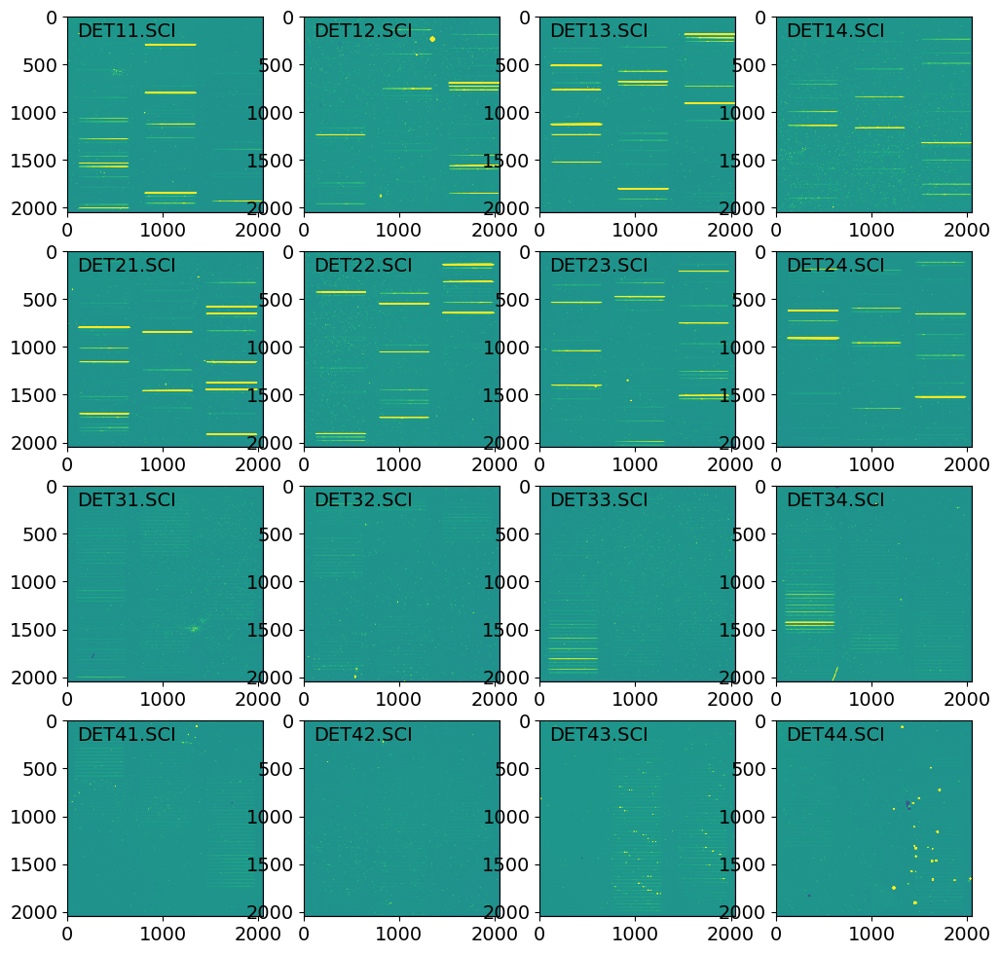

In [12]:
hdu = pyfits.open(slitless_files[0])
print(hdu[0].header)
hdu.info()

fig = plt.figure(figsize=(12,12))

k = 0
for i in range(0,4): 
    for j in range(0,4):
        #print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)
        name = 'DET%s.SCI' % (num)
        #name = 'DET%i%i.CHI2' % (i+1,j+1)
        
        img = hdu[name].data
        print(img.shape)
        head = hdu[name].header
        print(name)
        print(head['CRVAL1'])
        print(head['CRVAL2'])
        print(head['CRPIX1'])
        print(head['CRPIX2'])
        
        #print(np.min(img))
        #print(np.max(img))
        #print(np.mean(img))
        #print(np.median(img))
        #print(np.std(img))
        #print()
        #print(hdu[name].header)
        print()

        
        p = fig.add_subplot(4,4,k+1)
        p.imshow(img,vmin=200,vmax=3000)
        
        p.text(0.05,0.9,name,transform=p.transAxes)
        #p.hist(img.flatten(), bins=100)
        #p.set_yscale("log")
        
        k += 1
        
plt.show()




## Plot the image coordinates of the detectors relative to each other

SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                   16 / number of bits per data pixel                  NAXIS   =                    0 / number of data axes                            EXTEND  =                    T / FITS dataset may contain extensions            COMMENT   FITS (Flexible Image Transport System) format is defined in 'AstronomyCOMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H FITS_DEF= 'le1.sirRawImage'                                                     FITS_VER= '0.2     '                                                            TELESCOP= 'EUCLID  '                                                            INSTRUME= 'NISP    '                                                            VERSION = 'TEST_SC8_NIS_S1'                                                     DATE    = '2022-09-13T23:01:54.142Z'                                            ORIGIN  = 'OU-SIM  '                    

XTENSION= 'IMAGE   '           / IMAGE extension                                BITPIX  =                   16 / number of bits per data pixel                  NAXIS   =                    2 / number of data axes                            NAXIS1  =                 2048 / length of data axis 1                          NAXIS2  =                 2048 / length of data axis 2                          PCOUNT  =                    0 / required keyword; must = 0                     GCOUNT  =                    1 / required keyword; must = 1                     BZERO   =                32768 / offset data range to that of unsigned short    BSCALE  =                    1 / default scaling factor                         EXTNAME = 'DET11.SCI'                                                           CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =     4578.75045083333          

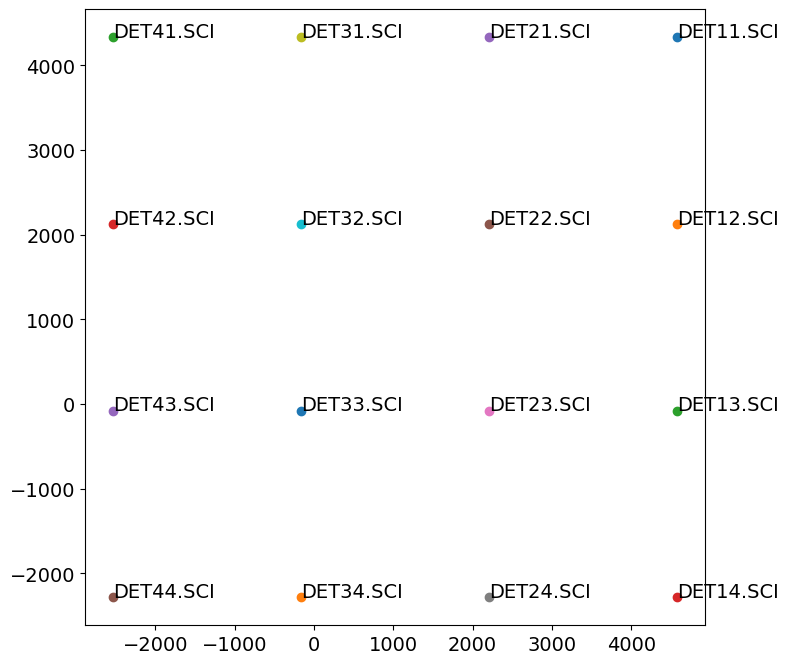

In [13]:
hdu = pyfits.open(slitless_files[0])
print(hdu[0].header)

spec_exptime = hdu[0].header['exptime']
hdu.info()

fig = plt.figure(figsize=(8,8))
p = fig.add_subplot(111)

heads = {}

for i in range(4):
    for j in range(4):
        name = 'DET%i%i.SCI' % (i+1,j+1)
        #name = 'DET%i%i.CHI2' % (i+1,j+1)
        
        #img = hdu[name].data
        head = hdu[name].header
        heads[name] = head
        print(head)
        print(name)
        #print(head['CRVAL1'])
        #print(head['CRVAL2'])
        #print(head['CRPIX1'])
        #print(head['CRPIX2'])
        
        x = head['CRPIX1']
        y = head['CRPIX2']
        print(x,y)
        p.scatter(x,y)
        p.text(x,y,name)
        
        


        
plt.show()

## Read the source catalog

In [14]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

cat = "CATALOG_WP9_INTERMEDIATE_RUN_v2_NewCoord_mod.fits"
print(cat)
primer = Table.read(cat) 
print(primer.colnames)
print(len(primer))

CATALOG_WP9_INTERMEDIATE_RUN_v2_NewCoord_mod.fits
['SOURCE_ID', 'HALO_ID', 'KIND', 'RA', 'DEC', 'RA_MAG', 'DEC_MAG', 'Z_OBS', 'REF_MAG_ABS', 'REF_MAG', 'BULGE_FRACTION', 'BULGE_R50', 'DISK_R50', 'BULGE_NSERSIC', 'BULGE_AXIS_RATIO', 'INCLINATION_ANGLE', 'DISK_ANGLE', 'KAPPA', 'GAMMA1', 'GAMMA2', 'SED_TEMPLATE', 'EXT_LAW', 'EBV', 'HALPHA_LOGFLAM_EXT_MAG', 'HBETA_LOGFLAM_EXT_MAG', 'O2_LOGFLAM_EXT_MAG', 'O3_LOGFLAM_EXT_MAG', 'N2_LOGFLAM_EXT_MAG', 'S2_LOGFLAM_EXT_MAG', 'AV', 'TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG', 'T

In [15]:
print([col for col in primer.colnames if "TU_" in col])
Euclid_bands = ['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG']

['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG', 'TU_FNU_G_KIDS_MAG', 'TU_FNU_R_KIDS_MAG', 'TU_FNU_I_KIDS_MAG', 'TU_FNU_J_2MASS_MAG', 'TU_FNU_H_2MASS_MAG', 'TU_FNU_KS_2MASS_MAG']


In [16]:
primer[:10].show_in_notebook()

idx,SOURCE_ID,HALO_ID,KIND,RA,DEC,RA_MAG,DEC_MAG,Z_OBS,REF_MAG_ABS,REF_MAG,BULGE_FRACTION,BULGE_R50,DISK_R50,BULGE_NSERSIC,BULGE_AXIS_RATIO,INCLINATION_ANGLE,DISK_ANGLE,KAPPA,GAMMA1,GAMMA2,SED_TEMPLATE,EXT_LAW,EBV,HALPHA_LOGFLAM_EXT_MAG,HBETA_LOGFLAM_EXT_MAG,O2_LOGFLAM_EXT_MAG,O3_LOGFLAM_EXT_MAG,N2_LOGFLAM_EXT_MAG,S2_LOGFLAM_EXT_MAG,AV,TU_FNU_VIS_MAG,TU_FNU_Y_NISP_MAG,TU_FNU_J_NISP_MAG,TU_FNU_H_NISP_MAG,TU_FNU_G_DECAM_MAG,TU_FNU_R_DECAM_MAG,TU_FNU_I_DECAM_MAG,TU_FNU_Z_DECAM_MAG,TU_FNU_U_MEGACAM_MAG,TU_FNU_R_MEGACAM_MAG,TU_FNU_G_JPCAM_MAG,TU_FNU_I_PANSTARRS_MAG,TU_FNU_Z_PANSTARRS_MAG,TU_FNU_Z_HSC_MAG,TU_FNU_G_GAIA_MAG,TU_FNU_BP_GAIA_MAG,TU_FNU_RP_GAIA_MAG,TU_FNU_U_LSST_MAG,TU_FNU_G_LSST_MAG,TU_FNU_R_LSST_MAG,TU_FNU_I_LSST_MAG,TU_FNU_Z_LSST_MAG,TU_FNU_Y_LSST_MAG,TU_FNU_U_KIDS_MAG,TU_FNU_G_KIDS_MAG,TU_FNU_R_KIDS_MAG,TU_FNU_I_KIDS_MAG,TU_FNU_J_2MASS_MAG,TU_FNU_H_2MASS_MAG,TU_FNU_KS_2MASS_MAG,VIS,NIR_Y,NIR_J,NIR_H,SED_INDEX,SPECTRA_HDU,MASS_LOG,SFR_LOG,SIGMA_LOG,SIII_9069_LOGFLAM_EXT,SIII_9532_LOGFLAM_EXT,PaschenBETA_LOGFLAM_EXT,PaschenGAMMA_LOGFLAM_EXT,Paschen7_LOGFLAM_EXT,Paschen8_LOGFLAM_EXT,Paschen9_LOGFLAM_EXT,Paschen10_LOGFLAM_EXT,Balmer_GAMMA_LOGFLAM_EXT,Balmer_DELTA_LOGFLAM_EXT,Balmer_EPSILON_LOGFLAM_EXT,Lbol_AGN,Ldisk_AGN,logU,metallicity,alpha,FWHM,HALPHA_LOGFLAM_AGN_EXT,HBETA_LOGFLAM_AGN_EXT,O2_LOGFLAM_AGN_EXT,O3_LOGFLAM_AGN_EXT,N2_LOGFLAM_AGN_EXT,S2_LOGFLAM_AGN_EXT,SIII_9069_LOGFLAM_AGN_EXT,SIII_9532_LOGFLAM_AGN_EXT,PaschenBETA_FLAM_AGN_EXT,PaschenGAMMA_FLAM_AGN_EXT,Paschen7_FLAM_AGN_EXT,Paschen8_FLAM_AGN_EXT,Paschen9_FLAM_AGN_EXT
,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,Jy,Jy,Jy,Jy,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1191,0,1,228.74652,6.244,228.74652,6.244,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.5,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.560469383868375e-06,6.043357125747614e-06,1.1065422134118237e-05,2.124431167400817e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.87920103189823,21.946804352059324,21.290080033867067,20.58189333924539,0,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,42.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
1,1822,0,1,228.74652,6.247,228.74652,6.247,0.2,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.25,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.3678139753534368e-06,4.190686633839127e-06,6.6663631344253864e-06,1.1859532869635476e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.964131051168174,22.34428703276546,21.840277582156133,21.21483104221333,1,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
2,2806,0,1,228.74652,6.25,228.74652,6.25,0.6,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.2405649632756416e-06,2.099637587271171e-06,2.3382084431336903e-06,3.282033915403543e-06,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,23.665951221459235,23.094639152964227,22.977791939022264,22.609642338526854,2,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
3,3011,0,1,228.74652,6.253,228.74652,6.253,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.75,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.4898965830535686e-05,4.3777215482665326e-05,9.258969966782651e-05,0.00019338173160169024,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-9

## Plot the magnitude histogram of sources

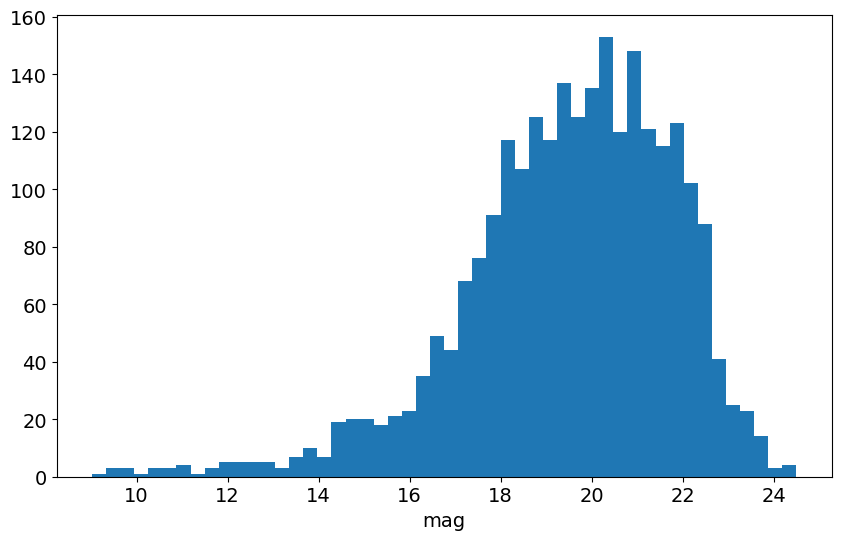

In [17]:
primer['TU_FNU_Y_NISP_MAG'] # Jy
primer['TU_FNU_J_NISP_MAG'] # Jy
primer['TU_FNU_H_NISP_MAG'] # Jy
primer['NIR_Y'] # mag
primer['NIR_J'] # mag
primer['NIR_H'] # mag

fig = plt.figure()

p1 = fig.add_subplot(111)
#p1.hist(primer['TU_FNU_H_NISP_MAG'],bins=50)
p1.hist(primer['NIR_H'],bins=50)
p1.set_xlabel("mag")
plt.show()

## Plot the RA and Dec distribution across the detectors

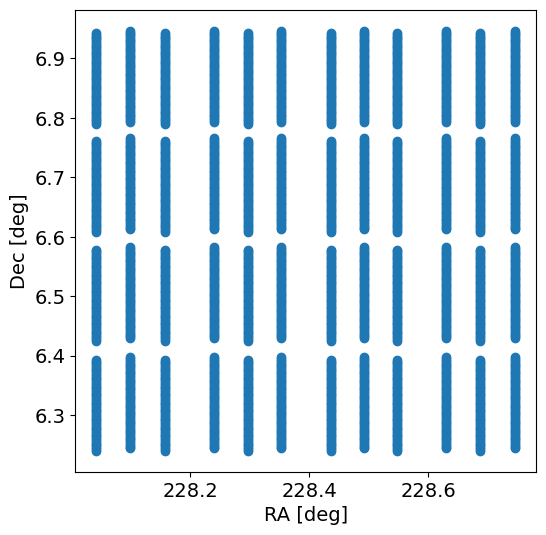

In [18]:
fig = plt.figure()

p1 = fig.add_subplot(111)
p1.scatter(primer['RA'],primer['DEC'])
p1.set_aspect(1.)
p1.set_xlabel("RA [deg]")
p1.set_ylabel("Dec [deg]")

plt.show()

In [19]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))
direct_thumbnail_files = glob.glob('NIS_catalog_file_??.thm.beamA.fits')
direct_thumbnail_files.sort()
print(direct_thumbnail_files)
print(len(direct_thumbnail_files))

['NIS_catalog_file_11.thm.beamA.fits', 'NIS_catalog_file_12.thm.beamA.fits', 'NIS_catalog_file_13.thm.beamA.fits', 'NIS_catalog_file_14.thm.beamA.fits', 'NIS_catalog_file_21.thm.beamA.fits', 'NIS_catalog_file_22.thm.beamA.fits', 'NIS_catalog_file_23.thm.beamA.fits', 'NIS_catalog_file_24.thm.beamA.fits', 'NIS_catalog_file_31.thm.beamA.fits', 'NIS_catalog_file_32.thm.beamA.fits', 'NIS_catalog_file_33.thm.beamA.fits', 'NIS_catalog_file_34.thm.beamA.fits', 'NIS_catalog_file_41.thm.beamA.fits', 'NIS_catalog_file_42.thm.beamA.fits', 'NIS_catalog_file_43.thm.beamA.fits', 'NIS_catalog_file_44.thm.beamA.fits']
16


## Map the sources the sources from the catalog to the detectors 

1 1


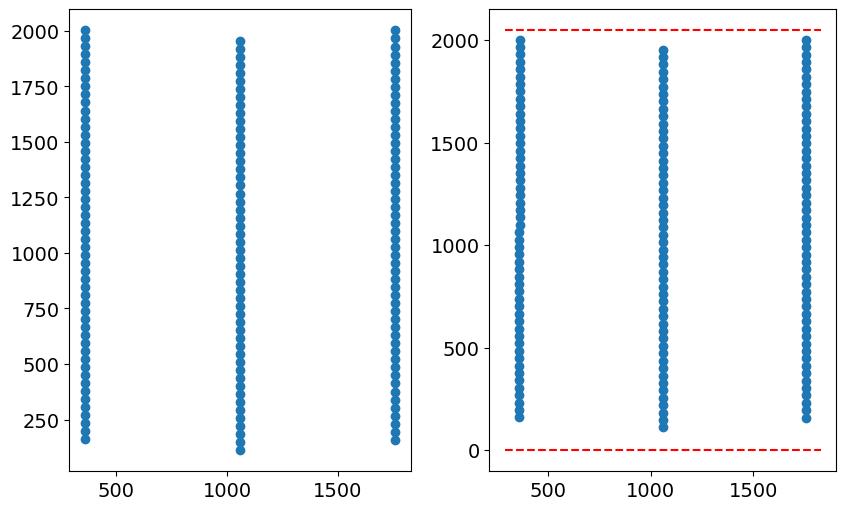

[1191, 1822, 2806, 3011, 3083, 3084, 3224, 3575, 3576, 3716, 3785, 3851, 3924, 3994, 4211, 4213, 4342, 4344, 4485, 4831, 4903, 4906, 5113, 5116, 5325, 5391, 5461, 5471, 5612, 5680, 5688, 5741, 5812, 5818, 5825, 5882, 5952, 5957, 6021, 6091, 6093, 6095, 6162, 6168, 6173, 6304, 6314, 6325, 6344, 6395, 6442, 6511, 16825, 16830, 16881, 16913, 16958, 17151, 17159, 17173, 17174, 17176, 17193, 17198, 17218, 17220, 17233, 17261, 17310, 17366, 17376, 17501, 17586, 17587, 17589, 17590, 17649, 17650, 17652, 17654, 17713, 17716, 17726, 17802, 17858, 17873, 17882, 17887, 17896, 17903, 17905, 17910, 17943, 17946, 17949, 17959, 17961, 17980, 18013, 18142, 18201, 18209, 18215, 18276, 31014, 31082, 31225, 31361, 31574, 31645, 31924, 32412, 32553, 32555, 32692, 32693, 33252, 33333, 33536, 33614, 33815, 33824, 33954, 33960, 33973, 33975, 34100, 34164, 34378, 34386, 34516, 34595, 34665, 34688, 34733, 34746, 34794, 34809, 34932, 34943, 34947, 35012, 35051, 35085, 35157, 35356, 35357, 35371, 35375, 35388, 3

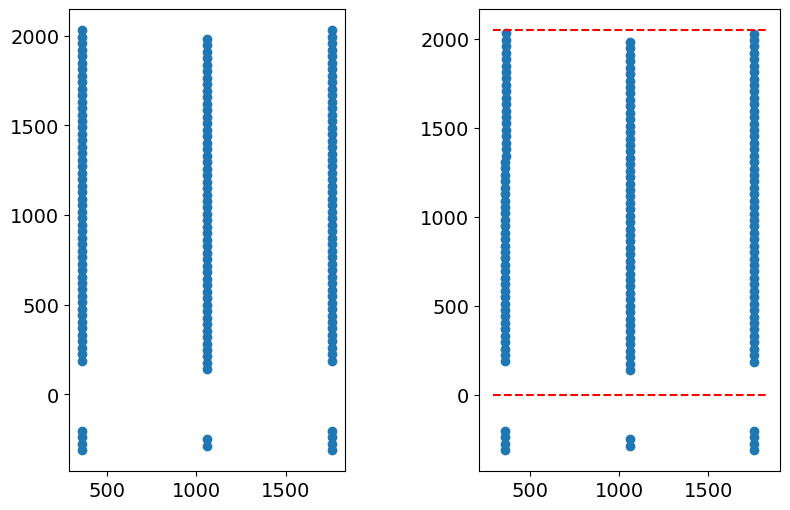

[6344, 6395, 6442, 6511, 6662, 6676, 6695, 6696, 6741, 6800, 6873, 7013, 7026, 7053, 7064, 7093, 7158, 7165, 7219, 7288, 7360, 7372, 7375, 7393, 7400, 7460, 7497, 7507, 7513, 7572, 7583, 7634, 7646, 7703, 7708, 7717, 7734, 7746, 7755, 7765, 7769, 7806, 7811, 7813, 7852, 7864, 7867, 7914, 7916, 7931, 8063, 8094, 8119, 8125, 8153, 8175, 18215, 18276, 18277, 18297, 18332, 18333, 18340, 18380, 18432, 18486, 18490, 18496, 18497, 18505, 18582, 18587, 18615, 18617, 18673, 18765, 18774, 18838, 18840, 18857, 19041, 19602, 19952, 21354, 21424, 21491, 21632, 21701, 21705, 21984, 22054, 22401, 22545, 22751, 22754, 23106, 23112, 23180, 23465, 23809, 23817, 23950, 24012, 24165, 24227, 24233, 24302, 24305, 24436, 24587, 35456, 35492, 35498, 35514, 35563, 35566, 35570, 35766, 35775, 35790, 35812, 35848, 35859, 35915, 35927, 35934, 35985, 35991, 36051, 36052, 36053, 36063, 36096, 36115, 36158, 36163, 36164, 36172, 36272, 36338, 36412, 36431, 36434, 36459, 36478, 36487, 36501, 36554, 36560, 36614, 36617

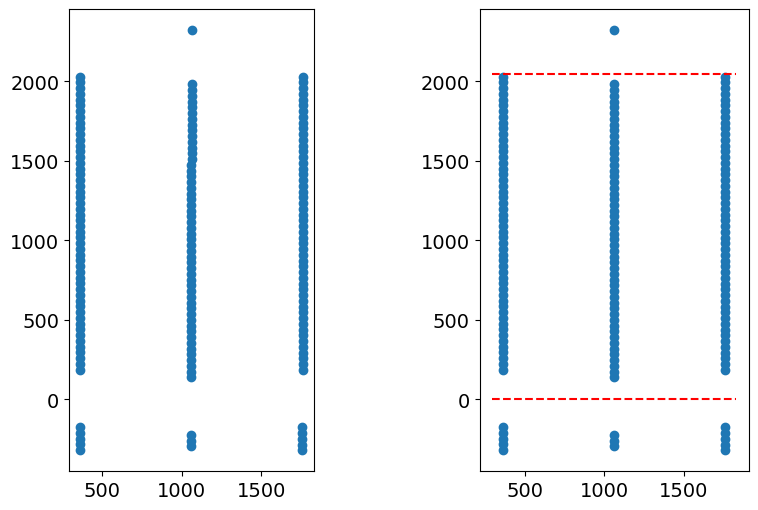

[8094, 8119, 8125, 8153, 8175, 8216, 8276, 8284, 8440, 8479, 8480, 8488, 8491, 8513, 8541, 8548, 8549, 8567, 8624, 8685, 8694, 8754, 8780, 8797, 8842, 8865, 8877, 8920, 8976, 8978, 8986, 9031, 9040, 9043, 9106, 9126, 9143, 9163, 9169, 9197, 9201, 9215, 9245, 9266, 9295, 9334, 10853, 11905, 11971, 12043, 12394, 12675, 12743, 12745, 12813, 13305, 13310, 24305, 24436, 24587, 24785, 24787, 24935, 25004, 25006, 25062, 25219, 25226, 25277, 25287, 25351, 25493, 25552, 25586, 25593, 25621, 25622, 25636, 25639, 25642, 25697, 25707, 25709, 25766, 25843, 25917, 25945, 25960, 25978, 26051, 26183, 26291, 26324, 26357, 26401, 26465, 26541, 26634, 26638, 26677, 26685, 26686, 26694, 26715, 26757, 26818, 26881, 26888, 26892, 26956, 26968, 26983, 27002, 36907, 36910, 36916, 36930, 36935, 37031, 37033, 37034, 37037, 37044, 37121, 37129, 37131, 37146, 37151, 37190, 37203, 37263, 37293, 37319, 37458, 37510, 37548, 37551, 37579, 37592, 37612, 37618, 37625, 37640, 37667, 37676, 37743, 39481, 40182, 40463, 40

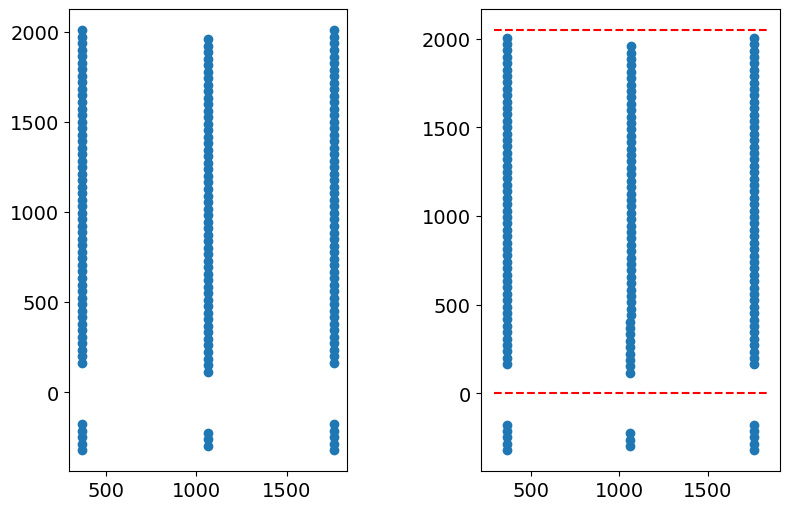

[12743, 12745, 12813, 13305, 13310, 13371, 13441, 13581, 13584, 13660, 13725, 13732, 13796, 13936, 14006, 14010, 14084, 14142, 14146, 14281, 14491, 14497, 14563, 14703, 14842, 15058, 15062, 15136, 15331, 15408, 15474, 15482, 15541, 15545, 15555, 15759, 15900, 15906, 16121, 16142, 16184, 16261, 16262, 16384, 16460, 16462, 16473, 16499, 16515, 16525, 16535, 16544, 16670, 16805, 16810, 16812, 16816, 26956, 26968, 26983, 27002, 27010, 27012, 27016, 27029, 27061, 27063, 27071, 27173, 27319, 27346, 27370, 27377, 27388, 27404, 27456, 27522, 27525, 27536, 27607, 27657, 27667, 27680, 27682, 27693, 27699, 27711, 27713, 27715, 27724, 27738, 27743, 27752, 27831, 27877, 27878, 28083, 28093, 28118, 28161, 28166, 28219, 28222, 28226, 28228, 28911, 29402, 29541, 30733, 30803, 30942, 30943, 42281, 42422, 42435, 42562, 42564, 42782, 42843, 43191, 43193, 43837, 43906, 44032, 44036, 44044, 44102, 44138, 44145, 44245, 44247, 44319, 44387, 44389, 44391, 44525, 44531, 44539, 44605, 44614, 44733, 44736, 44822

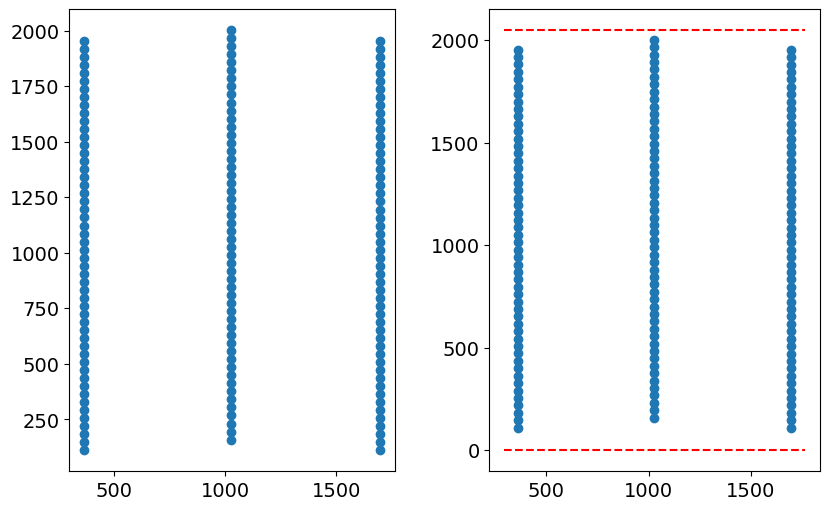

[45645, 45660, 45737, 45790, 45791, 45867, 45907, 45941, 45950, 45957, 45964, 45974, 45997, 46002, 46014, 46071, 46084, 46148, 46154, 46201, 46211, 46214, 46220, 46244, 46262, 46275, 46290, 46314, 46315, 46343, 46355, 46361, 46363, 46376, 46437, 46488, 46584, 46587, 46602, 46628, 46632, 46646, 46647, 46670, 46693, 46696, 46707, 46768, 46835, 46913, 46926, 46970, 62322, 62325, 62326, 62376, 62379, 62443, 62452, 62653, 62727, 62734, 62793, 62946, 63080, 63088, 63091, 63143, 63153, 63161, 63288, 63351, 63359, 63362, 63388, 63389, 63390, 63407, 63437, 63440, 63442, 63445, 63492, 63500, 63503, 63576, 63738, 63749, 63771, 63775, 63793, 63809, 63854, 63983, 63985, 63988, 64067, 64083, 64085, 64095, 64114, 64117, 64129, 64142, 73957, 73968, 73974, 74005, 74006, 74068, 74133, 74137, 74146, 74243, 74351, 74360, 74380, 74411, 74430, 74481, 74485, 74490, 74493, 74498, 74556, 74567, 74573, 74579, 74582, 74594, 74634, 74636, 74644, 74692, 74702, 74705, 74716, 74737, 74771, 74831, 74851, 74901, 74916

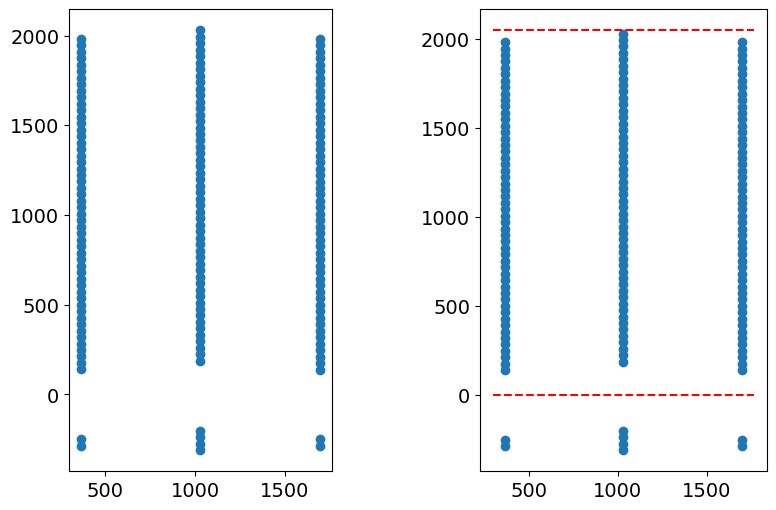

[46926, 46970, 46987, 47007, 47016, 47069, 47075, 47087, 47127, 47137, 47183, 47188, 48722, 48792, 49141, 49632, 49705, 49774, 49914, 49982, 50053, 50404, 51034, 51171, 51241, 51243, 51523, 51592, 51600, 51735, 51803, 51806, 51941, 52152, 52158, 52294, 52433, 52644, 52653, 52712, 52720, 52722, 52927, 52935, 53073, 53136, 53142, 53208, 53224, 53287, 53352, 53551, 53552, 53692, 64114, 64117, 64129, 64142, 64146, 64163, 64413, 64423, 64435, 64467, 64481, 64543, 64553, 64627, 64681, 64692, 64763, 64791, 64795, 64834, 64847, 64870, 64872, 64908, 64915, 64929, 64965, 64976, 65032, 65129, 65141, 65149, 65167, 65186, 65191, 65193, 65209, 65211, 65230, 65245, 65263, 65277, 65315, 65385, 65388, 65396, 65406, 65454, 65472, 65495, 65514, 65542, 65543, 65551, 65557, 65570, 75042, 75090, 75111, 75115, 75122, 75123, 75136, 75182, 75195, 75269, 75272, 75275, 75371, 75396, 75418, 75441, 75531, 75553, 75741, 76091, 77353, 77771, 78192, 78332, 78543, 78821, 79171, 79316, 79454, 79531, 79595, 79872, 80162

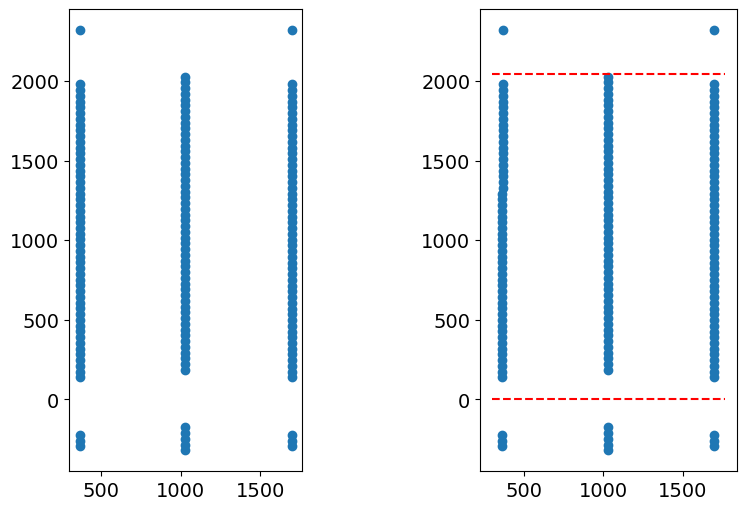

[53551, 53552, 53692, 53704, 53841, 53915, 53945, 53990, 54048, 54254, 54266, 54313, 54344, 54345, 54391, 54467, 54470, 54471, 54617, 54650, 54661, 54684, 54765, 54833, 54888, 54959, 54971, 54979, 55023, 55038, 55099, 55115, 55177, 55240, 55245, 55316, 55330, 55421, 55442, 55446, 55529, 55598, 55660, 55677, 55680, 55687, 55690, 55702, 55734, 55745, 55751, 55762, 55769, 55827, 55836, 55881, 65542, 65543, 65551, 65557, 65570, 65585, 65616, 65626, 65668, 65735, 65754, 65844, 65858, 65873, 65877, 65897, 65914, 65952, 65982, 65994, 66036, 66048, 66105, 67622, 67901, 67903, 68182, 68393, 68531, 68882, 69163, 69444, 69515, 69583, 69651, 69723, 69726, 70144, 70362, 70422, 70562, 70772, 70843, 70846, 70913, 70981, 70984, 71053, 71059, 71261, 71335, 71406, 71551, 71771, 71894, 72031, 72102, 82190, 82259, 82300, 82324, 82344, 82391, 82397, 82404, 82464, 82471, 82537, 82617, 82628, 82690, 82693, 82743, 82746, 82757, 82829, 82889, 82952, 82963, 82975, 82997, 83013, 83016, 83024, 83096, 83105, 83114

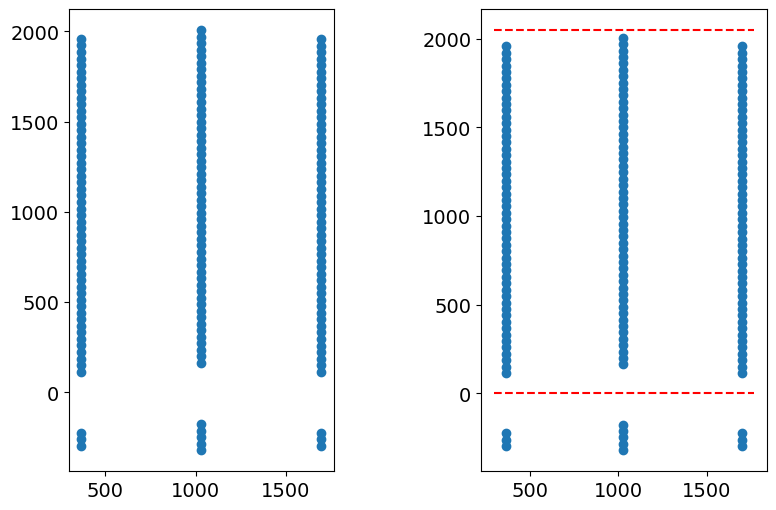

[55769, 55827, 55836, 55881, 55885, 55934, 56014, 56017, 56020, 56024, 56046, 56049, 56051, 56109, 56131, 56157, 56176, 56353, 56377, 56378, 56428, 56439, 56446, 56482, 56490, 56491, 56524, 56571, 56648, 57051, 58242, 58802, 58872, 59082, 59712, 59923, 60483, 60485, 60555, 60625, 60762, 61251, 61260, 61326, 61602, 61614, 61681, 61755, 62027, 62094, 62105, 62162, 62235, 62241, 62303, 71551, 71771, 71894, 72031, 72102, 72120, 72172, 72173, 72184, 72188, 72314, 72393, 72396, 72455, 72476, 72526, 72602, 72802, 72803, 72820, 72823, 72844, 72846, 72849, 72957, 72960, 73084, 73152, 73154, 73160, 73191, 73199, 73243, 73247, 73258, 73259, 73310, 73373, 73378, 73435, 73444, 73446, 73527, 73540, 73542, 73615, 73643, 73659, 73667, 73722, 73727, 73787, 73905, 73908, 73915, 73928, 73941, 83873, 83939, 83952, 84006, 84010, 84027, 84037, 84052, 84081, 84090, 84096, 84105, 84121, 84122, 84164, 84178, 84179, 84181, 84212, 84217, 84223, 84289, 84301, 84306, 84360, 84367, 84369, 84375, 84383, 84402, 84426

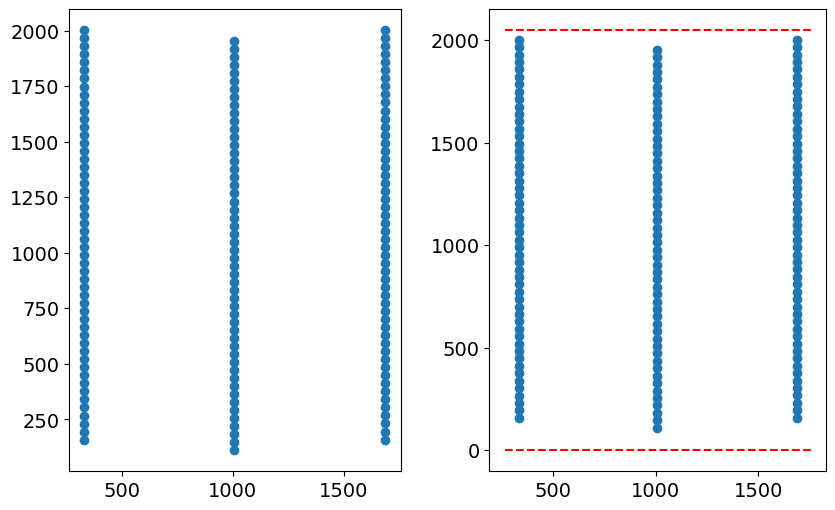

[120049, 120427, 121372, 121949, 122138, 122337, 122516, 122715, 122884, 122894, 123073, 123471, 123660, 123849, 124028, 124595, 124794, 124983, 125361, 157092, 157848, 158415, 158982, 159370, 160136, 160693, 161250, 161260, 162583, 163160, 195647, 196025, 196592, 196980, 197348, 197726, 197736, 197915, 197925, 198313, 198671, 198681, 198880, 199049, 199248, 199437, 199616, 199626, 199636, 199815, 199825, 200939, 161091, 161469, 162225, 162424, 162792, 162812, 163170, 163359, 163548, 163558, 163747, 163936, 163946, 164145, 164324, 164344, 164523, 164533, 199268, 199278, 199646, 199845, 200024, 200223, 200402, 200422, 200601, 200800, 200810, 201198, 201347, 201377, 201556, 201566, 201745, 201914, 201954, 202322, 202501, 202511, 202700, 202899, 203257, 203834, 204222, 237256, 238022, 238032, 238201, 238778, 238967, 239146, 540424, 540593, 540802, 541190, 541548, 541558, 541578, 541747, 541956, 542125, 542324, 542682, 542692, 542881, 543060, 543070, 543090, 543806, 543826, 543836, 543995,

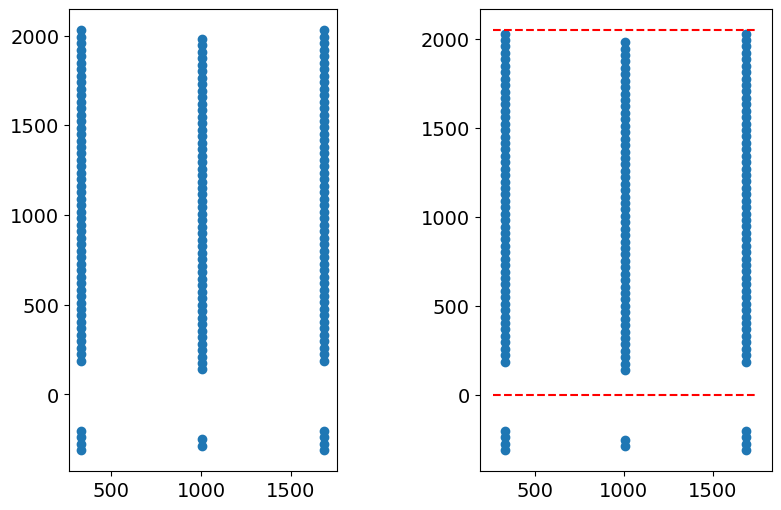

[199636, 199815, 199825, 200939, 201128, 201148, 201526, 232690, 234391, 235336, 235346, 235724, 235913, 236112, 236659, 237047, 237057, 237236, 237246, 237415, 237624, 237803, 238191, 238380, 238559, 238947, 268977, 269365, 269733, 269743, 270867, 271255, 271434, 271633, 272956, 273155, 273324, 273334, 274100, 274458, 274468, 274478, 274846, 275035, 275403, 275413, 275423, 275791, 276557, 277691, 278258, 278437, 278825, 309044, 310188, 310745, 238967, 239146, 239186, 239544, 239902, 240091, 270897, 272071, 272439, 272449, 272807, 272827, 273165, 273185, 273195, 273543, 273563, 273921, 273931, 273941, 274339, 275065, 275075, 275433, 275443, 275811, 276010, 276378, 276398, 276597, 276607, 277144, 277154, 277164, 277343, 277542, 277701, 277711, 277900, 278079, 278089, 278109, 278119, 278268, 278298, 278308, 278457, 278467, 278676, 278686, 278855, 278865, 279233, 279621, 577457, 577487, 577835, 577845, 577865, 578392, 578402, 578591, 578959, 579347, 579377, 579745, 579755, 579934, 580292,

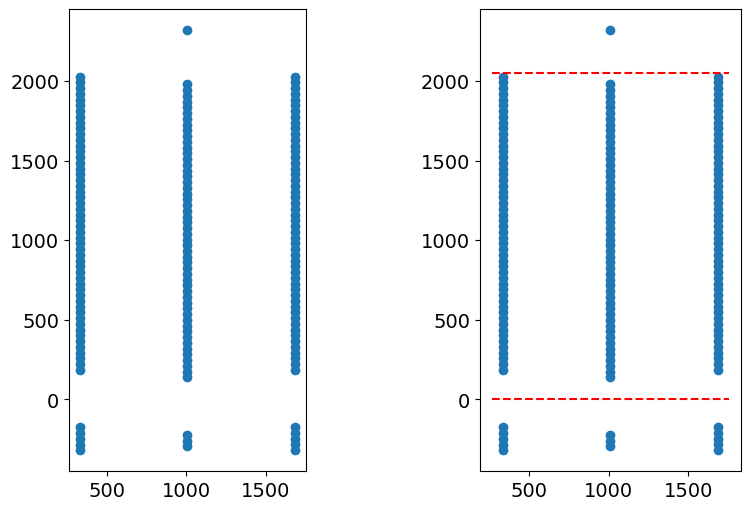

[278437, 278825, 309044, 310188, 310745, 311312, 311322, 311889, 312446, 313590, 314346, 314545, 314734, 314923, 315102, 315301, 315480, 315490, 315669, 315679, 317947, 343819, 344197, 345331, 346843, 347241, 347599, 347977, 349111, 349300, 349877, 350245, 350454, 350623, 350643, 350822, 351190, 351389, 351399, 351568, 351757, 351946, 351956, 352712, 352891, 352901, 353100, 353458, 353468, 353478, 354025, 354045, 354234, 354791, 354990, 535092, 536614, 278865, 279233, 279621, 279780, 310964, 311720, 312118, 313799, 313998, 314406, 314555, 314565, 314764, 314953, 315311, 315520, 315530, 315689, 315699, 315709, 315878, 315898, 316067, 316077, 316087, 316097, 316266, 316276, 316445, 316455, 316644, 317032, 317052, 317201, 317221, 317390, 317430, 317589, 317609, 317619, 317778, 317788, 317987, 318176, 318335, 318365, 318554, 318753, 318922, 318932, 319111, 319320, 348385, 348395, 348763, 348773, 693709, 125047, 125426, 125614, 125804, 125992, 125994, 126182, 126183, 126370, 126559, 126565,

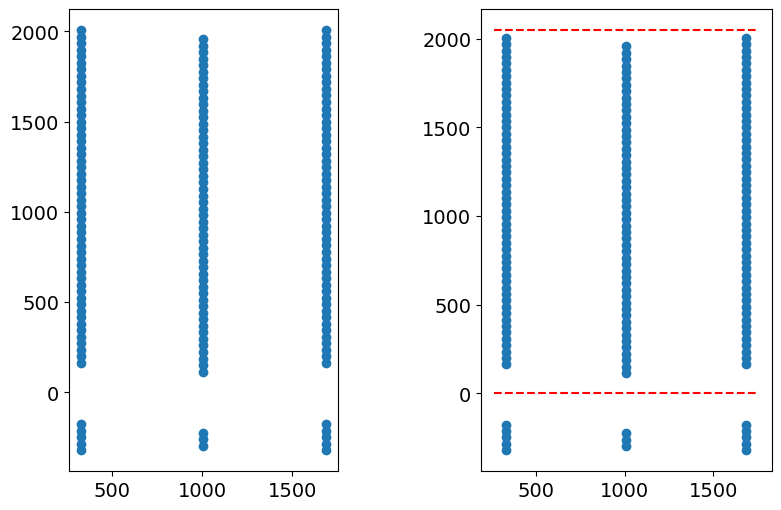

[354234, 354791, 354990, 535092, 536614, 537748, 538504, 538882, 539260, 539628, 540016, 541339, 543418, 543607, 570991, 572881, 573637, 573657, 574035, 574393, 574960, 575338, 575348, 575527, 575726, 575905, 575925, 576094, 576303, 576661, 576671, 577984, 578173, 578362, 578571, 578740, 578949, 579118, 579327, 579516, 579685, 579874, 580083, 580272, 123491, 124247, 124267, 124804, 124993, 125371, 125381, 125391, 125401, 125789, 126535, 126724, 160902, 348385, 348395, 348763, 348773, 349141, 349907, 349917, 349927, 350305, 350315, 350653, 350663, 350693, 351041, 351051, 351071, 351409, 351787, 351797, 351986, 352165, 352175, 352185, 352205, 352354, 352364, 352384, 352732, 352921, 352961, 353140, 353150, 353299, 353319, 353329, 353339, 353508, 353876, 353886, 353896, 354075, 354085, 354463, 354821, 355000, 355010, 355199, 355388, 355408, 536246, 538912, 539280, 539300, 539668, 540056, 200263, 200267, 200459, 200460, 200641, 200835, 200837, 200838, 201213, 201216, 201397, 201401, 201402,

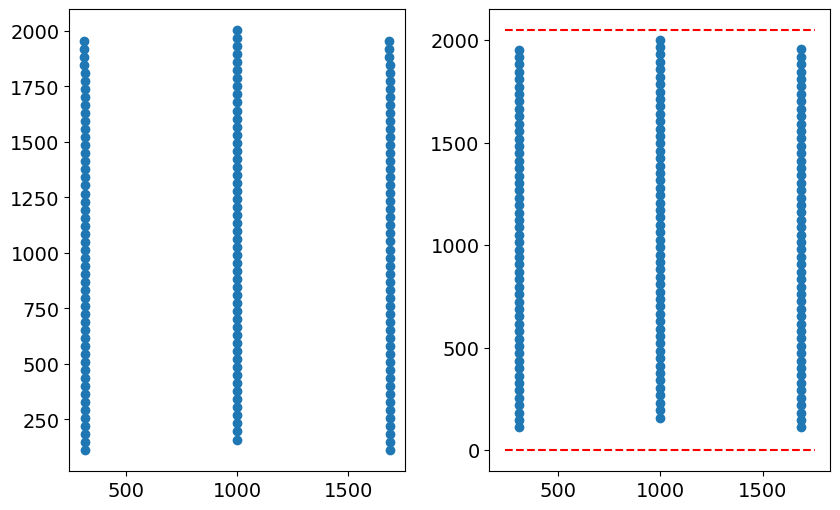

[205376, 205378, 205749, 205754, 205756, 205939, 205941, 206320, 206322, 206507, 206508, 206510, 206511, 207267, 238066, 238629, 238822, 238823, 239203, 239385, 239574, 239578, 239768, 239958, 239959, 239964, 271703, 272841, 273215, 273220, 273223, 273225, 273597, 273603, 273975, 273977, 273983, 274357, 274735, 275114, 275488, 275489, 275490, 275492, 275493, 275494, 275672, 275865, 275866, 275868, 275873, 276056, 353353, 353355, 353361, 353727, 353731, 353732, 353921, 354105, 354113, 354114, 354115, 354117, 354300, 354302, 354487, 354490, 354491, 354493, 354867, 354868, 354870, 354872, 355050, 355054, 355056, 355428, 355436, 355438, 355439, 538186, 538568, 538569, 538942, 539325, 539328, 539698, 539706, 540454, 540458, 540459, 540840, 541216, 541217, 541218, 541219, 541598, 541971, 541976, 541978, 542155, 542727, 542729, 692595, 692600, 692789, 692790, 692973, 692980, 693351, 693356, 693358, 693546, 693547, 693549, 693736, 205004, 205383, 205757, 205760, 206137, 206138, 206139, 206140,

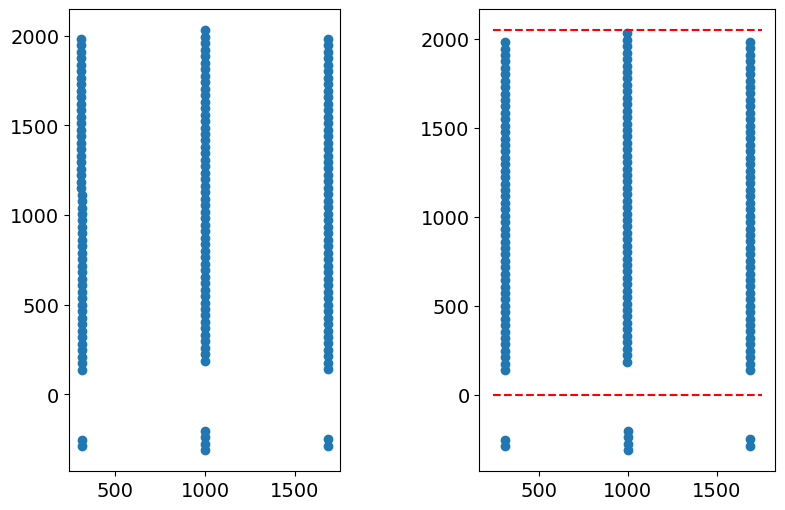

[275873, 276056, 276434, 276435, 276627, 276629, 276806, 276813, 276999, 277002, 277004, 277006, 277184, 277384, 277562, 277566, 277567, 277751, 277755, 277762, 277949, 278134, 278135, 278137, 278318, 278324, 278327, 278329, 278330, 278512, 278515, 278519, 278704, 278707, 278708, 278885, 278896, 278897, 279078, 279085, 279269, 279274, 279458, 279461, 279464, 279646, 279647, 279651, 279836, 279837, 279838, 279841, 279842, 312148, 541978, 542155, 542727, 542729, 542917, 543107, 543289, 543295, 543485, 543488, 543667, 543674, 543675, 543676, 543861, 543867, 544050, 544240, 544241, 544246, 544428, 544431, 544435, 544612, 544621, 544806, 544807, 544809, 544813, 544990, 544994, 544997, 545000, 545001, 545002, 545183, 545184, 545186, 545189, 545191, 545368, 545372, 545562, 545563, 545565, 545567, 545750, 545940, 545944, 545945, 545946, 545947, 546129, 546321, 546323, 546502, 278525, 278901, 278903, 278905, 279281, 279282, 279285, 279654, 279661, 279662, 318967, 318968, 319343, 319348, 319726,

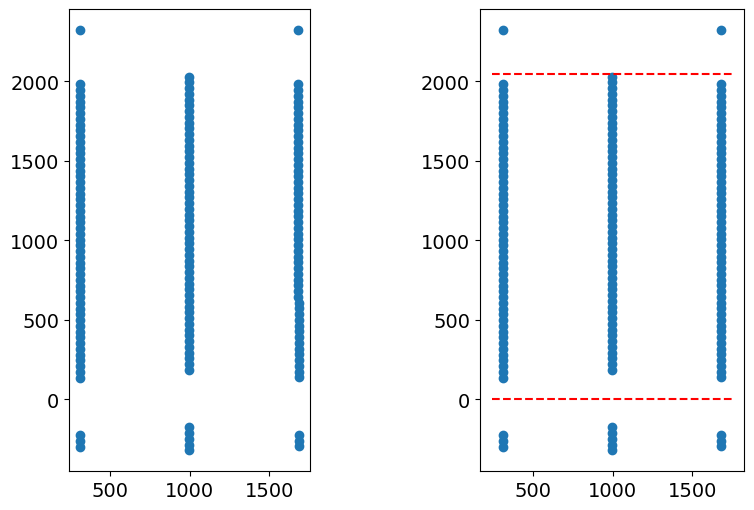

[279841, 279842, 312148, 312908, 313288, 313660, 313666, 314420, 314423, 314424, 314799, 314802, 314803, 315179, 315182, 315365, 315554, 315558, 315561, 315932, 315933, 315939, 316117, 316310, 316317, 316503, 316688, 316690, 316693, 316694, 316695, 316878, 317067, 317068, 317069, 317072, 317257, 317261, 317445, 317446, 317447, 317449, 317450, 317451, 317629, 317636, 317824, 317826, 317827, 318203, 318207, 318394, 318578, 318579, 318586, 318774, 545947, 546129, 546321, 546323, 546502, 546510, 546514, 546697, 546700, 546701, 546703, 546884, 546890, 547075, 547266, 547267, 547270, 547447, 547452, 547640, 547642, 547647, 547830, 547831, 547837, 548018, 548019, 548025, 548207, 548209, 548211, 548214, 548399, 548401, 548402, 548403, 548587, 548591, 548775, 548776, 548778, 548782, 548966, 548968, 548971, 549158, 549344, 549534, 549535, 549536, 549538, 549724, 549725, 550103, 550104, 550105, 616060, 546899, 547274, 547276, 547277, 547278, 547650, 547652, 547655, 547656, 548029, 548032, 548034,

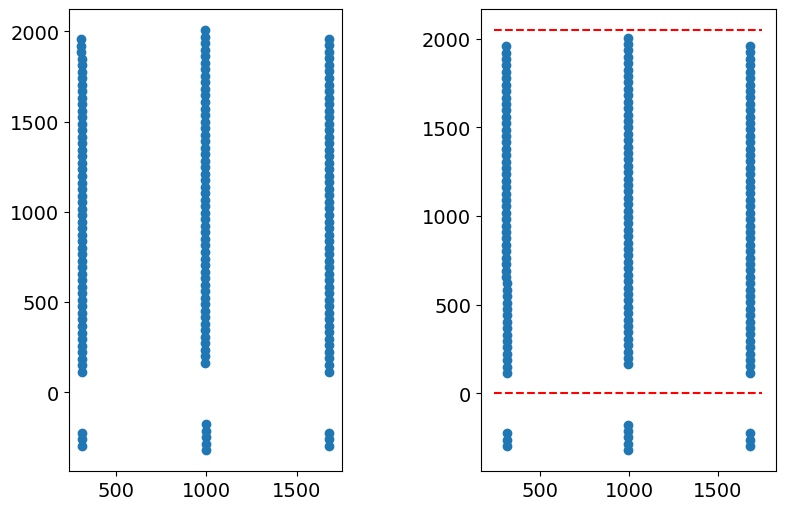

[318578, 318579, 318586, 318774, 318775, 318956, 318958, 319141, 319145, 319146, 319153, 319335, 319523, 319524, 319525, 319527, 319530, 319531, 319716, 319718, 319719, 319904, 320093, 320096, 320279, 320284, 320471, 320472, 320475, 320476, 320659, 320660, 320854, 321041, 321043, 321418, 321799, 349947, 350331, 350703, 350711, 351081, 351090, 351459, 351469, 351845, 352026, 352219, 352220, 352224, 352601, 352603, 352976, 352978, 352983, 549725, 550103, 550104, 550105, 616060, 616437, 617192, 617193, 617194, 617195, 617196, 617197, 617572, 617948, 617951, 652339, 652346, 653103, 653473, 653477, 653479, 653484, 653851, 653856, 653857, 654238, 654616, 654617, 654619, 654992, 654994, 654997, 655178, 655363, 655370, 655374, 655557, 655741, 655745, 655747, 655751, 655753, 655935, 690142, 690516, 690894, 690899, 691280, 691656, 692034, 692037, 692038, 692222, 692406, 692410, 692412, 692413, 278531, 278538, 278908, 279286, 279289, 321626, 321627, 321999, 322001, 322382, 322385, 322758, 322759,

In [20]:
# Loops through all detectors

from astropy import wcs

os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))

thumb_temp = 'NIS_catalog_file_%s.thm.beamA.fits'
wcs_temp = "../Euclid_DET%s_wcs.fits"

det_dict = {}

for i in range(0,4): 
    for j in range(0,4):
        print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)

        head = heads['DET%s.SCI' % (num)]

        nhdu = pyfits.PrimaryHDU()                                                              
        nhdu.header = head  
        nhdu.header.tofile(wcs_temp % (num),overwrite=True)
        #print(head)
        #print()
        #print(nhdu)                                                                            
                                                                                                                                                                               
        w = wcs.WCS(nhdu)  

        hdu = pyfits.open(thumb_temp % (num))
        sources = [h.header['EXTNAME'] for h in hdu[1:]]
        det_thumb_tbl = Table([sources], names=['SOURCE_ID'])
        
        det_tbl = join(det_thumb_tbl, primer, keys='SOURCE_ID')

        world = [[ra,dec] for ra,dec in det_tbl['RA','DEC']]
        pixcrd = w.wcs_world2pix(world, 0)                                              

        det_tbl['X_PIX'] = pixcrd[:,0]
        det_tbl['Y_PIX'] = pixcrd[:,1]
        
        fig = plt.figure()
        
        p1 = fig.add_subplot(121)
        p1.scatter(det_tbl['X_PIX'],det_tbl['Y_PIX'])
        p1.set_aspect("equal")
        #p1.set_xlim()
        
        p2 = fig.add_subplot(122)
        p2.scatter(det_tbl['X_PIX'],det_tbl['Y_PIX'])
        
        x0,x1 = p2.get_xlim()
        
        p2.plot([x0,x1],[0,0],"--",c="r")
        p2.plot([x0,x1],[2048,2048],"--",c="r")        
        p2.set_aspect("equal")        
        
        plt.show()
        
        print(sources)
        print()
        print()
        
        det_dict[num] = det_tbl

print(det_dict)

## Print each of the detectors WCS header information

In [21]:
from astropy import wcs

os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
wcs_temp = "Euclid_DET%s_wcs.fits"

for i in range(0,4): 
    for j in range(0,4):
        print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)
        hdu = pyfits.open(wcs_temp % (num), ignore_missing_simple=True)    
        head = hdu[0].header
        #print(head)
        print(head['CRVAL1'],head['CRVAL2'],head['CRPIX1'],head['CRPIX2'])

1 1
228.39419187752 6.5903912393221 4578.75045083333 4331.37522541667
1 2
228.39419187752 6.5903912393221 4578.75045083333 2126.45840847222
1 3
228.39419187752 6.5903912393221 4578.75045083333 -78.4584084722222
1 4
228.39419187752 6.5903912393221 4578.75045083333 -2283.37522541667
2 1
228.39419187752 6.5903912393221 2208.91681694444 4331.37522541667
2 2
228.39419187752 6.5903912393221 2208.91681694444 2126.45840847222
2 3
228.39419187752 6.5903912393221 2208.91681694444 -78.4584084722222
2 4
228.39419187752 6.5903912393221 2208.91681694444 -2283.37522541667
3 1
228.39419187752 6.5903912393221 -160.916816944444 4331.37522541667
3 2
228.39419187752 6.5903912393221 -160.916816944444 2126.45840847222
3 3
228.39419187752 6.5903912393221 -160.916816944444 -78.4584084722222
3 4
228.39419187752 6.5903912393221 -160.916816944444 -2283.37522541667
4 1
228.39419187752 6.5903912393221 -2530.75045083333 4331.37522541667
4 2
228.39419187752 6.5903912393221 -2530.75045083333 2126.45840847222
4 3
228.

## Write direct images

In [22]:
# Loops through all detectors

os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))

thumb_temp = 'NIS_catalog_file_%s.thm.beamA.fits'

# noise characteristics of "direct image"
#exptime = 553.
dir_exptime = 3000.
nexp = 1
readnoise = 10.
background = 0.5
scale1 = 1.0 # should always be set to one...


box_hw = 11
scale2 = 1e4 
# currently arbitrary (counts (DNs) which should be related to (background + source)*gain)
verb = 1


all_direct = []

for i in range(0,4): 
    for j in range(0,4):
        print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)

        head1 = heads['DET%s.SCI' % (num)]

        gain = head1['GAIN_DET']
        direct = "Euclid_DET%s_direct.fits" % (num)
        
        all_direct.append(direct)

        data = np.zeros((2048,2048)) 
        err = np.zeros((2048,2048)) 
        dq = np.ones((2048,2048)) 

        #data += 1e-15

        hdu = pyfits.open(thumb_temp % (num))
        print(thumb_temp % (num))
        print(len(hdu))
        #print(hdu[0].header)
        #print(hdu['1191'].header)
        #print(hdu.info())
        
        det_tbl = det_dict[num]

        for k,h in enumerate(hdu[1:]):
            head = h.header
            img1 = h.data

            xpix,ypix = det_tbl['X_PIX','Y_PIX'][k]
            
            if xpix < 0 or xpix > 2048 or ypix < 0 or ypix > 2048: continue
    
            xpix = int(xpix+0.5)
            ypix = int(ypix+0.5)
            
            y0 = ypix-box_hw
            y1 = ypix+box_hw
            x0 = xpix-box_hw
            x1 = xpix+box_hw
            
            if verb:
                print(k)
                print(head['EXTNAME'])
                print(img1.shape)
                print(x0,x1)
                print(y0,y1)
                print()

        
            data[y0:y1,x0:x1] = img1*det_tbl['TU_FNU_H_NISP_MAG'][k]*scale2


        hdu = pyfits.PrimaryHDU(header=head1)  
        hdu.name = 'PRIMARY'
    
        hdu_sci = pyfits.ImageHDU(data, header=head1)  
        hdu_sci.name = 'SCI'
        hdu_err = pyfits.ImageHDU(err, header=head1)
        hdu_err.name = 'ERR'
        hdu_dq = pyfits.ImageHDU(dq, header=head1)
        hdu_dq.name = 'DQ'

        hdu1 = pyfits.HDUList([hdu,hdu_sci,hdu_err,hdu_dq])
        hdu1.info()

        hdu2 = add_noise(hdu1, scale=scale1, background=background, exptime=dir_exptime, 
                         nexp=nexp, readnoise=readnoise)
        hdu2.writeto("../" + direct, overwrite=True)
    


1 1
NIS_catalog_file_11.thm.beamA.fits
157
0
1191
(22, 22)
349 371
149 171

1
1822
(22, 22)
349 371
185 207

2
2806
(22, 22)
349 371
221 243

3
3011
(22, 22)
349 371
257 279

4
3083
(22, 22)
349 371
294 316

5
3084
(22, 22)
349 371
330 352

6
3224
(22, 22)
349 371
366 388

7
3575
(22, 22)
349 371
402 424

8
3576
(22, 22)
349 371
438 460

9
3716
(22, 22)
349 371
474 496

10
3785
(22, 22)
349 371
510 532

11
3851
(22, 22)
349 371
547 569

12
3924
(22, 22)
349 371
583 605

13
3994
(22, 22)
349 371
619 641

14
4211
(22, 22)
349 371
655 677

15
4213
(22, 22)
349 371
691 713

16
4342
(22, 22)
349 371
727 749

17
4344
(22, 22)
349 371
763 785

18
4485
(22, 22)
349 371
799 821

19
4831
(22, 22)
349 371
836 858

20
4903
(22, 22)
349 371
872 894

21
4906
(22, 22)
349 371
908 930

22
5113
(22, 22)
349 371
944 966

23
5116
(22, 22)
349 371
980 1002

24
5325
(22, 22)
349 371
1016 1038

25
5391
(22, 22)
349 371
1052 1074

26
5461
(22, 22)
349 371
1089 1111

27
5471
(22, 22)
349 371
1125 1147

28
561

1 3
NIS_catalog_file_13.thm.beamA.fits
171
5
8216
(22, 22)
352 374
176 198

6
8276
(22, 22)
352 374
212 234

7
8284
(22, 22)
352 374
248 270

8
8440
(22, 22)
352 374
284 306

9
8479
(22, 22)
352 374
321 343

10
8480
(22, 22)
352 374
357 379

11
8488
(22, 22)
352 374
393 415

12
8491
(22, 22)
352 374
429 451

13
8513
(22, 22)
352 374
465 487

14
8541
(22, 22)
352 374
501 523

15
8548
(22, 22)
352 374
537 559

16
8549
(22, 22)
352 374
573 595

17
8567
(22, 22)
352 374
610 632

18
8624
(22, 22)
352 374
646 668

19
8685
(22, 22)
352 374
682 704

20
8694
(22, 22)
352 374
718 740

21
8754
(22, 22)
352 374
754 776

22
8780
(22, 22)
352 374
790 812

23
8797
(22, 22)
352 374
826 848

24
8842
(22, 22)
352 374
862 884

25
8865
(22, 22)
352 374
899 921

26
8877
(22, 22)
352 374
935 957

27
8920
(22, 22)
352 374
971 993

28
8976
(22, 22)
352 374
1007 1029

29
8978
(22, 22)
352 374
1043 1065

30
8986
(22, 22)
352 374
1079 1101

31
9031
(22, 22)
352 374
1115 1137

32
9040
(22, 22)
352 374
1151 1173



2 1
NIS_catalog_file_21.thm.beamA.fits
157
0
45645
(22, 22)
353 375
100 122

1
45660
(22, 22)
353 375
136 158

2
45737
(22, 22)
353 375
172 194

3
45790
(22, 22)
353 375
208 230

4
45791
(22, 22)
353 375
244 266

5
45867
(22, 22)
353 375
280 302

6
45907
(22, 22)
353 375
317 339

7
45941
(22, 22)
353 375
353 375

8
45950
(22, 22)
353 375
389 411

9
45957
(22, 22)
353 375
425 447

10
45964
(22, 22)
353 375
461 483

11
45974
(22, 22)
353 375
497 519

12
45997
(22, 22)
353 375
533 555

13
46002
(22, 22)
353 375
569 591

14
46014
(22, 22)
353 375
606 628

15
46071
(22, 22)
353 375
642 664

16
46084
(22, 22)
353 375
678 700

17
46148
(22, 22)
353 375
714 736

18
46154
(22, 22)
353 375
750 772

19
46201
(22, 22)
353 375
786 808

20
46211
(22, 22)
353 375
822 844

21
46214
(22, 22)
353 375
859 881

22
46220
(22, 22)
353 375
895 917

23
46244
(22, 22)
353 375
931 953

24
46262
(22, 22)
353 375
967 989

25
46275
(22, 22)
353 375
1003 1025

26
46290
(22, 22)
353 375
1039 1061

27
46314
(22, 22)


2 3
NIS_catalog_file_23.thm.beamA.fits
170
3
53704
(22, 22)
354 376
127 149

4
53841
(22, 22)
354 376
163 185

5
53915
(22, 22)
354 376
199 221

6
53945
(22, 22)
354 376
235 257

7
53990
(22, 22)
355 377
271 293

8
54048
(22, 22)
355 377
307 329

9
54254
(22, 22)
355 377
343 365

10
54266
(22, 22)
355 377
380 402

11
54313
(22, 22)
355 377
416 438

12
54344
(22, 22)
355 377
452 474

13
54345
(22, 22)
355 377
488 510

14
54391
(22, 22)
355 377
524 546

15
54467
(22, 22)
355 377
560 582

16
54470
(22, 22)
355 377
596 618

17
54471
(22, 22)
355 377
632 654

18
54617
(22, 22)
355 377
669 691

19
54650
(22, 22)
355 377
705 727

20
54661
(22, 22)
355 377
741 763

21
54684
(22, 22)
355 377
777 799

22
54765
(22, 22)
355 377
813 835

23
54833
(22, 22)
355 377
849 871

24
54888
(22, 22)
355 377
885 907

25
54959
(22, 22)
355 377
921 943

26
54971
(22, 22)
355 377
958 980

27
54979
(22, 22)
355 377
994 1016

28
55023
(22, 22)
355 377
1030 1052

29
55038
(22, 22)
355 377
1066 1088

30
55099
(22, 

3 1
NIS_catalog_file_31.thm.beamA.fits
157
0
120049
(22, 22)
321 343
148 170

1
120427
(22, 22)
321 343
184 206

2
121372
(22, 22)
321 343
220 242

3
121949
(22, 22)
321 343
256 278

4
122138
(22, 22)
321 343
292 314

5
122337
(22, 22)
321 343
328 350

6
122516
(22, 22)
321 343
364 386

7
122715
(22, 22)
321 343
401 423

8
122884
(22, 22)
321 343
437 459

9
122894
(22, 22)
321 343
473 495

10
123073
(22, 22)
321 343
509 531

11
123471
(22, 22)
321 343
545 567

12
123660
(22, 22)
321 343
581 603

13
123849
(22, 22)
321 343
617 639

14
124028
(22, 22)
321 343
654 676

15
124595
(22, 22)
321 343
690 712

16
124794
(22, 22)
321 343
726 748

17
124983
(22, 22)
321 343
762 784

18
125361
(22, 22)
321 343
798 820

19
157092
(22, 22)
321 343
834 856

20
157848
(22, 22)
321 343
870 892

21
158415
(22, 22)
321 343
906 928

22
158982
(22, 22)
321 343
943 965

23
159370
(22, 22)
321 343
979 1001

24
160136
(22, 22)
321 343
1015 1037

25
160693
(22, 22)
321 343
1051 1073

26
161250
(22, 22)
996 101

3 3
NIS_catalog_file_33.thm.beamA.fits
171
4
310745
(22, 22)
1676 1698
175 197

5
311312
(22, 22)
1676 1698
211 233

6
311322
(22, 22)
1676 1698
247 269

7
311889
(22, 22)
1676 1698
283 305

8
312446
(22, 22)
1676 1698
319 341

9
313590
(22, 22)
1676 1698
355 377

10
314346
(22, 22)
1676 1698
392 414

11
314545
(22, 22)
1676 1698
428 450

12
314734
(22, 22)
1676 1698
464 486

13
314923
(22, 22)
1676 1698
500 522

14
315102
(22, 22)
1676 1698
536 558

15
315301
(22, 22)
1676 1698
572 594

16
315480
(22, 22)
1676 1698
608 630

17
315490
(22, 22)
1675 1697
644 666

18
315669
(22, 22)
1675 1697
681 703

19
315679
(22, 22)
1675 1697
717 739

20
317947
(22, 22)
1675 1697
753 775

21
343819
(22, 22)
1675 1697
789 811

22
344197
(22, 22)
1675 1697
825 847

23
345331
(22, 22)
1675 1697
861 883

24
346843
(22, 22)
1675 1697
897 919

25
347241
(22, 22)
1675 1697
933 955

26
347599
(22, 22)
1675 1697
970 992

27
347977
(22, 22)
1675 1697
1006 1028

28
349111
(22, 22)
1675 1697
1042 1064

29
349300

4 1
NIS_catalog_file_41.thm.beamA.fits
157
0
205376
(22, 22)
1675 1697
571 593

1
205378
(22, 22)
302 324
100 122

2
205749
(22, 22)
302 324
136 158

3
205754
(22, 22)
1675 1697
607 629

4
205756
(22, 22)
301 323
172 194

5
205939
(22, 22)
301 323
209 231

6
205941
(22, 22)
301 323
245 267

7
206320
(22, 22)
1675 1697
643 665

8
206322
(22, 22)
1675 1697
679 701

9
206507
(22, 22)
301 323
281 303

10
206508
(22, 22)
301 323
317 339

11
206510
(22, 22)
1675 1697
715 737

12
206511
(22, 22)
1675 1697
751 773

13
207267
(22, 22)
1675 1697
787 809

14
238066
(22, 22)
1675 1697
824 846

15
238629
(22, 22)
1675 1697
860 882

16
238822
(22, 22)
1675 1697
896 918

17
238823
(22, 22)
301 323
353 375

18
239203
(22, 22)
301 323
389 411

19
239385
(22, 22)
1675 1697
932 954

20
239574
(22, 22)
301 323
425 447

21
239578
(22, 22)
301 323
461 483

22
239768
(22, 22)
301 323
498 520

23
239958
(22, 22)
301 323
534 556

24
239959
(22, 22)
1675 1697
968 990

25
239964
(22, 22)
1675 1697
1004 1026

26


4 3
NIS_catalog_file_43.thm.beamA.fits
170
0
279841
(22, 22)
1671 1693
1718 1740

1
279842
(22, 22)
1671 1693
1754 1776

2
312148
(22, 22)
1671 1693
1790 1812

3
312908
(22, 22)
1671 1693
1826 1848

4
313288
(22, 22)
1671 1693
1862 1884

5
313660
(22, 22)
1671 1693
1898 1920

6
313666
(22, 22)
1671 1693
1934 1956

7
314420
(22, 22)
1671 1693
1970 1992

12
314803
(22, 22)
299 321
127 149

13
315179
(22, 22)
299 321
163 185

14
315182
(22, 22)
299 321
199 221

15
315365
(22, 22)
299 321
235 257

16
315554
(22, 22)
299 321
272 294

17
315558
(22, 22)
299 321
308 330

18
315561
(22, 22)
299 321
344 366

19
315932
(22, 22)
299 321
380 402

20
315933
(22, 22)
299 321
416 438

21
315939
(22, 22)
299 321
452 474

22
316117
(22, 22)
299 321
488 510

23
316310
(22, 22)
299 321
524 546

24
316317
(22, 22)
299 321
561 583

25
316503
(22, 22)
299 321
597 619

26
316688
(22, 22)
299 321
633 655

27
316690
(22, 22)
299 321
669 691

28
316693
(22, 22)
299 321
705 727

29
316694
(22, 22)
299 321
741 76

In [23]:
print(all_direct)
# should label direct with "_direct"

['Euclid_DET11_direct.fits', 'Euclid_DET12_direct.fits', 'Euclid_DET13_direct.fits', 'Euclid_DET14_direct.fits', 'Euclid_DET21_direct.fits', 'Euclid_DET22_direct.fits', 'Euclid_DET23_direct.fits', 'Euclid_DET24_direct.fits', 'Euclid_DET31_direct.fits', 'Euclid_DET32_direct.fits', 'Euclid_DET33_direct.fits', 'Euclid_DET34_direct.fits', 'Euclid_DET41_direct.fits', 'Euclid_DET42_direct.fits', 'Euclid_DET43_direct.fits', 'Euclid_DET44_direct.fits']


## Display direct image for each detector

XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =     4578.75045083333                                                  CRPIX2  =     4331.37522541667                                                  CTYPE1  = 'RA---TAN'                    

(2048, 2048)
Euclid_DET13_direct.fits
228.39419187752
6.5903912393221
4578.75045083333
-78.4584084722222
XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =     4578.75045083333                                                  CRPIX2  =    -2

(2048, 2048)
Euclid_DET22_direct.fits
228.39419187752
6.5903912393221
2208.91681694444
2126.45840847222
XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =     2208.91681694444                                                  CRPIX2  =    -78

(2048, 2048)
Euclid_DET31_direct.fits
228.39419187752
6.5903912393221
-160.916816944444
4331.37522541667
XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =    -160.916816944444                                                  CRPIX2  =     2

(2048, 2048)
Euclid_DET34_direct.fits
228.39419187752
6.5903912393221
-160.916816944444
-2283.37522541667
XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =    -2530.75045083333                                                  CRPIX2  =     

(2048, 2048)
Euclid_DET43_direct.fits
228.39419187752
6.5903912393221
-2530.75045083333
-78.4584084722222
XTENSION= 'IMAGE   '           / Image extension                                BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 2048                                                  NAXIS2  =                 2048                                                  PCOUNT  =                    0 / number of parameters                           GCOUNT  =                    1 / number of groups                               EXTNAME = 'SCI     '                                                            CRVAL1  =      228.39419187752                                                  CRVAL2  =      6.5903912393221                                                  CRPIX1  =    -2530.75045083333                                                  CRPIX2  =    -

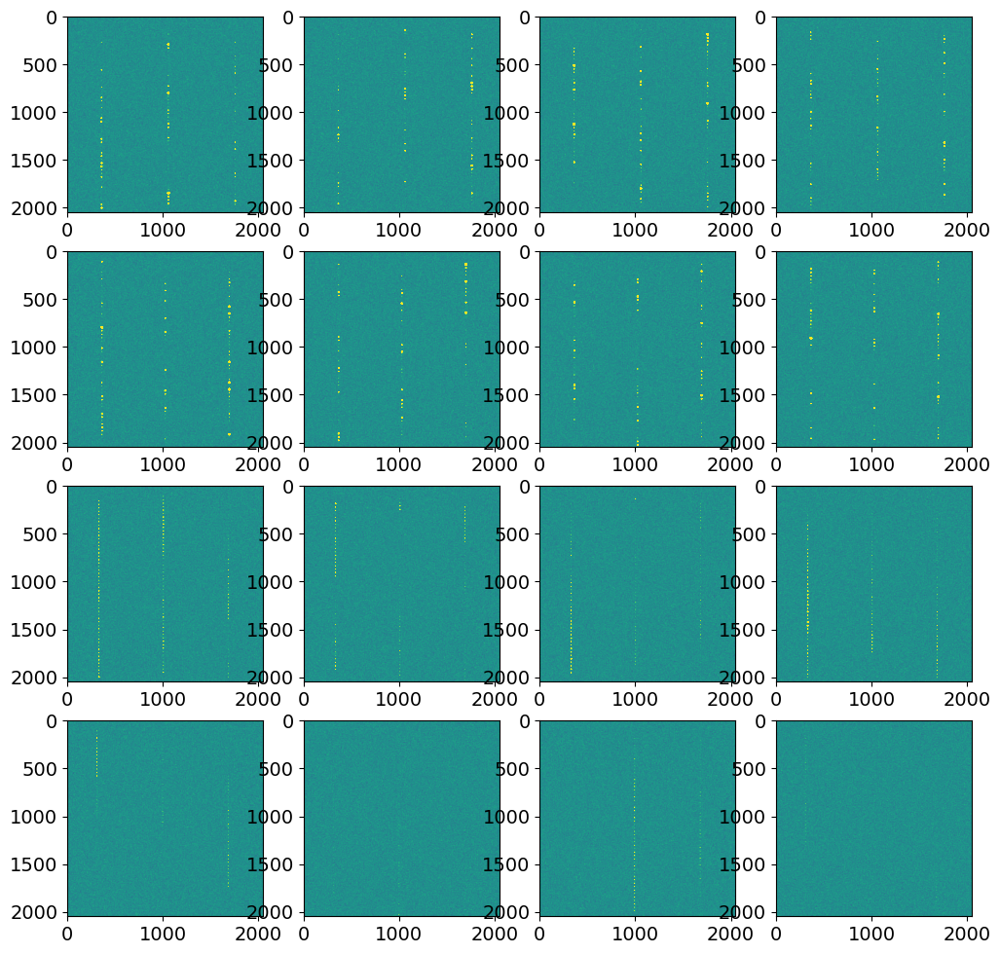

In [24]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

fig = plt.figure(figsize=(12,12))

k = 0

#for i in range(4):
#    for j in range(4):
#        name = "Euclid_DET%i%i.fits" % (i+1,j+1)
    
for direct in all_direct:
        
    hdu = pyfits.open(direct)
    print(hdu['SCI'].header)
    hdu.info()
        
    img = hdu['SCI'].data
    print(img.shape)
    head = hdu['SCI'].header
    #print(name)
    print(direct)
    print(head['CRVAL1'])
    print(head['CRVAL2'])
    print(head['CRPIX1'])
    print(head['CRPIX2'])
        
    #print(np.min(img))
    #print(np.max(img))
    #print(np.mean(img))
    #print(np.median(img))
    #print(np.std(img))
    #print(hdu[name].header)
    #print()
        
    p = fig.add_subplot(4,4,k+1)
    p.imshow(img, vmin=-0.02, vmax=0.02)
    #p.hist(img.flatten(),bins=100)
    #p.set_yscale("log")
    
    k += 1

        
plt.show()


In [25]:
dir()
print(all_direct)
print(all_slitless)

['Euclid_DET11_direct.fits', 'Euclid_DET12_direct.fits', 'Euclid_DET13_direct.fits', 'Euclid_DET14_direct.fits', 'Euclid_DET21_direct.fits', 'Euclid_DET22_direct.fits', 'Euclid_DET23_direct.fits', 'Euclid_DET24_direct.fits', 'Euclid_DET31_direct.fits', 'Euclid_DET32_direct.fits', 'Euclid_DET33_direct.fits', 'Euclid_DET34_direct.fits', 'Euclid_DET41_direct.fits', 'Euclid_DET42_direct.fits', 'Euclid_DET43_direct.fits', 'Euclid_DET44_direct.fits']
['Euclid_DET11_slitless.fits', 'Euclid_DET12_slitless.fits', 'Euclid_DET13_slitless.fits', 'Euclid_DET14_slitless.fits', 'Euclid_DET21_slitless.fits', 'Euclid_DET22_slitless.fits', 'Euclid_DET23_slitless.fits', 'Euclid_DET24_slitless.fits', 'Euclid_DET31_slitless.fits', 'Euclid_DET32_slitless.fits', 'Euclid_DET33_slitless.fits', 'Euclid_DET34_slitless.fits', 'Euclid_DET41_slitless.fits', 'Euclid_DET42_slitless.fits', 'Euclid_DET43_slitless.fits', 'Euclid_DET44_slitless.fits']


## Add all of the header metadata needed for Grizli

In [26]:
print(dir_exptime)
print(spec_exptime)

3000.0
549.64224


In [27]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

suffix = "_final"

all_final_direct = []
all_final_slitless = []

#for i in range(4):
#    for j in range(4):
        #num = '%i%i' % (i+1,j+1)
        #direct = "Euclid_DET%s.fits" % (num)
        #slitless = "Euclid_DET%s_slitless.fits"  % (num)
        
##############
### DIRECT ###
##############        
for direct in all_direct:
    # updated FITS files
    new_direct = direct.replace(".fits",suffix+".fits")        
    all_final_direct.append(new_direct)

    hdu = pyfits.open(direct)
    hdu.info()
    #del hdu[ext].header['']

    ext = 0
    hdu[ext].header['FILTER'] = 'NISP_H'
    #hdu[ext].header['INSTRUME'] = 'NISP'
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1'
    hdu[ext].header['EXPTIME'] = dir_exptime # ????
    ##hdu[ext].header['EXTVER'] = ext

    ext = 1
    hdu[ext].header['FILTER'] = 'NISP_H'
    #hdu[ext].header['INSTRUME'] = 'NISP' 
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1'
    hdu[ext].header['EXTVER'] = ext
    hdu[ext].header['EXPTIME'] = dir_exptime
    hdu.writeto(new_direct, overwrite=True, output_verify='fix')
    print("Writing",new_direct)

###############
### SPECTRA ###
###############
for slitless in all_slitless:
    
    new_slitless = slitless.replace(".fits",suffix+".fits")
    all_final_slitless.append(new_slitless)
        
    hdu = pyfits.open(slitless)
    hdu.info()

    ext = 0
    #hdu[ext].header['INSTRUME'] = 'NISP' 
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1'
    hdu[ext].header['FILTER'] = 'RED'
    hdu[ext].header['EXPTIME'] = spec_exptime

    ext = 1
    #hdu[ext].header['INSTRUME'] = 'NISP'
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1'
    hdu[ext].header['FILTER'] = 'RED'
    hdu[ext].header['EXTVER'] = ext
    hdu[ext].header['EXPTIME'] = spec_exptime

    sci = hdu[ext].data
    hdu[ext].data = sci/spec_exptime/gain

    ext = 2
    err = hdu[ext].data
    hdu[ext].data = err/spec_exptime/gain

    hdu.writeto(new_slitless, overwrite=True, output_verify='fix')
    print("Writing",new_slitless)


Filename: Euclid_DET11_direct.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        33   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        33   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        33   (2048, 2048)   float64   
Writing Euclid_DET11_direct_final.fits
Filename: Euclid_DET12_direct.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        33   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        33   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        33   (2048, 2048)   float64   
Writing Euclid_DET12_direct_final.fits
Filename: Euclid_DET13_direct.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        33   (2048, 2048)   float64   
  

Writing Euclid_DET21_slitless_final.fits
Filename: Euclid_DET22_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
Writing Euclid_DET22_slitless_final.fits
Filename: Euclid_DET23_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
Writing Euclid_DET23_slitless_final.fits
Filename: Euclid_DET24_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     

In [28]:
print(all_final_direct)
print(all_final_slitless)

['Euclid_DET11_direct_final.fits', 'Euclid_DET12_direct_final.fits', 'Euclid_DET13_direct_final.fits', 'Euclid_DET14_direct_final.fits', 'Euclid_DET21_direct_final.fits', 'Euclid_DET22_direct_final.fits', 'Euclid_DET23_direct_final.fits', 'Euclid_DET24_direct_final.fits', 'Euclid_DET31_direct_final.fits', 'Euclid_DET32_direct_final.fits', 'Euclid_DET33_direct_final.fits', 'Euclid_DET34_direct_final.fits', 'Euclid_DET41_direct_final.fits', 'Euclid_DET42_direct_final.fits', 'Euclid_DET43_direct_final.fits', 'Euclid_DET44_direct_final.fits']
['Euclid_DET11_slitless_final.fits', 'Euclid_DET12_slitless_final.fits', 'Euclid_DET13_slitless_final.fits', 'Euclid_DET14_slitless_final.fits', 'Euclid_DET21_slitless_final.fits', 'Euclid_DET22_slitless_final.fits', 'Euclid_DET23_slitless_final.fits', 'Euclid_DET24_slitless_final.fits', 'Euclid_DET31_slitless_final.fits', 'Euclid_DET32_slitless_final.fits', 'Euclid_DET33_slitless_final.fits', 'Euclid_DET34_slitless_final.fits', 'Euclid_DET41_slitless

## Check the pixel scale of the images

In [29]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

#for i in range(4):
#    for j in range(4):
#        num = '%i%i' % (i+1,j+1)
#        new_direct = "Euclid_DET%s%s.fits" % (num,suffix)
#        new_slitless = "Euclid_DET%s_slitless%s.fits"  % (num,suffix)

for direct in all_final_direct:        
    wcs_pixel_scale(direct)

for slitless in all_final_slitless:
    wcs_pixel_scale(slitless)

Filename: Euclid_DET11_direct_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        36   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        33   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        33   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET12_direct_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        36   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        33   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        33   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET13_direct_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Fo

cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET14_slitless_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        35   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        29   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET21_slitless_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        35   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        29   (2048, 2048)   float64   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

F

In [39]:
# remove segmentation FITS to redo "next" step
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
!rm *_seg.fits

## Find sources in the direct image
[top](#Table-of-Contents)

Just like the multi-mission, I am using SExtractor to find all of the sources in the direct images. This step is important not only for finding the sources but also for generating the segmentation map which will be used during the extraction of the spectra.

I may eventually adapt this to use SEP just like Grizli, but currently I understand SExtractor a little better.

The re-run the previous step, run this command.  In case you want to change the SExtractor parameters.

In [40]:
## Make SExtractor catalog
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

#mag_zero = 25.91
#mag_zero = 26.285
# Euclid ?
mag_zero = 22.0

all_cat = []
all_seg = []
all_bkg = []

for direct in all_final_direct:

    prefix = direct.replace(".fits","")
    
    sex = "Euclid.sex"
             
    cat = prefix + ".cat" 
    #wht = prefix + "_wht.fits"
    seg = prefix + "_seg.fits"
    bkg = prefix + "_bkg.fits"
    #aper = prefix + "_aper.fits"
    
    all_cat.append(cat)
    all_seg.append(seg)
    all_bkg.append(bkg)
        
    if not os.path.exists(seg):
    
        wht = direct + "[2]"
        direct_ext = direct + "[1]"
        
        checkimage_name = seg + "," + bkg
        
        sex_str = 'sex ' + direct_ext + ' -c ' + sex + ' -WEIGHT_IMAGE ' + wht + \
                  ' -CHECKIMAGE_NAME ' + checkimage_name + ' -CATALOG_NAME ' + cat + \
                  ' -MAG_ZEROPOINT %.2f' % (mag_zero)
        os.system(sex_str)
        print(sex_str)
            
    else:
        print("Skipping...")
        

# awk '{ printf "circle(%f, %f, 0.00007) # text={%.3f}\n", $4, $5, $42 }' GRS_FOV1_roll0_dx0_dy0_SCA1_direct.cat > GRS_FOV1_roll0_dx0_dy0_SCA1_direct.reg
        


> WARNING: NTHREADS != 1 ignored: this build of SExtractor is single-threaded

> 
----- SExtractor 2.25.3 started on 2023-02-22 at 16:53:58 with 1 thread

> Setting catalog parameters
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for Euclid_DET11_direct_final.fits
----- Measuring from: Euclid_DET11_direct_final.fits [1/3]
      "Unnamed" / no ext. header / 2048x2048 / 64 bits (floats)
> Looking for Euclid_DET11_direct_final.fits
----- Weighting from: Euclid_DET11_direct_final.fits [2/3]
      "Unnamed" / no ext. header / 2048x2048 / 64 bits (floats)
Detection+Measurement image: > Setting up background maps
> Setting up background map at line:   64
> Setting up background map at line:  128
> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting u

sex Euclid_DET11_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET11_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET11_direct_final_seg.fits,Euclid_DET11_direct_final_bkg.fits -CATALOG_NAME Euclid_DET11_direct_final.cat -MAG_ZEROPOINT 22.00


> Line:  325  Objects:        8 detected /        0 sextracted
> Line:  350  Objects:        9 detected /        0 sextracted
> Line:  375  Objects:       10 detected /        0 sextracted
> Line:  400  Objects:       10 detected /        0 sextracted
> Line:  425  Objects:       12 detected /        0 sextracted
> Line:  450  Objects:       12 detected /        0 sextracted
> Line:  475  Objects:       13 detected /        0 sextracted
> Line:  500  Objects:       13 detected /        0 sextracted
> Line:  525  Objects:       13 detected /        0 sextracted
> Line:  550  Objects:       14 detected /        0 sextracted
> Line:  575  Objects:       16 detected /        0 sextracted
> Line:  600  Objects:       17 detected /        0 sextracted
> Line:  625  Objects:       19 detected /        0 sextracted
> Line:  650  Objects:       19 detected /        0 sextracted
> 

sex Euclid_DET12_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET12_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET12_direct_final_seg.fits,Euclid_DET12_direct_final_bkg.fits -CATALOG_NAME Euclid_DET12_direct_final.cat -MAG_ZEROPOINT 22.00


Line:  675  Objects:       19 detected /        0 sextracted
> Line:  700  Objects:       19 detected /        0 sextracted
> Line:  725  Objects:       19 detected /        0 sextracted
> Line:  750  Objects:       22 detected /        0 sextracted
> Line:  775  Objects:       22 detected /        0 sextracted
> Line:  800  Objects:       22 detected /        0 sextracted
> Line:  825  Objects:       28 detected /        0 sextracted
> Line:  850  Objects:       29 detected /        0 sextracted
> Line:  875  Objects:       31 detected /        0 sextracted
> Line:  900  Objects:       32 detected /        0 sextracted
> Line:  925  Objects:       34 detected /        0 sextracted
> Line:  950  Objects:       35 detected /        0 sextracted
> Line:  975  Objects:       36 detected /        0 sextracted
> Line: 1000  Objects:       38 detected /        0 sextracted
> Line: 

sex Euclid_DET13_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET13_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET13_direct_final_seg.fits,Euclid_DET13_direct_final_bkg.fits -CATALOG_NAME Euclid_DET13_direct_final.cat -MAG_ZEROPOINT 22.00


1025  Objects:       39 detected /        0 sextracted
> Line: 1050  Objects:       40 detected /        0 sextracted
> Line: 1075  Objects:       45 detected /        0 sextracted
> Line: 1100  Objects:       46 detected /        0 sextracted
> Line: 1125  Objects:       48 detected /        0 sextracted
> Line: 1150  Objects:       51 detected /        0 sextracted
> Line: 1175  Objects:       52 detected /        0 sextracted
> Line: 1200  Objects:       53 detected /        0 sextracted
> Line: 1225  Objects:       53 detected /        0 sextracted
> Line: 1250  Objects:       53 detected /        0 sextracted
> Line: 1275  Objects:       54 detected /        0 sextracted
> Line: 1300  Objects:       55 detected /        0 sextracted
> Line: 1325  Objects:       57 detected /        0 sextracted
> Line: 1350  Objects:       60 detected /        0 sextracted
> Line: 1375  

sex Euclid_DET14_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET14_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET14_direct_final_seg.fits,Euclid_DET14_direct_final_bkg.fits -CATALOG_NAME Euclid_DET14_direct_final.cat -MAG_ZEROPOINT 22.00


Objects:       60 detected /        0 sextracted
> Line: 1400  Objects:       62 detected /        0 sextracted
> Line: 1425  Objects:       62 detected /        0 sextracted
> Line: 1450  Objects:       63 detected /        0 sextracted
> Line: 1475  Objects:       64 detected /        0 sextracted
> Line: 1500  Objects:       66 detected /        0 sextracted
> Line: 1525  Objects:       66 detected /        0 sextracted
> Line: 1550  Objects:       68 detected /        0 sextracted
> Line: 1575  Objects:       69 detected /        0 sextracted
> Line: 1600  Objects:       73 detected /        0 sextracted
> Line: 1625  Objects:       74 detected /        0 sextracted
> Line: 1650  Objects:       76 detected /        0 sextracted
> Line: 1675  Objects:       76 detected /        0 sextracted
> Line: 1700  Objects:       78 detected /        0 sextracted
> Line: 1725  Object

sex Euclid_DET21_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET21_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET21_direct_final_seg.fits,Euclid_DET21_direct_final_bkg.fits -CATALOG_NAME Euclid_DET21_direct_final.cat -MAG_ZEROPOINT 22.00


s:       78 detected /        0 sextracted
> Line: 1750  Objects:       78 detected /        0 sextracted
> Line: 1775  Objects:       78 detected /        0 sextracted
> Line: 1800  Objects:       79 detected /        0 sextracted
> Line: 1825  Objects:       80 detected /        0 sextracted
> Line: 1850  Objects:       80 detected /        0 sextracted
> Line: 1875  Objects:       86 detected /        0 sextracted
> Line: 1900  Objects:       87 detected /        0 sextracted
> Line: 1925  Objects:       87 detected /        0 sextracted
> Line: 1950  Objects:       91 detected /        0 sextracted
> Line: 1975  Objects:       93 detected /        0 sextracted
> Line: 2000  Objects:       94 detected /        0 sextracted
> Line: 2025  Objects:       97 detected /        0 sextracted
> Line: 2048  Objects:       97 detected /        0 sextracted
      Objects: detected 97    

sex Euclid_DET22_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET22_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET22_direct_final_seg.fits,Euclid_DET22_direct_final_bkg.fits -CATALOG_NAME Euclid_DET22_direct_final.cat -MAG_ZEROPOINT 22.00


   / sextracted 97              

> Closing files
> 
> All done (in 0.3 s: 8091.2 lines/s , 383.2 detections/s)

> WARNING: NTHREADS != 1 ignored: this build of SExtractor is single-threaded

> 
----- SExtractor 2.25.3 started on 2023-02-22 at 16:53:58 with 1 thread

> Setting catalog parameters
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for Euclid_DET12_direct_final.fits
----- Measuring from: Euclid_DET12_direct_final.fits [1/3]
      "Unnamed" / no ext. header / 2048x2048 / 64 bits (floats)
> Looking for Euclid_DET12_direct_final.fits
----- Weighting from: Euclid_DET12_direct_final.fits [2/3]
      "Unnamed" / no ext. header / 2048x2048 / 64 bits (floats)
Detection+Measurement image: > Setting up background maps
> Setting up background map at line:   64
> Setting up background map at line:  128
>

sex Euclid_DET23_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET23_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET23_direct_final_seg.fits,Euclid_DET23_direct_final_bkg.fits -CATALOG_NAME Euclid_DET23_direct_final.cat -MAG_ZEROPOINT 22.00


 Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at line

sex Euclid_DET24_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET24_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET24_direct_final_seg.fits,Euclid_DET24_direct_final_bkg.fits -CATALOG_NAME Euclid_DET24_direct_final.cat -MAG_ZEROPOINT 22.00
sex Euclid_DET31_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET31_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET31_direct_final_seg.fits,Euclid_DET31_direct_final_bkg.fits -CATALOG_NAME Euclid_DET31_direct_final.cat -MAG_ZEROPOINT 22.00


ted
> Line:  500  Objects:        9 detected /        0 sextracted
> Line:  525  Objects:       12 detected /        0 sextracted
> Line:  550  Objects:       12 detected /        0 sextracted
> Line:  575  Objects:       12 detected /        0 sextracted
> Line:  600  Objects:       13 detected /        0 sextracted
> Line:  625  Objects:       14 detected /        0 sextracted
> Line:  650  Objects:       15 detected /        0 sextracted
> Line:  675  Objects:       15 detected /        0 sextracted
> Line:  700  Objects:       16 detected /        0 sextracted
> Line:  725  Objects:       21 detected /        0 sextracted
> Line:  750  Objects:       27 detected /        0 sextracted
> Line:  775  Objects:       32 detected /        0 sextracted
> Line:  800  Objects:       33 detected /        0 sextracted
> Line:  825  Objects:       34 detected /        0 sextracted
> Line:  850  Objects:       35 detected /        0 sextracted
> Line:  875  Objects:       36 detected /        0

sex Euclid_DET32_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET32_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET32_direct_final_seg.fits,Euclid_DET32_direct_final_bkg.fits -CATALOG_NAME Euclid_DET32_direct_final.cat -MAG_ZEROPOINT 22.00


     0 sextracted
> Line:  325  Objects:       12 detected /        0 sextracted
> Line:  350  Objects:       15 detected /        0 sextracted
> Line:  375  Objects:       17 detected /        0 sextracted
> Line:  400  Objects:       17 detected /        0 sextracted
> Line:  425  Objects:       19 detected /        0 sextracted
> Line:  450  Objects:       23 detected /        0 sextracted
> Line:  475  Objects:       23 detected /        0 sextracted
> Line:  500  Objects:       23 detected /        0 sextracted
> Line:  525  Objects:       28 detected /        0 sextracted
> Line:  550  Objects:       28 detected /        0 sextracted
> Line:  575  Objects:       30 detected /        0 sextracted
> Line:  600  Objects:       32 detected /        0 sextracted
> Line:  625  Objects:       33 detected /        0 sextracted
> Line:  650  Objects:       34 detected /        0 sextracted
> Line:  675  Objects:       35 detected /        0 sextracted
> Line:  700  Objects:       41 detec

sex Euclid_DET33_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET33_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET33_direct_final_seg.fits,Euclid_DET33_direct_final_bkg.fits -CATALOG_NAME Euclid_DET33_direct_final.cat -MAG_ZEROPOINT 22.00


 detected /        0 sextracted
> Line:  150  Objects:        0 detected /        0 sextracted
> Line:  175  Objects:        2 detected /        0 sextracted
> Line:  200  Objects:        2 detected /        0 sextracted
> Line:  225  Objects:        5 detected /        0 sextracted
> Line:  250  Objects:        7 detected /        0 sextracted
> Line:  275  Objects:        8 detected /        0 sextracted
> Line:  300  Objects:        9 detected /        0 sextracted
> Line:  325  Objects:        9 detected /        0 sextracted
> Line:  350  Objects:        9 detected /        0 sextracted
> Line:  375  Objects:        9 detected /        0 sextracted
> Line:  400  Objects:       10 detected /        0 sextracted
> Line:  425  Objects:       12 detected /        0 sextracted
> Line:  450  Objects:       13 detected /        0 sextracted
> Line:  475  Objects:       13 detected /        0 sextracted
> Line:  500  Objects:       14 detected /        0 sextracted
> Line:  525  Objects: 

sex Euclid_DET34_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET34_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET34_direct_final_seg.fits,Euclid_DET34_direct_final_bkg.fits -CATALOG_NAME Euclid_DET34_direct_final.cat -MAG_ZEROPOINT 22.00


      10 detected /        0 sextracted
> Line:  325  Objects:       10 detected /        0 sextracted
> Line:  350  Objects:       13 detected /        0 sextracted
> Line:  375  Objects:       14 detected /        0 sextracted
> Line:  400  Objects:       14 detected /        0 sextracted
> Line:  425  Objects:       15 detected /        0 sextracted
> Line:  450  Objects:       15 detected /        0 sextracted
> Line:  475  Objects:       16 detected /        0 sextracted
> Line:  500  Objects:       17 detected /        0 sextracted
> Line:  525  Objects:       18 detected /        0 sextracted
> Line:  550  Objects:       20 detected /        0 sextracted
> Line:  575  Objects:       20 detected /        0 sextracted
> Line:  600  Objects:       26 detected /        0 sextracted
> Line:  625  Objects:       26 detected /        0 sextracted
> Line:  650  Objects:       26 detected /        0 sextracted
> Line:  675  Objects:       32 detected /        0 sextracted
> Line:  700  O

sex Euclid_DET41_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET41_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET41_direct_final_seg.fits,Euclid_DET41_direct_final_bkg.fits -CATALOG_NAME Euclid_DET41_direct_final.cat -MAG_ZEROPOINT 22.00


125  Objects:        0 detected /        0 sextracted
> Line:  150  Objects:        7 detected /        0 sextracted
> Line:  175  Objects:        7 detected /        0 sextracted
> Line:  200  Objects:       10 detected /        0 sextracted
> Line:  225  Objects:       12 detected /        0 sextracted
> Line:  250  Objects:       12 detected /        0 sextracted
> Line:  275  Objects:       16 detected /        0 sextracted
> Line:  300  Objects:       16 detected /        0 sextracted
> Line:  325  Objects:       16 detected /        0 sextracted
> Line:  350  Objects:       21 detected /        0 sextracted
> Line:  375  Objects:       23 detected /        0 sextracted
> Line:  400  Objects:       25 detected /        0 sextracted
> Line:  425  Objects:       26 detected /        0 sextracted
> Line:  450  Objects:       32 detected /        0 sextracted
> Line:  475  Objects:       36 detected /        0 sextracted
> Line:  500  Objects:       37 detected /        0 sextracted
>

sex Euclid_DET42_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET42_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET42_direct_final_seg.fits,Euclid_DET42_direct_final_bkg.fits -CATALOG_NAME Euclid_DET42_direct_final.cat -MAG_ZEROPOINT 22.00


 Line:  300  Objects:        6 detected /        0 sextracted
> Line:  325  Objects:        9 detected /        0 sextracted
> Line:  350  Objects:       10 detected /        0 sextracted
> Line:  375  Objects:       11 detected /        0 sextracted
> Line:  400  Objects:       13 detected /        0 sextracted
> Line:  425  Objects:       14 detected /        0 sextracted
> Line:  450  Objects:       15 detected /        0 sextracted
> Line:  475  Objects:       15 detected /        0 sextracted
> Line:  500  Objects:       20 detected /        0 sextracted
> Line:  525  Objects:       22 detected /        0 sextracted
> Line:  550  Objects:       27 detected /        0 sextracted
> Line:  575  Objects:       29 detected /        0 sextracted
> Line:  600  Objects:       30 detected /        0 sextracted
> Line:  625  Objects:       33 detected /        0 sextracted
> Line:  650  Objects:       33 detected /        0 sextracted
> Line:  675  Objects:       33 detected /        0 sext

sex Euclid_DET43_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET43_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET43_direct_final_seg.fits,Euclid_DET43_direct_final_bkg.fits -CATALOG_NAME Euclid_DET43_direct_final.cat -MAG_ZEROPOINT 22.00


cted
> Line:  125  Objects:        2 detected /        0 sextracted
> Line:  150  Objects:        2 detected /        0 sextracted
> Line:  175  Objects:        4 detected /        0 sextracted
> Line:  200  Objects:        6 detected /        0 sextracted
> Line:  225  Objects:        7 detected /        0 sextracted
> Line:  250  Objects:       10 detected /        0 sextracted
> Line:  275  Objects:       11 detected /        0 sextracted
> Line:  300  Objects:       12 detected /        0 sextracted
> Line:  325  Objects:       13 detected /        0 sextracted
> Line:  350  Objects:       16 detected /        0 sextracted
> Line:  375  Objects:       18 detected /        0 sextracted
> Line:  400  Objects:       18 detected /        0 sextracted
> Line:  425  Objects:       18 detected /        0 sextracted
> Line:  450  Objects:       19 detected /        0 sextracted
> Line:  475  Objects:       20 detected /        0 sextracted
> Line:  500  Objects:       20 detected /        

sex Euclid_DET44_direct_final.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_DET44_direct_final.fits[2] -CHECKIMAGE_NAME Euclid_DET44_direct_final_seg.fits,Euclid_DET44_direct_final_bkg.fits -CATALOG_NAME Euclid_DET44_direct_final.cat -MAG_ZEROPOINT 22.00


map at line: 1984
> Filtering background map(s)
> Computing background d-map
> Computing background-noise d-map
(M+D) Background: 1.26917e-05 RMS: 0.0131427  / Threshold: 0.0197141  
> Scanning image
> Line:   25  Objects:        0 detected /        0 sextracted
> Line:   50  Objects:        0 detected /        0 sextracted
> Line:   75  Objects:        0 detected /        0 sextracted
> Line:  100  Objects:        0 detected /        0 sextracted
> Line:  125  Objects:        1 detected /        0 sextracted
> Line:  150  Objects:        1 detected /        0 sextracted
> Line:  175  Objects:        3 detected /        0 sextracted
> Line:  200  Objects:        6 detected /        0 sextracted
> Line:  225  Objects:        6 detected /        0 sextracted
> Line:  250  Objects:        8 detected /        0 sextracted
> Line:  275  Objects:       10 detected /        0 sextracted
> Line:  300  Objects:       11 detected /        0 sextracted
> Line:  325  Objects:       12 detected /  

> Line:  100  Objects:        0 detected /        0 sextracted
> Line:  125  Objects:        0 detected /        0 sextracted
> Line:  150  Objects:        1 detected /        0 sextracted
> Line:  175  Objects:        1 detected /        0 sextracted
> Line:  200  Objects:        4 detected /        0 sextracted
> Line:  225  Objects:        5 detected /        0 sextracted
> Line:  250  Objects:        8 detected /        0 sextracted
> Line:  275  Objects:       12 detected /        0 sextracted
> Line:  300  Objects:       14 detected /        0 sextracted
> Line:  325  Objects:       14 detected /        0 sextracted
> Line:  350  Objects:       16 detected /        0 sextracted
> Line:  375  Objects:       18 detected /        0 sextracted
> Line:  400  Objects:       18 detected /        0 sextracted
> Line:  425  Objects:       20 detected /        0 sextracted
> Line:  450  Objects:       23 detected /        0 sextracted
> Line:  475  Objects:       23 detected /        0 sex

> Line:  275  Objects:        3 detected /        0 sextracted
> Line:  300  Objects:        4 detected /        0 sextracted
> Line:  325  Objects:        4 detected /        0 sextracted
> Line:  350  Objects:        5 detected /        0 sextracted
> Line:  375  Objects:        7 detected /        0 sextracted
> Line:  400  Objects:        7 detected /        0 sextracted
> Line:  425  Objects:        7 detected /        0 sextracted
> Line:  450  Objects:        8 detected /        0 sextracted
> Line:  475  Objects:        8 detected /        0 sextracted
> Line:  500  Objects:        8 detected /        0 sextracted
> Line:  525  Objects:        9 detected /        0 sextracted
> Line:  550  Objects:       10 detected /        0 sextracted
> Line:  575  Objects:       10 detected /        0 sextracted
> Line:  600  Objects:       11 detected /        0 sextracted
> Line:  625  Objects:       12 detected /        0 sextracted
> Line:  650  Objects:       12 detected /        0 sex

> Line:  450  Objects:        6 detected /        0 sextracted
> Line:  475  Objects:        7 detected /        0 sextracted
> Line:  500  Objects:        8 detected /        0 sextracted
> Line:  525  Objects:        8 detected /        0 sextracted
> Line:  550  Objects:        9 detected /        0 sextracted
> Line:  575  Objects:       10 detected /        0 sextracted
> Line:  600  Objects:       10 detected /        0 sextracted
> Line:  625  Objects:       10 detected /        0 sextracted
> Line:  650  Objects:       11 detected /        0 sextracted
> Line:  675  Objects:       12 detected /        0 sextracted
> Line:  700  Objects:       13 detected /        0 sextracted
> Line:  725  Objects:       14 detected /        0 sextracted
> Line:  750  Objects:       16 detected /        0 sextracted
> Line:  775  Objects:       17 detected /        0 sextracted
> Line:  800  Objects:       18 detected /        0 sextracted
> Line:  825  Objects:       20 detected /        0 sex

> Line:  625  Objects:       18 detected /        0 sextracted
> Line:  650  Objects:       18 detected /        0 sextracted
> Line:  675  Objects:       21 detected /        0 sextracted
> Line:  700  Objects:       23 detected /        0 sextracted
> Line:  725  Objects:       23 detected /        0 sextracted
> Line:  750  Objects:       24 detected /        0 sextracted
> Line:  775  Objects:       25 detected /        0 sextracted
> Line:  800  Objects:       25 detected /        0 sextracted
> Line:  825  Objects:       25 detected /        0 sextracted
> Line:  850  Objects:       27 detected /        0 sextracted
> Line:  875  Objects:       29 detected /        0 sextracted
> Line:  900  Objects:       29 detected /        0 sextracted
> Line:  925  Objects:       29 detected /        0 sextracted
> Line:  950  Objects:       30 detected /        0 sextracted
> Line:  975  Objects:       31 detected /        0 sextracted
> Line: 1000  Objects:       33 detected /        0 sex

> Line:  800  Objects:        0 detected /        0 sextracted
> Line:  825  Objects:        0 detected /        0 sextracted
> Line:  850  Objects:        0 detected /        0 sextracted
> Line:  875  Objects:        0 detected /        0 sextracted
> Line:  900  Objects:        0 detected /        0 sextracted
> Line:  925  Objects:        0 detected /        0 sextracted
> Line:  950  Objects:        0 detected /        0 sextracted
> Line:  975  Objects:        0 detected /        0 sextracted
> Line: 1000  Objects:        0 detected /        0 sextracted
> Line: 1025  Objects:        0 detected /        0 sextracted
> Line: 1050  Objects:        0 detected /        0 sextracted
> Line: 1075  Objects:        0 detected /        0 sextracted
> Line: 1100  Objects:        1 detected /        0 sextracted
> Line: 1125  Objects:        1 detected /        0 sextracted
> Line: 1150  Objects:        2 detected /        0 sextracted
> Line: 1175  Objects:        2 detected /        0 sex

> Line:  975  Objects:       27 detected /        0 sextracted
> Line: 1000  Objects:       28 detected /        0 sextracted
> Line: 1025  Objects:       29 detected /        0 sextracted
> Line: 1050  Objects:       30 detected /        0 sextracted
> Line: 1075  Objects:       31 detected /        0 sextracted
> Line: 1100  Objects:       33 detected /        0 sextracted
> Line: 1125  Objects:       33 detected /        0 sextracted
> Line: 1150  Objects:       34 detected /        0 sextracted
> Line: 1175  Objects:       36 detected /        0 sextracted
> Line: 1200  Objects:       37 detected /        0 sextracted
> Line: 1225  Objects:       38 detected /        0 sextracted
> Line: 1250  Objects:       40 detected /        0 sextracted
> Line: 1275  Objects:       40 detected /        0 sextracted
> Line: 1300  Objects:       42 detected /        0 sextracted
> Line: 1325  Objects:       43 detected /        0 sextracted
> Line: 1350  Objects:       46 detected /        0 sex

> Line: 1150  Objects:        9 detected /        0 sextracted
> Line: 1175  Objects:        9 detected /        0 sextracted
> Line: 1200  Objects:        9 detected /        0 sextracted
> Line: 1225  Objects:        9 detected /        0 sextracted
> Line: 1250  Objects:        9 detected /        0 sextracted
> Line: 1275  Objects:       10 detected /        0 sextracted
> Line: 1300  Objects:       10 detected /        0 sextracted
> Line: 1325  Objects:       10 detected /        0 sextracted
> Line: 1350  Objects:       10 detected /        0 sextracted
> Line: 1375  Objects:       10 detected /        0 sextracted
> Line: 1400  Objects:       10 detected /        0 sextracted
> Line: 1425  Objects:       10 detected /        0 sextracted
> Line: 1450  Objects:       10 detected /        0 sextracted
> Line: 1475  Objects:       10 detected /        0 sextracted
> Line: 1500  Objects:       10 detected /        0 sextracted
> Line: 1525  Objects:       10 detected /        0 sex

In [41]:
print(all_final_direct)
print(all_final_slitless)
print(all_cat)
print(all_bkg)
print(all_seg)

['Euclid_DET11_direct_final.fits', 'Euclid_DET12_direct_final.fits', 'Euclid_DET13_direct_final.fits', 'Euclid_DET14_direct_final.fits', 'Euclid_DET21_direct_final.fits', 'Euclid_DET22_direct_final.fits', 'Euclid_DET23_direct_final.fits', 'Euclid_DET24_direct_final.fits', 'Euclid_DET31_direct_final.fits', 'Euclid_DET32_direct_final.fits', 'Euclid_DET33_direct_final.fits', 'Euclid_DET34_direct_final.fits', 'Euclid_DET41_direct_final.fits', 'Euclid_DET42_direct_final.fits', 'Euclid_DET43_direct_final.fits', 'Euclid_DET44_direct_final.fits']
['Euclid_DET11_slitless_final.fits', 'Euclid_DET12_slitless_final.fits', 'Euclid_DET13_slitless_final.fits', 'Euclid_DET14_slitless_final.fits', 'Euclid_DET21_slitless_final.fits', 'Euclid_DET22_slitless_final.fits', 'Euclid_DET23_slitless_final.fits', 'Euclid_DET24_slitless_final.fits', 'Euclid_DET31_slitless_final.fits', 'Euclid_DET32_slitless_final.fits', 'Euclid_DET33_slitless_final.fits', 'Euclid_DET34_slitless_final.fits', 'Euclid_DET41_slitless

In [42]:
all_phot = []

for cat in all_cat:
    #print(cat)
    phot = Table.read(cat, format='ascii.sextractor') # ref_cat in multimission
    all_phot.append(phot)
    print(cat," number_of_sources =",len(phot))
print()
print(phot.colnames)

Euclid_DET11_direct_final.cat  number_of_sources = 97
Euclid_DET12_direct_final.cat  number_of_sources = 77
Euclid_DET13_direct_final.cat  number_of_sources = 116
Euclid_DET14_direct_final.cat  number_of_sources = 90
Euclid_DET21_direct_final.cat  number_of_sources = 135
Euclid_DET22_direct_final.cat  number_of_sources = 104
Euclid_DET23_direct_final.cat  number_of_sources = 97
Euclid_DET24_direct_final.cat  number_of_sources = 92
Euclid_DET31_direct_final.cat  number_of_sources = 138
Euclid_DET32_direct_final.cat  number_of_sources = 78
Euclid_DET33_direct_final.cat  number_of_sources = 87
Euclid_DET34_direct_final.cat  number_of_sources = 102
Euclid_DET41_direct_final.cat  number_of_sources = 54
Euclid_DET42_direct_final.cat  number_of_sources = 9
Euclid_DET43_direct_final.cat  number_of_sources = 78
Euclid_DET44_direct_final.cat  number_of_sources = 14

['NUMBER', 'X_IMAGE', 'Y_IMAGE', 'X_WORLD', 'Y_WORLD', 'A_IMAGE', 'B_IMAGE', 'THETA_IMAGE', 'A_WORLD', 'B_WORLD', 'THETA_WORLD', 'F

12.4901 24.5976
14.0926 24.898
12.9274 24.3864
15.2571 24.4628
12.6673 26.2281
12.5764 24.8975
15.1632 24.3628
12.1626 25.4635
18.1122 25.6302
18.1026 26.0712
17.6901 24.6514
17.0386 24.9783
20.1946 23.4074
21.4484 22.5696
20.3181 26.5403
21.8792 24.1766


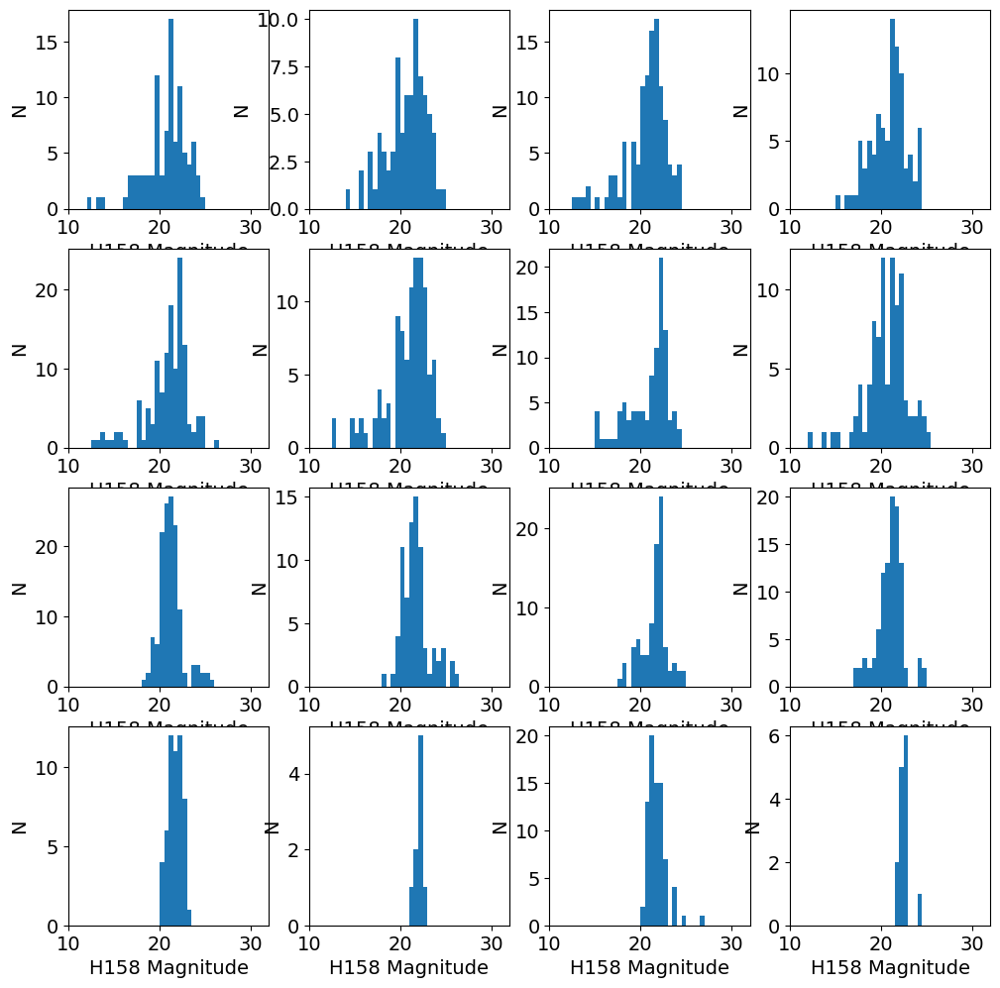

In [43]:
fig = plt.figure(figsize=(12,12))

k = 0
for phot in all_phot:

    print(np.min(phot["MAG_AUTO"]),np.max(phot["MAG_AUTO"]))
    
    p = fig.add_subplot(4,4,k+1)
    p.hist(phot["MAG_AUTO"],range=(10,32),bins=44)
    p.set_xlabel("H158 Magnitude")
    p.set_ylabel("N")
    p.set_xlim(10,32)
    
    k += 1
    
    plt.show

In [44]:
for phot in all_phot:
    print(phot)

NUMBER  X_IMAGE   Y_IMAGE  ... FLUX_RADIUS FLUX_RADIUS_1 CLASS_STAR
          pix       pix    ...     pix          pix                
------ --------- --------- ... ----------- ------------- ----------
     1 1059.2216  184.5753 ...       1.534         3.213      0.069
     2  370.2293 2003.6804 ...        0.91         1.756      0.003
     3  361.4108  2003.425 ...       1.556         3.397      0.838
     4  361.3322 1994.7811 ...       1.255         2.528      0.018
     5  361.4016 1967.4136 ...       1.507         3.348      0.029
     6 1759.6542  1966.308 ...       1.435         2.681      0.078
   ...       ...       ... ...         ...           ...        ...
    91 1059.4773  301.3197 ...       1.017         1.941      0.082
    92 1068.3667  292.2939 ...       0.988         2.078      0.674
    93 1059.4199  292.4184 ...       1.549          3.39      0.845
    94 1050.6207  292.4983 ...       0.936         1.786      0.031
    95  1059.483  283.6851 ...       1.043      

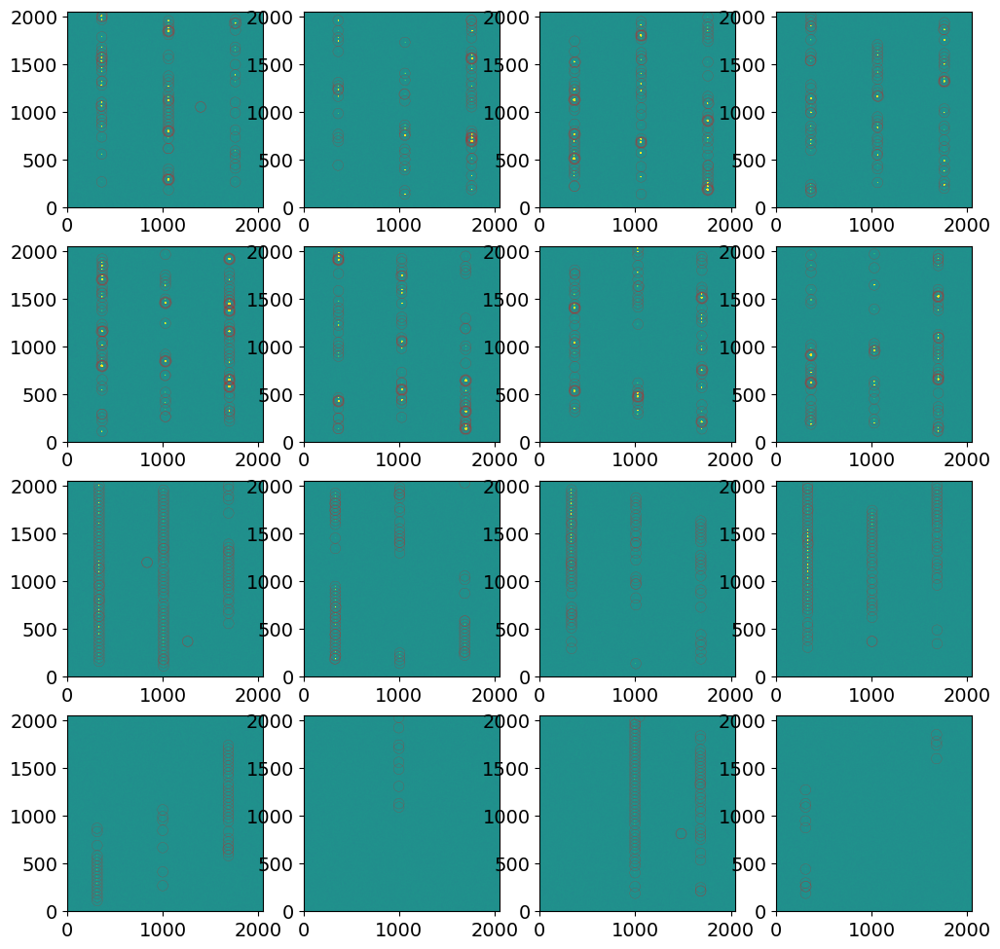

In [45]:
plot_labels = 0

fig = plt.figure(figsize=(12,12))

k = 0
for direct,phot in zip(all_direct,all_phot):

    hdu = pyfits.open(direct)
    img = hdu[1].data
    
    p1 = fig.add_subplot(4,4,k+1)
    p1.imshow(img,origin="lower",vmin=-0.1,vmax=0.1)
    p1.scatter(phot["X_IMAGE"],phot["Y_IMAGE"],fc="None",ec="r",s=60,lw=0.1)

    if plot_labels:
        for j,src in enumerate(phot['NUMBER']):
            p1.text(phot['X_IMAGE'][j],phot['Y_IMAGE'][j],src)
    
    k += 1
plt.show()

Euclid_DET11_direct_final.fits
Total number of sources found = 97
Search primer and all_tbl for RA/DEC matches
Join all_tbl and primer tables
Select only sources < 0.60 arcsec
[3, 11, 16, 19, 20, 21, 22, 24, 25, 26, 31, 32, 35, 36, 37, 38, 39, 40, 41, 42, 45, 50, 51, 210, 213, 214, 215, 216, 222, 225, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 240, 241, 242, 243, 248, 249, 255, 256, 257, 258, 259, 419, 423, 424, 426, 427, 428, 432, 434, 439, 442, 448, 450, 453, 457, 458, 463, 465, 466]
Number of matches = 71

Euclid_DET12_direct_final.fits
Total number of sources found = 77
Search primer and all_tbl for RA/DEC matches
Join all_tbl and primer tables
Select only sources < 0.60 arcsec
[59, 66, 67, 68, 74, 79, 81, 82, 83, 92, 95, 96, 98, 101, 260, 261, 267, 268, 270, 272, 273, 277, 278, 279, 280, 287, 289, 293, 295, 304, 468, 469, 472, 475, 477, 480, 482, 483, 484, 485, 492, 493, 494, 495, 496, 498, 499, 501, 503, 504, 506, 507, 508, 512, 514, 515, 516, 517]
Number of matc

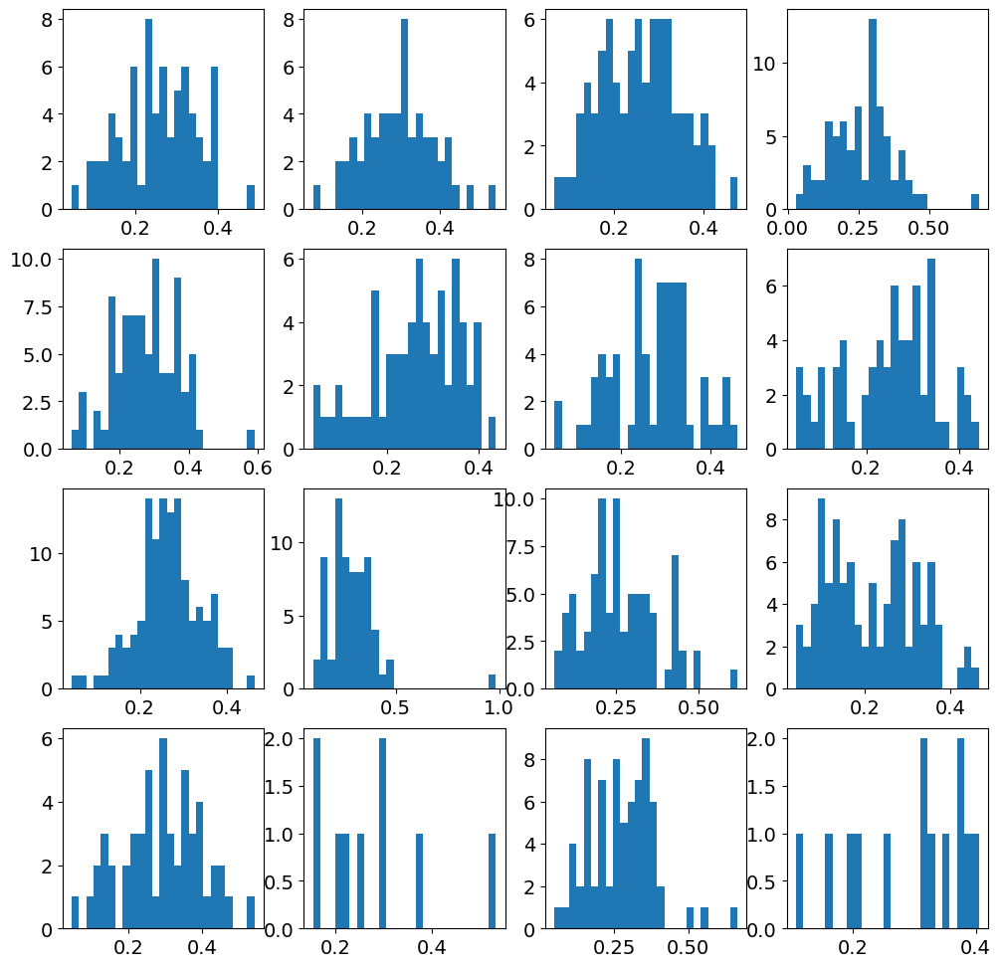

In [46]:
from astropy.table import Table, join, vstack
import astropy.units as u
from astropy.coordinates import SkyCoord

verb = 1
search_rad = 0.6

if verb:
    fig = plt.figure(figsize=(12,12))

all_phot_matched_clean = []
    
k = 0
for i,phot in enumerate(all_phot):

    print(all_final_direct[i])
    print("Total number of sources found =",len(phot))
    print("Search primer and all_tbl for RA/DEC matches")
    c_prime = SkyCoord(ra=primer["RA"]*u.degree, dec=primer["DEC"]*u.degree)
    c_phot = SkyCoord(ra=phot["X_WORLD"], dec=phot["Y_WORLD"])

    #idx, d2d, d3d = c_prime.match_to_catalog_sky(c_phot)
    idx, d2d, d3d = c_phot.match_to_catalog_sky(c_prime)

    filt = d2d < 1*u.arcsec

    if verb:
        p1 = fig.add_subplot(4,4,k+1)
        p1.hist(d2d[filt].value*3600.,bins=25)
        
    #primer['idx'] = idx
    #primer['d2d'] = d2d

    phot['idx'] = idx
    phot['d2d'] = d2d
    #print(primer.colnames)
        
    #phot['idx'] = np.arange(len(phot))
    primer['idx'] = np.arange(len(primer))
    #print(all_tbl.colnames)
    #print(all_tbl['idx'])
        
    print("Join all_tbl and primer tables")
    match_tbl = join(phot, primer, keys='idx')
    #print(match_tbl)
    #print(match_tbl.colnames)
        
    print("Select only sources < %.2f arcsec" % (search_rad))
    #filt = match_tbl['d2d'] < 1.0*u.arcsec
    clean_filt = match_tbl['d2d'] < search_rad*u.arcsec
    match_clean_tbl = match_tbl[clean_filt]
    print(list(match_clean_tbl['idx']))
    print("Number of matches =",len(match_clean_tbl))
    print()
    
    all_phot_matched_clean.append(match_clean_tbl)
    
    k+=1
        

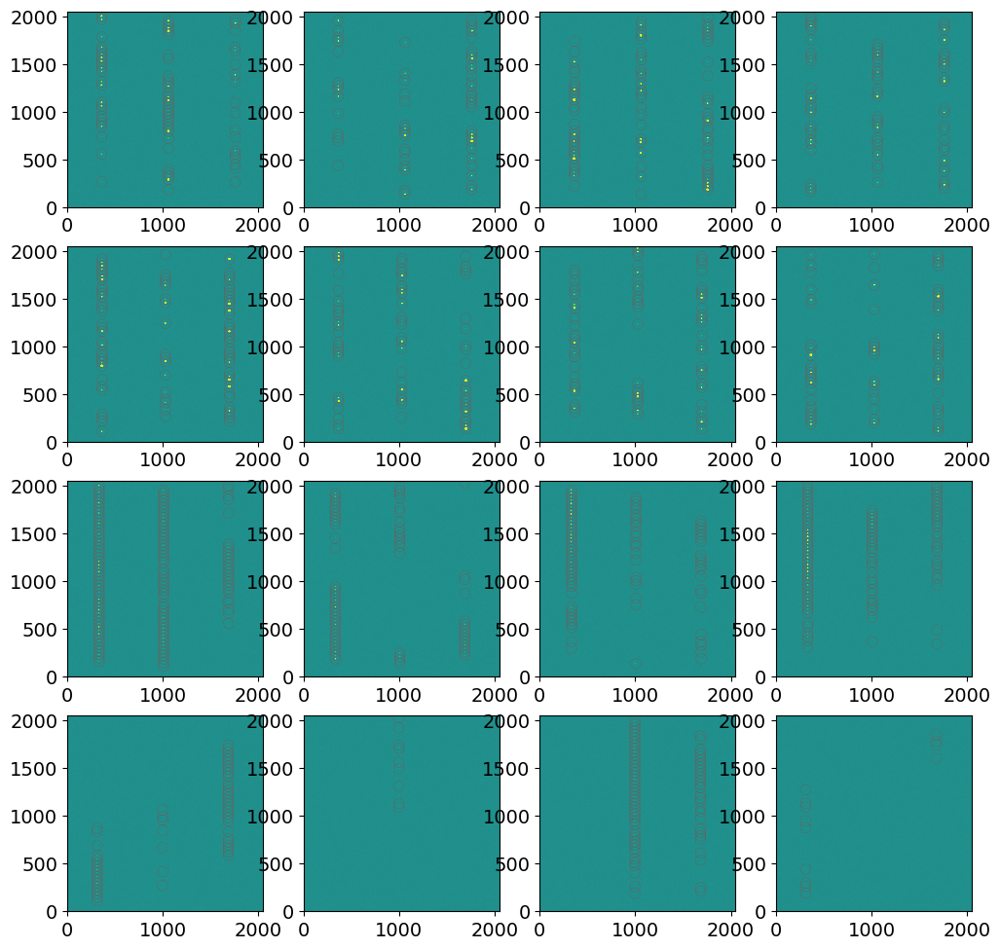

In [47]:
plot_labels = 0

fig = plt.figure(figsize=(12,12))

k = 0    
for direct,match_clean_tbl in zip(all_direct,all_phot_matched_clean):

    hdu = pyfits.open(direct)
    img = hdu[1].data

    p1 = fig.add_subplot(4,4,k+1)
    p1.imshow(img,origin="lower",vmin=-0.1,vmax=0.1)
    #p1.scatter(phot["X_IMAGE"],phot["Y_IMAGE"],fc="None",ec="r",s=60)
    p1.scatter(match_clean_tbl['X_IMAGE'],match_clean_tbl['Y_IMAGE'],lw=0.1,fc="None",ec="r",s=60)
    
    if plot_labels:
        for j,src in enumerate(match_clean_tbl['SOURCE_ID']):
            #print(j)
            p1.text(match_clean_tbl['X_IMAGE'][j],match_clean_tbl['Y_IMAGE'][j],src)
    k += 1
plt.show()

## Euclid object simulation
[top](#Table-of-Contents)

In [ ]:
import importlib
importlib.reload(grizli.model)

In [48]:
T0 = time.time()

os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

# allow simulation of objects at the edges
pad=100 # pixels
#pad = 800 # I think this may be optimal given the spectra size (only seems to add 10-20 spectra)

mag_limit = 30 

all_euclid = []

for i in range(len(all_final_slitless)):
    
    t0 = time.time()

    Euclid = grizli.model.GrismFLT(grism_file=all_final_slitless[i], verbose=True, pad=pad,  
                                   ref_file=all_final_direct[i], ref_ext=1,
                                   seg_file=all_seg[i], 
                                   #shrink_segimage=False)
                                   shrink_segimage=True)

    Euclid_cat = Euclid.blot_catalog(all_phot_matched_clean[i], sextractor=True) 
    #Euclid_cat = Euclid.blot_catalog(all_phot[i], sextractor=True) 
    Euclid.catalog = Euclid_cat

    mask = Euclid_cat['MAG_AUTO'] < mag_limit
    print('N=%d' %(mask.sum()))
    #Euclid.compute_full_model(compute_beams=['A'], mask=mask, verbose=False)
    Euclid.compute_full_model(ids=Euclid_cat['NUMBER'][mask], mags=Euclid_cat['MAG_AUTO'][mask])
    #Euclid.compute_full_model(ids=Euclid_cat['NUMBER'][mask], mags=Euclid_cat['MAG_AUTO'][mask], verbose=True)

    all_euclid.append(Euclid)
    
    t1 = time.time()
    
    print("Detector finished in %.1f seconds" % (t1-t0))
    
    
T1 = time.time()

print()
print("Finished in %.1f seconds" % (T1-T0))

Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET11_slitless_final.fits / blot reference Euclid_DET11_direct_final.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET11_slitless_final.fits / Pad ref HDU with 250 pixels
Euclid_DET11_slitless_final.fits / blot segmentation Euclid_DET11_direct_final_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=71
Detector finished in 1.3 seconds
Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET12_slitless_final.fits / blot reference Euclid_DET12_direct_final.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET12_slitless_final.fits / Pad ref HDU with 250 pixels
Euclid_DET12_slitless_final.fits / blot segmentation Euclid_DET12_dir

Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET43_slitless_final.fits / Pad ref HDU with 250 pixels
Euclid_DET43_slitless_final.fits / blot segmentation Euclid_DET43_direct_final_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=72
Detector finished in 1.3 seconds
Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET44_slitless_final.fits / blot reference Euclid_DET44_direct_final.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(0, 2048, None), y=slice(0, 2048, None) [Out of range]
Euclid_DET44_slitless_final.fits / Pad ref HDU with 250 pixels
Euclid_DET44_slitless_final.fits / blot segmentation Euclid_DET44_direct_final_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=13
Detector finished in 1.1 seconds

Finished in 21.3 seconds


In [49]:
print(all_euclid)

[<grizli.model.GrismFLT object at 0x297b9d610>, <grizli.model.GrismFLT object at 0x2b26656a0>, <grizli.model.GrismFLT object at 0x2959534f0>, <grizli.model.GrismFLT object at 0x2b3b61610>, <grizli.model.GrismFLT object at 0x2a6aa2520>, <grizli.model.GrismFLT object at 0x2a6a77070>, <grizli.model.GrismFLT object at 0x2a6a00e20>, <grizli.model.GrismFLT object at 0x2b3ac0ca0>, <grizli.model.GrismFLT object at 0x295a22310>, <grizli.model.GrismFLT object at 0x2b3a594c0>, <grizli.model.GrismFLT object at 0x2a69e5ac0>, <grizli.model.GrismFLT object at 0x2b3a0ac10>, <grizli.model.GrismFLT object at 0x295a1b850>, <grizli.model.GrismFLT object at 0x295a1ba60>, <grizli.model.GrismFLT object at 0x295a1b8b0>, <grizli.model.GrismFLT object at 0x297c17460>]


In [50]:
t0 = time.time()

print(all_euclid)

import pickle

# ~ 5GB file
with open('Euclid_GrismFLT.pickle', 'wb') as f:
    # Pickle the 'data' dictionary using the highest protocol available.
    pickle.dump(all_euclid, f, pickle.HIGHEST_PROTOCOL)
    
t1 = time.time()

print()
print("Finished in %.1f seconds" % (t1-t0))

[<grizli.model.GrismFLT object at 0x297b9d610>, <grizli.model.GrismFLT object at 0x2b26656a0>, <grizli.model.GrismFLT object at 0x2959534f0>, <grizli.model.GrismFLT object at 0x2b3b61610>, <grizli.model.GrismFLT object at 0x2a6aa2520>, <grizli.model.GrismFLT object at 0x2a6a77070>, <grizli.model.GrismFLT object at 0x2a6a00e20>, <grizli.model.GrismFLT object at 0x2b3ac0ca0>, <grizli.model.GrismFLT object at 0x295a22310>, <grizli.model.GrismFLT object at 0x2b3a594c0>, <grizli.model.GrismFLT object at 0x2a69e5ac0>, <grizli.model.GrismFLT object at 0x2b3a0ac10>, <grizli.model.GrismFLT object at 0x295a1b850>, <grizli.model.GrismFLT object at 0x295a1ba60>, <grizli.model.GrismFLT object at 0x295a1b8b0>, <grizli.model.GrismFLT object at 0x297c17460>]

Finished in 0.9 seconds


In [ ]:
t0 = time.time()

import pickle

with open('Euclid_GrismFLT.pickle', 'rb') as f:
    # The protocol version used is detected automatically, so we do not
    # have to specify it.
    all_euclid = pickle.load(f)
    
t1 = time.time()

print()
print("Finished in %.1f seconds" % (t1-t0))

In [51]:
print(all_euclid)
print(type(all_euclid))
print(len(all_euclid))
#print(all_euclid[0].__dict__)

[<grizli.model.GrismFLT object at 0x297b9d610>, <grizli.model.GrismFLT object at 0x2b26656a0>, <grizli.model.GrismFLT object at 0x2959534f0>, <grizli.model.GrismFLT object at 0x2b3b61610>, <grizli.model.GrismFLT object at 0x2a6aa2520>, <grizli.model.GrismFLT object at 0x2a6a77070>, <grizli.model.GrismFLT object at 0x2a6a00e20>, <grizli.model.GrismFLT object at 0x2b3ac0ca0>, <grizli.model.GrismFLT object at 0x295a22310>, <grizli.model.GrismFLT object at 0x2b3a594c0>, <grizli.model.GrismFLT object at 0x2a69e5ac0>, <grizli.model.GrismFLT object at 0x2b3a0ac10>, <grizli.model.GrismFLT object at 0x295a1b850>, <grizli.model.GrismFLT object at 0x295a1ba60>, <grizli.model.GrismFLT object at 0x295a1b8b0>, <grizli.model.GrismFLT object at 0x297c17460>]
<class 'list'>
16


## Check simulation
[top](#Table-of-Contents)

Possible problem with the aXeSIM conf file.  This function checks if the OrderDict exists within GrismFLT class.

In [ ]:
#########
# Tests #
#########

#number = list(all_euclid[0].catalog["NUMBER"])
#N = len(all_euclid[0].catalog)
#index = list(range(N))
#print(number)
#print(N)
#print(index)
mag_limit = 20
mask = all_euclid[0].catalog['MAG_AUTO'] < mag_limit
print(mask)

print(all_euclid[0].catalog[mask])

#########################################################

catalog = all_euclid[0].catalog["NUMBER"]
number = np.array([87,28,56,6])

indices = [list(catalog).index(i) for i in number]
print(indices)
print(list(catalog[indices]))
print(all_euclid[0].catalog[indices])

#########################################################

value = np.array([ 27., 51., 39.,  1.,  2.,100., 10.])
mask  = [   0,   0,   0,   1,   1,   1,   0]

print(np.where(mask))
print(np.nonzero(mask))

indices = np.where(mask)
print(value[indices])

###########################################################

In [52]:
mag_limit = 30

In [53]:
def check_sims2(sim, mag_limit):

    mask = sim.catalog['MAG_AUTO'] < mag_limit

    all_cat = sim.catalog
    magcut_cat = sim.catalog[mask]

    new_ids = []
    for id in sim.object_dispersers:
        is_cgs, spectrum_1d, beam = sim.object_dispersers[id]
        if len(beam) > 0:
            new_ids.append(id)

    new_ids = np.array(new_ids)
    #print(new_ids)

    # catalog accepts either indices or boolean mask
    indices = [list(sim.catalog["NUMBER"]).index(i) for i in new_ids]
    extract_cat = sim.catalog[indices]

    print("All sources   =",len(all_cat))
    print("Magnitude cut =",len(magcut_cat))
    print("Simulated     =",len(new_ids))
    print()
    #print(len(extract_cat))

    return all_cat,magcut_cat,extract_cat


In [54]:
all_euclid_srcs = []

for i,euclid in enumerate(all_euclid):
    #Euclid_all,Euclid_magcut,Euclid_extract = check_sims(euclid, mag_limit)
    #print(euclid.catalog["MAG_AUTO"])
    #print(euclid.object_dispersers)
    #print(len(euclid.object_dispersers))
    #print(euclid.object_dispersers[93])
    #############################################
    # These are the actual Source Extractor IDs #
    #############################################
    #for id in euclid.object_dispersers:
        #print(id)
        #print(id, euclid.object_dispersers[id])
        #print(len(euclid.object_dispersers[id]))
    #print([(j,id) for j,id in enumerate(euclid.object_dispersers)])
    #sim.object_dispersers.index(id)
    #print(all_det[i])
    all_euclid_srcs.append(check_sims2(euclid, mag_limit))


All sources   = 71
Magnitude cut = 71
Simulated     = 71

All sources   = 58
Magnitude cut = 58
Simulated     = 58

All sources   = 81
Magnitude cut = 81
Simulated     = 81

All sources   = 73
Magnitude cut = 73
Simulated     = 73

All sources   = 82
Magnitude cut = 82
Simulated     = 82

All sources   = 66
Magnitude cut = 66
Simulated     = 66

All sources   = 70
Magnitude cut = 70
Simulated     = 70

All sources   = 66
Magnitude cut = 66
Simulated     = 66

All sources   = 127
Magnitude cut = 127
Simulated     = 127

All sources   = 67
Magnitude cut = 67
Simulated     = 67

All sources   = 80
Magnitude cut = 80
Simulated     = 80

All sources   = 97
Magnitude cut = 97
Simulated     = 97

All sources   = 53
Magnitude cut = 53
Simulated     = 53

All sources   = 9
Magnitude cut = 9
Simulated     = 9

All sources   = 72
Magnitude cut = 72
Simulated     = 72

All sources   = 13
Magnitude cut = 13
Simulated     = 13



In [55]:
print(all_euclid_srcs)

[(<Table length=71>
NUMBER  X_IMAGE   Y_IMAGE    X_WORLD    ...   id       ra          dec     
          pix       pix        deg      ...           deg          deg     
int64   float64   float64    float64    ... int64   float64      float64   
------ --------- --------- ------------ ... ----- ------------ ------------
    96  360.3588  268.2867 228.74655133 ...    96 228.74655133 6.2528997811
    83   360.451  558.4413 228.74656074 ...    83 228.74656074 6.2769915026
    78  360.3647  738.3245 228.74657856 ...    78 228.74657856 6.2919273717
    69  360.4222  847.4585 228.74658019 ...    69 228.74658019 6.3009888917
    67  360.2897  883.4308 228.74659338 ...    67 228.74659338 6.3039757143
    65  360.0087  919.3981 228.74661898 ...    65 228.74661898 6.3069621048
   ...       ...       ...          ... ...   ...          ...          ...
    33 1758.8505 1496.2614  228.6297863 ...    33  228.6297863 6.3549259571
    23 1758.4436 1641.4188 228.62982602 ...    23 228.62982602 6.366

In [56]:
# Euclid_extract
print(all_euclid_srcs[0][2])

NUMBER  X_IMAGE   Y_IMAGE    X_WORLD    ...  id      ra          dec     
          pix       pix        deg      ...         deg          deg     
------ --------- --------- ------------ ... --- ------------ ------------
    96  360.3588  268.2867 228.74655133 ...  96 228.74655133 6.2528997811
    83   360.451  558.4413 228.74656074 ...  83 228.74656074 6.2769915026
    78  360.3647  738.3245 228.74657856 ...  78 228.74657856 6.2919273717
    69  360.4222  847.4585 228.74658019 ...  69 228.74658019 6.3009888917
    67  360.2897  883.4308 228.74659338 ...  67 228.74659338 6.3039757143
    65  360.0087  919.3981 228.74661898 ...  65 228.74661898 6.3069621048
   ...       ...       ...          ... ... ...          ...          ...
    37 1758.4301 1388.3914 228.62981718 ...  37 228.62981718 6.3459691987
    33 1758.8505 1496.2614  228.6297863 ...  33  228.6297863 6.3549259571
    23 1758.4436 1641.4188 228.62982602 ...  23 228.62982602 6.3669787777
    21 1758.3964  1677.502 228.6298313

In [ ]:
new_ids = [93,80,75]
all_euclid[0].catalog

## Loop over all objects and fit their redshifts
[top](#Table-of-Contents)

In [57]:
os.chdir(os.path.join(HOME_PATH, root, 'Extractions'))

In [58]:
total_Nl = 0

all_Nl = []
for i,euclid_srcs in enumerate(all_euclid_srcs):
    euclid_all,euclid_magcut,euclid_extract = euclid_srcs
    Nl = [id for id in euclid_extract['NUMBER']]
    print(all_det[i],"number_of_sources =",len(Nl))
    all_Nl.append(Nl)
    
    total_Nl += len(Nl)

print()
print("Total sources for all detectors =",  total_Nl)
print(all_Nl)

DET11 number_of_sources = 71
DET12 number_of_sources = 58
DET13 number_of_sources = 81
DET14 number_of_sources = 73
DET21 number_of_sources = 82
DET22 number_of_sources = 66
DET23 number_of_sources = 70
DET24 number_of_sources = 66
DET31 number_of_sources = 127
DET32 number_of_sources = 67
DET33 number_of_sources = 80
DET34 number_of_sources = 97
DET41 number_of_sources = 53
DET42 number_of_sources = 9
DET43 number_of_sources = 72
DET44 number_of_sources = 13

Total sources for all detectors = 1085
[[96, 83, 78, 69, 67, 65, 63, 59, 54, 51, 44, 41, 36, 35, 34, 31, 28, 25, 24, 22, 20, 5, 3, 1, 93, 90, 89, 88, 80, 79, 75, 70, 68, 66, 64, 62, 60, 58, 53, 50, 47, 46, 45, 43, 39, 38, 30, 26, 19, 16, 12, 11, 7, 97, 87, 86, 85, 84, 82, 77, 71, 61, 52, 42, 37, 33, 23, 21, 13, 9, 6], [70, 63, 57, 49, 42, 36, 31, 28, 26, 13, 11, 9, 8, 2, 1, 77, 73, 72, 69, 66, 65, 51, 46, 44, 43, 39, 34, 25, 23, 12, 76, 75, 74, 71, 67, 64, 60, 54, 47, 45, 41, 40, 38, 37, 33, 29, 27, 24, 22, 21, 19, 15, 14, 10, 7,

In [ ]:
import importlib
importlib.reload(grizli.fitting)

In [ ]:
import importlib
importlib.reload(grizli.multifit)

In [60]:
# subset
all_Nl = [all_Nl[0]]

Fitting redshifts for DET11
id = 96
1 of 71
beam_00096.grism.A.fits
Euclid_DET11_00096.beams.fits
load_master_fits: Euclid_DET11_00096.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     365.5 (0.0500) 1/335
  0.0542     357.4 (0.0542) 2/335
  0.0584     350.4 (0.0584) 3/335
  0.0627     344.5 (0.0627) 4/335
  0.0669     338.6 (0.0669) 5/335
  0.0712     333.2 (0.0712) 6/335
  0.0755     329.9 (0.0755) 7/335
  0.0798     326.3 (0.0798) 8/335
  0.0841     323.2 (0.0841) 9/335
  0.0885     321.2 (0.0885) 10/335
  0.0929     319.1 (0.0929) 11/335
  0.0972     317.5 (0.0972) 12/335
  0.1016     317.1 (0.1016) 13/335
  0.1060     316.9 (0.1060) 14/335
  0.1105     317.3 (0.1060) 15/335
  0.1149     318.4 (0.1060) 16/335
  0.1194     319.6 (0.1060) 17/335
  0.1239     320.2 (0.1060) 18/335
  0.1284     321.5 (0.1060) 19/335
  0.1329     323.0 (0.1060) 20/335
  0.1375     324.3 (0.1060) 21/335
  0.1420     325.8 (0.1060) 22/335
  0.1466     327.6 (0.1060) 23/

  1.3650     269.7 (1.2273) 204/335
  1.3745     268.6 (1.2273) 205/335
  1.3840     268.9 (1.2273) 206/335
  1.3936     270.0 (1.2273) 207/335
  1.4032     270.4 (1.2273) 208/335
  1.4128     269.5 (1.2273) 209/335
  1.4225     269.9 (1.2273) 210/335
  1.4322     269.4 (1.2273) 211/335
  1.4419     268.9 (1.2273) 212/335
  1.4517     269.9 (1.2273) 213/335
  1.4615     270.3 (1.2273) 214/335
  1.4714     272.2 (1.2273) 215/335
  1.4813     276.2 (1.2273) 216/335
  1.4913     277.5 (1.2273) 217/335
  1.5012     276.5 (1.2273) 218/335
  1.5113     273.6 (1.2273) 219/335
  1.5213     271.8 (1.2273) 220/335
  1.5314     271.9 (1.2273) 221/335
  1.5416     272.5 (1.2273) 222/335
  1.5518     272.4 (1.2273) 223/335
  1.5620     272.1 (1.2273) 224/335
  1.5723     270.8 (1.2273) 225/335
  1.5826     270.5 (1.2273) 226/335
  1.5929     271.7 (1.2273) 227/335
  1.6033     272.4 (1.2273) 228/335
  1.6138     270.4 (1.2273) 229/335
  1.6242     269.9 (1.2273) 230/335
  1.6348     269.6 (1.2273) 

- 1.2338     266.7 (1.2302) 74/243
- 1.2340     266.8 (1.2302) 75/243
- 1.2342     266.8 (1.2302) 76/243
- 1.2344     266.8 (1.2302) 77/243
- 1.2346     266.9 (1.2302) 78/243
- 1.2348     266.9 (1.2302) 79/243
- 1.2350     267.0 (1.2302) 80/243
- 1.2352     267.0 (1.2302) 81/243
- 0.8736     266.7 (1.2302) 82/243
- 0.8738     266.7 (1.2302) 83/243
- 0.8740     266.7 (1.2302) 84/243
- 0.8742     266.7 (1.2302) 85/243
- 0.8744     266.8 (1.2302) 86/243
- 0.8746     266.8 (1.2302) 87/243
- 0.8748     266.8 (1.2302) 88/243
- 0.8750     266.8 (1.2302) 89/243
- 0.8752     266.8 (1.2302) 90/243
- 0.8754     266.8 (1.2302) 91/243
- 0.8756     266.7 (1.2302) 92/243
- 0.8758     266.7 (1.2302) 93/243
- 0.8760     266.6 (1.2302) 94/243
- 0.8762     266.6 (1.2302) 95/243
- 0.8764     266.6 (1.2302) 96/243
- 0.8766     266.6 (1.2302) 97/243
- 0.8768     266.6 (1.2302) 98/243
- 0.8770     266.5 (1.2302) 99/243
- 0.8772     266.5 (1.2302) 100/243
- 0.8774     266.4 (1.2302) 101/243
- 0.8776     266.4

  1.2476     267.1 (1.2297) 29/41
  1.2498     267.0 (1.2297) 30/41
  1.2521     267.1 (1.2297) 31/41
  1.2543     266.8 (1.2297) 32/41
  1.2566     266.7 (1.2297) 33/41
  1.2588     267.0 (1.2297) 34/41
  1.2611     267.3 (1.2297) 35/41
  1.2634     267.7 (1.2297) 36/41
  1.2656     267.7 (1.2297) 37/41
  1.2679     267.4 (1.2297) 38/41
  1.2702     267.2 (1.2297) 39/41
  1.2724     267.3 (1.2297) 40/41
  1.2747     267.6 (1.2297) 41/41
First iteration: z_best=1.2297

- 1.2270     266.1 (1.2270) 1/63
- 1.2272     266.1 (1.2272) 2/63
- 1.2274     266.1 (1.2274) 3/63
- 1.2276     266.1 (1.2276) 4/63
- 1.2278     266.1 (1.2278) 5/63
- 1.2280     266.1 (1.2280) 6/63
- 1.2282     266.1 (1.2282) 7/63
- 1.2284     266.1 (1.2282) 8/63
- 1.2286     266.1 (1.2282) 9/63
- 1.2288     266.1 (1.2282) 10/63
- 1.2290     266.1 (1.2282) 11/63
- 1.2292     266.1 (1.2282) 12/63
- 1.2294     266.1 (1.2282) 13/63
- 1.2296     266.0 (1.2296) 14/63
- 1.2298     266.0 (1.2298) 15/63
- 1.2300     266.0 (1.230

 [astropy.io.fits.verify]


id = 83
2 of 71
beam_00083.grism.A.fits
Euclid_DET11_00083.beams.fits
load_master_fits: Euclid_DET11_00083.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1187.4 (0.0500) 1/335
  0.0542    1174.2 (0.0542) 2/335
  0.0584    1163.7 (0.0584) 3/335
  0.0627    1155.1 (0.0627) 4/335
  0.0669    1146.4 (0.0669) 5/335
  0.0712    1138.7 (0.0712) 6/335
  0.0755    1132.7 (0.0755) 7/335
  0.0798    1125.4 (0.0798) 8/335
  0.0841    1119.6 (0.0841) 9/335
  0.0885    1116.1 (0.0885) 10/335
  0.0929    1112.0 (0.0929) 11/335
  0.0972    1109.0 (0.0972) 12/335
  0.1016    1108.3 (0.1016) 13/335
  0.1060    1107.5 (0.1060) 14/335
  0.1105    1108.2 (0.1060) 15/335
  0.1149    1111.1 (0.1060) 16/335
  0.1194    1113.2 (0.1060) 17/335
  0.1239    1115.6 (0.1060) 18/335
  0.1284    1117.9 (0.1060) 19/335
  0.1329    1118.5 (0.1060) 20/335
  0.1375    1119.1 (0.1060) 21/335
  0.1420    1121.2 (0.1060) 22/335
  0.1466    1123.8 (0.1060) 23/335
  0.1512    1125.9 (0.10

  1.3462    1063.6 (1.2542) 202/335
  1.3556    1065.7 (1.2542) 203/335
  1.3650    1067.9 (1.2542) 204/335
  1.3745    1068.5 (1.2542) 205/335
  1.3840    1070.2 (1.2542) 206/335
  1.3936    1070.1 (1.2542) 207/335
  1.4032    1068.0 (1.2542) 208/335
  1.4128    1066.8 (1.2542) 209/335
  1.4225    1066.3 (1.2542) 210/335
  1.4322    1064.9 (1.2542) 211/335
  1.4419    1064.2 (1.2542) 212/335
  1.4517    1064.1 (1.2542) 213/335
  1.4615    1064.4 (1.2542) 214/335
  1.4714    1070.5 (1.2542) 215/335
  1.4813    1081.7 (1.2542) 216/335
  1.4913    1079.9 (1.2542) 217/335
  1.5012    1077.8 (1.2542) 218/335
  1.5113    1076.1 (1.2542) 219/335
  1.5213    1073.9 (1.2542) 220/335
  1.5314    1075.0 (1.2542) 221/335
  1.5416    1073.5 (1.2542) 222/335
  1.5518    1072.9 (1.2542) 223/335
  1.5620    1071.9 (1.2542) 224/335
  1.5723    1069.5 (1.2542) 225/335
  1.5826    1065.9 (1.2542) 226/335
  1.5929    1066.9 (1.2542) 227/335
  1.6033    1069.2 (1.2542) 228/335
  1.6138    1068.0 (1.2542) 

- 1.2588    1055.6 (1.2558) 58/243
- 1.2590    1055.7 (1.2558) 59/243
- 1.2592    1055.7 (1.2558) 60/243
- 1.2594    1055.8 (1.2558) 61/243
- 1.2596    1055.8 (1.2558) 62/243
- 1.2598    1055.8 (1.2558) 63/243
- 1.2600    1055.8 (1.2558) 64/243
- 1.2602    1055.9 (1.2558) 65/243
- 1.2604    1055.9 (1.2558) 66/243
- 1.2606    1055.9 (1.2558) 67/243
- 1.2608    1056.0 (1.2558) 68/243
- 1.2610    1056.0 (1.2558) 69/243
- 1.2612    1056.1 (1.2558) 70/243
- 1.2614    1056.1 (1.2558) 71/243
- 1.2616    1056.1 (1.2558) 72/243
- 1.2618    1056.1 (1.2558) 73/243
- 1.2620    1056.2 (1.2558) 74/243
- 1.2622    1056.2 (1.2558) 75/243
- 1.2624    1056.2 (1.2558) 76/243
- 1.2626    1056.3 (1.2558) 77/243
- 1.2628    1056.3 (1.2558) 78/243
- 1.2630    1056.4 (1.2558) 79/243
- 1.2632    1056.4 (1.2558) 80/243
- 1.2634    1056.4 (1.2558) 81/243
- 0.8538    1057.7 (1.2558) 82/243
- 0.8540    1057.6 (1.2558) 83/243
- 0.8542    1057.6 (1.2558) 84/243
- 0.8544    1057.6 (1.2558) 85/243
- 0.8546    1057.5 (

  1.2463    1057.1 (1.2463) 17/41
  1.2485    1056.6 (1.2485) 18/41
  1.2508    1056.1 (1.2508) 19/41
  1.2530    1055.5 (1.2530) 20/41
  1.2553    1055.0 (1.2553) 21/41
  1.2575    1055.3 (1.2553) 22/41
  1.2598    1055.8 (1.2553) 23/41
  1.2620    1056.2 (1.2553) 24/41
  1.2643    1056.3 (1.2553) 25/41
  1.2666    1056.9 (1.2553) 26/41
  1.2688    1057.6 (1.2553) 27/41
  1.2711    1058.3 (1.2553) 28/41
  1.2734    1058.5 (1.2553) 29/41
  1.2757    1058.6 (1.2553) 30/41
  1.2779    1059.3 (1.2553) 31/41
  1.2802    1060.0 (1.2553) 32/41
  1.2825    1060.5 (1.2553) 33/41
  1.2848    1061.1 (1.2553) 34/41
  1.2871    1061.9 (1.2553) 35/41
  1.2893    1062.5 (1.2553) 36/41
  1.2916    1063.5 (1.2553) 37/41
  1.2939    1064.3 (1.2553) 38/41
  1.2962    1064.7 (1.2553) 39/41
  1.2985    1064.5 (1.2553) 40/41
  1.3008    1064.3 (1.2553) 41/41
First iteration: z_best=1.2553

- 1.2536    1055.3 (1.2536) 1/21
- 1.2538    1055.3 (1.2538) 2/21
- 1.2540    1055.2 (1.2540) 3/21
- 1.2542    1055.1 

 [astropy.io.fits.verify]


id = 78
3 of 71
beam_00078.grism.A.fits
Euclid_DET11_00078.beams.fits
load_master_fits: Euclid_DET11_00078.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     319.5 (0.0500) 1/335
  0.0542     310.7 (0.0542) 2/335
  0.0584     302.4 (0.0584) 3/335
  0.0627     294.4 (0.0627) 4/335
  0.0669     287.8 (0.0669) 5/335
  0.0712     282.8 (0.0712) 6/335
  0.0755     278.7 (0.0755) 7/335
  0.0798     275.1 (0.0798) 8/335
  0.0841     272.6 (0.0841) 9/335
  0.0885     269.2 (0.0885) 10/335
  0.0929     266.8 (0.0929) 11/335
  0.0972     265.6 (0.0972) 12/335
  0.1016     265.2 (0.1016) 13/335
  0.1060     265.0 (0.1060) 14/335
  0.1105     265.1 (0.1060) 15/335
  0.1149     266.2 (0.1060) 16/335
  0.1194     267.4 (0.1060) 17/335
  0.1239     268.2 (0.1060) 18/335
  0.1284     269.4 (0.1060) 19/335
  0.1329     271.5 (0.1060) 20/335
  0.1375     273.3 (0.1060) 21/335
  0.1420     275.5 (0.1060) 22/335
  0.1466     277.5 (0.1060) 23/335
  0.1512     278.5 (0.10

  1.2542     207.1 (1.2362) 192/335
  1.2632     207.7 (1.2362) 193/335
  1.2723     207.9 (1.2362) 194/335
  1.2814     208.6 (1.2362) 195/335
  1.2905     209.7 (1.2362) 196/335
  1.2997     210.5 (1.2362) 197/335
  1.3089     210.2 (1.2362) 198/335
  1.3182     209.9 (1.2362) 199/335
  1.3275     209.8 (1.2362) 200/335
  1.3368     211.6 (1.2362) 201/335
  1.3462     212.1 (1.2362) 202/335
  1.3556     211.7 (1.2362) 203/335
  1.3650     211.6 (1.2362) 204/335
  1.3745     211.5 (1.2362) 205/335
  1.3840     211.8 (1.2362) 206/335
  1.3936     211.8 (1.2362) 207/335
  1.4032     211.6 (1.2362) 208/335
  1.4128     212.3 (1.2362) 209/335
  1.4225     211.8 (1.2362) 210/335
  1.4322     212.3 (1.2362) 211/335
  1.4419     212.7 (1.2362) 212/335
  1.4517     212.9 (1.2362) 213/335
  1.4615     212.8 (1.2362) 214/335
  1.4714     214.1 (1.2362) 215/335
  1.4813     215.1 (1.2362) 216/335
  1.4913     218.9 (1.2362) 217/335
  1.5012     219.8 (1.2362) 218/335
  1.5113     220.7 (1.2362) 

- 1.2364     205.5 (1.2342) 50/243
- 1.2366     205.6 (1.2342) 51/243
- 1.2368     205.6 (1.2342) 52/243
- 1.2370     205.7 (1.2342) 53/243
- 1.2372     205.7 (1.2342) 54/243
- 1.2374     205.7 (1.2342) 55/243
- 1.2376     205.8 (1.2342) 56/243
- 1.2378     205.8 (1.2342) 57/243
- 1.2380     205.8 (1.2342) 58/243
- 1.2382     205.8 (1.2342) 59/243
- 1.2384     205.8 (1.2342) 60/243
- 1.2386     205.8 (1.2342) 61/243
- 1.2388     205.8 (1.2342) 62/243
- 1.2390     205.8 (1.2342) 63/243
- 1.2392     205.8 (1.2342) 64/243
- 1.2394     205.8 (1.2342) 65/243
- 1.2396     205.8 (1.2342) 66/243
- 1.2398     205.8 (1.2342) 67/243
- 1.2400     205.8 (1.2342) 68/243
- 1.2402     205.8 (1.2342) 69/243
- 1.2404     205.8 (1.2342) 70/243
- 1.2406     205.8 (1.2342) 71/243
- 1.2408     205.8 (1.2342) 72/243
- 1.2410     205.9 (1.2342) 73/243
- 1.2412     205.9 (1.2342) 74/243
- 1.2414     205.9 (1.2342) 75/243
- 1.2416     205.9 (1.2342) 76/243
- 1.2418     205.9 (1.2342) 77/243
- 1.2420     205.9 (

User templates! N=16 

  1.1895     206.9 (1.1895) 1/41
  1.1917     207.2 (1.1895) 2/41
  1.1939     207.3 (1.1895) 3/41
  1.1961     207.4 (1.1895) 4/41
  1.1983     207.6 (1.1895) 5/41
  1.2005     208.1 (1.1895) 6/41
  1.2027     209.1 (1.1895) 7/41
  1.2049     209.3 (1.1895) 8/41
  1.2071     209.0 (1.1895) 9/41
  1.2093     208.8 (1.1895) 10/41
  1.2115     208.5 (1.1895) 11/41
  1.2137     208.2 (1.1895) 12/41
  1.2159     207.9 (1.1895) 13/41
  1.2181     207.2 (1.1895) 14/41
  1.2204     206.5 (1.2204) 15/41
  1.2226     206.1 (1.2226) 16/41
  1.2248     206.0 (1.2248) 17/41
  1.2270     205.9 (1.2270) 18/41
  1.2293     205.7 (1.2293) 19/41
  1.2315     205.5 (1.2315) 20/41
  1.2337     205.4 (1.2337) 21/41
  1.2360     205.5 (1.2337) 22/41
  1.2382     205.8 (1.2337) 23/41
  1.2404     205.8 (1.2337) 24/41
  1.2427     206.0 (1.2337) 25/41
  1.2449     206.3 (1.2337) 26/41
  1.2472     206.6 (1.2337) 27/41
  1.2494     206.7 (1.2337) 28/41
  1.2517     206.8 (1.2337) 29/41


 [astropy.io.fits.verify]


id = 69
4 of 71
beam_00069.grism.A.fits
Euclid_DET11_00069.beams.fits
load_master_fits: Euclid_DET11_00069.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     263.8 (0.0500) 1/335
  0.0542     246.9 (0.0542) 2/335
  0.0584     231.4 (0.0584) 3/335
  0.0627     217.3 (0.0627) 4/335
  0.0669     204.2 (0.0669) 5/335
  0.0712     192.2 (0.0712) 6/335
  0.0755     182.5 (0.0755) 7/335
  0.0798     174.5 (0.0798) 8/335
  0.0841     167.2 (0.0841) 9/335
  0.0885     161.0 (0.0885) 10/335
  0.0929     156.9 (0.0929) 11/335
  0.0972     153.4 (0.0972) 12/335
  0.1016     151.2 (0.1016) 13/335
  0.1060     151.1 (0.1060) 14/335
  0.1105     152.0 (0.1060) 15/335
  0.1149     153.3 (0.1060) 16/335
  0.1194     155.5 (0.1060) 17/335
  0.1239     158.0 (0.1060) 18/335
  0.1284     159.9 (0.1060) 19/335
  0.1329     161.9 (0.1060) 20/335
  0.1375     164.3 (0.1060) 21/335
  0.1420     166.9 (0.1060) 22/335
  0.1466     170.6 (0.1060) 23/335
  0.1512     174.2 (0.10

  1.2542      38.2 (0.8604) 192/335
  1.2632      37.9 (1.2632) 193/335
  1.2723      38.2 (1.2632) 194/335
  1.2814      38.7 (1.2632) 195/335
  1.2905      39.5 (1.2632) 196/335
  1.2997      39.5 (1.2632) 197/335
  1.3089      39.6 (1.2632) 198/335
  1.3182      39.6 (1.2632) 199/335
  1.3275      40.4 (1.2632) 200/335
  1.3368      41.1 (1.2632) 201/335
  1.3462      41.5 (1.2632) 202/335
  1.3556      41.6 (1.2632) 203/335
  1.3650      41.6 (1.2632) 204/335
  1.3745      42.3 (1.2632) 205/335
  1.3840      42.9 (1.2632) 206/335
  1.3936      43.6 (1.2632) 207/335
  1.4032      44.2 (1.2632) 208/335
  1.4128      44.3 (1.2632) 209/335
  1.4225      43.3 (1.2632) 210/335
  1.4322      43.0 (1.2632) 211/335
  1.4419      42.7 (1.2632) 212/335
  1.4517      42.6 (1.2632) 213/335
  1.4615      43.1 (1.2632) 214/335
  1.4714      47.2 (1.2632) 215/335
  1.4813      57.4 (1.2632) 216/335
  1.4913      56.4 (1.2632) 217/335
  1.5012      54.1 (1.2632) 218/335
  1.5113      53.6 (1.2632) 

- 1.2647      37.9 (1.2601) 50/243
- 1.2649      37.9 (1.2601) 51/243
- 1.2651      37.9 (1.2601) 52/243
- 1.2653      37.9 (1.2601) 53/243
- 1.2655      37.9 (1.2601) 54/243
- 1.2657      38.0 (1.2601) 55/243
- 1.2659      38.0 (1.2601) 56/243
- 1.2661      38.0 (1.2601) 57/243
- 1.2663      37.9 (1.2601) 58/243
- 1.2665      37.9 (1.2601) 59/243
- 1.2667      38.0 (1.2601) 60/243
- 1.2669      38.0 (1.2601) 61/243
- 1.2671      38.0 (1.2601) 62/243
- 1.2673      38.0 (1.2601) 63/243
- 1.2675      38.0 (1.2601) 64/243
- 1.2677      38.0 (1.2601) 65/243
- 1.2679      38.0 (1.2601) 66/243
- 1.2681      38.0 (1.2601) 67/243
- 1.2683      38.0 (1.2601) 68/243
- 1.2685      38.0 (1.2601) 69/243
- 1.2687      38.0 (1.2601) 70/243
- 1.2689      38.0 (1.2601) 71/243
- 1.2691      38.1 (1.2601) 72/243
- 1.2693      38.1 (1.2601) 73/243
- 1.2695      38.1 (1.2601) 74/243
- 1.2697      38.1 (1.2601) 75/243
- 1.2699      38.1 (1.2601) 76/243
- 1.2701      38.2 (1.2601) 77/243
- 1.2703      38.2 (

User templates! N=16 

  1.2150      39.9 (1.2150) 1/41
  1.2172      39.9 (1.2150) 2/41
  1.2194      40.1 (1.2150) 3/41
  1.2217      40.1 (1.2150) 4/41
  1.2239      39.9 (1.2150) 5/41
  1.2261      39.7 (1.2261) 6/41
  1.2283      39.5 (1.2283) 7/41
  1.2306      39.2 (1.2306) 8/41
  1.2328      38.9 (1.2328) 9/41
  1.2350      38.7 (1.2350) 10/41
  1.2373      38.5 (1.2373) 11/41
  1.2395      38.5 (1.2373) 12/41
  1.2417      38.6 (1.2373) 13/41
  1.2440      38.6 (1.2373) 14/41
  1.2462      38.5 (1.2373) 15/41
  1.2485      38.5 (1.2373) 16/41
  1.2507      38.5 (1.2373) 17/41
  1.2530      38.3 (1.2530) 18/41
  1.2552      38.1 (1.2552) 19/41
  1.2575      38.0 (1.2575) 20/41
  1.2597      37.7 (1.2597) 21/41
  1.2620      37.8 (1.2597) 22/41
  1.2643      37.9 (1.2597) 23/41
  1.2665      37.9 (1.2597) 24/41
  1.2688      38.0 (1.2597) 25/41
  1.2711      38.2 (1.2597) 26/41
  1.2733      38.2 (1.2597) 27/41
  1.2756      38.3 (1.2597) 28/41
  1.2779      38.4 (1.2597) 29/41


 [astropy.io.fits.verify]


id = 67
5 of 71
beam_00067.grism.A.fits
Euclid_DET11_00067.beams.fits
load_master_fits: Euclid_DET11_00067.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     204.5 (0.0500) 1/335
  0.0542     194.8 (0.0542) 2/335
  0.0584     185.2 (0.0584) 3/335
  0.0627     176.2 (0.0627) 4/335
  0.0669     168.4 (0.0669) 5/335
  0.0712     161.6 (0.0712) 6/335
  0.0755     156.3 (0.0755) 7/335
  0.0798     152.3 (0.0798) 8/335
  0.0841     148.8 (0.0841) 9/335
  0.0885     146.1 (0.0885) 10/335
  0.0929     144.0 (0.0929) 11/335
  0.0972     142.3 (0.0972) 12/335
  0.1016     141.8 (0.1016) 13/335
  0.1060     142.3 (0.1016) 14/335
  0.1105     143.1 (0.1016) 15/335
  0.1149     144.0 (0.1016) 16/335
  0.1194     144.6 (0.1016) 17/335
  0.1239     146.4 (0.1016) 18/335
  0.1284     147.6 (0.1016) 19/335
  0.1329     148.2 (0.1016) 20/335
  0.1375     148.9 (0.1016) 21/335
  0.1420     150.4 (0.1016) 22/335
  0.1466     151.2 (0.1016) 23/335
  0.1512     152.0 (0.10

  1.3368     122.3 (0.8604) 201/335
  1.3462     123.0 (0.8604) 202/335
  1.3556     124.6 (0.8604) 203/335
  1.3650     123.9 (0.8604) 204/335
  1.3745     123.7 (0.8604) 205/335
  1.3840     125.1 (0.8604) 206/335
  1.3936     125.2 (0.8604) 207/335
  1.4032     124.5 (0.8604) 208/335
  1.4128     124.4 (0.8604) 209/335
  1.4225     124.1 (0.8604) 210/335
  1.4322     123.9 (0.8604) 211/335
  1.4419     123.9 (0.8604) 212/335
  1.4517     125.8 (0.8604) 213/335
  1.4615     126.3 (0.8604) 214/335
  1.4714     128.0 (0.8604) 215/335
  1.4813     133.4 (0.8604) 216/335
  1.4913     133.5 (0.8604) 217/335
  1.5012     134.5 (0.8604) 218/335
  1.5113     136.5 (0.8604) 219/335
  1.5213     135.2 (0.8604) 220/335
  1.5314     135.5 (0.8604) 221/335
  1.5416     136.4 (0.8604) 222/335
  1.5518     136.6 (0.8604) 223/335
  1.5620     136.5 (0.8604) 224/335
  1.5723     133.9 (0.8604) 225/335
  1.5826     133.1 (0.8604) 226/335
  1.5929     132.4 (0.8604) 227/335
  1.6033     132.7 (0.8604) 

- 0.8675     120.6 (0.8641) 59/243
- 0.8677     120.6 (0.8641) 60/243
- 0.8679     120.6 (0.8641) 61/243
- 0.8681     120.6 (0.8641) 62/243
- 0.8683     120.6 (0.8641) 63/243
- 0.8685     120.6 (0.8641) 64/243
- 0.8687     120.7 (0.8641) 65/243
- 0.8689     120.7 (0.8641) 66/243
- 0.8691     120.7 (0.8641) 67/243
- 0.8693     120.7 (0.8641) 68/243
- 0.8695     120.7 (0.8641) 69/243
- 0.8697     120.7 (0.8641) 70/243
- 0.8699     120.7 (0.8641) 71/243
- 0.8701     120.7 (0.8641) 72/243
- 0.8703     120.7 (0.8641) 73/243
- 0.8705     120.7 (0.8641) 74/243
- 0.8707     120.7 (0.8641) 75/243
- 0.8709     120.7 (0.8641) 76/243
- 0.8711     120.6 (0.8641) 77/243
- 0.8713     120.6 (0.8641) 78/243
- 0.8715     120.6 (0.8641) 79/243
- 0.8717     120.6 (0.8641) 80/243
- 0.8719     120.6 (0.8641) 81/243
- 1.3003     122.1 (0.8641) 82/243
- 1.3005     122.1 (0.8641) 83/243
- 1.3007     122.1 (0.8641) 84/243
- 1.3009     122.1 (0.8641) 85/243
- 1.3011     122.1 (0.8641) 86/243
- 1.3013     122.1 (

  0.8507     122.6 (0.8507) 14/41
  0.8525     122.0 (0.8525) 15/41
  0.8544     121.8 (0.8544) 16/41
  0.8562     121.1 (0.8562) 17/41
  0.8581     120.5 (0.8581) 18/41
  0.8599     120.5 (0.8581) 19/41
  0.8618     120.5 (0.8581) 20/41
  0.8637     120.4 (0.8637) 21/41
  0.8655     120.4 (0.8637) 22/41
  0.8674     120.5 (0.8637) 23/41
  0.8693     120.7 (0.8637) 24/41
  0.8711     120.6 (0.8637) 25/41
  0.8730     120.6 (0.8637) 26/41
  0.8749     120.8 (0.8637) 27/41
  0.8767     120.9 (0.8637) 28/41
  0.8786     120.7 (0.8637) 29/41
  0.8805     121.1 (0.8637) 30/41
  0.8824     121.3 (0.8637) 31/41
  0.8843     121.2 (0.8637) 32/41
  0.8862     121.7 (0.8637) 33/41
  0.8880     122.1 (0.8637) 34/41
  0.8899     122.1 (0.8637) 35/41
  0.8918     122.8 (0.8637) 36/41
  0.8937     123.7 (0.8637) 37/41
  0.8956     123.8 (0.8637) 38/41
  0.8975     124.3 (0.8637) 39/41
  0.8994     124.8 (0.8637) 40/41
  0.9013     125.1 (0.8637) 41/41
First iteration: z_best=0.8637

- 0.8620     120

 [astropy.io.fits.verify]


id = 65
6 of 71
beam_00065.grism.A.fits
Euclid_DET11_00065.beams.fits
load_master_fits: Euclid_DET11_00065.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     230.9 (0.0500) 1/335
  0.0542     229.6 (0.0542) 2/335
  0.0584     228.5 (0.0584) 3/335
  0.0627     227.8 (0.0627) 4/335
  0.0669     227.5 (0.0669) 5/335
  0.0712     227.1 (0.0712) 6/335
  0.0755     226.8 (0.0755) 7/335
  0.0798     226.5 (0.0798) 8/335
  0.0841     226.5 (0.0798) 9/335
  0.0885     226.6 (0.0798) 10/335
  0.0929     226.7 (0.0798) 11/335
  0.0972     226.9 (0.0798) 12/335
  0.1016     226.6 (0.0798) 13/335
  0.1060     226.5 (0.1060) 14/335
  0.1105     227.3 (0.1060) 15/335
  0.1149     227.7 (0.1060) 16/335
  0.1194     227.4 (0.1060) 17/335
  0.1239     228.0 (0.1060) 18/335
  0.1284     228.8 (0.1060) 19/335
  0.1329     228.9 (0.1060) 20/335
  0.1375     229.1 (0.1060) 21/335
  0.1420     230.1 (0.1060) 22/335
  0.1466     230.2 (0.1060) 23/335
  0.1512     230.2 (0.10

  1.2542     222.4 (0.9441) 192/335
  1.2632     222.4 (0.9441) 193/335
  1.2723     222.5 (0.9441) 194/335
  1.2814     222.3 (0.9441) 195/335
  1.2905     221.8 (1.2905) 196/335
  1.2997     222.1 (1.2905) 197/335
  1.3089     222.5 (1.2905) 198/335
  1.3182     222.3 (1.2905) 199/335
  1.3275     222.5 (1.2905) 200/335
  1.3368     223.3 (1.2905) 201/335
  1.3462     224.0 (1.2905) 202/335
  1.3556     224.4 (1.2905) 203/335
  1.3650     224.6 (1.2905) 204/335
  1.3745     224.2 (1.2905) 205/335
  1.3840     224.7 (1.2905) 206/335
  1.3936     224.7 (1.2905) 207/335
  1.4032     225.5 (1.2905) 208/335
  1.4128     226.3 (1.2905) 209/335
  1.4225     226.7 (1.2905) 210/335
  1.4322     226.8 (1.2905) 211/335
  1.4419     227.1 (1.2905) 212/335
  1.4517     227.2 (1.2905) 213/335
  1.4615     226.2 (1.2905) 214/335
  1.4714     226.7 (1.2905) 215/335
  1.4813     227.4 (1.2905) 216/335
  1.4913     226.6 (1.2905) 217/335
  1.5012     228.2 (1.2905) 218/335
  1.5113     228.0 (1.2905) 

- 1.2946     222.0 (1.2896) 53/243
- 1.2948     222.0 (1.2896) 54/243
- 1.2950     222.0 (1.2896) 55/243
- 1.2952     222.0 (1.2896) 56/243
- 1.2954     222.0 (1.2896) 57/243
- 1.2956     222.0 (1.2896) 58/243
- 1.2958     222.0 (1.2896) 59/243
- 1.2960     222.0 (1.2896) 60/243
- 1.2962     222.0 (1.2896) 61/243
- 1.2964     222.0 (1.2896) 62/243
- 1.2966     222.0 (1.2896) 63/243
- 1.2968     222.0 (1.2896) 64/243
- 1.2970     222.0 (1.2896) 65/243
- 1.2972     222.0 (1.2896) 66/243
- 1.2974     222.0 (1.2896) 67/243
- 1.2976     222.0 (1.2896) 68/243
- 1.2978     222.0 (1.2896) 69/243
- 1.2980     221.9 (1.2896) 70/243
- 1.2982     221.9 (1.2896) 71/243
- 1.2984     222.0 (1.2896) 72/243
- 1.2986     222.0 (1.2896) 73/243
- 1.2988     222.0 (1.2896) 74/243
- 1.2990     222.0 (1.2896) 75/243
- 1.2992     222.0 (1.2896) 76/243
- 1.2994     222.0 (1.2896) 77/243
- 1.2996     222.1 (1.2896) 78/243
- 1.2998     222.1 (1.2896) 79/243
- 1.3000     222.1 (1.2896) 80/243
- 1.3002     222.1 (

User templates! N=16 

  1.2438     222.9 (1.2438) 1/41
  1.2460     222.8 (1.2460) 2/41
  1.2483     222.7 (1.2483) 3/41
  1.2505     222.5 (1.2505) 4/41
  1.2528     222.5 (1.2528) 5/41
  1.2550     222.3 (1.2550) 6/41
  1.2573     222.3 (1.2550) 7/41
  1.2595     222.3 (1.2595) 8/41
  1.2618     222.3 (1.2618) 9/41
  1.2641     222.4 (1.2618) 10/41
  1.2663     222.5 (1.2618) 11/41
  1.2686     222.5 (1.2618) 12/41
  1.2709     222.4 (1.2618) 13/41
  1.2731     222.5 (1.2618) 14/41
  1.2754     222.4 (1.2618) 15/41
  1.2777     222.6 (1.2618) 16/41
  1.2800     222.4 (1.2618) 17/41
  1.2823     222.2 (1.2823) 18/41
  1.2845     221.9 (1.2845) 19/41
  1.2868     222.0 (1.2845) 20/41
  1.2891     221.7 (1.2891) 21/41
  1.2914     221.9 (1.2891) 22/41
  1.2937     221.9 (1.2891) 23/41
  1.2960     222.0 (1.2891) 24/41
  1.2983     222.0 (1.2891) 25/41
  1.3006     222.1 (1.2891) 26/41
  1.3029     221.9 (1.2891) 27/41
  1.3052     222.0 (1.2891) 28/41
  1.3075     222.4 (1.2891) 29/41


 [astropy.io.fits.verify]


id = 63
7 of 71
beam_00063.grism.A.fits
Euclid_DET11_00063.beams.fits
load_master_fits: Euclid_DET11_00063.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     309.3 (0.0500) 1/335
  0.0542     300.8 (0.0542) 2/335
  0.0584     293.3 (0.0584) 3/335
  0.0627     285.4 (0.0627) 4/335
  0.0669     278.0 (0.0669) 5/335
  0.0712     272.7 (0.0712) 6/335
  0.0755     268.8 (0.0755) 7/335
  0.0798     265.3 (0.0798) 8/335
  0.0841     261.8 (0.0841) 9/335
  0.0885     259.7 (0.0885) 10/335
  0.0929     257.7 (0.0929) 11/335
  0.0972     256.3 (0.0972) 12/335
  0.1016     256.3 (0.1016) 13/335
  0.1060     256.3 (0.1016) 14/335
  0.1105     257.0 (0.1016) 15/335
  0.1149     257.6 (0.1016) 16/335
  0.1194     258.0 (0.1016) 17/335
  0.1239     259.5 (0.1016) 18/335
  0.1284     260.9 (0.1016) 19/335
  0.1329     262.4 (0.1016) 20/335
  0.1375     263.3 (0.1016) 21/335
  0.1420     264.8 (0.1016) 22/335
  0.1466     266.2 (0.1016) 23/335
  0.1512     267.4 (0.10

  1.3368     214.0 (0.8753) 201/335
  1.3462     213.0 (0.8753) 202/335
  1.3556     213.5 (0.8753) 203/335
  1.3650     213.1 (0.8753) 204/335
  1.3745     213.7 (0.8753) 205/335
  1.3840     215.2 (0.8753) 206/335
  1.3936     215.6 (0.8753) 207/335
  1.4032     215.2 (0.8753) 208/335
  1.4128     214.9 (0.8753) 209/335
  1.4225     214.6 (0.8753) 210/335
  1.4322     215.1 (0.8753) 211/335
  1.4419     214.5 (0.8753) 212/335
  1.4517     214.0 (0.8753) 213/335
  1.4615     214.8 (0.8753) 214/335
  1.4714     217.9 (0.8753) 215/335
  1.4813     220.8 (0.8753) 216/335
  1.4913     220.9 (0.8753) 217/335
  1.5012     220.5 (0.8753) 218/335
  1.5113     219.3 (0.8753) 219/335
  1.5213     219.4 (0.8753) 220/335
  1.5314     217.9 (0.8753) 221/335
  1.5416     215.8 (0.8753) 222/335
  1.5518     217.5 (0.8753) 223/335
  1.5620     215.4 (0.8753) 224/335
  1.5723     217.5 (0.8753) 225/335
  1.5826     218.2 (0.8753) 226/335
  1.5929     218.2 (0.8753) 227/335
  1.6033     216.7 (0.8753) 

- 0.8845     208.4 (0.8787) 71/243
- 0.8847     208.4 (0.8787) 72/243
- 0.8849     208.5 (0.8787) 73/243
- 0.8851     208.6 (0.8787) 74/243
- 0.8853     208.6 (0.8787) 75/243
- 0.8855     208.7 (0.8787) 76/243
- 0.8857     208.8 (0.8787) 77/243
- 0.8859     208.8 (0.8787) 78/243
- 0.8861     208.9 (0.8787) 79/243
- 0.8863     208.9 (0.8787) 80/243
- 0.8865     209.0 (0.8787) 81/243
- 1.2425     211.6 (0.8787) 82/243
- 1.2427     211.6 (0.8787) 83/243
- 1.2429     211.5 (0.8787) 84/243
- 1.2431     211.5 (0.8787) 85/243
- 1.2433     211.5 (0.8787) 86/243
- 1.2435     211.5 (0.8787) 87/243
- 1.2437     211.5 (0.8787) 88/243
- 1.2439     211.5 (0.8787) 89/243
- 1.2441     211.5 (0.8787) 90/243
- 1.2443     211.5 (0.8787) 91/243
- 1.2445     211.5 (0.8787) 92/243
- 1.2447     211.5 (0.8787) 93/243
- 1.2449     211.5 (0.8787) 94/243
- 1.2451     211.5 (0.8787) 95/243
- 1.2453     211.4 (0.8787) 96/243
- 1.2455     211.4 (0.8787) 97/243
- 1.2457     211.4 (0.8787) 98/243
- 1.2459     211.4 (

  0.8727     208.3 (0.8727) 18/41
  0.8746     207.6 (0.8746) 19/41
  0.8765     207.6 (0.8765) 20/41
  0.8784     207.5 (0.8784) 21/41
  0.8802     207.6 (0.8784) 22/41
  0.8821     207.8 (0.8784) 23/41
  0.8840     208.2 (0.8784) 24/41
  0.8859     208.8 (0.8784) 25/41
  0.8878     209.0 (0.8784) 26/41
  0.8897     208.9 (0.8784) 27/41
  0.8915     209.3 (0.8784) 28/41
  0.8934     209.7 (0.8784) 29/41
  0.8953     210.0 (0.8784) 30/41
  0.8972     210.5 (0.8784) 31/41
  0.8991     211.0 (0.8784) 32/41
  0.9010     211.4 (0.8784) 33/41
  0.9029     211.8 (0.8784) 34/41
  0.9048     212.4 (0.8784) 35/41
  0.9067     212.7 (0.8784) 36/41
  0.9086     212.7 (0.8784) 37/41
  0.9106     212.9 (0.8784) 38/41
  0.9125     213.2 (0.8784) 39/41
  0.9144     213.4 (0.8784) 40/41
  0.9163     213.6 (0.8784) 41/41
First iteration: z_best=0.8784

- 0.8760     207.6 (0.8760) 1/42
- 0.8762     207.6 (0.8762) 2/42
- 0.8764     207.6 (0.8764) 3/42
- 0.8766     207.6 (0.8766) 4/42
- 0.8768     207.6 (

 [astropy.io.fits.verify]


id = 59
8 of 71
beam_00059.grism.A.fits
Euclid_DET11_00059.beams.fits
load_master_fits: Euclid_DET11_00059.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     586.6 (0.0500) 1/335
  0.0542     584.5 (0.0542) 2/335
  0.0584     582.4 (0.0584) 3/335
  0.0627     580.4 (0.0627) 4/335
  0.0669     579.6 (0.0669) 5/335
  0.0712     579.2 (0.0712) 6/335
  0.0755     578.2 (0.0755) 7/335
  0.0798     577.7 (0.0798) 8/335
  0.0841     577.6 (0.0841) 9/335
  0.0885     576.4 (0.0885) 10/335
  0.0929     576.0 (0.0929) 11/335
  0.0972     576.3 (0.0929) 12/335
  0.1016     576.8 (0.0929) 13/335
  0.1060     577.1 (0.0929) 14/335
  0.1105     577.8 (0.0929) 15/335
  0.1149     578.2 (0.0929) 16/335
  0.1194     577.9 (0.0929) 17/335
  0.1239     578.6 (0.0929) 18/335
  0.1284     580.4 (0.0929) 19/335
  0.1329     579.8 (0.0929) 20/335
  0.1375     579.5 (0.0929) 21/335
  0.1420     581.4 (0.0929) 22/335
  0.1466     581.6 (0.0929) 23/335
  0.1512     581.2 (0.09

  1.3745     564.5 (0.8530) 205/335
  1.3840     565.8 (0.8530) 206/335
  1.3936     563.8 (0.8530) 207/335
  1.4032     563.3 (0.8530) 208/335
  1.4128     563.8 (0.8530) 209/335
  1.4225     563.3 (0.8530) 210/335
  1.4322     562.6 (0.8530) 211/335
  1.4419     565.2 (0.8530) 212/335
  1.4517     564.6 (0.8530) 213/335
  1.4615     563.3 (0.8530) 214/335
  1.4714     561.1 (0.8530) 215/335
  1.4813     562.3 (0.8530) 216/335
  1.4913     563.0 (0.8530) 217/335
  1.5012     563.3 (0.8530) 218/335
  1.5113     564.3 (0.8530) 219/335
  1.5213     563.4 (0.8530) 220/335
  1.5314     560.5 (0.8530) 221/335
  1.5416     563.0 (0.8530) 222/335
  1.5518     561.9 (0.8530) 223/335
  1.5620     561.5 (0.8530) 224/335
  1.5723     561.5 (0.8530) 225/335
  1.5826     561.5 (0.8530) 226/335
  1.5929     563.2 (0.8530) 227/335
  1.6033     562.4 (0.8530) 228/335
  1.6138     564.2 (0.8530) 229/335
  1.6242     561.3 (0.8530) 230/335
  1.6348     563.4 (0.8530) 231/335
  1.6453     565.3 (0.8530) 

- 0.8566     557.1 (0.8504) 63/243
- 0.8568     557.1 (0.8504) 64/243
- 0.8570     557.2 (0.8504) 65/243
- 0.8572     557.3 (0.8504) 66/243
- 0.8574     557.4 (0.8504) 67/243
- 0.8576     557.6 (0.8504) 68/243
- 0.8578     557.7 (0.8504) 69/243
- 0.8580     557.8 (0.8504) 70/243
- 0.8582     557.9 (0.8504) 71/243
- 0.8584     557.9 (0.8504) 72/243
- 0.8586     558.0 (0.8504) 73/243
- 0.8588     558.1 (0.8504) 74/243
- 0.8590     558.2 (0.8504) 75/243
- 0.8592     558.4 (0.8504) 76/243
- 0.8594     558.5 (0.8504) 77/243
- 0.8596     558.6 (0.8504) 78/243
- 0.8598     558.7 (0.8504) 79/243
- 0.8600     558.7 (0.8504) 80/243
- 0.8602     558.8 (0.8504) 81/243
- 1.1604     558.3 (0.8504) 82/243
- 1.1606     558.2 (0.8504) 83/243
- 1.1608     558.1 (0.8504) 84/243
- 1.1610     558.1 (0.8504) 85/243
- 1.1612     558.0 (0.8504) 86/243
- 1.1614     557.9 (0.8504) 87/243
- 1.1616     557.9 (0.8504) 88/243
- 1.1618     557.8 (0.8504) 89/243
- 1.1620     557.8 (0.8504) 90/243
- 1.1622     557.7 (

  0.8501     556.3 (0.8501) 21/41
  0.8520     556.5 (0.8501) 22/41
  0.8538     556.7 (0.8501) 23/41
  0.8557     556.8 (0.8501) 24/41
  0.8575     557.5 (0.8501) 25/41
  0.8594     558.4 (0.8501) 26/41
  0.8613     559.0 (0.8501) 27/41
  0.8631     558.8 (0.8501) 28/41
  0.8650     559.1 (0.8501) 29/41
  0.8668     559.7 (0.8501) 30/41
  0.8687     560.6 (0.8501) 31/41
  0.8706     560.9 (0.8501) 32/41
  0.8725     561.0 (0.8501) 33/41
  0.8743     561.0 (0.8501) 34/41
  0.8762     561.0 (0.8501) 35/41
  0.8781     560.7 (0.8501) 36/41
  0.8800     560.5 (0.8501) 37/41
  0.8818     560.5 (0.8501) 38/41
  0.8837     560.4 (0.8501) 39/41
  0.8856     560.5 (0.8501) 40/41
  0.8875     560.9 (0.8501) 41/41
First iteration: z_best=0.8501

- 0.8487     556.6 (0.8487) 1/42
- 0.8489     556.5 (0.8489) 2/42
- 0.8491     556.5 (0.8491) 3/42
- 0.8493     556.5 (0.8493) 4/42
- 0.8495     556.4 (0.8495) 5/42
- 0.8497     556.4 (0.8497) 6/42
- 0.8499     556.4 (0.8499) 7/42
- 0.8501     556.4 (0.8

 [astropy.io.fits.verify]


id = 54
9 of 71
beam_00054.grism.A.fits
Euclid_DET11_00054.beams.fits
load_master_fits: Euclid_DET11_00054.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     614.0 (0.0500) 1/335
  0.0542     599.8 (0.0542) 2/335
  0.0584     586.3 (0.0584) 3/335
  0.0627     573.5 (0.0627) 4/335
  0.0669     561.3 (0.0669) 5/335
  0.0712     551.1 (0.0712) 6/335
  0.0755     543.1 (0.0755) 7/335
  0.0798     536.4 (0.0798) 8/335
  0.0841     530.6 (0.0841) 9/335
  0.0885     526.3 (0.0885) 10/335
  0.0929     523.1 (0.0929) 11/335
  0.0972     520.9 (0.0972) 12/335
  0.1016     519.8 (0.1016) 13/335
  0.1060     520.1 (0.1016) 14/335
  0.1105     520.9 (0.1016) 15/335
  0.1149     522.3 (0.1016) 16/335
  0.1194     524.9 (0.1016) 17/335
  0.1239     527.5 (0.1016) 18/335
  0.1284     529.2 (0.1016) 19/335
  0.1329     530.9 (0.1016) 20/335
  0.1375     533.3 (0.1016) 21/335
  0.1420     535.0 (0.1016) 22/335
  0.1466     537.9 (0.1016) 23/335
  0.1512     540.5 (0.10

  1.2007     421.2 (0.8604) 186/335
  1.2096     422.0 (0.8604) 187/335
  1.2184     421.9 (0.8604) 188/335
  1.2273     421.6 (0.8604) 189/335
  1.2362     421.9 (0.8604) 190/335
  1.2452     422.5 (0.8604) 191/335
  1.2542     422.5 (0.8604) 192/335
  1.2632     423.2 (0.8604) 193/335
  1.2723     423.2 (0.8604) 194/335
  1.2814     423.1 (0.8604) 195/335
  1.2905     424.1 (0.8604) 196/335
  1.2997     424.2 (0.8604) 197/335
  1.3089     425.5 (0.8604) 198/335
  1.3182     424.4 (0.8604) 199/335
  1.3275     424.7 (0.8604) 200/335
  1.3368     425.4 (0.8604) 201/335
  1.3462     426.1 (0.8604) 202/335
  1.3556     426.5 (0.8604) 203/335
  1.3650     426.5 (0.8604) 204/335
  1.3745     427.0 (0.8604) 205/335
  1.3840     428.2 (0.8604) 206/335
  1.3936     428.3 (0.8604) 207/335
  1.4032     429.5 (0.8604) 208/335
  1.4128     428.9 (0.8604) 209/335
  1.4225     428.2 (0.8604) 210/335
  1.4322     427.9 (0.8604) 211/335
  1.4419     426.8 (0.8604) 212/335
  1.4517     426.6 (0.8604) 

- 0.8611     418.8 (0.8573) 44/243
- 0.8613     418.8 (0.8573) 45/243
- 0.8615     418.8 (0.8573) 46/243
- 0.8617     418.8 (0.8573) 47/243
- 0.8619     418.8 (0.8573) 48/243
- 0.8621     418.8 (0.8573) 49/243
- 0.8623     418.9 (0.8573) 50/243
- 0.8625     418.9 (0.8573) 51/243
- 0.8627     418.9 (0.8573) 52/243
- 0.8629     418.9 (0.8573) 53/243
- 0.8631     418.9 (0.8573) 54/243
- 0.8633     418.9 (0.8573) 55/243
- 0.8635     419.0 (0.8573) 56/243
- 0.8637     419.0 (0.8573) 57/243
- 0.8639     419.0 (0.8573) 58/243
- 0.8641     419.0 (0.8573) 59/243
- 0.8643     419.0 (0.8573) 60/243
- 0.8645     419.0 (0.8573) 61/243
- 0.8647     419.1 (0.8573) 62/243
- 0.8649     419.1 (0.8573) 63/243
- 0.8651     419.1 (0.8573) 64/243
- 0.8653     419.1 (0.8573) 65/243
- 0.8655     419.1 (0.8573) 66/243
- 0.8657     419.1 (0.8573) 67/243
- 0.8659     419.1 (0.8573) 68/243
- 0.8661     419.1 (0.8573) 69/243
- 0.8663     419.1 (0.8573) 70/243
- 0.8665     419.1 (0.8573) 71/243
- 0.8667     419.1 (

- 1.0332     422.5 (0.8573) 235/243
- 1.0334     422.5 (0.8573) 236/243
- 1.0336     422.5 (0.8573) 237/243
- 1.0338     422.5 (0.8573) 238/243
- 1.0340     422.5 (0.8573) 239/243
- 1.0342     422.5 (0.8573) 240/243
- 1.0344     422.5 (0.8573) 241/243
- 1.0346     422.5 (0.8573) 242/243
- 1.0348     422.5 (0.8573) 243/243
User templates! N=16 

  0.8201     420.4 (0.8201) 1/41
  0.8220     420.4 (0.8220) 2/41
  0.8238     420.3 (0.8238) 3/41
  0.8256     420.4 (0.8238) 4/41
  0.8274     420.4 (0.8238) 5/41
  0.8293     420.4 (0.8238) 6/41
  0.8311     420.3 (0.8311) 7/41
  0.8329     420.2 (0.8329) 8/41
  0.8348     420.2 (0.8348) 9/41
  0.8366     420.3 (0.8348) 10/41
  0.8384     420.6 (0.8348) 11/41
  0.8403     420.8 (0.8348) 12/41
  0.8421     420.7 (0.8348) 13/41
  0.8440     420.3 (0.8348) 14/41
  0.8458     419.9 (0.8458) 15/41
  0.8476     419.7 (0.8476) 16/41
  0.8495     419.6 (0.8495) 17/41
  0.8513     419.4 (0.8513) 18/41
  0.8532     419.1 (0.8532) 19/41
  0.8551     418

 [astropy.io.fits.verify]


id = 51
10 of 71
beam_00051.grism.A.fits
Euclid_DET11_00051.beams.fits
load_master_fits: Euclid_DET11_00051.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     221.9 (0.0500) 1/335
  0.0542     207.5 (0.0542) 2/335
  0.0584     194.5 (0.0584) 3/335
  0.0627     182.1 (0.0627) 4/335
  0.0669     170.9 (0.0669) 5/335
  0.0712     161.0 (0.0712) 6/335
  0.0755     153.2 (0.0755) 7/335
  0.0798     146.9 (0.0798) 8/335
  0.0841     141.4 (0.0841) 9/335
  0.0885     137.1 (0.0885) 10/335
  0.0929     134.1 (0.0929) 11/335
  0.0972     131.9 (0.0972) 12/335
  0.1016     130.3 (0.1016) 13/335
  0.1060     130.7 (0.1016) 14/335
  0.1105     131.4 (0.1016) 15/335
  0.1149     132.6 (0.1016) 16/335
  0.1194     134.1 (0.1016) 17/335
  0.1239     136.4 (0.1016) 18/335
  0.1284     138.3 (0.1016) 19/335
  0.1329     140.1 (0.1016) 20/335
  0.1375     142.0 (0.1016) 21/335
  0.1420     144.2 (0.1016) 22/335
  0.1466     147.3 (0.1016) 23/335
  0.1512     150.3 (0.1

  1.2273      50.8 (1.2007) 189/335
  1.2362      49.0 (1.2362) 190/335
  1.2452      48.6 (1.2452) 191/335
  1.2542      48.3 (1.2542) 192/335
  1.2632      49.1 (1.2542) 193/335
  1.2723      49.4 (1.2542) 194/335
  1.2814      49.1 (1.2542) 195/335
  1.2905      49.5 (1.2542) 196/335
  1.2997      50.1 (1.2542) 197/335
  1.3089      49.6 (1.2542) 198/335
  1.3182      50.1 (1.2542) 199/335
  1.3275      50.8 (1.2542) 200/335
  1.3368      51.5 (1.2542) 201/335
  1.3462      52.2 (1.2542) 202/335
  1.3556      52.0 (1.2542) 203/335
  1.3650      51.6 (1.2542) 204/335
  1.3745      52.1 (1.2542) 205/335
  1.3840      53.3 (1.2542) 206/335
  1.3936      53.8 (1.2542) 207/335
  1.4032      53.8 (1.2542) 208/335
  1.4128      53.2 (1.2542) 209/335
  1.4225      52.9 (1.2542) 210/335
  1.4322      53.1 (1.2542) 211/335
  1.4419      52.3 (1.2542) 212/335
  1.4517      52.0 (1.2542) 213/335
  1.4615      53.3 (1.2542) 214/335
  1.4714      53.7 (1.2542) 215/335
  1.4813      62.5 (1.2542) 

- 1.2542      48.3 (1.2504) 52/243
- 1.2544      48.3 (1.2504) 53/243
- 1.2546      48.4 (1.2504) 54/243
- 1.2548      48.4 (1.2504) 55/243
- 1.2550      48.4 (1.2504) 56/243
- 1.2552      48.4 (1.2504) 57/243
- 1.2554      48.4 (1.2504) 58/243
- 1.2556      48.4 (1.2504) 59/243
- 1.2558      48.4 (1.2504) 60/243
- 1.2560      48.4 (1.2504) 61/243
- 1.2562      48.5 (1.2504) 62/243
- 1.2564      48.5 (1.2504) 63/243
- 1.2566      48.5 (1.2504) 64/243
- 1.2568      48.5 (1.2504) 65/243
- 1.2570      48.5 (1.2504) 66/243
- 1.2572      48.6 (1.2504) 67/243
- 1.2574      48.6 (1.2504) 68/243
- 1.2576      48.6 (1.2504) 69/243
- 1.2578      48.6 (1.2504) 70/243
- 1.2580      48.6 (1.2504) 71/243
- 1.2582      48.6 (1.2504) 72/243
- 1.2584      48.6 (1.2504) 73/243
- 1.2586      48.7 (1.2504) 74/243
- 1.2588      48.7 (1.2504) 75/243
- 1.2590      48.7 (1.2504) 76/243
- 1.2592      48.8 (1.2504) 77/243
- 1.2594      48.8 (1.2504) 78/243
- 1.2596      48.8 (1.2504) 79/243
- 1.2598      48.8 (

- 1.1738      50.4 (1.2504) 243/243
User templates! N=16 

  1.2054      49.2 (1.2054) 1/41
  1.2076      49.3 (1.2054) 2/41
  1.2099      49.3 (1.2054) 3/41
  1.2121      49.4 (1.2054) 4/41
  1.2143      49.6 (1.2054) 5/41
  1.2165      49.7 (1.2054) 6/41
  1.2187      49.8 (1.2054) 7/41
  1.2209      49.7 (1.2054) 8/41
  1.2232      49.8 (1.2054) 9/41
  1.2254      50.4 (1.2054) 10/41
  1.2276      50.8 (1.2054) 11/41
  1.2298      50.4 (1.2054) 12/41
  1.2321      49.7 (1.2054) 13/41
  1.2343      49.2 (1.2343) 14/41
  1.2365      49.0 (1.2365) 15/41
  1.2388      49.0 (1.2365) 16/41
  1.2410      49.1 (1.2365) 17/41
  1.2432      48.9 (1.2432) 18/41
  1.2455      48.5 (1.2455) 19/41
  1.2477      48.3 (1.2477) 20/41
  1.2500      48.2 (1.2500) 21/41
  1.2522      48.2 (1.2500) 22/41
  1.2545      48.3 (1.2500) 23/41
  1.2567      48.5 (1.2500) 24/41
  1.2590      48.7 (1.2500) 25/41
  1.2613      48.9 (1.2500) 26/41
  1.2635      49.1 (1.2500) 27/41
  1.2658      49.4 (1.2500) 28/4

 [astropy.io.fits.verify]


id = 44
11 of 71
beam_00044.grism.A.fits
Euclid_DET11_00044.beams.fits
load_master_fits: Euclid_DET11_00044.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     375.7 (0.0500) 1/335
  0.0542     363.2 (0.0542) 2/335
  0.0584     351.3 (0.0584) 3/335
  0.0627     340.3 (0.0627) 4/335
  0.0669     330.3 (0.0669) 5/335
  0.0712     322.1 (0.0712) 6/335
  0.0755     316.0 (0.0755) 7/335
  0.0798     310.4 (0.0798) 8/335
  0.0841     305.7 (0.0841) 9/335
  0.0885     302.2 (0.0885) 10/335
  0.0929     299.5 (0.0929) 11/335
  0.0972     297.6 (0.0972) 12/335
  0.1016     296.9 (0.1016) 13/335
  0.1060     297.4 (0.1016) 14/335
  0.1105     298.1 (0.1016) 15/335
  0.1149     299.1 (0.1016) 16/335
  0.1194     301.4 (0.1016) 17/335
  0.1239     303.5 (0.1016) 18/335
  0.1284     305.1 (0.1016) 19/335
  0.1329     307.2 (0.1016) 20/335
  0.1375     309.5 (0.1016) 21/335
  0.1420     311.7 (0.1016) 22/335
  0.1466     314.1 (0.1016) 23/335
  0.1512     316.4 (0.1

  1.2723     216.4 (0.8604) 194/335
  1.2814     216.6 (0.8604) 195/335
  1.2905     217.1 (0.8604) 196/335
  1.2997     217.2 (0.8604) 197/335
  1.3089     217.0 (0.8604) 198/335
  1.3182     217.2 (0.8604) 199/335
  1.3275     218.0 (0.8604) 200/335
  1.3368     219.3 (0.8604) 201/335
  1.3462     219.6 (0.8604) 202/335
  1.3556     219.7 (0.8604) 203/335
  1.3650     219.8 (0.8604) 204/335
  1.3745     220.1 (0.8604) 205/335
  1.3840     220.8 (0.8604) 206/335
  1.3936     221.2 (0.8604) 207/335
  1.4032     221.3 (0.8604) 208/335
  1.4128     220.7 (0.8604) 209/335
  1.4225     219.8 (0.8604) 210/335
  1.4322     219.4 (0.8604) 211/335
  1.4419     219.2 (0.8604) 212/335
  1.4517     219.5 (0.8604) 213/335
  1.4615     220.0 (0.8604) 214/335
  1.4714     221.2 (0.8604) 215/335
  1.4813     230.1 (0.8604) 216/335
  1.4913     231.3 (0.8604) 217/335
  1.5012     228.9 (0.8604) 218/335
  1.5113     226.9 (0.8604) 219/335
  1.5213     225.1 (0.8604) 220/335
  1.5314     223.0 (0.8604) 

- 0.8666     213.3 (0.8622) 59/243
- 0.8668     213.3 (0.8622) 60/243
- 0.8670     213.3 (0.8622) 61/243
- 0.8672     213.3 (0.8622) 62/243
- 0.8674     213.3 (0.8622) 63/243
- 0.8676     213.3 (0.8622) 64/243
- 0.8678     213.3 (0.8622) 65/243
- 0.8680     213.3 (0.8622) 66/243
- 0.8682     213.3 (0.8622) 67/243
- 0.8684     213.3 (0.8622) 68/243
- 0.8686     213.3 (0.8622) 69/243
- 0.8688     213.3 (0.8622) 70/243
- 0.8690     213.3 (0.8622) 71/243
- 0.8692     213.3 (0.8622) 72/243
- 0.8694     213.3 (0.8622) 73/243
- 0.8696     213.4 (0.8622) 74/243
- 0.8698     213.4 (0.8622) 75/243
- 0.8700     213.4 (0.8622) 76/243
- 0.8702     213.4 (0.8622) 77/243
- 0.8704     213.4 (0.8622) 78/243
- 0.8706     213.4 (0.8622) 79/243
- 0.8708     213.4 (0.8622) 80/243
- 0.8710     213.4 (0.8622) 81/243
- 1.1907     214.6 (0.8622) 82/243
- 1.1909     214.6 (0.8622) 83/243
- 1.1911     214.6 (0.8622) 84/243
- 1.1913     214.5 (0.8622) 85/243
- 1.1915     214.5 (0.8622) 86/243
- 1.1917     214.5 (

  0.8451     214.8 (0.8451) 12/41
  0.8470     214.6 (0.8470) 13/41
  0.8488     214.4 (0.8488) 14/41
  0.8507     214.2 (0.8507) 15/41
  0.8525     213.9 (0.8525) 16/41
  0.8544     213.7 (0.8544) 17/41
  0.8563     213.5 (0.8563) 18/41
  0.8581     213.3 (0.8581) 19/41
  0.8600     213.2 (0.8600) 20/41
  0.8618     213.1 (0.8618) 21/41
  0.8637     213.2 (0.8618) 22/41
  0.8656     213.2 (0.8618) 23/41
  0.8674     213.3 (0.8618) 24/41
  0.8693     213.3 (0.8618) 25/41
  0.8712     213.4 (0.8618) 26/41
  0.8730     213.5 (0.8618) 27/41
  0.8749     213.6 (0.8618) 28/41
  0.8768     213.7 (0.8618) 29/41
  0.8787     213.9 (0.8618) 30/41
  0.8805     214.1 (0.8618) 31/41
  0.8824     214.2 (0.8618) 32/41
  0.8843     214.4 (0.8618) 33/41
  0.8862     214.6 (0.8618) 34/41
  0.8881     214.7 (0.8618) 35/41
  0.8900     214.8 (0.8618) 36/41
  0.8919     215.1 (0.8618) 37/41
  0.8938     215.4 (0.8618) 38/41
  0.8956     215.6 (0.8618) 39/41
  0.8975     215.9 (0.8618) 40/41
  0.8994     2

 [astropy.io.fits.verify]


id = 41
12 of 71
beam_00041.grism.A.fits
Euclid_DET11_00041.beams.fits
load_master_fits: Euclid_DET11_00041.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     510.3 (0.0500) 1/335
  0.0542     494.0 (0.0542) 2/335
  0.0584     478.3 (0.0584) 3/335
  0.0627     463.3 (0.0627) 4/335
  0.0669     449.4 (0.0669) 5/335
  0.0712     437.7 (0.0712) 6/335
  0.0755     428.7 (0.0755) 7/335
  0.0798     421.1 (0.0798) 8/335
  0.0841     413.9 (0.0841) 9/335
  0.0885     407.0 (0.0885) 10/335
  0.0929     401.9 (0.0929) 11/335
  0.0972     397.4 (0.0972) 12/335
  0.1016     394.1 (0.1016) 13/335
  0.1060     392.3 (0.1060) 14/335
  0.1105     391.9 (0.1105) 15/335
  0.1149     391.8 (0.1149) 16/335
  0.1194     392.9 (0.1149) 17/335
  0.1239     395.6 (0.1149) 18/335
  0.1284     397.5 (0.1149) 19/335
  0.1329     399.5 (0.1149) 20/335
  0.1375     402.7 (0.1149) 21/335
  0.1420     406.5 (0.1149) 22/335
  0.1466     409.4 (0.1149) 23/335
  0.1512     412.3 (0.1

  1.2814     296.9 (1.2452) 195/335
  1.2905     298.1 (1.2452) 196/335
  1.2997     299.6 (1.2452) 197/335
  1.3089     299.2 (1.2452) 198/335
  1.3182     300.0 (1.2452) 199/335
  1.3275     300.5 (1.2452) 200/335
  1.3368     300.6 (1.2452) 201/335
  1.3462     300.9 (1.2452) 202/335
  1.3556     299.9 (1.2452) 203/335
  1.3650     299.4 (1.2452) 204/335
  1.3745     299.0 (1.2452) 205/335
  1.3840     299.0 (1.2452) 206/335
  1.3936     297.8 (1.2452) 207/335
  1.4032     297.8 (1.2452) 208/335
  1.4128     297.6 (1.2452) 209/335
  1.4225     297.3 (1.2452) 210/335
  1.4322     298.6 (1.2452) 211/335
  1.4419     298.5 (1.2452) 212/335
  1.4517     298.6 (1.2452) 213/335
  1.4615     300.4 (1.2452) 214/335
  1.4714     301.5 (1.2452) 215/335
  1.4813     310.0 (1.2452) 216/335
  1.4913     313.8 (1.2452) 217/335
  1.5012     314.5 (1.2452) 218/335
  1.5113     313.4 (1.2452) 219/335
  1.5213     310.6 (1.2452) 220/335
  1.5314     309.4 (1.2452) 221/335
  1.5416     308.3 (1.2452) 

- 1.2475     296.1 (1.2457) 59/243
- 1.2477     296.1 (1.2457) 60/243
- 1.2479     296.0 (1.2457) 61/243
- 1.2481     296.1 (1.2457) 62/243
- 1.2483     296.1 (1.2457) 63/243
- 1.2485     296.1 (1.2457) 64/243
- 1.2487     296.1 (1.2457) 65/243
- 1.2489     296.1 (1.2457) 66/243
- 1.2491     296.2 (1.2457) 67/243
- 1.2493     296.2 (1.2457) 68/243
- 1.2495     296.2 (1.2457) 69/243
- 1.2497     296.1 (1.2457) 70/243
- 1.2499     296.1 (1.2457) 71/243
- 1.2501     296.1 (1.2457) 72/243
- 1.2503     296.1 (1.2457) 73/243
- 1.2505     296.1 (1.2457) 74/243
- 1.2507     296.1 (1.2457) 75/243
- 1.2509     296.1 (1.2457) 76/243
- 1.2511     296.2 (1.2457) 77/243
- 1.2513     296.2 (1.2457) 78/243
- 1.2515     296.2 (1.2457) 79/243
- 1.2517     296.2 (1.2457) 80/243
- 1.2519     296.2 (1.2457) 81/243
- 1.4115     297.8 (1.2457) 82/243
- 1.4117     297.7 (1.2457) 83/243
- 1.4119     297.7 (1.2457) 84/243
- 1.4121     297.7 (1.2457) 85/243
- 1.4123     297.6 (1.2457) 86/243
- 1.4125     297.6 (

  1.2274     296.5 (1.2274) 13/41
  1.2296     296.3 (1.2296) 14/41
  1.2319     296.1 (1.2319) 15/41
  1.2341     296.2 (1.2319) 16/41
  1.2363     296.3 (1.2319) 17/41
  1.2386     296.3 (1.2319) 18/41
  1.2408     296.2 (1.2319) 19/41
  1.2431     296.1 (1.2431) 20/41
  1.2453     296.0 (1.2453) 21/41
  1.2476     296.1 (1.2453) 22/41
  1.2498     296.1 (1.2453) 23/41
  1.2521     296.2 (1.2453) 24/41
  1.2543     296.5 (1.2453) 25/41
  1.2566     297.2 (1.2453) 26/41
  1.2588     298.0 (1.2453) 27/41
  1.2611     298.1 (1.2453) 28/41
  1.2633     297.7 (1.2453) 29/41
  1.2656     297.5 (1.2453) 30/41
  1.2679     297.3 (1.2453) 31/41
  1.2701     297.1 (1.2453) 32/41
  1.2724     297.2 (1.2453) 33/41
  1.2747     297.2 (1.2453) 34/41
  1.2770     297.1 (1.2453) 35/41
  1.2792     296.9 (1.2453) 36/41
  1.2815     296.9 (1.2453) 37/41
  1.2838     297.1 (1.2453) 38/41
  1.2861     297.3 (1.2453) 39/41
  1.2884     297.8 (1.2453) 40/41
  1.2907     298.1 (1.2453) 41/41
First iteratio

 [astropy.io.fits.verify]


id = 36
13 of 71
beam_00036.grism.A.fits
Euclid_DET11_00036.beams.fits
load_master_fits: Euclid_DET11_00036.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     281.9 (0.0500) 1/335
  0.0542     265.6 (0.0542) 2/335
  0.0584     250.0 (0.0584) 3/335
  0.0627     235.8 (0.0627) 4/335
  0.0669     222.7 (0.0669) 5/335
  0.0712     210.9 (0.0712) 6/335
  0.0755     202.1 (0.0755) 7/335
  0.0798     194.5 (0.0798) 8/335
  0.0841     187.2 (0.0841) 9/335
  0.0885     180.6 (0.0885) 10/335
  0.0929     175.1 (0.0929) 11/335
  0.0972     170.9 (0.0972) 12/335
  0.1016     167.9 (0.1016) 13/335
  0.1060     166.5 (0.1060) 14/335
  0.1105     166.4 (0.1105) 15/335
  0.1149     167.0 (0.1105) 16/335
  0.1194     168.8 (0.1105) 17/335
  0.1239     170.7 (0.1105) 18/335
  0.1284     172.8 (0.1105) 19/335
  0.1329     174.8 (0.1105) 20/335
  0.1375     177.4 (0.1105) 21/335
  0.1420     180.0 (0.1105) 22/335
  0.1466     182.8 (0.1105) 23/335
  0.1512     185.3 (0.1

  1.3182      57.4 (1.2362) 199/335
  1.3275      57.6 (1.2362) 200/335
  1.3368      57.5 (1.2362) 201/335
  1.3462      57.7 (1.2362) 202/335
  1.3556      57.9 (1.2362) 203/335
  1.3650      58.0 (1.2362) 204/335
  1.3745      58.1 (1.2362) 205/335
  1.3840      57.4 (1.2362) 206/335
  1.3936      57.3 (1.2362) 207/335
  1.4032      57.6 (1.2362) 208/335
  1.4128      57.6 (1.2362) 209/335
  1.4225      57.7 (1.2362) 210/335
  1.4322      57.2 (1.2362) 211/335
  1.4419      57.1 (1.2362) 212/335
  1.4517      57.3 (1.2362) 213/335
  1.4615      58.0 (1.2362) 214/335
  1.4714      59.7 (1.2362) 215/335
  1.4813      70.0 (1.2362) 216/335
  1.4913      70.3 (1.2362) 217/335
  1.5012      69.0 (1.2362) 218/335
  1.5113      67.4 (1.2362) 219/335
  1.5213      65.0 (1.2362) 220/335
  1.5314      63.5 (1.2362) 221/335
  1.5416      63.3 (1.2362) 222/335
  1.5518      62.1 (1.2362) 223/335
  1.5620      61.5 (1.2362) 224/335
  1.5723      62.1 (1.2362) 225/335
  1.5826      61.9 (1.2362) 

- 1.2414      54.5 (1.2360) 52/243
- 1.2416      54.5 (1.2360) 53/243
- 1.2418      54.4 (1.2360) 54/243
- 1.2420      54.4 (1.2360) 55/243
- 1.2422      54.4 (1.2360) 56/243
- 1.2424      54.4 (1.2360) 57/243
- 1.2426      54.4 (1.2360) 58/243
- 1.2428      54.4 (1.2360) 59/243
- 1.2430      54.4 (1.2360) 60/243
- 1.2432      54.4 (1.2360) 61/243
- 1.2434      54.4 (1.2360) 62/243
- 1.2436      54.4 (1.2360) 63/243
- 1.2438      54.4 (1.2360) 64/243
- 1.2440      54.4 (1.2360) 65/243
- 1.2442      54.4 (1.2360) 66/243
- 1.2444      54.5 (1.2360) 67/243
- 1.2446      54.5 (1.2360) 68/243
- 1.2448      54.5 (1.2360) 69/243
- 1.2450      54.5 (1.2360) 70/243
- 1.2452      54.5 (1.2360) 71/243
- 1.2454      54.5 (1.2360) 72/243
- 1.2456      54.5 (1.2360) 73/243
- 1.2458      54.4 (1.2360) 74/243
- 1.2460      54.4 (1.2360) 75/243
- 1.2462      54.5 (1.2360) 76/243
- 1.2464      54.5 (1.2360) 77/243
- 1.2466      54.5 (1.2360) 78/243
- 1.2468      54.5 (1.2360) 79/243
- 1.2470      54.5 (

User templates! N=16 

  1.1912      56.7 (1.1912) 1/41
  1.1934      56.8 (1.1912) 2/41
  1.1956      57.0 (1.1912) 3/41
  1.1977      57.0 (1.1912) 4/41
  1.1999      56.9 (1.1912) 5/41
  1.2021      56.9 (1.1912) 6/41
  1.2044      57.1 (1.1912) 7/41
  1.2066      57.1 (1.1912) 8/41
  1.2088      57.0 (1.1912) 9/41
  1.2110      56.9 (1.1912) 10/41
  1.2132      56.7 (1.1912) 11/41
  1.2154      56.6 (1.2154) 12/41
  1.2176      56.4 (1.2176) 13/41
  1.2198      56.1 (1.2198) 14/41
  1.2221      55.7 (1.2221) 15/41
  1.2243      55.3 (1.2243) 16/41
  1.2265      54.9 (1.2265) 17/41
  1.2287      54.9 (1.2287) 18/41
  1.2310      54.8 (1.2310) 19/41
  1.2332      54.5 (1.2332) 20/41
  1.2354      54.4 (1.2354) 21/41
  1.2377      54.4 (1.2354) 22/41
  1.2399      54.4 (1.2354) 23/41
  1.2421      54.4 (1.2354) 24/41
  1.2444      54.5 (1.2354) 25/41
  1.2466      54.5 (1.2354) 26/41
  1.2489      54.5 (1.2354) 27/41
  1.2511      54.5 (1.2354) 28/41
  1.2534      54.6 (1.2354) 29/41


 [astropy.io.fits.verify]


id = 35
14 of 71
beam_00035.grism.A.fits
Euclid_DET11_00035.beams.fits
load_master_fits: Euclid_DET11_00035.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     257.6 (0.0500) 1/335
  0.0542     243.5 (0.0542) 2/335
  0.0584     230.9 (0.0584) 3/335
  0.0627     219.0 (0.0627) 4/335
  0.0669     207.9 (0.0669) 5/335
  0.0712     199.4 (0.0712) 6/335
  0.0755     193.5 (0.0755) 7/335
  0.0798     187.7 (0.0798) 8/335
  0.0841     182.3 (0.0841) 9/335
  0.0885     178.7 (0.0885) 10/335
  0.0929     175.0 (0.0929) 11/335
  0.0972     171.4 (0.0972) 12/335
  0.1016     169.8 (0.1016) 13/335
  0.1060     168.6 (0.1060) 14/335
  0.1105     168.1 (0.1105) 15/335
  0.1149     169.0 (0.1105) 16/335
  0.1194     170.6 (0.1105) 17/335
  0.1239     172.6 (0.1105) 18/335
  0.1284     174.1 (0.1105) 19/335
  0.1329     176.3 (0.1105) 20/335
  0.1375     178.8 (0.1105) 21/335
  0.1420     181.3 (0.1105) 22/335
  0.1466     183.7 (0.1105) 23/335
  0.1512     185.7 (0.1

  1.2997     127.0 (1.2542) 197/335
  1.3089     127.0 (1.2542) 198/335
  1.3182     126.9 (1.2542) 199/335
  1.3275     127.2 (1.2542) 200/335
  1.3368     126.8 (1.2542) 201/335
  1.3462     126.7 (1.2542) 202/335
  1.3556     127.6 (1.2542) 203/335
  1.3650     128.4 (1.2542) 204/335
  1.3745     128.5 (1.2542) 205/335
  1.3840     128.7 (1.2542) 206/335
  1.3936     129.9 (1.2542) 207/335
  1.4032     129.3 (1.2542) 208/335
  1.4128     128.8 (1.2542) 209/335
  1.4225     128.9 (1.2542) 210/335
  1.4322     128.4 (1.2542) 211/335
  1.4419     128.8 (1.2542) 212/335
  1.4517     129.2 (1.2542) 213/335
  1.4615     130.4 (1.2542) 214/335
  1.4714     132.0 (1.2542) 215/335
  1.4813     141.4 (1.2542) 216/335
  1.4913     148.3 (1.2542) 217/335
  1.5012     145.9 (1.2542) 218/335
  1.5113     143.1 (1.2542) 219/335
  1.5213     140.0 (1.2542) 220/335
  1.5314     136.8 (1.2542) 221/335
  1.5416     135.1 (1.2542) 222/335
  1.5518     133.6 (1.2542) 223/335
  1.5620     132.9 (1.2542) 

- 1.2570     120.9 (1.2558) 56/243
- 1.2572     120.9 (1.2558) 57/243
- 1.2574     120.9 (1.2558) 58/243
- 1.2576     120.8 (1.2558) 59/243
- 1.2578     120.8 (1.2558) 60/243
- 1.2580     120.8 (1.2558) 61/243
- 1.2582     120.8 (1.2558) 62/243
- 1.2584     120.9 (1.2558) 63/243
- 1.2586     120.9 (1.2558) 64/243
- 1.2588     120.9 (1.2558) 65/243
- 1.2590     120.9 (1.2558) 66/243
- 1.2592     120.9 (1.2558) 67/243
- 1.2594     120.9 (1.2558) 68/243
- 1.2596     120.9 (1.2558) 69/243
- 1.2598     120.9 (1.2558) 70/243
- 1.2600     120.9 (1.2558) 71/243
- 1.2602     120.9 (1.2558) 72/243
- 1.2604     120.9 (1.2558) 73/243
- 1.2606     121.0 (1.2558) 74/243
- 1.2608     121.0 (1.2558) 75/243
- 1.2610     121.0 (1.2558) 76/243
- 1.2612     121.0 (1.2558) 77/243
- 1.2614     121.1 (1.2558) 78/243
- 1.2616     121.1 (1.2558) 79/243
- 1.2618     121.1 (1.2558) 80/243
- 1.2620     121.1 (1.2558) 81/243
- 1.3339     127.0 (1.2558) 82/243
- 1.3341     127.0 (1.2558) 83/243
- 1.3343     127.0 (

User templates! N=16 

  1.2107     125.1 (1.2107) 1/41
  1.2129     124.8 (1.2129) 2/41
  1.2151     124.5 (1.2151) 3/41
  1.2173     124.2 (1.2173) 4/41
  1.2196     123.7 (1.2196) 5/41
  1.2218     123.1 (1.2218) 6/41
  1.2240     122.7 (1.2240) 7/41
  1.2262     122.3 (1.2262) 8/41
  1.2285     122.1 (1.2285) 9/41
  1.2307     121.9 (1.2307) 10/41
  1.2329     121.8 (1.2329) 11/41
  1.2352     121.7 (1.2352) 12/41
  1.2374     121.6 (1.2374) 13/41
  1.2396     121.6 (1.2396) 14/41
  1.2419     121.4 (1.2419) 15/41
  1.2441     121.2 (1.2441) 16/41
  1.2464     121.1 (1.2464) 17/41
  1.2486     121.0 (1.2486) 18/41
  1.2509     120.9 (1.2509) 19/41
  1.2531     120.9 (1.2531) 20/41
  1.2554     120.8 (1.2554) 21/41
  1.2576     120.8 (1.2554) 22/41
  1.2599     120.9 (1.2554) 23/41
  1.2621     121.1 (1.2554) 24/41
  1.2644     121.2 (1.2554) 25/41
  1.2667     121.3 (1.2554) 26/41
  1.2689     121.5 (1.2554) 27/41
  1.2712     121.7 (1.2554) 28/41
  1.2735     122.0 (1.2554) 29/41


 [astropy.io.fits.verify]


id = 34
15 of 71
beam_00034.grism.A.fits
Euclid_DET11_00034.beams.fits
load_master_fits: Euclid_DET11_00034.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     633.6 (0.0500) 1/335
  0.0542     628.8 (0.0542) 2/335
  0.0584     625.3 (0.0584) 3/335
  0.0627     621.2 (0.0627) 4/335
  0.0669     617.3 (0.0669) 5/335
  0.0712     614.7 (0.0712) 6/335
  0.0755     611.7 (0.0755) 7/335
  0.0798     608.1 (0.0798) 8/335
  0.0841     605.7 (0.0841) 9/335
  0.0885     604.5 (0.0885) 10/335
  0.0929     602.6 (0.0929) 11/335
  0.0972     600.0 (0.0972) 12/335
  0.1016     598.9 (0.1016) 13/335
  0.1060     597.5 (0.1060) 14/335
  0.1105     595.3 (0.1105) 15/335
  0.1149     594.6 (0.1149) 16/335
  0.1194     594.3 (0.1194) 17/335
  0.1239     593.3 (0.1239) 18/335
  0.1284     593.6 (0.1239) 19/335
  0.1329     593.8 (0.1239) 20/335
  0.1375     592.6 (0.1375) 21/335
  0.1420     592.6 (0.1420) 22/335
  0.1466     593.1 (0.1420) 23/335
  0.1512     593.1 (0.1

  1.2007     591.4 (1.0643) 186/335
  1.2096     590.7 (1.0643) 187/335
  1.2184     589.1 (1.0643) 188/335
  1.2273     589.0 (1.0643) 189/335
  1.2362     588.0 (1.0643) 190/335
  1.2452     588.1 (1.0643) 191/335
  1.2542     587.3 (1.0643) 192/335
  1.2632     587.7 (1.0643) 193/335
  1.2723     587.8 (1.0643) 194/335
  1.2814     586.5 (1.0643) 195/335
  1.2905     586.4 (1.0643) 196/335
  1.2997     587.0 (1.0643) 197/335
  1.3089     586.8 (1.0643) 198/335
  1.3182     587.6 (1.0643) 199/335
  1.3275     587.7 (1.0643) 200/335
  1.3368     586.5 (1.0643) 201/335
  1.3462     585.5 (1.0643) 202/335
  1.3556     584.6 (1.0643) 203/335
  1.3650     584.6 (1.0643) 204/335
  1.3745     583.9 (1.0643) 205/335
  1.3840     584.3 (1.0643) 206/335
  1.3936     583.5 (1.0643) 207/335
  1.4032     582.8 (1.0643) 208/335
  1.4128     582.2 (1.4128) 209/335
  1.4225     581.9 (1.4225) 210/335
  1.4322     581.5 (1.4322) 211/335
  1.4419     579.6 (1.4419) 212/335
  1.4517     579.8 (1.4419) 

- 1.4579     580.0 (1.4505) 38/243
- 1.4581     580.0 (1.4505) 39/243
- 1.4583     579.9 (1.4505) 40/243
- 1.4585     579.9 (1.4505) 41/243
- 1.4587     579.9 (1.4505) 42/243
- 1.4589     579.9 (1.4505) 43/243
- 1.4591     579.9 (1.4505) 44/243
- 1.4593     579.8 (1.4505) 45/243
- 1.4595     579.8 (1.4505) 46/243
- 1.4597     579.7 (1.4505) 47/243
- 1.4599     579.6 (1.4505) 48/243
- 1.4601     579.5 (1.4505) 49/243
- 1.4603     579.4 (1.4603) 50/243
- 1.4605     579.3 (1.4605) 51/243
- 1.4607     579.3 (1.4607) 52/243
- 1.4609     579.2 (1.4609) 53/243
- 1.4611     579.2 (1.4611) 54/243
- 1.4613     579.2 (1.4613) 55/243
- 1.4615     579.2 (1.4615) 56/243
- 1.4617     579.1 (1.4617) 57/243
- 1.4619     579.0 (1.4619) 58/243
- 1.4621     578.9 (1.4621) 59/243
- 1.4623     578.7 (1.4623) 60/243
- 1.4625     578.6 (1.4625) 61/243
- 1.4627     578.5 (1.4627) 62/243
- 1.4629     578.4 (1.4629) 63/243
- 1.4631     578.3 (1.4631) 64/243
- 1.4633     578.3 (1.4633) 65/243
- 1.4635     578.3 (

- 0.8816     586.6 (1.4639) 234/243
- 0.8818     586.6 (1.4639) 235/243
- 0.8820     586.6 (1.4639) 236/243
- 0.8822     586.6 (1.4639) 237/243
- 0.8824     586.6 (1.4639) 238/243
- 0.8826     586.6 (1.4639) 239/243
- 0.8828     586.6 (1.4639) 240/243
- 0.8830     586.6 (1.4639) 241/243
- 0.8832     586.6 (1.4639) 242/243
- 0.8834     586.7 (1.4639) 243/243
User templates! N=16 

  1.4146     582.2 (1.4146) 1/41
  1.4170     582.0 (1.4170) 2/41
  1.4195     581.6 (1.4195) 3/41
  1.4219     581.8 (1.4195) 4/41
  1.4243     582.1 (1.4195) 5/41
  1.4267     582.1 (1.4195) 6/41
  1.4292     581.9 (1.4195) 7/41
  1.4316     581.6 (1.4316) 8/41
  1.4340     581.3 (1.4340) 9/41
  1.4364     581.1 (1.4364) 10/41
  1.4389     580.5 (1.4389) 11/41
  1.4413     579.7 (1.4413) 12/41
  1.4438     579.3 (1.4438) 13/41
  1.4462     579.3 (1.4462) 14/41
  1.4487     579.3 (1.4487) 15/41
  1.4511     579.6 (1.4487) 16/41
  1.4536     580.1 (1.4487) 17/41
  1.4560     580.2 (1.4487) 18/41
  1.4585     5

 [astropy.io.fits.verify]


id = 31
16 of 71
beam_00031.grism.A.fits
Euclid_DET11_00031.beams.fits
load_master_fits: Euclid_DET11_00031.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     279.4 (0.0500) 1/335
  0.0542     268.7 (0.0542) 2/335
  0.0584     258.8 (0.0584) 3/335
  0.0627     249.5 (0.0627) 4/335
  0.0669     240.9 (0.0669) 5/335
  0.0712     233.9 (0.0712) 6/335
  0.0755     228.8 (0.0755) 7/335
  0.0798     224.0 (0.0798) 8/335
  0.0841     220.1 (0.0841) 9/335
  0.0885     217.3 (0.0885) 10/335
  0.0929     215.0 (0.0929) 11/335
  0.0972     213.5 (0.0972) 12/335
  0.1016     212.9 (0.1016) 13/335
  0.1060     213.0 (0.1016) 14/335
  0.1105     213.5 (0.1016) 15/335
  0.1149     214.5 (0.1016) 16/335
  0.1194     216.1 (0.1016) 17/335
  0.1239     217.6 (0.1016) 18/335
  0.1284     219.1 (0.1016) 19/335
  0.1329     220.7 (0.1016) 20/335
  0.1375     222.4 (0.1016) 21/335
  0.1420     223.9 (0.1016) 22/335
  0.1466     225.7 (0.1016) 23/335
  0.1512     227.5 (0.1

  1.2452     155.8 (0.8679) 191/335
  1.2542     156.1 (0.8679) 192/335
  1.2632     156.7 (0.8679) 193/335
  1.2723     157.0 (0.8679) 194/335
  1.2814     157.1 (0.8679) 195/335
  1.2905     157.7 (0.8679) 196/335
  1.2997     157.7 (0.8679) 197/335
  1.3089     157.6 (0.8679) 198/335
  1.3182     157.7 (0.8679) 199/335
  1.3275     158.1 (0.8679) 200/335
  1.3368     158.8 (0.8679) 201/335
  1.3462     159.1 (0.8679) 202/335
  1.3556     159.3 (0.8679) 203/335
  1.3650     159.2 (0.8679) 204/335
  1.3745     159.6 (0.8679) 205/335
  1.3840     160.1 (0.8679) 206/335
  1.3936     160.6 (0.8679) 207/335
  1.4032     160.6 (0.8679) 208/335
  1.4128     160.2 (0.8679) 209/335
  1.4225     159.7 (0.8679) 210/335
  1.4322     159.1 (0.8679) 211/335
  1.4419     158.9 (0.8679) 212/335
  1.4517     159.3 (0.8679) 213/335
  1.4615     159.9 (0.8679) 214/335
  1.4714     160.7 (0.8679) 215/335
  1.4813     167.5 (0.8679) 216/335
  1.4913     171.6 (0.8679) 217/335
  1.5012     169.1 (0.8679) 

- 0.8692     154.2 (0.8678) 46/243
- 0.8694     154.2 (0.8678) 47/243
- 0.8696     154.2 (0.8678) 48/243
- 0.8698     154.2 (0.8678) 49/243
- 0.8700     154.2 (0.8678) 50/243
- 0.8702     154.2 (0.8678) 51/243
- 0.8704     154.2 (0.8678) 52/243
- 0.8706     154.2 (0.8678) 53/243
- 0.8708     154.2 (0.8678) 54/243
- 0.8710     154.2 (0.8678) 55/243
- 0.8712     154.2 (0.8678) 56/243
- 0.8714     154.2 (0.8678) 57/243
- 0.8716     154.2 (0.8678) 58/243
- 0.8718     154.2 (0.8678) 59/243
- 0.8720     154.2 (0.8678) 60/243
- 0.8722     154.2 (0.8678) 61/243
- 0.8724     154.3 (0.8678) 62/243
- 0.8726     154.3 (0.8678) 63/243
- 0.8728     154.3 (0.8678) 64/243
- 0.8730     154.3 (0.8678) 65/243
- 0.8732     154.3 (0.8678) 66/243
- 0.8734     154.3 (0.8678) 67/243
- 0.8736     154.3 (0.8678) 68/243
- 0.8738     154.3 (0.8678) 69/243
- 0.8740     154.3 (0.8678) 70/243
- 0.8742     154.3 (0.8678) 71/243
- 0.8744     154.3 (0.8678) 72/243
- 0.8746     154.3 (0.8678) 73/243
- 0.8748     154.3 (

- 1.0383     156.3 (0.8678) 236/243
- 1.0385     156.3 (0.8678) 237/243
- 1.0387     156.3 (0.8678) 238/243
- 1.0389     156.4 (0.8678) 239/243
- 1.0391     156.4 (0.8678) 240/243
- 1.0393     156.4 (0.8678) 241/243
- 1.0395     156.4 (0.8678) 242/243
- 1.0397     156.5 (0.8678) 243/243
User templates! N=16 

  0.8304     157.0 (0.8304) 1/41
  0.8322     156.9 (0.8322) 2/41
  0.8341     156.7 (0.8341) 3/41
  0.8359     156.6 (0.8359) 4/41
  0.8378     156.4 (0.8378) 5/41
  0.8396     156.3 (0.8396) 6/41
  0.8414     156.2 (0.8414) 7/41
  0.8433     156.1 (0.8433) 8/41
  0.8451     156.0 (0.8451) 9/41
  0.8470     155.8 (0.8470) 10/41
  0.8488     155.5 (0.8488) 11/41
  0.8507     155.3 (0.8507) 12/41
  0.8525     155.1 (0.8525) 13/41
  0.8544     154.9 (0.8544) 14/41
  0.8562     154.7 (0.8562) 15/41
  0.8581     154.5 (0.8581) 16/41
  0.8599     154.4 (0.8599) 17/41
  0.8618     154.3 (0.8618) 18/41
  0.8637     154.2 (0.8637) 19/41
  0.8655     154.2 (0.8655) 20/41
  0.8674     154.2

 [astropy.io.fits.verify]


id = 28
17 of 71
beam_00028.grism.A.fits
Euclid_DET11_00028.beams.fits
load_master_fits: Euclid_DET11_00028.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     454.0 (0.0500) 1/335
  0.0542     442.9 (0.0542) 2/335
  0.0584     432.9 (0.0584) 3/335
  0.0627     422.6 (0.0627) 4/335
  0.0669     413.1 (0.0669) 5/335
  0.0712     405.6 (0.0712) 6/335
  0.0755     399.5 (0.0755) 7/335
  0.0798     394.6 (0.0798) 8/335
  0.0841     390.4 (0.0841) 9/335
  0.0885     387.4 (0.0885) 10/335
  0.0929     384.8 (0.0929) 11/335
  0.0972     382.8 (0.0972) 12/335
  0.1016     382.2 (0.1016) 13/335
  0.1060     382.2 (0.1016) 14/335
  0.1105     382.4 (0.1016) 15/335
  0.1149     384.0 (0.1016) 16/335
  0.1194     385.7 (0.1016) 17/335
  0.1239     387.3 (0.1016) 18/335
  0.1284     388.9 (0.1016) 19/335
  0.1329     390.9 (0.1016) 20/335
  0.1375     392.9 (0.1016) 21/335
  0.1420     394.5 (0.1016) 22/335
  0.1466     396.1 (0.1016) 23/335
  0.1512     397.9 (0.1

  1.3182     314.0 (1.2007) 199/335
  1.3275     314.4 (1.2007) 200/335
  1.3368     315.2 (1.2007) 201/335
  1.3462     315.9 (1.2007) 202/335
  1.3556     316.0 (1.2007) 203/335
  1.3650     315.8 (1.2007) 204/335
  1.3745     316.2 (1.2007) 205/335
  1.3840     317.1 (1.2007) 206/335
  1.3936     317.9 (1.2007) 207/335
  1.4032     318.1 (1.2007) 208/335
  1.4128     317.9 (1.2007) 209/335
  1.4225     317.0 (1.2007) 210/335
  1.4322     316.9 (1.2007) 211/335
  1.4419     316.8 (1.2007) 212/335
  1.4517     317.3 (1.2007) 213/335
  1.4615     317.0 (1.2007) 214/335
  1.4714     317.0 (1.2007) 215/335
  1.4813     317.6 (1.2007) 216/335
  1.4913     319.3 (1.2007) 217/335
  1.5012     326.2 (1.2007) 218/335
  1.5113     325.8 (1.2007) 219/335
  1.5213     323.2 (1.2007) 220/335
  1.5314     321.7 (1.2007) 221/335
  1.5416     320.8 (1.2007) 222/335
  1.5518     320.7 (1.2007) 223/335
  1.5620     319.0 (1.2007) 224/335
  1.5723     317.8 (1.2007) 225/335
  1.5826     316.6 (1.2007) 

- 1.1998     311.5 (1.1908) 51/243
- 1.2000     311.5 (1.1908) 52/243
- 1.2002     311.4 (1.1908) 53/243
- 1.2004     311.4 (1.2004) 54/243
- 1.2006     311.4 (1.2006) 55/243
- 1.2008     311.4 (1.2008) 56/243
- 1.2010     311.4 (1.2010) 57/243
- 1.2012     311.4 (1.2012) 58/243
- 1.2014     311.4 (1.2014) 59/243
- 1.2016     311.4 (1.2016) 60/243
- 1.2018     311.4 (1.2018) 61/243
- 1.2020     311.4 (1.2020) 62/243
- 1.2022     311.4 (1.2022) 63/243
- 1.2024     311.4 (1.2022) 64/243
- 1.2026     311.4 (1.2022) 65/243
- 1.2028     311.4 (1.2022) 66/243
- 1.2030     311.4 (1.2022) 67/243
- 1.2032     311.4 (1.2022) 68/243
- 1.2034     311.4 (1.2022) 69/243
- 1.2036     311.4 (1.2022) 70/243
- 1.2038     311.4 (1.2022) 71/243
- 1.2040     311.4 (1.2022) 72/243
- 1.2042     311.5 (1.2022) 73/243
- 1.2044     311.5 (1.2022) 74/243
- 1.2046     311.5 (1.2022) 75/243
- 1.2048     311.5 (1.2022) 76/243
- 1.2050     311.5 (1.2022) 77/243
- 1.2052     311.5 (1.2022) 78/243
- 1.2054     311.5 (

User templates! N=16 

  1.1581     313.0 (1.1581) 1/41
  1.1602     312.6 (1.1602) 2/41
  1.1624     312.4 (1.1624) 3/41
  1.1646     312.4 (1.1646) 4/41
  1.1667     312.4 (1.1646) 5/41
  1.1689     312.5 (1.1646) 6/41
  1.1711     312.6 (1.1646) 7/41
  1.1732     312.6 (1.1646) 8/41
  1.1754     312.5 (1.1646) 9/41
  1.1776     312.4 (1.1776) 10/41
  1.1798     312.2 (1.1798) 11/41
  1.1820     312.1 (1.1820) 12/41
  1.1841     312.0 (1.1841) 13/41
  1.1863     311.8 (1.1863) 14/41
  1.1885     311.5 (1.1885) 15/41
  1.1907     311.4 (1.1907) 16/41
  1.1929     311.5 (1.1907) 17/41
  1.1951     311.6 (1.1907) 18/41
  1.1973     311.6 (1.1907) 19/41
  1.1995     311.5 (1.1907) 20/41
  1.2017     311.4 (1.2017) 21/41
  1.2039     311.4 (1.2017) 22/41
  1.2061     311.6 (1.2017) 23/41
  1.2083     311.8 (1.2017) 24/41
  1.2105     312.0 (1.2017) 25/41
  1.2127     312.1 (1.2017) 26/41
  1.2149     312.1 (1.2017) 27/41
  1.2171     312.1 (1.2017) 28/41
  1.2194     312.1 (1.2017) 29/41


 [astropy.io.fits.verify]


id = 25
18 of 71
beam_00025.grism.A.fits
Euclid_DET11_00025.beams.fits
load_master_fits: Euclid_DET11_00025.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     682.7 (0.0500) 1/335
  0.0542     665.6 (0.0542) 2/335
  0.0584     648.0 (0.0584) 3/335
  0.0627     631.9 (0.0627) 4/335
  0.0669     617.7 (0.0669) 5/335
  0.0712     605.1 (0.0712) 6/335
  0.0755     594.2 (0.0755) 7/335
  0.0798     586.3 (0.0798) 8/335
  0.0841     579.0 (0.0841) 9/335
  0.0885     574.0 (0.0885) 10/335
  0.0929     570.4 (0.0929) 11/335
  0.0972     566.2 (0.0972) 12/335
  0.1016     564.4 (0.1016) 13/335
  0.1060     564.0 (0.1060) 14/335
  0.1105     564.5 (0.1060) 15/335
  0.1149     565.7 (0.1060) 16/335
  0.1194     567.5 (0.1060) 17/335
  0.1239     569.4 (0.1060) 18/335
  0.1284     570.5 (0.1060) 19/335
  0.1329     572.3 (0.1060) 20/335
  0.1375     574.6 (0.1060) 21/335
  0.1420     576.6 (0.1060) 22/335
  0.1466     579.5 (0.1060) 23/335
  0.1512     582.5 (0.1

  1.3275     486.0 (0.8679) 200/335
  1.3368     486.8 (0.8679) 201/335
  1.3462     486.9 (0.8679) 202/335
  1.3556     486.0 (0.8679) 203/335
  1.3650     485.8 (0.8679) 204/335
  1.3745     486.6 (0.8679) 205/335
  1.3840     488.4 (0.8679) 206/335
  1.3936     487.6 (0.8679) 207/335
  1.4032     485.5 (0.8679) 208/335
  1.4128     484.1 (0.8679) 209/335
  1.4225     483.3 (0.8679) 210/335
  1.4322     484.3 (0.8679) 211/335
  1.4419     483.5 (0.8679) 212/335
  1.4517     485.1 (0.8679) 213/335
  1.4615     486.7 (0.8679) 214/335
  1.4714     493.3 (0.8679) 215/335
  1.4813     501.8 (0.8679) 216/335
  1.4913     503.2 (0.8679) 217/335
  1.5012     502.5 (0.8679) 218/335
  1.5113     501.3 (0.8679) 219/335
  1.5213     501.0 (0.8679) 220/335
  1.5314     501.9 (0.8679) 221/335
  1.5416     502.8 (0.8679) 222/335
  1.5518     503.0 (0.8679) 223/335
  1.5620     501.5 (0.8679) 224/335
  1.5723     499.6 (0.8679) 225/335
  1.5826     498.4 (0.8679) 226/335
  1.5929     498.7 (0.8679) 

- 0.8685     482.1 (0.8685) 55/243
- 0.8687     482.0 (0.8687) 56/243
- 0.8689     482.0 (0.8689) 57/243
- 0.8691     482.0 (0.8691) 58/243
- 0.8693     482.0 (0.8693) 59/243
- 0.8695     482.0 (0.8695) 60/243
- 0.8697     482.0 (0.8697) 61/243
- 0.8699     482.0 (0.8697) 62/243
- 0.8701     482.0 (0.8697) 63/243
- 0.8703     482.0 (0.8697) 64/243
- 0.8705     482.0 (0.8697) 65/243
- 0.8707     482.0 (0.8697) 66/243
- 0.8709     482.0 (0.8697) 67/243
- 0.8711     482.1 (0.8697) 68/243
- 0.8713     482.1 (0.8697) 69/243
- 0.8715     482.1 (0.8697) 70/243
- 0.8717     482.2 (0.8697) 71/243
- 0.8719     482.2 (0.8697) 72/243
- 0.8721     482.2 (0.8697) 73/243
- 0.8723     482.3 (0.8697) 74/243
- 0.8725     482.3 (0.8697) 75/243
- 0.8727     482.4 (0.8697) 76/243
- 0.8729     482.4 (0.8697) 77/243
- 0.8731     482.5 (0.8697) 78/243
- 0.8733     482.5 (0.8697) 79/243
- 0.8735     482.5 (0.8697) 80/243
- 0.8737     482.6 (0.8697) 81/243
- 1.4140     483.9 (0.8697) 82/243
- 1.4142     483.9 (

User templates! N=16 

  0.8322     489.9 (0.8322) 1/41
  0.8341     489.2 (0.8341) 2/41
  0.8359     488.6 (0.8359) 3/41
  0.8377     488.2 (0.8377) 4/41
  0.8396     488.1 (0.8396) 5/41
  0.8414     488.0 (0.8414) 6/41
  0.8433     487.8 (0.8433) 7/41
  0.8451     487.7 (0.8451) 8/41
  0.8469     487.6 (0.8469) 9/41
  0.8488     487.2 (0.8488) 10/41
  0.8506     486.4 (0.8506) 11/41
  0.8525     485.2 (0.8525) 12/41
  0.8543     484.2 (0.8543) 13/41
  0.8562     483.4 (0.8562) 14/41
  0.8581     482.8 (0.8581) 15/41
  0.8599     482.4 (0.8599) 16/41
  0.8618     482.1 (0.8618) 17/41
  0.8636     482.1 (0.8636) 18/41
  0.8655     482.2 (0.8636) 19/41
  0.8674     482.1 (0.8636) 20/41
  0.8692     482.0 (0.8692) 21/41
  0.8711     482.1 (0.8692) 22/41
  0.8730     482.4 (0.8692) 23/41
  0.8749     482.8 (0.8692) 24/41
  0.8767     483.0 (0.8692) 25/41
  0.8786     483.0 (0.8692) 26/41
  0.8805     483.0 (0.8692) 27/41
  0.8824     483.2 (0.8692) 28/41
  0.8843     483.4 (0.8692) 29/41


 [astropy.io.fits.verify]


id = 24
19 of 71
beam_00024.grism.A.fits
Euclid_DET11_00024.beams.fits
load_master_fits: Euclid_DET11_00024.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     486.7 (0.0500) 1/335
  0.0542     480.0 (0.0542) 2/335
  0.0584     474.2 (0.0584) 3/335
  0.0627     468.3 (0.0627) 4/335
  0.0669     463.7 (0.0669) 5/335
  0.0712     460.4 (0.0712) 6/335
  0.0755     457.0 (0.0755) 7/335
  0.0798     454.3 (0.0798) 8/335
  0.0841     452.3 (0.0841) 9/335
  0.0885     450.1 (0.0885) 10/335
  0.0929     448.2 (0.0929) 11/335
  0.0972     447.6 (0.0972) 12/335
  0.1016     448.6 (0.0972) 13/335
  0.1060     449.0 (0.0972) 14/335
  0.1105     450.2 (0.0972) 15/335
  0.1149     451.7 (0.0972) 16/335
  0.1194     452.2 (0.0972) 17/335
  0.1239     453.7 (0.0972) 18/335
  0.1284     454.6 (0.0972) 19/335
  0.1329     455.9 (0.0972) 20/335
  0.1375     456.8 (0.0972) 21/335
  0.1420     458.9 (0.0972) 22/335
  0.1466     460.6 (0.0972) 23/335
  0.1512     461.8 (0.0

  1.2452     412.2 (1.1658) 191/335
  1.2542     412.8 (1.1658) 192/335
  1.2632     414.9 (1.1658) 193/335
  1.2723     415.3 (1.1658) 194/335
  1.2814     416.1 (1.1658) 195/335
  1.2905     417.3 (1.1658) 196/335
  1.2997     417.7 (1.1658) 197/335
  1.3089     416.4 (1.1658) 198/335
  1.3182     417.3 (1.1658) 199/335
  1.3275     416.3 (1.1658) 200/335
  1.3368     416.0 (1.1658) 201/335
  1.3462     415.7 (1.1658) 202/335
  1.3556     414.9 (1.1658) 203/335
  1.3650     415.2 (1.1658) 204/335
  1.3745     415.1 (1.1658) 205/335
  1.3840     415.6 (1.1658) 206/335
  1.3936     415.3 (1.1658) 207/335
  1.4032     415.0 (1.1658) 208/335
  1.4128     416.1 (1.1658) 209/335
  1.4225     415.6 (1.1658) 210/335
  1.4322     415.9 (1.1658) 211/335
  1.4419     416.4 (1.1658) 212/335
  1.4517     416.4 (1.1658) 213/335
  1.4615     416.8 (1.1658) 214/335
  1.4714     416.4 (1.1658) 215/335
  1.4813     420.6 (1.1658) 216/335
  1.4913     421.0 (1.1658) 217/335
  1.5012     421.5 (1.1658) 

- 1.1652     407.0 (1.1652) 54/243
- 1.1654     407.0 (1.1652) 55/243
- 1.1656     407.0 (1.1652) 56/243
- 1.1658     407.0 (1.1652) 57/243
- 1.1660     407.0 (1.1652) 58/243
- 1.1662     407.1 (1.1652) 59/243
- 1.1664     407.1 (1.1652) 60/243
- 1.1666     407.2 (1.1652) 61/243
- 1.1668     407.3 (1.1652) 62/243
- 1.1670     407.3 (1.1652) 63/243
- 1.1672     407.4 (1.1652) 64/243
- 1.1674     407.5 (1.1652) 65/243
- 1.1676     407.6 (1.1652) 66/243
- 1.1678     407.7 (1.1652) 67/243
- 1.1680     407.7 (1.1652) 68/243
- 1.1682     407.7 (1.1652) 69/243
- 1.1684     407.6 (1.1652) 70/243
- 1.1686     407.6 (1.1652) 71/243
- 1.1688     407.6 (1.1652) 72/243
- 1.1690     407.6 (1.1652) 73/243
- 1.1692     407.6 (1.1652) 74/243
- 1.1694     407.7 (1.1652) 75/243
- 1.1696     407.7 (1.1652) 76/243
- 1.1698     407.8 (1.1652) 77/243
- 1.1700     407.8 (1.1652) 78/243
- 1.1702     407.9 (1.1652) 79/243
- 1.1704     408.0 (1.1652) 80/243
- 1.1706     408.1 (1.1652) 81/243
- 0.8016     410.3 (

User templates! N=16 

  1.1218     411.4 (1.1218) 1/41
  1.1239     410.5 (1.1239) 2/41
  1.1260     409.7 (1.1260) 3/41
  1.1281     409.6 (1.1281) 4/41
  1.1303     409.9 (1.1281) 5/41
  1.1324     409.8 (1.1281) 6/41
  1.1345     409.5 (1.1345) 7/41
  1.1367     409.1 (1.1367) 8/41
  1.1388     408.8 (1.1388) 9/41
  1.1409     408.4 (1.1409) 10/41
  1.1431     408.7 (1.1409) 11/41
  1.1452     408.9 (1.1409) 12/41
  1.1474     409.2 (1.1409) 13/41
  1.1495     408.7 (1.1409) 14/41
  1.1517     408.3 (1.1517) 15/41
  1.1538     407.8 (1.1538) 16/41
  1.1560     407.1 (1.1560) 17/41
  1.1581     407.4 (1.1560) 18/41
  1.1603     407.6 (1.1560) 19/41
  1.1625     407.4 (1.1560) 20/41
  1.1646     407.0 (1.1646) 21/41
  1.1668     407.3 (1.1646) 22/41
  1.1690     407.6 (1.1646) 23/41
  1.1711     408.3 (1.1646) 24/41
  1.1733     408.4 (1.1646) 25/41
  1.1755     408.7 (1.1646) 26/41
  1.1777     409.3 (1.1646) 27/41
  1.1798     408.6 (1.1646) 28/41
  1.1820     408.5 (1.1646) 29/41


 [astropy.io.fits.verify]


id = 22
20 of 71
beam_00022.grism.A.fits
Euclid_DET11_00022.beams.fits
load_master_fits: Euclid_DET11_00022.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     465.9 (0.0500) 1/335
  0.0542     450.0 (0.0542) 2/335
  0.0584     435.3 (0.0584) 3/335
  0.0627     420.2 (0.0627) 4/335
  0.0669     406.2 (0.0669) 5/335
  0.0712     394.9 (0.0712) 6/335
  0.0755     386.2 (0.0755) 7/335
  0.0798     378.7 (0.0798) 8/335
  0.0841     372.6 (0.0841) 9/335
  0.0885     367.4 (0.0885) 10/335
  0.0929     361.9 (0.0929) 11/335
  0.0972     358.2 (0.0972) 12/335
  0.1016     355.6 (0.1016) 13/335
  0.1060     354.0 (0.1060) 14/335
  0.1105     353.6 (0.1105) 15/335
  0.1149     354.2 (0.1105) 16/335
  0.1194     355.2 (0.1105) 17/335
  0.1239     356.7 (0.1105) 18/335
  0.1284     358.5 (0.1105) 19/335
  0.1329     361.1 (0.1105) 20/335
  0.1375     364.1 (0.1105) 21/335
  0.1420     366.9 (0.1105) 22/335
  0.1466     369.7 (0.1105) 23/335
  0.1512     372.6 (0.1

  1.3182     260.3 (1.2542) 199/335
  1.3275     260.9 (1.2542) 200/335
  1.3368     260.8 (1.2542) 201/335
  1.3462     260.9 (1.2542) 202/335
  1.3556     261.1 (1.2542) 203/335
  1.3650     260.7 (1.2542) 204/335
  1.3745     261.9 (1.2542) 205/335
  1.3840     261.4 (1.2542) 206/335
  1.3936     261.3 (1.2542) 207/335
  1.4032     261.4 (1.2542) 208/335
  1.4128     261.4 (1.2542) 209/335
  1.4225     261.0 (1.2542) 210/335
  1.4322     260.3 (1.2542) 211/335
  1.4419     260.9 (1.2542) 212/335
  1.4517     261.2 (1.2542) 213/335
  1.4615     261.6 (1.2542) 214/335
  1.4714     262.2 (1.2542) 215/335
  1.4813     270.6 (1.2542) 216/335
  1.4913     275.9 (1.2542) 217/335
  1.5012     273.0 (1.2542) 218/335
  1.5113     271.7 (1.2542) 219/335
  1.5213     269.5 (1.2542) 220/335
  1.5314     267.4 (1.2542) 221/335
  1.5416     265.1 (1.2542) 222/335
  1.5518     263.4 (1.2542) 223/335
  1.5620     262.7 (1.2542) 224/335
  1.5723     263.4 (1.2542) 225/335
  1.5826     264.4 (1.2542) 

- 1.2551     256.3 (1.2503) 61/243
- 1.2553     256.3 (1.2503) 62/243
- 1.2555     256.3 (1.2503) 63/243
- 1.2557     256.3 (1.2503) 64/243
- 1.2559     256.3 (1.2503) 65/243
- 1.2561     256.3 (1.2503) 66/243
- 1.2563     256.4 (1.2503) 67/243
- 1.2565     256.4 (1.2503) 68/243
- 1.2567     256.4 (1.2503) 69/243
- 1.2569     256.5 (1.2503) 70/243
- 1.2571     256.5 (1.2503) 71/243
- 1.2573     256.5 (1.2503) 72/243
- 1.2575     256.5 (1.2503) 73/243
- 1.2577     256.5 (1.2503) 74/243
- 1.2579     256.5 (1.2503) 75/243
- 1.2581     256.6 (1.2503) 76/243
- 1.2583     256.6 (1.2503) 77/243
- 1.2585     256.6 (1.2503) 78/243
- 1.2587     256.7 (1.2503) 79/243
- 1.2589     256.8 (1.2503) 80/243
- 1.2591     256.8 (1.2503) 81/243
- 1.1603     260.8 (1.2503) 82/243
- 1.1605     260.8 (1.2503) 83/243
- 1.1607     260.8 (1.2503) 84/243
- 1.1609     260.8 (1.2503) 85/243
- 1.1611     260.7 (1.2503) 86/243
- 1.1613     260.7 (1.2503) 87/243
- 1.1615     260.7 (1.2503) 88/243
- 1.1617     260.7 (

  1.2230     257.3 (1.2230) 9/41
  1.2252     257.2 (1.2252) 10/41
  1.2274     257.1 (1.2274) 11/41
  1.2297     257.1 (1.2297) 12/41
  1.2319     257.1 (1.2297) 13/41
  1.2341     257.2 (1.2297) 14/41
  1.2364     257.2 (1.2297) 15/41
  1.2386     257.1 (1.2386) 16/41
  1.2408     256.9 (1.2408) 17/41
  1.2431     256.7 (1.2431) 18/41
  1.2453     256.4 (1.2453) 19/41
  1.2476     256.2 (1.2476) 20/41
  1.2498     256.2 (1.2498) 21/41
  1.2521     256.2 (1.2521) 22/41
  1.2543     256.2 (1.2521) 23/41
  1.2566     256.4 (1.2521) 24/41
  1.2588     256.7 (1.2521) 25/41
  1.2611     257.1 (1.2521) 26/41
  1.2634     257.2 (1.2521) 27/41
  1.2656     257.2 (1.2521) 28/41
  1.2679     257.2 (1.2521) 29/41
  1.2702     257.3 (1.2521) 30/41
  1.2724     257.3 (1.2521) 31/41
  1.2747     256.9 (1.2521) 32/41
  1.2770     257.0 (1.2521) 33/41
  1.2793     257.5 (1.2521) 34/41
  1.2815     257.8 (1.2521) 35/41
  1.2838     257.9 (1.2521) 36/41
  1.2861     258.0 (1.2521) 37/41
  1.2884     25

 [astropy.io.fits.verify]


id = 20
21 of 71
beam_00020.grism.A.fits
Euclid_DET11_00020.beams.fits
load_master_fits: Euclid_DET11_00020.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     336.4 (0.0500) 1/335
  0.0542     325.1 (0.0542) 2/335
  0.0584     314.8 (0.0584) 3/335
  0.0627     306.3 (0.0627) 4/335
  0.0669     298.7 (0.0669) 5/335
  0.0712     291.5 (0.0712) 6/335
  0.0755     284.8 (0.0755) 7/335
  0.0798     279.2 (0.0798) 8/335
  0.0841     273.7 (0.0841) 9/335
  0.0885     267.9 (0.0885) 10/335
  0.0929     262.8 (0.0929) 11/335
  0.0972     258.6 (0.0972) 12/335
  0.1016     255.5 (0.1016) 13/335
  0.1060     254.3 (0.1060) 14/335
  0.1105     254.5 (0.1060) 15/335
  0.1149     255.0 (0.1060) 16/335
  0.1194     255.2 (0.1060) 17/335
  0.1239     255.3 (0.1060) 18/335
  0.1284     255.4 (0.1060) 19/335
  0.1329     255.2 (0.1060) 20/335
  0.1375     253.9 (0.1375) 21/335
  0.1420     252.3 (0.1420) 22/335
  0.1466     250.3 (0.1466) 23/335
  0.1512     249.7 (0.1

  1.2007     221.3 (1.0153) 186/335
  1.2096     221.9 (1.0153) 187/335
  1.2184     221.6 (1.0153) 188/335
  1.2273     220.7 (1.0153) 189/335
  1.2362     220.4 (1.0153) 190/335
  1.2452     220.1 (1.0153) 191/335
  1.2542     219.3 (1.0153) 192/335
  1.2632     219.4 (1.0153) 193/335
  1.2723     218.8 (1.0153) 194/335
  1.2814     217.3 (1.0153) 195/335
  1.2905     216.5 (1.0153) 196/335
  1.2997     214.4 (1.0153) 197/335
  1.3089     211.0 (1.0153) 198/335
  1.3182     212.9 (1.0153) 199/335
  1.3275     215.1 (1.0153) 200/335
  1.3368     215.8 (1.0153) 201/335
  1.3462     215.8 (1.0153) 202/335
  1.3556     214.4 (1.0153) 203/335
  1.3650     214.1 (1.0153) 204/335
  1.3745     214.8 (1.0153) 205/335
  1.3840     214.4 (1.0153) 206/335
  1.3936     213.0 (1.0153) 207/335
  1.4032     213.4 (1.0153) 208/335
  1.4128     213.4 (1.0153) 209/335
  1.4225     214.8 (1.0153) 210/335
  1.4322     216.2 (1.0153) 211/335
  1.4419     215.7 (1.0153) 212/335
  1.4517     215.3 (1.0153) 

- 1.0163     206.0 (1.0163) 47/243
- 1.0165     206.0 (1.0165) 48/243
- 1.0167     206.0 (1.0167) 49/243
- 1.0169     206.0 (1.0167) 50/243
- 1.0171     206.0 (1.0167) 51/243
- 1.0173     206.1 (1.0167) 52/243
- 1.0175     206.1 (1.0167) 53/243
- 1.0177     206.1 (1.0167) 54/243
- 1.0179     206.1 (1.0167) 55/243
- 1.0181     206.1 (1.0167) 56/243
- 1.0183     206.2 (1.0167) 57/243
- 1.0185     206.2 (1.0167) 58/243
- 1.0187     206.2 (1.0167) 59/243
- 1.0189     206.2 (1.0167) 60/243
- 1.0191     206.3 (1.0167) 61/243
- 1.0193     206.3 (1.0167) 62/243
- 1.0195     206.3 (1.0167) 63/243
- 1.0197     206.3 (1.0167) 64/243
- 1.0199     206.4 (1.0167) 65/243
- 1.0201     206.4 (1.0167) 66/243
- 1.0203     206.4 (1.0167) 67/243
- 1.0205     206.4 (1.0167) 68/243
- 1.0207     206.5 (1.0167) 69/243
- 1.0209     206.5 (1.0167) 70/243
- 1.0211     206.6 (1.0167) 71/243
- 1.0213     206.6 (1.0167) 72/243
- 1.0215     206.7 (1.0167) 73/243
- 1.0217     206.7 (1.0167) 74/243
- 1.0219     206.7 (

User templates! N=16 

  0.9763     213.8 (0.9763) 1/41
  0.9783     213.7 (0.9783) 2/41
  0.9802     213.2 (0.9802) 3/41
  0.9822     212.5 (0.9822) 4/41
  0.9842     211.8 (0.9842) 5/41
  0.9862     211.2 (0.9862) 6/41
  0.9882     210.9 (0.9882) 7/41
  0.9902     210.7 (0.9902) 8/41
  0.9922     210.4 (0.9922) 9/41
  0.9942     210.1 (0.9942) 10/41
  0.9962     209.9 (0.9962) 11/41
  0.9981     209.6 (0.9981) 12/41
  1.0001     209.2 (1.0001) 13/41
  1.0021     208.6 (1.0021) 14/41
  1.0042     207.9 (1.0042) 15/41
  1.0062     207.3 (1.0062) 16/41
  1.0082     206.8 (1.0082) 17/41
  1.0102     206.5 (1.0102) 18/41
  1.0122     206.3 (1.0122) 19/41
  1.0142     206.1 (1.0142) 20/41
  1.0162     206.0 (1.0162) 21/41
  1.0182     206.1 (1.0162) 22/41
  1.0202     206.4 (1.0162) 23/41
  1.0223     206.8 (1.0162) 24/41
  1.0243     207.3 (1.0162) 25/41
  1.0263     207.7 (1.0162) 26/41
  1.0283     208.0 (1.0162) 27/41
  1.0304     208.5 (1.0162) 28/41
  1.0324     209.0 (1.0162) 29/41


 [astropy.io.fits.verify]


id = 5
22 of 71
beam_00005.grism.A.fits
Euclid_DET11_00005.beams.fits
load_master_fits: Euclid_DET11_00005.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     211.6 (0.0500) 1/335
  0.0542     196.6 (0.0542) 2/335
  0.0584     182.5 (0.0584) 3/335
  0.0627     169.6 (0.0627) 4/335
  0.0669     157.7 (0.0669) 5/335
  0.0712     147.7 (0.0712) 6/335
  0.0755     140.1 (0.0755) 7/335
  0.0798     133.6 (0.0798) 8/335
  0.0841     127.8 (0.0841) 9/335
  0.0885     122.8 (0.0885) 10/335
  0.0929     118.3 (0.0929) 11/335
  0.0972     115.0 (0.0972) 12/335
  0.1016     112.8 (0.1016) 13/335
  0.1060     111.5 (0.1060) 14/335
  0.1105     110.9 (0.1105) 15/335
  0.1149     111.4 (0.1105) 16/335
  0.1194     113.0 (0.1105) 17/335
  0.1239     115.0 (0.1105) 18/335
  0.1284     116.9 (0.1105) 19/335
  0.1329     119.3 (0.1105) 20/335
  0.1375     121.6 (0.1105) 21/335
  0.1420     123.9 (0.1105) 22/335
  0.1466     126.9 (0.1105) 23/335
  0.1512     129.3 (0.11

  1.2632      31.5 (1.2542) 193/335
  1.2723      31.9 (1.2542) 194/335
  1.2814      32.0 (1.2542) 195/335
  1.2905      32.7 (1.2542) 196/335
  1.2997      33.5 (1.2542) 197/335
  1.3089      34.2 (1.2542) 198/335
  1.3182      34.5 (1.2542) 199/335
  1.3275      34.8 (1.2542) 200/335
  1.3368      34.9 (1.2542) 201/335
  1.3462      34.7 (1.2542) 202/335
  1.3556      35.0 (1.2542) 203/335
  1.3650      35.2 (1.2542) 204/335
  1.3745      35.8 (1.2542) 205/335
  1.3840      36.1 (1.2542) 206/335
  1.3936      36.1 (1.2542) 207/335
  1.4032      36.4 (1.2542) 208/335
  1.4128      36.4 (1.2542) 209/335
  1.4225      36.4 (1.2542) 210/335
  1.4322      36.4 (1.2542) 211/335
  1.4419      36.3 (1.2542) 212/335
  1.4517      36.5 (1.2542) 213/335
  1.4615      37.6 (1.2542) 214/335
  1.4714      38.5 (1.2542) 215/335
  1.4813      48.2 (1.2542) 216/335
  1.4913      50.5 (1.2542) 217/335
  1.5012      48.5 (1.2542) 218/335
  1.5113      46.8 (1.2542) 219/335
  1.5213      44.6 (1.2542) 

- 1.2538      30.9 (1.2506) 55/243
- 1.2540      30.9 (1.2506) 56/243
- 1.2542      30.9 (1.2506) 57/243
- 1.2544      30.9 (1.2506) 58/243
- 1.2546      31.0 (1.2506) 59/243
- 1.2548      31.0 (1.2506) 60/243
- 1.2550      31.0 (1.2506) 61/243
- 1.2552      31.0 (1.2506) 62/243
- 1.2554      31.0 (1.2506) 63/243
- 1.2556      31.0 (1.2506) 64/243
- 1.2558      31.0 (1.2506) 65/243
- 1.2560      31.0 (1.2506) 66/243
- 1.2562      31.0 (1.2506) 67/243
- 1.2564      31.0 (1.2506) 68/243
- 1.2566      31.0 (1.2506) 69/243
- 1.2568      31.1 (1.2506) 70/243
- 1.2570      31.1 (1.2506) 71/243
- 1.2572      31.1 (1.2506) 72/243
- 1.2574      31.1 (1.2506) 73/243
- 1.2576      31.1 (1.2506) 74/243
- 1.2578      31.1 (1.2506) 75/243
- 1.2580      31.1 (1.2506) 76/243
- 1.2582      31.1 (1.2506) 77/243
- 1.2584      31.1 (1.2506) 78/243
- 1.2586      31.1 (1.2506) 79/243
- 1.2588      31.2 (1.2506) 80/243
- 1.2590      31.2 (1.2506) 81/243
- 1.3378      34.8 (1.2506) 82/243
- 1.3380      34.8 (

User templates! N=16 

  1.2056      34.4 (1.2056) 1/41
  1.2078      34.4 (1.2078) 2/41
  1.2100      34.3 (1.2100) 3/41
  1.2123      34.1 (1.2123) 4/41
  1.2145      33.9 (1.2145) 5/41
  1.2167      33.7 (1.2167) 6/41
  1.2189      33.3 (1.2189) 7/41
  1.2211      32.9 (1.2211) 8/41
  1.2233      32.5 (1.2233) 9/41
  1.2256      32.3 (1.2256) 10/41
  1.2278      32.0 (1.2278) 11/41
  1.2300      31.8 (1.2300) 12/41
  1.2323      31.6 (1.2323) 13/41
  1.2345      31.4 (1.2345) 14/41
  1.2367      31.2 (1.2367) 15/41
  1.2390      31.2 (1.2390) 16/41
  1.2412      31.2 (1.2390) 17/41
  1.2434      31.1 (1.2434) 18/41
  1.2457      31.0 (1.2457) 19/41
  1.2479      30.9 (1.2479) 20/41
  1.2502      30.9 (1.2502) 21/41
  1.2524      30.9 (1.2502) 22/41
  1.2547      31.0 (1.2502) 23/41
  1.2569      31.1 (1.2502) 24/41
  1.2592      31.2 (1.2502) 25/41
  1.2615      31.4 (1.2502) 26/41
  1.2637      31.5 (1.2502) 27/41
  1.2660      31.6 (1.2502) 28/41
  1.2683      31.7 (1.2502) 29/41


 [astropy.io.fits.verify]


id = 3
23 of 71
beam_00003.grism.A.fits
Euclid_DET11_00003.beams.fits
load_master_fits: Euclid_DET11_00003.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     269.5 (0.0500) 1/335
  0.0542     258.7 (0.0542) 2/335
  0.0584     248.7 (0.0584) 3/335
  0.0627     239.0 (0.0627) 4/335
  0.0669     230.3 (0.0669) 5/335
  0.0712     223.3 (0.0712) 6/335
  0.0755     217.7 (0.0755) 7/335
  0.0798     212.4 (0.0798) 8/335
  0.0841     208.2 (0.0841) 9/335
  0.0885     205.1 (0.0885) 10/335
  0.0929     202.5 (0.0929) 11/335
  0.0972     200.7 (0.0972) 12/335
  0.1016     200.1 (0.1016) 13/335
  0.1060     200.0 (0.1060) 14/335
  0.1105     200.1 (0.1060) 15/335
  0.1149     201.3 (0.1060) 16/335
  0.1194     203.0 (0.1060) 17/335
  0.1239     204.6 (0.1060) 18/335
  0.1284     206.3 (0.1060) 19/335
  0.1329     208.4 (0.1060) 20/335
  0.1375     210.3 (0.1060) 21/335
  0.1420     212.1 (0.1060) 22/335
  0.1466     214.0 (0.1060) 23/335
  0.1512     216.0 (0.10

  1.2362     128.6 (1.2273) 190/335
  1.2452     129.9 (1.2273) 191/335
  1.2542     129.2 (1.2273) 192/335
  1.2632     129.4 (1.2273) 193/335
  1.2723     129.5 (1.2273) 194/335
  1.2814     129.5 (1.2273) 195/335
  1.2905     129.4 (1.2273) 196/335
  1.2997     129.6 (1.2273) 197/335
  1.3089     129.3 (1.2273) 198/335
  1.3182     129.8 (1.2273) 199/335
  1.3275     130.0 (1.2273) 200/335
  1.3368     130.7 (1.2273) 201/335
  1.3462     131.0 (1.2273) 202/335
  1.3556     131.2 (1.2273) 203/335
  1.3650     131.3 (1.2273) 204/335
  1.3745     131.5 (1.2273) 205/335
  1.3840     131.9 (1.2273) 206/335
  1.3936     132.3 (1.2273) 207/335
  1.4032     132.3 (1.2273) 208/335
  1.4128     132.2 (1.2273) 209/335
  1.4225     132.1 (1.2273) 210/335
  1.4322     131.7 (1.2273) 211/335
  1.4419     131.7 (1.2273) 212/335
  1.4517     132.1 (1.2273) 213/335
  1.4615     132.4 (1.2273) 214/335
  1.4714     132.3 (1.2273) 215/335
  1.4813     133.8 (1.2273) 216/335
  1.4913     139.8 (1.2273) 

- 1.2274     128.4 (1.2274) 50/243
- 1.2276     128.4 (1.2276) 51/243
- 1.2278     128.4 (1.2278) 52/243
- 1.2280     128.3 (1.2280) 53/243
- 1.2282     128.3 (1.2282) 54/243
- 1.2284     128.3 (1.2284) 55/243
- 1.2286     128.3 (1.2286) 56/243
- 1.2288     128.3 (1.2288) 57/243
- 1.2290     128.3 (1.2288) 58/243
- 1.2292     128.3 (1.2292) 59/243
- 1.2294     128.3 (1.2294) 60/243
- 1.2296     128.3 (1.2296) 61/243
- 1.2298     128.3 (1.2298) 62/243
- 1.2300     128.3 (1.2300) 63/243
- 1.2302     128.3 (1.2300) 64/243
- 1.2304     128.3 (1.2300) 65/243
- 1.2306     128.3 (1.2300) 66/243
- 1.2308     128.3 (1.2300) 67/243
- 1.2310     128.3 (1.2300) 68/243
- 1.2312     128.3 (1.2300) 69/243
- 1.2314     128.3 (1.2300) 70/243
- 1.2316     128.3 (1.2300) 71/243
- 1.2318     128.3 (1.2300) 72/243
- 1.2320     128.3 (1.2300) 73/243
- 1.2322     128.4 (1.2300) 74/243
- 1.2324     128.4 (1.2300) 75/243
- 1.2326     128.4 (1.2300) 76/243
- 1.2328     128.4 (1.2300) 77/243
- 1.2330     128.4 (

User templates! N=16 

  1.1855     129.2 (1.1855) 1/41
  1.1877     128.9 (1.1877) 2/41
  1.1898     128.7 (1.1898) 3/41
  1.1920     128.6 (1.1920) 4/41
  1.1942     128.5 (1.1942) 5/41
  1.1964     128.5 (1.1964) 6/41
  1.1986     128.5 (1.1964) 7/41
  1.2008     128.6 (1.1964) 8/41
  1.2030     128.6 (1.1964) 9/41
  1.2052     128.6 (1.1964) 10/41
  1.2074     128.6 (1.1964) 11/41
  1.2096     128.7 (1.1964) 12/41
  1.2119     128.8 (1.1964) 13/41
  1.2141     128.8 (1.1964) 14/41
  1.2163     128.7 (1.1964) 15/41
  1.2185     128.5 (1.2185) 16/41
  1.2207     128.5 (1.2207) 17/41
  1.2229     128.5 (1.2207) 18/41
  1.2252     128.5 (1.2207) 19/41
  1.2274     128.4 (1.2274) 20/41
  1.2296     128.3 (1.2296) 21/41
  1.2319     128.3 (1.2296) 22/41
  1.2341     128.5 (1.2296) 23/41
  1.2363     128.7 (1.2296) 24/41
  1.2386     128.8 (1.2296) 25/41
  1.2408     129.1 (1.2296) 26/41
  1.2430     129.6 (1.2296) 27/41
  1.2453     129.9 (1.2296) 28/41
  1.2475     129.8 (1.2296) 29/41


 [astropy.io.fits.verify]


id = 1
24 of 71
beam_00001.grism.A.fits
Euclid_DET11_00001.beams.fits
load_master_fits: Euclid_DET11_00001.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     401.3 (0.0500) 1/335
  0.0542     395.5 (0.0542) 2/335
  0.0584     390.7 (0.0584) 3/335
  0.0627     386.0 (0.0627) 4/335
  0.0669     381.0 (0.0669) 5/335
  0.0712     376.2 (0.0712) 6/335
  0.0755     367.9 (0.0755) 7/335
  0.0798     370.4 (0.0755) 8/335
  0.0841     370.6 (0.0755) 9/335
  0.0885     370.2 (0.0755) 10/335
  0.0929     369.9 (0.0755) 11/335
  0.0972     369.3 (0.0755) 12/335
  0.1016     368.5 (0.0755) 13/335
  0.1060     368.1 (0.0755) 14/335
  0.1105     368.6 (0.0755) 15/335
  0.1149     370.3 (0.0755) 16/335
  0.1194     370.4 (0.0755) 17/335
  0.1239     370.6 (0.0755) 18/335
  0.1284     371.0 (0.0755) 19/335
  0.1329     371.2 (0.0755) 20/335
  0.1375     373.2 (0.0755) 21/335
  0.1420     373.9 (0.0755) 22/335
  0.1466     375.8 (0.0755) 23/335
  0.1512     375.7 (0.07

  1.3650     359.9 (0.8309) 204/335
  1.3745     360.4 (0.8309) 205/335
  1.3840     361.1 (0.8309) 206/335
  1.3936     361.7 (0.8309) 207/335
  1.4032     363.5 (0.8309) 208/335
  1.4128     363.1 (0.8309) 209/335
  1.4225     362.6 (0.8309) 210/335
  1.4322     363.7 (0.8309) 211/335
  1.4419     365.2 (0.8309) 212/335
  1.4517     365.5 (0.8309) 213/335
  1.4615     365.9 (0.8309) 214/335
  1.4714     369.4 (0.8309) 215/335
  1.4813     373.2 (0.8309) 216/335
  1.4913     373.1 (0.8309) 217/335
  1.5012     371.6 (0.8309) 218/335
  1.5113     370.2 (0.8309) 219/335
  1.5213     370.2 (0.8309) 220/335
  1.5314     371.7 (0.8309) 221/335
  1.5416     371.5 (0.8309) 222/335
  1.5518     370.1 (0.8309) 223/335
  1.5620     368.7 (0.8309) 224/335
  1.5723     367.9 (0.8309) 225/335
  1.5826     370.6 (0.8309) 226/335
  1.5929     370.5 (0.8309) 227/335
  1.6033     372.8 (0.8309) 228/335
  1.6138     376.4 (0.8309) 229/335
  1.6242     376.5 (0.8309) 230/335
  1.6348     376.1 (0.8309) 

- 0.8387     355.9 (0.8281) 80/243
- 0.8389     355.9 (0.8281) 81/243
- 1.2705     359.2 (0.8281) 82/243
- 1.2707     359.2 (0.8281) 83/243
- 1.2709     359.1 (0.8281) 84/243
- 1.2711     359.0 (0.8281) 85/243
- 1.2713     358.9 (0.8281) 86/243
- 1.2715     358.8 (0.8281) 87/243
- 1.2717     358.6 (0.8281) 88/243
- 1.2719     358.5 (0.8281) 89/243
- 1.2721     358.3 (0.8281) 90/243
- 1.2723     358.2 (0.8281) 91/243
- 1.2725     358.1 (0.8281) 92/243
- 1.2727     358.0 (0.8281) 93/243
- 1.2729     358.0 (0.8281) 94/243
- 1.2731     357.9 (0.8281) 95/243
- 1.2733     357.9 (0.8281) 96/243
- 1.2735     357.8 (0.8281) 97/243
- 1.2737     357.7 (0.8281) 98/243
- 1.2739     357.6 (0.8281) 99/243
- 1.2741     357.6 (0.8281) 100/243
- 1.2743     357.6 (0.8281) 101/243
- 1.2745     357.6 (0.8281) 102/243
- 1.2747     357.7 (0.8281) 103/243
- 1.2749     357.7 (0.8281) 104/243
- 1.2751     357.7 (0.8281) 105/243
- 1.2753     357.7 (0.8281) 106/243
- 1.2755     357.6 (0.8281) 107/243
- 1.2757    

  0.8608     363.7 (0.8276) 39/41
  0.8627     365.0 (0.8276) 40/41
  0.8645     365.7 (0.8276) 41/41
First iteration: z_best=0.8276

- 0.8258     354.9 (0.8258) 1/21
- 0.8260     354.9 (0.8260) 2/21
- 0.8262     354.9 (0.8262) 3/21
- 0.8264     354.9 (0.8264) 4/21
- 0.8266     354.9 (0.8266) 5/21
- 0.8268     354.9 (0.8268) 6/21
- 0.8270     354.9 (0.8270) 7/21
- 0.8272     354.9 (0.8272) 8/21
- 0.8274     354.8 (0.8274) 9/21
- 0.8276     354.8 (0.8276) 10/21
- 0.8278     354.8 (0.8278) 11/21
- 0.8280     354.8 (0.8280) 12/21
- 0.8282     354.8 (0.8280) 13/21
- 0.8284     354.8 (0.8280) 14/21
- 0.8286     354.9 (0.8280) 15/21
- 0.8288     354.9 (0.8280) 16/21
- 0.8290     354.9 (0.8280) 17/21
- 0.8292     354.9 (0.8280) 18/21
- 0.8294     354.9 (0.8280) 19/21
- 0.8296     354.9 (0.8280) 20/21
- 0.8298     354.9 (0.8280) 21/21
Drizzle line -> SIII (-0.08 0.21)
Drizzle line -> OII-7325 (-0.05 0.18)
Drizzle line -> ArIII-7138 (0.04 0.18)
Drizzle line -> SII  (0.00 0.22)
Drizzle line -> H

 [astropy.io.fits.verify]


id = 93
25 of 71
beam_00093.grism.A.fits
Euclid_DET11_00093.beams.fits
load_master_fits: Euclid_DET11_00093.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     243.9 (0.0500) 1/335
  0.0542     235.8 (0.0542) 2/335
  0.0584     228.4 (0.0584) 3/335
  0.0627     221.4 (0.0627) 4/335
  0.0669     215.1 (0.0669) 5/335
  0.0712     209.9 (0.0712) 6/335
  0.0755     206.0 (0.0755) 7/335
  0.0798     202.5 (0.0798) 8/335
  0.0841     199.8 (0.0841) 9/335
  0.0885     197.8 (0.0885) 10/335
  0.0929     196.2 (0.0929) 11/335
  0.0972     195.2 (0.0972) 12/335
  0.1016     194.8 (0.1016) 13/335
  0.1060     194.8 (0.1016) 14/335
  0.1105     195.1 (0.1016) 15/335
  0.1149     195.8 (0.1016) 16/335
  0.1194     196.9 (0.1016) 17/335
  0.1239     197.8 (0.1016) 18/335
  0.1284     198.7 (0.1016) 19/335
  0.1329     199.8 (0.1016) 20/335
  0.1375     200.8 (0.1016) 21/335
  0.1420     201.7 (0.1016) 22/335
  0.1466     202.7 (0.1016) 23/335
  0.1512     203.7 (0.1

  1.2723     161.1 (0.8679) 194/335
  1.2814     161.3 (0.8679) 195/335
  1.2905     161.5 (0.8679) 196/335
  1.2997     161.8 (0.8679) 197/335
  1.3089     161.6 (0.8679) 198/335
  1.3182     161.6 (0.8679) 199/335
  1.3275     162.1 (0.8679) 200/335
  1.3368     162.8 (0.8679) 201/335
  1.3462     163.1 (0.8679) 202/335
  1.3556     163.2 (0.8679) 203/335
  1.3650     163.2 (0.8679) 204/335
  1.3745     163.4 (0.8679) 205/335
  1.3840     163.9 (0.8679) 206/335
  1.3936     164.1 (0.8679) 207/335
  1.4032     164.0 (0.8679) 208/335
  1.4128     163.7 (0.8679) 209/335
  1.4225     163.1 (0.8679) 210/335
  1.4322     162.7 (0.8679) 211/335
  1.4419     162.5 (0.8679) 212/335
  1.4517     162.6 (0.8679) 213/335
  1.4615     163.1 (0.8679) 214/335
  1.4714     163.4 (0.8679) 215/335
  1.4813     167.0 (0.8679) 216/335
  1.4913     173.3 (0.8679) 217/335
  1.5012     171.4 (0.8679) 218/335
  1.5113     169.4 (0.8679) 219/335
  1.5213     167.9 (0.8679) 220/335
  1.5314     166.6 (0.8679) 

- 0.8694     159.2 (0.8680) 50/243
- 0.8696     159.2 (0.8680) 51/243
- 0.8698     159.2 (0.8680) 52/243
- 0.8700     159.2 (0.8680) 53/243
- 0.8702     159.2 (0.8680) 54/243
- 0.8704     159.2 (0.8680) 55/243
- 0.8706     159.2 (0.8680) 56/243
- 0.8708     159.2 (0.8680) 57/243
- 0.8710     159.2 (0.8680) 58/243
- 0.8712     159.2 (0.8680) 59/243
- 0.8714     159.2 (0.8680) 60/243
- 0.8716     159.2 (0.8680) 61/243
- 0.8718     159.2 (0.8680) 62/243
- 0.8720     159.2 (0.8680) 63/243
- 0.8722     159.2 (0.8680) 64/243
- 0.8724     159.2 (0.8680) 65/243
- 0.8726     159.2 (0.8680) 66/243
- 0.8728     159.2 (0.8680) 67/243
- 0.8730     159.2 (0.8680) 68/243
- 0.8732     159.2 (0.8680) 69/243
- 0.8734     159.2 (0.8680) 70/243
- 0.8736     159.3 (0.8680) 71/243
- 0.8738     159.3 (0.8680) 72/243
- 0.8740     159.3 (0.8680) 73/243
- 0.8742     159.3 (0.8680) 74/243
- 0.8744     159.3 (0.8680) 75/243
- 0.8746     159.3 (0.8680) 76/243
- 0.8748     159.3 (0.8680) 77/243
- 0.8750     159.3 (

- 1.0410     160.4 (0.8680) 243/243
User templates! N=16 

  0.8306     161.5 (0.8306) 1/41
  0.8324     161.4 (0.8324) 2/41
  0.8342     161.2 (0.8342) 3/41
  0.8361     161.1 (0.8361) 4/41
  0.8379     160.9 (0.8379) 5/41
  0.8398     160.8 (0.8398) 6/41
  0.8416     160.6 (0.8416) 7/41
  0.8434     160.5 (0.8434) 8/41
  0.8453     160.3 (0.8453) 9/41
  0.8471     160.2 (0.8471) 10/41
  0.8490     160.1 (0.8490) 11/41
  0.8508     159.9 (0.8508) 12/41
  0.8527     159.8 (0.8527) 13/41
  0.8545     159.7 (0.8545) 14/41
  0.8564     159.5 (0.8564) 15/41
  0.8583     159.4 (0.8583) 16/41
  0.8601     159.3 (0.8601) 17/41
  0.8620     159.3 (0.8620) 18/41
  0.8638     159.2 (0.8638) 19/41
  0.8657     159.2 (0.8657) 20/41
  0.8676     159.2 (0.8676) 21/41
  0.8694     159.2 (0.8676) 22/41
  0.8713     159.2 (0.8676) 23/41
  0.8732     159.2 (0.8676) 24/41
  0.8751     159.3 (0.8676) 25/41
  0.8769     159.4 (0.8676) 26/41
  0.8788     159.5 (0.8676) 27/41
  0.8807     159.6 (0.8676) 28/4

 [astropy.io.fits.verify]


id = 90
26 of 71
beam_00090.grism.A.fits
Euclid_DET11_00090.beams.fits
load_master_fits: Euclid_DET11_00090.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     623.7 (0.0500) 1/335
  0.0542     617.8 (0.0542) 2/335
  0.0584     611.9 (0.0584) 3/335
  0.0627     605.3 (0.0627) 4/335
  0.0669     600.3 (0.0669) 5/335
  0.0712     597.8 (0.0712) 6/335
  0.0755     595.7 (0.0755) 7/335
  0.0798     593.1 (0.0798) 8/335
  0.0841     592.1 (0.0841) 9/335
  0.0885     593.1 (0.0841) 10/335
  0.0929     595.6 (0.0841) 11/335
  0.0972     597.7 (0.0841) 12/335
  0.1016     598.8 (0.0841) 13/335
  0.1060     599.0 (0.0841) 14/335
  0.1105     599.4 (0.0841) 15/335
  0.1149     600.8 (0.0841) 16/335
  0.1194     602.7 (0.0841) 17/335
  0.1239     603.0 (0.0841) 18/335
  0.1284     603.0 (0.0841) 19/335
  0.1329     603.3 (0.0841) 20/335
  0.1375     601.9 (0.0841) 21/335
  0.1420     599.6 (0.0841) 22/335
  0.1466     601.2 (0.0841) 23/335
  0.1512     597.2 (0.0

  1.3182     575.5 (0.8980) 199/335
  1.3275     572.9 (0.8980) 200/335
  1.3368     574.8 (0.8980) 201/335
  1.3462     577.6 (0.8980) 202/335
  1.3556     579.6 (0.8980) 203/335
  1.3650     583.3 (0.8980) 204/335
  1.3745     583.7 (0.8980) 205/335
  1.3840     582.1 (0.8980) 206/335
  1.3936     584.7 (0.8980) 207/335
  1.4032     587.8 (0.8980) 208/335
  1.4128     590.3 (0.8980) 209/335
  1.4225     590.3 (0.8980) 210/335
  1.4322     587.4 (0.8980) 211/335
  1.4419     585.1 (0.8980) 212/335
  1.4517     583.9 (0.8980) 213/335
  1.4615     582.4 (0.8980) 214/335
  1.4714     581.5 (0.8980) 215/335
  1.4813     580.6 (0.8980) 216/335
  1.4913     562.4 (0.8980) 217/335
  1.5012     565.5 (0.8980) 218/335
  1.5113     579.1 (0.8980) 219/335
  1.5213     581.9 (0.8980) 220/335
  1.5314     588.9 (0.8980) 221/335
  1.5416     598.0 (0.8980) 222/335
  1.5518     609.0 (0.8980) 223/335
  1.5620     623.0 (0.8980) 224/335
  1.5723     618.7 (0.8980) 225/335
  1.5826     597.8 (0.8980) 

- 0.9051     559.8 (0.9009) 62/243
- 0.9053     560.4 (0.9009) 63/243
- 0.9055     560.9 (0.9009) 64/243
- 0.9057     561.5 (0.9009) 65/243
- 0.9059     562.0 (0.9009) 66/243
- 0.9061     562.5 (0.9009) 67/243
- 0.9063     563.0 (0.9009) 68/243
- 0.9065     563.5 (0.9009) 69/243
- 0.9067     564.0 (0.9009) 70/243
- 0.9069     564.5 (0.9009) 71/243
- 0.9071     565.1 (0.9009) 72/243
- 0.9073     565.7 (0.9009) 73/243
- 0.9075     566.4 (0.9009) 74/243
- 0.9077     567.0 (0.9009) 75/243
- 0.9079     567.7 (0.9009) 76/243
- 0.9081     568.3 (0.9009) 77/243
- 0.9083     568.8 (0.9009) 78/243
- 0.9085     569.4 (0.9009) 79/243
- 0.9087     570.0 (0.9009) 80/243
- 0.9089     570.8 (0.9009) 81/243
- 1.4868     570.8 (0.9009) 82/243
- 1.4870     570.2 (0.9009) 83/243
- 1.4872     569.7 (0.9009) 84/243
- 1.4874     569.2 (0.9009) 85/243
- 1.4876     568.7 (0.9009) 86/243
- 1.4878     568.2 (0.9009) 87/243
- 1.4880     567.8 (0.9009) 88/243
- 1.4882     567.4 (0.9009) 89/243
- 1.4884     566.9 (

  0.9100     575.0 (0.9005) 26/41
  0.9119     579.9 (0.9005) 27/41
  0.9139     581.8 (0.9005) 28/41
  0.9158     582.1 (0.9005) 29/41
  0.9177     582.1 (0.9005) 30/41
  0.9196     581.6 (0.9005) 31/41
  0.9215     580.8 (0.9005) 32/41
  0.9234     580.0 (0.9005) 33/41
  0.9254     579.2 (0.9005) 34/41
  0.9273     578.4 (0.9005) 35/41
  0.9292     577.2 (0.9005) 36/41
  0.9312     576.0 (0.9005) 37/41
  0.9331     575.2 (0.9005) 38/41
  0.9350     574.7 (0.9005) 39/41
  0.9370     574.5 (0.9005) 40/41
  0.9389     574.5 (0.9005) 41/41
First iteration: z_best=0.9005

- 0.8990     555.0 (0.8990) 1/21
- 0.8992     554.6 (0.8992) 2/21
- 0.8994     554.1 (0.8994) 3/21
- 0.8996     553.7 (0.8996) 4/21
- 0.8998     553.4 (0.8998) 5/21
- 0.9000     553.1 (0.9000) 6/21
- 0.9002     552.8 (0.9002) 7/21
- 0.9004     552.6 (0.9004) 8/21
- 0.9006     552.5 (0.9006) 9/21
- 0.9008     552.4 (0.9008) 10/21
- 0.9010     552.5 (0.9008) 11/21
- 0.9012     552.5 (0.9008) 12/21
- 0.9014     552.6 (0.900

 [astropy.io.fits.verify]


id = 89
27 of 71
beam_00089.grism.A.fits
Euclid_DET11_00089.beams.fits
load_master_fits: Euclid_DET11_00089.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     151.8 (0.0500) 1/335
  0.0542     150.5 (0.0542) 2/335
  0.0584     149.7 (0.0584) 3/335
  0.0627     148.5 (0.0627) 4/335
  0.0669     147.4 (0.0669) 5/335
  0.0712     147.3 (0.0712) 6/335
  0.0755     147.1 (0.0755) 7/335
  0.0798     147.1 (0.0755) 8/335
  0.0841     147.4 (0.0755) 9/335
  0.0885     147.5 (0.0755) 10/335
  0.0929     147.9 (0.0755) 11/335
  0.0972     148.1 (0.0755) 12/335
  0.1016     148.4 (0.0755) 13/335
  0.1060     148.9 (0.0755) 14/335
  0.1105     148.9 (0.0755) 15/335
  0.1149     149.0 (0.0755) 16/335
  0.1194     149.6 (0.0755) 17/335
  0.1239     149.2 (0.0755) 18/335
  0.1284     149.2 (0.0755) 19/335
  0.1329     149.0 (0.0755) 20/335
  0.1375     149.5 (0.0755) 21/335
  0.1420     149.7 (0.0755) 22/335
  0.1466     149.8 (0.0755) 23/335
  0.1512     149.3 (0.0

  1.3182     144.7 (0.9993) 199/335
  1.3275     144.0 (0.9993) 200/335
  1.3368     143.8 (0.9993) 201/335
  1.3462     143.9 (0.9993) 202/335
  1.3556     144.8 (0.9993) 203/335
  1.3650     144.6 (0.9993) 204/335
  1.3745     144.2 (0.9993) 205/335
  1.3840     143.6 (0.9993) 206/335
  1.3936     143.5 (0.9993) 207/335
  1.4032     144.3 (0.9993) 208/335
  1.4128     143.9 (0.9993) 209/335
  1.4225     144.2 (0.9993) 210/335
  1.4322     144.2 (0.9993) 211/335
  1.4419     143.9 (0.9993) 212/335
  1.4517     145.3 (0.9993) 213/335
  1.4615     145.3 (0.9993) 214/335
  1.4714     145.8 (0.9993) 215/335
  1.4813     145.6 (0.9993) 216/335
  1.4913     146.8 (0.9993) 217/335
  1.5012     146.1 (0.9993) 218/335
  1.5113     147.7 (0.9993) 219/335
  1.5213     145.9 (0.9993) 220/335
  1.5314     146.2 (0.9993) 221/335
  1.5416     146.2 (0.9993) 222/335
  1.5518     143.6 (0.9993) 223/335
  1.5620     143.3 (0.9993) 224/335
  1.5723     144.1 (0.9993) 225/335
  1.5826     143.2 (0.9993) 

- 1.0025     141.4 (0.9993) 54/243
- 1.0027     141.4 (0.9993) 55/243
- 1.0029     141.4 (0.9993) 56/243
- 1.0031     141.4 (0.9993) 57/243
- 1.0033     141.4 (0.9993) 58/243
- 1.0035     141.4 (0.9993) 59/243
- 1.0037     141.4 (0.9993) 60/243
- 1.0039     141.4 (0.9993) 61/243
- 1.0041     141.4 (0.9993) 62/243
- 1.0043     141.4 (0.9993) 63/243
- 1.0045     141.4 (0.9993) 64/243
- 1.0047     141.4 (0.9993) 65/243
- 1.0049     141.4 (0.9993) 66/243
- 1.0051     141.4 (0.9993) 67/243
- 1.0053     141.3 (0.9993) 68/243
- 1.0055     141.4 (0.9993) 69/243
- 1.0057     141.4 (0.9993) 70/243
- 1.0059     141.4 (0.9993) 71/243
- 1.0061     141.4 (0.9993) 72/243
- 1.0063     141.4 (0.9993) 73/243
- 1.0065     141.5 (0.9993) 74/243
- 1.0067     141.5 (0.9993) 75/243
- 1.0069     141.5 (0.9993) 76/243
- 1.0071     141.5 (0.9993) 77/243
- 1.0073     141.5 (0.9993) 78/243
- 1.0075     141.5 (0.9993) 79/243
- 1.0077     141.5 (0.9993) 80/243
- 1.0079     141.5 (0.9993) 81/243
- 0.8179     141.7 (

User templates! N=16 

  0.9593     142.9 (0.9593) 1/41
  0.9612     142.7 (0.9612) 2/41
  0.9632     142.7 (0.9612) 3/41
  0.9652     143.2 (0.9612) 4/41
  0.9671     143.4 (0.9612) 5/41
  0.9691     143.4 (0.9612) 6/41
  0.9711     143.2 (0.9612) 7/41
  0.9730     142.8 (0.9612) 8/41
  0.9750     142.3 (0.9750) 9/41
  0.9770     141.9 (0.9770) 10/41
  0.9790     141.7 (0.9790) 11/41
  0.9809     141.5 (0.9809) 12/41
  0.9829     141.3 (0.9829) 13/41
  0.9849     141.2 (0.9849) 14/41
  0.9869     141.4 (0.9849) 15/41
  0.9889     141.5 (0.9849) 16/41
  0.9909     141.6 (0.9849) 17/41
  0.9929     141.7 (0.9849) 18/41
  0.9949     141.4 (0.9849) 19/41
  0.9968     141.3 (0.9849) 20/41
  0.9988     141.2 (0.9849) 21/41
  1.0008     141.4 (0.9849) 22/41
  1.0028     141.4 (0.9849) 23/41
  1.0049     141.4 (0.9849) 24/41
  1.0069     141.5 (0.9849) 25/41
  1.0089     141.6 (0.9849) 26/41
  1.0109     141.8 (0.9849) 27/41
  1.0129     142.0 (0.9849) 28/41
  1.0149     142.2 (0.9849) 29/41


 [astropy.io.fits.verify]


id = 88
28 of 71
beam_00088.grism.A.fits
Euclid_DET11_00088.beams.fits
load_master_fits: Euclid_DET11_00088.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     273.0 (0.0500) 1/335
  0.0542     271.2 (0.0542) 2/335
  0.0584     269.8 (0.0584) 3/335
  0.0627     269.2 (0.0627) 4/335
  0.0669     268.0 (0.0669) 5/335
  0.0712     267.0 (0.0712) 6/335
  0.0755     265.5 (0.0755) 7/335
  0.0798     266.3 (0.0755) 8/335
  0.0841     265.3 (0.0841) 9/335
  0.0885     265.0 (0.0885) 10/335
  0.0929     265.1 (0.0885) 11/335
  0.0972     265.3 (0.0885) 12/335
  0.1016     265.3 (0.0885) 13/335
  0.1060     265.1 (0.0885) 14/335
  0.1105     265.8 (0.0885) 15/335
  0.1149     266.1 (0.0885) 16/335
  0.1194     266.4 (0.0885) 17/335
  0.1239     266.5 (0.0885) 18/335
  0.1284     266.9 (0.0885) 19/335
  0.1329     267.0 (0.0885) 20/335
  0.1375     267.0 (0.0885) 21/335
  0.1420     267.0 (0.0885) 22/335
  0.1466     267.1 (0.0885) 23/335
  0.1512     267.4 (0.0

  1.2096     260.8 (0.8309) 187/335
  1.2184     260.8 (0.8309) 188/335
  1.2273     261.0 (0.8309) 189/335
  1.2362     261.0 (0.8309) 190/335
  1.2452     259.4 (0.8309) 191/335
  1.2542     260.9 (0.8309) 192/335
  1.2632     259.6 (0.8309) 193/335
  1.2723     260.1 (0.8309) 194/335
  1.2814     260.3 (0.8309) 195/335
  1.2905     261.3 (0.8309) 196/335
  1.2997     262.1 (0.8309) 197/335
  1.3089     262.4 (0.8309) 198/335
  1.3182     262.1 (0.8309) 199/335
  1.3275     262.3 (0.8309) 200/335
  1.3368     262.2 (0.8309) 201/335
  1.3462     262.2 (0.8309) 202/335
  1.3556     261.9 (0.8309) 203/335
  1.3650     262.0 (0.8309) 204/335
  1.3745     262.2 (0.8309) 205/335
  1.3840     262.4 (0.8309) 206/335
  1.3936     262.9 (0.8309) 207/335
  1.4032     262.1 (0.8309) 208/335
  1.4128     261.4 (0.8309) 209/335
  1.4225     261.9 (0.8309) 210/335
  1.4322     261.5 (0.8309) 211/335
  1.4419     260.6 (0.8309) 212/335
  1.4517     260.8 (0.8309) 213/335
  1.4615     261.3 (0.8309) 

- 0.8305     259.1 (0.8291) 42/243
- 0.8307     259.1 (0.8291) 43/243
- 0.8309     259.1 (0.8291) 44/243
- 0.8311     259.1 (0.8291) 45/243
- 0.8313     259.2 (0.8291) 46/243
- 0.8315     259.2 (0.8291) 47/243
- 0.8317     259.2 (0.8291) 48/243
- 0.8319     259.2 (0.8291) 49/243
- 0.8321     259.2 (0.8291) 50/243
- 0.8323     259.3 (0.8291) 51/243
- 0.8325     259.3 (0.8291) 52/243
- 0.8327     259.3 (0.8291) 53/243
- 0.8329     259.3 (0.8291) 54/243
- 0.8331     259.4 (0.8291) 55/243
- 0.8333     259.4 (0.8291) 56/243
- 0.8335     259.4 (0.8291) 57/243
- 0.8337     259.4 (0.8291) 58/243
- 0.8339     259.4 (0.8291) 59/243
- 0.8341     259.4 (0.8291) 60/243
- 0.8343     259.4 (0.8291) 61/243
- 0.8345     259.3 (0.8291) 62/243
- 0.8347     259.3 (0.8291) 63/243
- 0.8349     259.3 (0.8291) 64/243
- 0.8351     259.3 (0.8291) 65/243
- 0.8353     259.3 (0.8291) 66/243
- 0.8355     259.3 (0.8291) 67/243
- 0.8357     259.4 (0.8291) 68/243
- 0.8359     259.4 (0.8291) 69/243
- 0.8361     259.4 (

- 0.2953     260.1 (0.8291) 240/243
- 0.2955     260.1 (0.8291) 241/243
- 0.2957     260.1 (0.8291) 242/243
- 0.2959     260.1 (0.8291) 243/243
User templates! N=16 

  0.7925     261.3 (0.7925) 1/41
  0.7943     261.2 (0.7943) 2/41
  0.7961     261.4 (0.7943) 3/41
  0.7979     260.8 (0.7979) 4/41
  0.7997     260.1 (0.7997) 5/41
  0.8015     259.5 (0.8015) 6/41
  0.8033     259.1 (0.8033) 7/41
  0.8051     259.3 (0.8033) 8/41
  0.8069     259.5 (0.8033) 9/41
  0.8087     259.5 (0.8033) 10/41
  0.8105     259.5 (0.8033) 11/41
  0.8123     259.6 (0.8033) 12/41
  0.8141     259.7 (0.8033) 13/41
  0.8160     259.6 (0.8033) 14/41
  0.8178     259.4 (0.8033) 15/41
  0.8196     259.4 (0.8033) 16/41
  0.8214     259.5 (0.8033) 17/41
  0.8232     259.4 (0.8033) 18/41
  0.8251     259.2 (0.8033) 19/41
  0.8269     259.2 (0.8033) 20/41
  0.8287     259.1 (0.8287) 21/41
  0.8305     259.1 (0.8287) 22/41
  0.8324     259.3 (0.8287) 23/41
  0.8342     259.4 (0.8287) 24/41
  0.8360     259.4 (0.8287

 [astropy.io.fits.verify]


id = 80
29 of 71
beam_00080.grism.A.fits
Euclid_DET11_00080.beams.fits
load_master_fits: Euclid_DET11_00080.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     300.9 (0.0500) 1/335
  0.0542     297.0 (0.0542) 2/335
  0.0584     293.2 (0.0584) 3/335
  0.0627     289.2 (0.0627) 4/335
  0.0669     285.7 (0.0669) 5/335
  0.0712     282.2 (0.0712) 6/335
  0.0755     279.0 (0.0755) 7/335
  0.0798     276.7 (0.0798) 8/335
  0.0841     273.6 (0.0841) 9/335
  0.0885     269.6 (0.0885) 10/335
  0.0929     267.7 (0.0929) 11/335
  0.0972     267.3 (0.0972) 12/335
  0.1016     266.3 (0.1016) 13/335
  0.1060     267.0 (0.1016) 14/335
  0.1105     268.0 (0.1016) 15/335
  0.1149     267.5 (0.1016) 16/335
  0.1194     267.1 (0.1016) 17/335
  0.1239     267.2 (0.1016) 18/335
  0.1284     266.7 (0.1016) 19/335
  0.1329     265.3 (0.1329) 20/335
  0.1375     263.7 (0.1375) 21/335
  0.1420     262.6 (0.1420) 22/335
  0.1466     262.3 (0.1466) 23/335
  0.1512     261.8 (0.1

  1.2452     241.7 (0.9993) 191/335
  1.2542     243.3 (0.9993) 192/335
  1.2632     243.8 (0.9993) 193/335
  1.2723     242.4 (0.9993) 194/335
  1.2814     244.2 (0.9993) 195/335
  1.2905     242.3 (0.9993) 196/335
  1.2997     231.6 (0.9993) 197/335
  1.3089     237.9 (0.9993) 198/335
  1.3182     243.9 (0.9993) 199/335
  1.3275     244.2 (0.9993) 200/335
  1.3368     242.8 (0.9993) 201/335
  1.3462     241.4 (0.9993) 202/335
  1.3556     240.7 (0.9993) 203/335
  1.3650     241.3 (0.9993) 204/335
  1.3745     242.2 (0.9993) 205/335
  1.3840     241.0 (0.9993) 206/335
  1.3936     240.6 (0.9993) 207/335
  1.4032     240.9 (0.9993) 208/335
  1.4128     241.4 (0.9993) 209/335
  1.4225     241.9 (0.9993) 210/335
  1.4322     239.5 (0.9993) 211/335
  1.4419     238.7 (0.9993) 212/335
  1.4517     238.3 (0.9993) 213/335
  1.4615     236.8 (0.9993) 214/335
  1.4714     237.7 (0.9993) 215/335
  1.4813     239.9 (0.9993) 216/335
  1.4913     239.5 (0.9993) 217/335
  1.5012     239.7 (0.9993) 

- 1.0038     228.8 (1.0010) 60/243
- 1.0040     228.9 (1.0010) 61/243
- 1.0042     228.9 (1.0010) 62/243
- 1.0044     228.9 (1.0010) 63/243
- 1.0046     228.9 (1.0010) 64/243
- 1.0048     228.9 (1.0010) 65/243
- 1.0050     228.9 (1.0010) 66/243
- 1.0052     228.9 (1.0010) 67/243
- 1.0054     229.0 (1.0010) 68/243
- 1.0056     229.0 (1.0010) 69/243
- 1.0058     229.0 (1.0010) 70/243
- 1.0060     229.1 (1.0010) 71/243
- 1.0062     229.1 (1.0010) 72/243
- 1.0064     229.2 (1.0010) 73/243
- 1.0066     229.3 (1.0010) 74/243
- 1.0068     229.3 (1.0010) 75/243
- 1.0070     229.4 (1.0010) 76/243
- 1.0072     229.5 (1.0010) 77/243
- 1.0074     229.6 (1.0010) 78/243
- 1.0076     229.7 (1.0010) 79/243
- 1.0078     229.7 (1.0010) 80/243
- 1.0080     229.8 (1.0010) 81/243
- 1.2929     240.5 (1.0010) 82/243
- 1.2931     240.3 (1.0010) 83/243
- 1.2933     240.0 (1.0010) 84/243
- 1.2935     239.8 (1.0010) 85/243
- 1.2937     239.6 (1.0010) 86/243
- 1.2939     239.4 (1.0010) 87/243
- 1.2941     239.1 (

  1.0006     228.8 (1.0006) 21/41
  1.0026     228.8 (1.0006) 22/41
  1.0046     228.9 (1.0006) 23/41
  1.0066     229.3 (1.0006) 24/41
  1.0086     229.9 (1.0006) 25/41
  1.0106     230.3 (1.0006) 26/41
  1.0126     230.4 (1.0006) 27/41
  1.0146     230.6 (1.0006) 28/41
  1.0166     231.0 (1.0006) 29/41
  1.0187     231.3 (1.0006) 30/41
  1.0207     231.7 (1.0006) 31/41
  1.0227     232.2 (1.0006) 32/41
  1.0247     232.7 (1.0006) 33/41
  1.0267     233.1 (1.0006) 34/41
  1.0288     233.6 (1.0006) 35/41
  1.0308     234.1 (1.0006) 36/41
  1.0328     235.0 (1.0006) 37/41
  1.0349     236.0 (1.0006) 38/41
  1.0369     237.0 (1.0006) 39/41
  1.0389     237.8 (1.0006) 40/41
  1.0410     238.7 (1.0006) 41/41
First iteration: z_best=1.0006

- 0.9995     229.0 (0.9995) 1/21
- 0.9997     228.9 (0.9997) 2/21
- 0.9999     228.9 (0.9999) 3/21
- 1.0001     228.8 (1.0001) 4/21
- 1.0003     228.8 (1.0003) 5/21
- 1.0005     228.8 (1.0005) 6/21
- 1.0007     228.7 (1.0007) 7/21
- 1.0009     228.7 (1.0

 [astropy.io.fits.verify]


id = 79
30 of 71
beam_00079.grism.A.fits
Euclid_DET11_00079.beams.fits
load_master_fits: Euclid_DET11_00079.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     261.9 (0.0500) 1/335
  0.0542     246.1 (0.0542) 2/335
  0.0584     232.2 (0.0584) 3/335
  0.0627     220.3 (0.0627) 4/335
  0.0669     208.9 (0.0669) 5/335
  0.0712     198.6 (0.0712) 6/335
  0.0755     191.3 (0.0755) 7/335
  0.0798     185.8 (0.0798) 8/335
  0.0841     180.5 (0.0841) 9/335
  0.0885     176.5 (0.0885) 10/335
  0.0929     173.8 (0.0929) 11/335
  0.0972     170.8 (0.0972) 12/335
  0.1016     167.4 (0.1016) 13/335
  0.1060     165.4 (0.1060) 14/335
  0.1105     165.3 (0.1105) 15/335
  0.1149     165.4 (0.1105) 16/335
  0.1194     166.1 (0.1105) 17/335
  0.1239     168.8 (0.1105) 18/335
  0.1284     171.5 (0.1105) 19/335
  0.1329     174.3 (0.1105) 20/335
  0.1375     178.1 (0.1105) 21/335
  0.1420     182.5 (0.1105) 22/335
  0.1466     186.9 (0.1105) 23/335
  0.1512     191.2 (0.1

  1.2542      72.8 (1.2542) 192/335
  1.2632      72.4 (1.2632) 193/335
  1.2723      71.6 (1.2723) 194/335
  1.2814      69.8 (1.2814) 195/335
  1.2905      68.0 (1.2905) 196/335
  1.2997      67.3 (1.2997) 197/335
  1.3089      67.5 (1.2997) 198/335
  1.3182      68.1 (1.2997) 199/335
  1.3275      70.2 (1.2997) 200/335
  1.3368      73.5 (1.2997) 201/335
  1.3462      76.1 (1.2997) 202/335
  1.3556      77.9 (1.2997) 203/335
  1.3650      78.9 (1.2997) 204/335
  1.3745      79.5 (1.2997) 205/335
  1.3840      79.5 (1.2997) 206/335
  1.3936      80.7 (1.2997) 207/335
  1.4032      83.2 (1.2997) 208/335
  1.4128      85.4 (1.2997) 209/335
  1.4225      87.4 (1.2997) 210/335
  1.4322      89.8 (1.2997) 211/335
  1.4419      90.7 (1.2997) 212/335
  1.4517      89.4 (1.2997) 213/335
  1.4615      88.6 (1.2997) 214/335
  1.4714      94.1 (1.2997) 215/335
  1.4813      98.5 (1.2997) 216/335
  1.4913      97.5 (1.2997) 217/335
  1.5012      97.3 (1.2997) 218/335
  1.5113      95.4 (1.2997) 

- 1.3059      67.4 (1.3013) 58/243
- 1.3061      67.4 (1.3013) 59/243
- 1.3063      67.4 (1.3013) 60/243
- 1.3065      67.4 (1.3013) 61/243
- 1.3067      67.4 (1.3013) 62/243
- 1.3069      67.4 (1.3013) 63/243
- 1.3071      67.4 (1.3013) 64/243
- 1.3073      67.4 (1.3013) 65/243
- 1.3075      67.4 (1.3013) 66/243
- 1.3077      67.4 (1.3013) 67/243
- 1.3079      67.4 (1.3013) 68/243
- 1.3081      67.4 (1.3013) 69/243
- 1.3083      67.4 (1.3013) 70/243
- 1.3085      67.4 (1.3013) 71/243
- 1.3087      67.5 (1.3013) 72/243
- 1.3089      67.5 (1.3013) 73/243
- 1.3091      67.5 (1.3013) 74/243
- 1.3093      67.5 (1.3013) 75/243
- 1.3095      67.5 (1.3013) 76/243
- 1.3097      67.5 (1.3013) 77/243
- 1.3099      67.5 (1.3013) 78/243
- 1.3101      67.5 (1.3013) 79/243
- 1.3103      67.6 (1.3013) 80/243
- 1.3105      67.6 (1.3013) 81/243
- 0.9307      75.9 (1.3013) 82/243
- 0.9309      75.8 (1.3013) 83/243
- 0.9311      75.7 (1.3013) 84/243
- 0.9313      75.6 (1.3013) 85/243
- 0.9315      75.5 (

  1.2893      68.2 (1.2893) 16/41
  1.2915      67.8 (1.2915) 17/41
  1.2938      67.5 (1.2938) 18/41
  1.2961      67.5 (1.2961) 19/41
  1.2984      67.4 (1.2984) 20/41
  1.3007      67.3 (1.3007) 21/41
  1.3030      67.4 (1.3007) 22/41
  1.3053      67.4 (1.3007) 23/41
  1.3076      67.4 (1.3007) 24/41
  1.3100      67.5 (1.3007) 25/41
  1.3123      67.6 (1.3007) 26/41
  1.3146      67.8 (1.3007) 27/41
  1.3169      68.0 (1.3007) 28/41
  1.3192      68.3 (1.3007) 29/41
  1.3215      68.6 (1.3007) 30/41
  1.3239      69.1 (1.3007) 31/41
  1.3262      69.7 (1.3007) 32/41
  1.3285      70.7 (1.3007) 33/41
  1.3308      71.5 (1.3007) 34/41
  1.3332      72.2 (1.3007) 35/41
  1.3355      73.0 (1.3007) 36/41
  1.3378      73.8 (1.3007) 37/41
  1.3402      74.5 (1.3007) 38/41
  1.3425      75.1 (1.3007) 39/41
  1.3449      75.7 (1.3007) 40/41
  1.3472      76.5 (1.3007) 41/41
First iteration: z_best=1.3007

- 1.2991      67.3 (1.2991) 1/21
- 1.2993      67.3 (1.2993) 2/21
- 1.2995      67.3

 [astropy.io.fits.verify]


id = 75
31 of 71
beam_00075.grism.A.fits
Euclid_DET11_00075.beams.fits
load_master_fits: Euclid_DET11_00075.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     159.1 (0.0500) 1/335
  0.0542     151.7 (0.0542) 2/335
  0.0584     145.0 (0.0584) 3/335
  0.0627     138.5 (0.0627) 4/335
  0.0669     132.6 (0.0669) 5/335
  0.0712     127.5 (0.0712) 6/335
  0.0755     123.7 (0.0755) 7/335
  0.0798     120.4 (0.0798) 8/335
  0.0841     117.6 (0.0841) 9/335
  0.0885     115.6 (0.0885) 10/335
  0.0929     113.9 (0.0929) 11/335
  0.0972     112.6 (0.0972) 12/335
  0.1016     112.0 (0.1016) 13/335
  0.1060     111.9 (0.1060) 14/335
  0.1105     112.0 (0.1060) 15/335
  0.1149     112.5 (0.1060) 16/335
  0.1194     113.4 (0.1060) 17/335
  0.1239     114.3 (0.1060) 18/335
  0.1284     115.1 (0.1060) 19/335
  0.1329     116.0 (0.1060) 20/335
  0.1375     116.9 (0.1060) 21/335
  0.1420     117.6 (0.1060) 22/335
  0.1466     118.6 (0.1060) 23/335
  0.1512     119.6 (0.1

  1.2905      83.8 (1.1919) 196/335
  1.2997      84.2 (1.1919) 197/335
  1.3089      84.1 (1.1919) 198/335
  1.3182      84.2 (1.1919) 199/335
  1.3275      84.5 (1.1919) 200/335
  1.3368      84.9 (1.1919) 201/335
  1.3462      85.3 (1.1919) 202/335
  1.3556      85.4 (1.1919) 203/335
  1.3650      85.5 (1.1919) 204/335
  1.3745      85.8 (1.1919) 205/335
  1.3840      86.1 (1.1919) 206/335
  1.3936      86.3 (1.1919) 207/335
  1.4032      86.2 (1.1919) 208/335
  1.4128      85.9 (1.1919) 209/335
  1.4225      85.7 (1.1919) 210/335
  1.4322      85.4 (1.1919) 211/335
  1.4419      85.3 (1.1919) 212/335
  1.4517      85.4 (1.1919) 213/335
  1.4615      85.6 (1.1919) 214/335
  1.4714      85.5 (1.1919) 215/335
  1.4813      86.0 (1.1919) 216/335
  1.4913      92.5 (1.1919) 217/335
  1.5012      92.9 (1.1919) 218/335
  1.5113      91.5 (1.1919) 219/335
  1.5213      90.2 (1.1919) 220/335
  1.5314      89.2 (1.1919) 221/335
  1.5416      88.5 (1.1919) 222/335
  1.5518      88.3 (1.1919) 

- 1.1995      82.8 (1.1907) 62/243
- 1.1997      82.8 (1.1907) 63/243
- 1.1999      82.8 (1.1907) 64/243
- 1.2001      82.8 (1.1907) 65/243
- 1.2003      82.8 (1.1907) 66/243
- 1.2005      82.8 (1.1907) 67/243
- 1.2007      82.8 (1.1907) 68/243
- 1.2009      82.8 (1.1907) 69/243
- 1.2011      82.9 (1.1907) 70/243
- 1.2013      82.9 (1.1907) 71/243
- 1.2015      82.9 (1.1907) 72/243
- 1.2017      82.9 (1.1907) 73/243
- 1.2019      82.9 (1.1907) 74/243
- 1.2021      82.9 (1.1907) 75/243
- 1.2023      82.9 (1.1907) 76/243
- 1.2025      82.9 (1.1907) 77/243
- 1.2027      82.9 (1.1907) 78/243
- 1.2029      82.9 (1.1907) 79/243
- 1.2031      82.9 (1.1907) 80/243
- 1.2033      82.9 (1.1907) 81/243
- 1.1085      83.7 (1.1907) 82/243
- 1.1087      83.7 (1.1907) 83/243
- 1.1089      83.7 (1.1907) 84/243
- 1.1091      83.7 (1.1907) 85/243
- 1.1093      83.7 (1.1907) 86/243
- 1.1095      83.7 (1.1907) 87/243
- 1.1097      83.7 (1.1907) 88/243
- 1.1099      83.7 (1.1907) 89/243
- 1.1101      83.7 (

  1.1749      83.3 (1.1490) 14/41
  1.1771      83.3 (1.1490) 15/41
  1.1792      83.4 (1.1490) 16/41
  1.1814      83.3 (1.1490) 17/41
  1.1836      83.2 (1.1490) 18/41
  1.1858      83.1 (1.1858) 19/41
  1.1880      82.9 (1.1880) 20/41
  1.1902      82.8 (1.1902) 21/41
  1.1924      82.8 (1.1902) 22/41
  1.1946      82.8 (1.1902) 23/41
  1.1968      82.8 (1.1902) 24/41
  1.1990      82.8 (1.1902) 25/41
  1.2012      82.9 (1.1902) 26/41
  1.2034      82.9 (1.1902) 27/41
  1.2056      83.0 (1.1902) 28/41
  1.2078      83.1 (1.1902) 29/41
  1.2100      83.2 (1.1902) 30/41
  1.2122      83.2 (1.1902) 31/41
  1.2144      83.3 (1.1902) 32/41
  1.2166      83.2 (1.1902) 33/41
  1.2188      83.1 (1.1902) 34/41
  1.2211      83.0 (1.1902) 35/41
  1.2233      83.0 (1.1902) 36/41
  1.2255      83.0 (1.1902) 37/41
  1.2277      82.9 (1.1902) 38/41
  1.2300      82.8 (1.1902) 39/41
  1.2322      82.8 (1.1902) 40/41
  1.2344      82.9 (1.1902) 41/41
First iteration: z_best=1.1902

- 1.1891      82

 [astropy.io.fits.verify]


id = 70
32 of 71
beam_00070.grism.A.fits
Euclid_DET11_00070.beams.fits
load_master_fits: Euclid_DET11_00070.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     595.3 (0.0500) 1/335
  0.0542     588.9 (0.0542) 2/335
  0.0584     583.3 (0.0584) 3/335
  0.0627     580.2 (0.0627) 4/335
  0.0669     577.5 (0.0669) 5/335
  0.0712     575.3 (0.0712) 6/335
  0.0755     575.1 (0.0755) 7/335
  0.0798     574.7 (0.0798) 8/335
  0.0841     571.0 (0.0841) 9/335
  0.0885     567.9 (0.0885) 10/335
  0.0929     566.4 (0.0929) 11/335
  0.0972     564.9 (0.0972) 12/335
  0.1016     563.6 (0.1016) 13/335
  0.1060     564.4 (0.1016) 14/335
  0.1105     565.1 (0.1016) 15/335
  0.1149     567.1 (0.1016) 16/335
  0.1194     569.3 (0.1016) 17/335
  0.1239     571.4 (0.1016) 18/335
  0.1284     574.3 (0.1016) 19/335
  0.1329     577.5 (0.1016) 20/335
  0.1375     579.0 (0.1016) 21/335
  0.1420     579.7 (0.1016) 22/335
  0.1466     582.3 (0.1016) 23/335
  0.1512     583.8 (0.1

  1.2632     536.4 (1.2632) 193/335
  1.2723     536.9 (1.2632) 194/335
  1.2814     539.0 (1.2632) 195/335
  1.2905     542.0 (1.2632) 196/335
  1.2997     544.7 (1.2632) 197/335
  1.3089     547.3 (1.2632) 198/335
  1.3182     547.7 (1.2632) 199/335
  1.3275     548.7 (1.2632) 200/335
  1.3368     549.8 (1.2632) 201/335
  1.3462     548.9 (1.2632) 202/335
  1.3556     549.7 (1.2632) 203/335
  1.3650     552.0 (1.2632) 204/335
  1.3745     554.4 (1.2632) 205/335
  1.3840     555.8 (1.2632) 206/335
  1.3936     556.7 (1.2632) 207/335
  1.4032     557.2 (1.2632) 208/335
  1.4128     555.1 (1.2632) 209/335
  1.4225     553.1 (1.2632) 210/335
  1.4322     552.6 (1.2632) 211/335
  1.4419     552.9 (1.2632) 212/335
  1.4517     552.5 (1.2632) 213/335
  1.4615     552.0 (1.2632) 214/335
  1.4714     551.5 (1.2632) 215/335
  1.4813     554.4 (1.2632) 216/335
  1.4913     556.2 (1.2632) 217/335
  1.5012     556.0 (1.2632) 218/335
  1.5113     556.5 (1.2632) 219/335
  1.5213     555.6 (1.2632) 

- 1.2653     536.3 (1.2599) 50/243
- 1.2655     536.4 (1.2599) 51/243
- 1.2657     536.4 (1.2599) 52/243
- 1.2659     536.4 (1.2599) 53/243
- 1.2661     536.5 (1.2599) 54/243
- 1.2663     536.5 (1.2599) 55/243
- 1.2665     536.5 (1.2599) 56/243
- 1.2667     536.5 (1.2599) 57/243
- 1.2669     536.5 (1.2599) 58/243
- 1.2671     536.4 (1.2599) 59/243
- 1.2673     536.4 (1.2599) 60/243
- 1.2675     536.4 (1.2599) 61/243
- 1.2677     536.5 (1.2599) 62/243
- 1.2679     536.5 (1.2599) 63/243
- 1.2681     536.5 (1.2599) 64/243
- 1.2683     536.6 (1.2599) 65/243
- 1.2685     536.6 (1.2599) 66/243
- 1.2687     536.6 (1.2599) 67/243
- 1.2689     536.6 (1.2599) 68/243
- 1.2691     536.6 (1.2599) 69/243
- 1.2693     536.6 (1.2599) 70/243
- 1.2695     536.6 (1.2599) 71/243
- 1.2697     536.6 (1.2599) 72/243
- 1.2699     536.6 (1.2599) 73/243
- 1.2701     536.6 (1.2599) 74/243
- 1.2703     536.7 (1.2599) 75/243
- 1.2705     536.7 (1.2599) 76/243
- 1.2707     536.8 (1.2599) 77/243
- 1.2709     536.8 (

User templates! N=16 

  1.2147     542.8 (1.2147) 1/41
  1.2169     542.6 (1.2169) 2/41
  1.2191     542.4 (1.2191) 3/41
  1.2213     542.0 (1.2213) 4/41
  1.2235     541.6 (1.2235) 5/41
  1.2258     541.2 (1.2258) 6/41
  1.2280     540.5 (1.2280) 7/41
  1.2302     540.0 (1.2302) 8/41
  1.2324     539.8 (1.2324) 9/41
  1.2347     539.5 (1.2347) 10/41
  1.2369     539.1 (1.2369) 11/41
  1.2392     538.9 (1.2392) 12/41
  1.2414     539.0 (1.2392) 13/41
  1.2436     538.9 (1.2392) 14/41
  1.2459     538.8 (1.2459) 15/41
  1.2481     538.3 (1.2481) 16/41
  1.2504     537.5 (1.2504) 17/41
  1.2526     537.2 (1.2526) 18/41
  1.2549     536.9 (1.2549) 19/41
  1.2571     536.3 (1.2571) 20/41
  1.2594     536.1 (1.2594) 21/41
  1.2617     536.3 (1.2594) 22/41
  1.2639     536.4 (1.2594) 23/41
  1.2662     536.5 (1.2594) 24/41
  1.2685     536.6 (1.2594) 25/41
  1.2707     536.8 (1.2594) 26/41
  1.2730     537.0 (1.2594) 27/41
  1.2753     537.2 (1.2594) 28/41
  1.2775     537.6 (1.2594) 29/41


 [astropy.io.fits.verify]


id = 68
33 of 71
beam_00068.grism.A.fits
Euclid_DET11_00068.beams.fits
load_master_fits: Euclid_DET11_00068.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     163.7 (0.0500) 1/335
  0.0542     159.3 (0.0542) 2/335
  0.0584     154.7 (0.0584) 3/335
  0.0627     150.1 (0.0627) 4/335
  0.0669     146.2 (0.0669) 5/335
  0.0712     143.2 (0.0712) 6/335
  0.0755     141.5 (0.0755) 7/335
  0.0798     140.1 (0.0798) 8/335
  0.0841     138.4 (0.0841) 9/335
  0.0885     137.6 (0.0885) 10/335
  0.0929     137.2 (0.0929) 11/335
  0.0972     136.7 (0.0972) 12/335
  0.1016     137.3 (0.0972) 13/335
  0.1060     139.1 (0.0972) 14/335
  0.1105     140.7 (0.0972) 15/335
  0.1149     142.4 (0.0972) 16/335
  0.1194     144.4 (0.0972) 17/335
  0.1239     144.7 (0.0972) 18/335
  0.1284     143.9 (0.0972) 19/335
  0.1329     144.1 (0.0972) 20/335
  0.1375     144.7 (0.0972) 21/335
  0.1420     145.0 (0.0972) 22/335
  0.1466     145.3 (0.0972) 23/335
  0.1512     146.3 (0.0

- 0.7684     104.9 (0.7652) 51/243
- 0.7686     105.0 (0.7652) 52/243
- 0.7688     105.1 (0.7652) 53/243
- 0.7690     105.2 (0.7652) 54/243
- 0.7692     105.3 (0.7652) 55/243
- 0.7694     105.5 (0.7652) 56/243
- 0.7696     105.6 (0.7652) 57/243
- 0.7698     105.7 (0.7652) 58/243
- 0.7700     105.9 (0.7652) 59/243
- 0.7702     106.0 (0.7652) 60/243
- 0.7704     106.2 (0.7652) 61/243
- 0.7706     106.3 (0.7652) 62/243
- 0.7708     106.4 (0.7652) 63/243
- 0.7710     106.5 (0.7652) 64/243
- 0.7712     106.6 (0.7652) 65/243
- 0.7714     106.8 (0.7652) 66/243
- 0.7716     106.9 (0.7652) 67/243
- 0.7718     107.0 (0.7652) 68/243
- 0.7720     107.1 (0.7652) 69/243
- 0.7722     107.2 (0.7652) 70/243
- 0.7724     107.3 (0.7652) 71/243
- 0.7726     107.3 (0.7652) 72/243
- 0.7728     107.4 (0.7652) 73/243
- 0.7730     107.5 (0.7652) 74/243
- 0.7732     107.5 (0.7652) 75/243
- 0.7734     107.6 (0.7652) 76/243
- 0.7736     107.6 (0.7652) 77/243
- 0.7738     107.6 (0.7652) 78/243
- 0.7740     107.7 (

User templates! N=16 

  0.7299     107.7 (0.7299) 1/41
  0.7316     107.7 (0.7299) 2/41
  0.7333     107.8 (0.7299) 3/41
  0.7351     107.8 (0.7299) 4/41
  0.7368     107.7 (0.7299) 5/41
  0.7385     107.7 (0.7299) 6/41
  0.7403     107.9 (0.7299) 7/41
  0.7420     108.3 (0.7299) 8/41
  0.7438     108.6 (0.7299) 9/41
  0.7455     108.9 (0.7299) 10/41
  0.7473     108.9 (0.7299) 11/41
  0.7490     109.0 (0.7299) 12/41
  0.7508     109.0 (0.7299) 13/41
  0.7525     108.9 (0.7299) 14/41
  0.7543     108.8 (0.7299) 15/41
  0.7560     108.6 (0.7299) 16/41
  0.7578     108.4 (0.7299) 17/41
  0.7595     107.9 (0.7299) 18/41
  0.7613     106.4 (0.7613) 19/41
  0.7631     104.7 (0.7631) 20/41
  0.7648     103.6 (0.7648) 21/41
  0.7666     104.0 (0.7648) 22/41
  0.7684     104.8 (0.7648) 23/41
  0.7701     106.0 (0.7648) 24/41
  0.7719     107.0 (0.7648) 25/41
  0.7737     107.6 (0.7648) 26/41
  0.7754     107.7 (0.7648) 27/41
  0.7772     107.8 (0.7648) 28/41
  0.7790     107.8 (0.7648) 29/41


 [astropy.io.fits.verify]


id = 66
34 of 71
beam_00066.grism.A.fits
Euclid_DET11_00066.beams.fits
load_master_fits: Euclid_DET11_00066.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     552.3 (0.0500) 1/335
  0.0542     547.8 (0.0542) 2/335
  0.0584     544.0 (0.0584) 3/335
  0.0627     541.6 (0.0627) 4/335
  0.0669     537.9 (0.0669) 5/335
  0.0712     534.5 (0.0712) 6/335
  0.0755     533.3 (0.0755) 7/335
  0.0798     531.4 (0.0798) 8/335
  0.0841     529.4 (0.0841) 9/335
  0.0885     528.6 (0.0885) 10/335
  0.0929     527.3 (0.0929) 11/335
  0.0972     525.4 (0.0972) 12/335
  0.1016     525.1 (0.1016) 13/335
  0.1060     525.4 (0.1016) 14/335
  0.1105     525.4 (0.1016) 15/335
  0.1149     525.5 (0.1016) 16/335
  0.1194     526.8 (0.1016) 17/335
  0.1239     527.4 (0.1016) 18/335
  0.1284     527.6 (0.1016) 19/335
  0.1329     527.7 (0.1016) 20/335
  0.1375     527.7 (0.1016) 21/335
  0.1420     528.0 (0.1016) 22/335
  0.1466     528.5 (0.1016) 23/335
  0.1512     528.1 (0.1

  1.2814     512.5 (0.8604) 195/335
  1.2905     512.0 (0.8604) 196/335
  1.2997     512.7 (0.8604) 197/335
  1.3089     510.7 (0.8604) 198/335
  1.3182     511.5 (0.8604) 199/335
  1.3275     512.8 (0.8604) 200/335
  1.3368     512.9 (0.8604) 201/335
  1.3462     511.9 (0.8604) 202/335
  1.3556     512.1 (0.8604) 203/335
  1.3650     511.5 (0.8604) 204/335
  1.3745     510.8 (0.8604) 205/335
  1.3840     510.6 (0.8604) 206/335
  1.3936     511.6 (0.8604) 207/335
  1.4032     511.8 (0.8604) 208/335
  1.4128     511.7 (0.8604) 209/335
  1.4225     513.0 (0.8604) 210/335
  1.4322     512.5 (0.8604) 211/335
  1.4419     510.9 (0.8604) 212/335
  1.4517     512.0 (0.8604) 213/335
  1.4615     513.4 (0.8604) 214/335
  1.4714     511.8 (0.8604) 215/335
  1.4813     513.3 (0.8604) 216/335
  1.4913     514.7 (0.8604) 217/335
  1.5012     515.3 (0.8604) 218/335
  1.5113     514.4 (0.8604) 219/335
  1.5213     513.8 (0.8604) 220/335
  1.5314     513.0 (0.8604) 221/335
  1.5416     512.7 (0.8604) 

- 0.8608     510.5 (0.8570) 51/243
- 0.8610     510.5 (0.8570) 52/243
- 0.8612     510.6 (0.8570) 53/243
- 0.8614     510.7 (0.8570) 54/243
- 0.8616     510.8 (0.8570) 55/243
- 0.8618     510.8 (0.8570) 56/243
- 0.8620     510.9 (0.8570) 57/243
- 0.8622     510.9 (0.8570) 58/243
- 0.8624     511.0 (0.8570) 59/243
- 0.8626     511.0 (0.8570) 60/243
- 0.8628     511.1 (0.8570) 61/243
- 0.8630     511.1 (0.8570) 62/243
- 0.8632     511.1 (0.8570) 63/243
- 0.8634     511.1 (0.8570) 64/243
- 0.8636     511.1 (0.8570) 65/243
- 0.8638     511.1 (0.8570) 66/243
- 0.8640     511.1 (0.8570) 67/243
- 0.8642     511.1 (0.8570) 68/243
- 0.8644     511.1 (0.8570) 69/243
- 0.8646     511.1 (0.8570) 70/243
- 0.8648     511.1 (0.8570) 71/243
- 0.8650     511.0 (0.8570) 72/243
- 0.8652     511.0 (0.8570) 73/243
- 0.8654     511.0 (0.8570) 74/243
- 0.8656     510.9 (0.8570) 75/243
- 0.8658     510.9 (0.8570) 76/243
- 0.8660     510.9 (0.8570) 77/243
- 0.8662     510.8 (0.8570) 78/243
- 0.8664     510.8 (

User templates! N=16 

  0.8199     512.3 (0.8199) 1/41
  0.8217     512.1 (0.8217) 2/41
  0.8235     512.1 (0.8217) 3/41
  0.8253     512.3 (0.8217) 4/41
  0.8272     512.8 (0.8217) 5/41
  0.8290     512.8 (0.8217) 6/41
  0.8308     512.2 (0.8217) 7/41
  0.8327     511.4 (0.8327) 8/41
  0.8345     511.1 (0.8345) 9/41
  0.8363     511.2 (0.8345) 10/41
  0.8382     510.9 (0.8382) 11/41
  0.8400     510.7 (0.8400) 12/41
  0.8419     511.0 (0.8400) 13/41
  0.8437     511.9 (0.8400) 14/41
  0.8455     512.5 (0.8400) 15/41
  0.8474     512.3 (0.8400) 16/41
  0.8492     511.4 (0.8400) 17/41
  0.8511     510.8 (0.8400) 18/41
  0.8529     510.5 (0.8529) 19/41
  0.8548     510.1 (0.8548) 20/41
  0.8566     509.7 (0.8566) 21/41
  0.8585     509.9 (0.8566) 22/41
  0.8604     510.4 (0.8566) 23/41
  0.8622     510.9 (0.8566) 24/41
  0.8641     511.1 (0.8566) 25/41
  0.8660     510.9 (0.8566) 26/41
  0.8678     510.7 (0.8566) 27/41
  0.8697     511.1 (0.8566) 28/41
  0.8716     511.8 (0.8566) 29/41


 [astropy.io.fits.verify]


id = 64
35 of 71
beam_00064.grism.A.fits
Euclid_DET11_00064.beams.fits
load_master_fits: Euclid_DET11_00064.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     313.2 (0.0500) 1/335
  0.0542     308.7 (0.0542) 2/335
  0.0584     305.0 (0.0584) 3/335
  0.0627     302.5 (0.0627) 4/335
  0.0669     300.9 (0.0669) 5/335
  0.0712     299.0 (0.0712) 6/335
  0.0755     297.4 (0.0755) 7/335
  0.0798     296.0 (0.0798) 8/335
  0.0841     294.5 (0.0841) 9/335
  0.0885     293.5 (0.0885) 10/335
  0.0929     293.0 (0.0929) 11/335
  0.0972     291.9 (0.0972) 12/335
  0.1016     290.8 (0.1016) 13/335
  0.1060     290.5 (0.1060) 14/335
  0.1105     290.4 (0.1105) 15/335
  0.1149     290.3 (0.1149) 16/335
  0.1194     289.7 (0.1194) 17/335
  0.1239     290.3 (0.1194) 18/335
  0.1284     290.7 (0.1194) 19/335
  0.1329     291.1 (0.1194) 20/335
  0.1375     291.2 (0.1194) 21/335
  0.1420     286.3 (0.1420) 22/335
  0.1466     291.2 (0.1420) 23/335
  0.1512     291.0 (0.1

  1.3462     282.0 (1.2273) 202/335
  1.3556     281.3 (1.2273) 203/335
  1.3650     281.2 (1.2273) 204/335
  1.3745     282.8 (1.2273) 205/335
  1.3840     281.5 (1.2273) 206/335
  1.3936     279.4 (1.2273) 207/335
  1.4032     279.5 (1.2273) 208/335
  1.4128     279.6 (1.2273) 209/335
  1.4225     280.4 (1.2273) 210/335
  1.4322     281.0 (1.2273) 211/335
  1.4419     280.6 (1.2273) 212/335
  1.4517     280.0 (1.2273) 213/335
  1.4615     280.9 (1.2273) 214/335
  1.4714     282.2 (1.2273) 215/335
  1.4813     286.4 (1.2273) 216/335
  1.4913     284.2 (1.2273) 217/335
  1.5012     283.7 (1.2273) 218/335
  1.5113     282.0 (1.2273) 219/335
  1.5213     281.1 (1.2273) 220/335
  1.5314     282.7 (1.2273) 221/335
  1.5416     281.7 (1.2273) 222/335
  1.5518     282.3 (1.2273) 223/335
  1.5620     283.1 (1.2273) 224/335
  1.5723     283.0 (1.2273) 225/335
  1.5826     284.8 (1.2273) 226/335
  1.5929     284.5 (1.2273) 227/335
  1.6033     284.0 (1.2273) 228/335
  1.6138     283.3 (1.2273) 

- 1.2306     273.8 (1.2286) 57/243
- 1.2308     274.4 (1.2286) 58/243
- 1.2310     274.9 (1.2286) 59/243
- 1.2312     275.4 (1.2286) 60/243
- 1.2314     276.0 (1.2286) 61/243
- 1.2316     276.6 (1.2286) 62/243
- 1.2318     277.2 (1.2286) 63/243
- 1.2320     277.8 (1.2286) 64/243
- 1.2322     278.3 (1.2286) 65/243
- 1.2324     278.8 (1.2286) 66/243
- 1.2326     279.2 (1.2286) 67/243
- 1.2328     279.6 (1.2286) 68/243
- 1.2330     280.0 (1.2286) 69/243
- 1.2332     280.3 (1.2286) 70/243
- 1.2334     280.7 (1.2286) 71/243
- 1.2336     281.0 (1.2286) 72/243
- 1.2338     281.4 (1.2286) 73/243
- 1.2340     281.7 (1.2286) 74/243
- 1.2342     282.0 (1.2286) 75/243
- 1.2344     282.2 (1.2286) 76/243
- 1.2346     282.4 (1.2286) 77/243
- 1.2348     282.6 (1.2286) 78/243
- 1.2350     282.6 (1.2286) 79/243
- 1.2352     282.7 (1.2286) 80/243
- 1.2354     282.8 (1.2286) 81/243
- 0.9287     280.3 (1.2286) 82/243
- 0.9289     280.2 (1.2286) 83/243
- 0.9291     280.2 (1.2286) 84/243
- 0.9293     280.1 (

  1.2371     283.5 (1.2282) 25/41
  1.2394     283.2 (1.2282) 26/41
  1.2416     283.1 (1.2282) 27/41
  1.2439     283.1 (1.2282) 28/41
  1.2461     283.3 (1.2282) 29/41
  1.2483     283.8 (1.2282) 30/41
  1.2506     284.2 (1.2282) 31/41
  1.2528     283.7 (1.2282) 32/41
  1.2551     282.9 (1.2282) 33/41
  1.2574     282.4 (1.2282) 34/41
  1.2596     282.5 (1.2282) 35/41
  1.2619     283.1 (1.2282) 36/41
  1.2641     282.8 (1.2282) 37/41
  1.2664     282.4 (1.2282) 38/41
  1.2687     281.9 (1.2282) 39/41
  1.2709     281.8 (1.2282) 40/41
  1.2732     281.9 (1.2282) 41/41
First iteration: z_best=1.2282

- 1.2266     274.7 (1.2266) 1/21
- 1.2268     274.1 (1.2268) 2/21
- 1.2270     273.5 (1.2270) 3/21
- 1.2272     272.9 (1.2272) 4/21
- 1.2274     272.3 (1.2274) 5/21
- 1.2276     271.7 (1.2276) 6/21
- 1.2278     271.2 (1.2278) 7/21
- 1.2280     270.8 (1.2280) 8/21
- 1.2282     270.6 (1.2282) 9/21
- 1.2284     270.4 (1.2284) 10/21
- 1.2286     270.3 (1.2286) 11/21
- 1.2288     270.3 (1.228

 [astropy.io.fits.verify]


id = 62
36 of 71
beam_00062.grism.A.fits
Euclid_DET11_00062.beams.fits
load_master_fits: Euclid_DET11_00062.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     250.1 (0.0500) 1/335
  0.0542     239.0 (0.0542) 2/335
  0.0584     228.4 (0.0584) 3/335
  0.0627     217.9 (0.0627) 4/335
  0.0669     208.8 (0.0669) 5/335
  0.0712     201.0 (0.0712) 6/335
  0.0755     194.5 (0.0755) 7/335
  0.0798     189.1 (0.0798) 8/335
  0.0841     184.6 (0.0841) 9/335
  0.0885     181.6 (0.0885) 10/335
  0.0929     181.0 (0.0929) 11/335
  0.0972     180.8 (0.0972) 12/335
  0.1016     179.7 (0.1016) 13/335
  0.1060     178.8 (0.1060) 14/335
  0.1105     178.3 (0.1105) 15/335
  0.1149     178.6 (0.1105) 16/335
  0.1194     179.6 (0.1105) 17/335
  0.1239     181.0 (0.1105) 18/335
  0.1284     181.0 (0.1105) 19/335
  0.1329     181.1 (0.1105) 20/335
  0.1375     182.2 (0.1105) 21/335
  0.1420     182.0 (0.1105) 22/335
  0.1466     182.6 (0.1105) 23/335
  0.1512     183.3 (0.1

  1.2542     142.6 (1.1485) 192/335
  1.2632     143.1 (1.1485) 193/335
  1.2723     143.4 (1.1485) 194/335
  1.2814     142.8 (1.1485) 195/335
  1.2905     142.0 (1.1485) 196/335
  1.2997     141.2 (1.1485) 197/335
  1.3089     140.7 (1.1485) 198/335
  1.3182     139.6 (1.1485) 199/335
  1.3275     138.3 (1.1485) 200/335
  1.3368     141.0 (1.1485) 201/335
  1.3462     141.3 (1.1485) 202/335
  1.3556     141.5 (1.1485) 203/335
  1.3650     143.6 (1.1485) 204/335
  1.3745     145.3 (1.1485) 205/335
  1.3840     145.3 (1.1485) 206/335
  1.3936     146.1 (1.1485) 207/335
  1.4032     147.7 (1.1485) 208/335
  1.4128     148.8 (1.1485) 209/335
  1.4225     147.7 (1.1485) 210/335
  1.4322     146.7 (1.1485) 211/335
  1.4419     145.4 (1.1485) 212/335
  1.4517     145.2 (1.1485) 213/335
  1.4615     145.1 (1.1485) 214/335
  1.4714     147.1 (1.1485) 215/335
  1.4813     148.9 (1.1485) 216/335
  1.4913     141.6 (1.1485) 217/335
  1.5012     142.6 (1.1485) 218/335
  1.5113     145.7 (1.1485) 

- 1.1470     135.1 (1.1446) 51/243
- 1.1472     135.2 (1.1446) 52/243
- 1.1474     135.2 (1.1446) 53/243
- 1.1476     135.3 (1.1446) 54/243
- 1.1478     135.4 (1.1446) 55/243
- 1.1480     135.4 (1.1446) 56/243
- 1.1482     135.5 (1.1446) 57/243
- 1.1484     135.5 (1.1446) 58/243
- 1.1486     135.6 (1.1446) 59/243
- 1.1488     135.6 (1.1446) 60/243
- 1.1490     135.7 (1.1446) 61/243
- 1.1492     135.7 (1.1446) 62/243
- 1.1494     135.8 (1.1446) 63/243
- 1.1496     135.8 (1.1446) 64/243
- 1.1498     135.9 (1.1446) 65/243
- 1.1500     135.9 (1.1446) 66/243
- 1.1502     136.0 (1.1446) 67/243
- 1.1504     136.0 (1.1446) 68/243
- 1.1506     136.1 (1.1446) 69/243
- 1.1508     136.1 (1.1446) 70/243
- 1.1510     136.2 (1.1446) 71/243
- 1.1512     136.2 (1.1446) 72/243
- 1.1514     136.2 (1.1446) 73/243
- 1.1516     136.2 (1.1446) 74/243
- 1.1518     136.2 (1.1446) 75/243
- 1.1520     136.3 (1.1446) 76/243
- 1.1522     136.3 (1.1446) 77/243
- 1.1524     136.3 (1.1446) 78/243
- 1.1526     136.4 (

User templates! N=16 

  1.1017     140.9 (1.1017) 1/41
  1.1038     141.4 (1.1017) 2/41
  1.1059     141.6 (1.1017) 3/41
  1.1080     142.3 (1.1017) 4/41
  1.1101     142.9 (1.1017) 5/41
  1.1122     143.1 (1.1017) 6/41
  1.1143     143.6 (1.1017) 7/41
  1.1165     144.2 (1.1017) 8/41
  1.1186     144.0 (1.1017) 9/41
  1.1207     143.4 (1.1017) 10/41
  1.1228     142.4 (1.1017) 11/41
  1.1249     141.4 (1.1017) 12/41
  1.1271     140.8 (1.1271) 13/41
  1.1292     140.0 (1.1292) 14/41
  1.1313     139.1 (1.1313) 15/41
  1.1335     138.2 (1.1335) 16/41
  1.1356     137.4 (1.1356) 17/41
  1.1377     136.4 (1.1377) 18/41
  1.1399     135.8 (1.1399) 19/41
  1.1420     135.2 (1.1420) 20/41
  1.1441     134.9 (1.1441) 21/41
  1.1463     135.0 (1.1441) 22/41
  1.1484     135.5 (1.1441) 23/41
  1.1506     136.1 (1.1441) 24/41
  1.1527     136.4 (1.1441) 25/41
  1.1549     136.8 (1.1441) 26/41
  1.1571     137.3 (1.1441) 27/41
  1.1592     138.1 (1.1441) 28/41
  1.1614     139.0 (1.1441) 29/41


 [astropy.io.fits.verify]


id = 60
37 of 71
beam_00060.grism.A.fits
Euclid_DET11_00060.beams.fits
load_master_fits: Euclid_DET11_00060.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     464.4 (0.0500) 1/335
  0.0542     455.1 (0.0542) 2/335
  0.0584     446.4 (0.0584) 3/335
  0.0627     437.9 (0.0627) 4/335
  0.0669     431.4 (0.0669) 5/335
  0.0712     424.3 (0.0712) 6/335
  0.0755     418.9 (0.0755) 7/335
  0.0798     415.5 (0.0798) 8/335
  0.0841     413.5 (0.0841) 9/335
  0.0885     410.5 (0.0885) 10/335
  0.0929     409.1 (0.0929) 11/335
  0.0972     409.3 (0.0929) 12/335
  0.1016     408.4 (0.1016) 13/335
  0.1060     409.2 (0.1016) 14/335
  0.1105     409.9 (0.1016) 15/335
  0.1149     410.0 (0.1016) 16/335
  0.1194     411.1 (0.1016) 17/335
  0.1239     412.3 (0.1016) 18/335
  0.1284     413.5 (0.1016) 19/335
  0.1329     414.4 (0.1016) 20/335
  0.1375     415.6 (0.1016) 21/335
  0.1420     417.4 (0.1016) 22/335
  0.1466     419.9 (0.1016) 23/335
  0.1512     423.8 (0.1

  1.2096     382.4 (0.7521) 187/335
  1.2184     382.2 (0.7521) 188/335
  1.2273     382.5 (0.7521) 189/335
  1.2362     380.0 (0.7521) 190/335
  1.2452     376.7 (1.2452) 191/335
  1.2542     375.8 (1.2542) 192/335
  1.2632     376.0 (1.2542) 193/335
  1.2723     378.6 (1.2542) 194/335
  1.2814     381.0 (1.2542) 195/335
  1.2905     381.9 (1.2542) 196/335
  1.2997     381.3 (1.2542) 197/335
  1.3089     381.4 (1.2542) 198/335
  1.3182     383.6 (1.2542) 199/335
  1.3275     382.8 (1.2542) 200/335
  1.3368     383.4 (1.2542) 201/335
  1.3462     385.6 (1.2542) 202/335
  1.3556     384.4 (1.2542) 203/335
  1.3650     385.3 (1.2542) 204/335
  1.3745     385.8 (1.2542) 205/335
  1.3840     387.3 (1.2542) 206/335
  1.3936     387.4 (1.2542) 207/335
  1.4032     385.6 (1.2542) 208/335
  1.4128     385.0 (1.2542) 209/335
  1.4225     386.2 (1.2542) 210/335
  1.4322     386.6 (1.2542) 211/335
  1.4419     385.2 (1.2542) 212/335
  1.4517     384.5 (1.2542) 213/335
  1.4615     386.6 (1.2542) 

- 1.2591     375.6 (1.2587) 53/243
- 1.2593     375.7 (1.2587) 54/243
- 1.2595     375.7 (1.2587) 55/243
- 1.2597     375.7 (1.2587) 56/243
- 1.2599     375.6 (1.2587) 57/243
- 1.2601     375.6 (1.2601) 58/243
- 1.2603     375.6 (1.2603) 59/243
- 1.2605     375.7 (1.2603) 60/243
- 1.2607     375.7 (1.2603) 61/243
- 1.2609     375.8 (1.2603) 62/243
- 1.2611     375.8 (1.2603) 63/243
- 1.2613     375.9 (1.2603) 64/243
- 1.2615     375.9 (1.2603) 65/243
- 1.2617     375.9 (1.2603) 66/243
- 1.2619     375.9 (1.2603) 67/243
- 1.2621     375.9 (1.2603) 68/243
- 1.2623     375.9 (1.2603) 69/243
- 1.2625     375.9 (1.2603) 70/243
- 1.2627     375.9 (1.2603) 71/243
- 1.2629     376.0 (1.2603) 72/243
- 1.2631     376.0 (1.2603) 73/243
- 1.2633     376.1 (1.2603) 74/243
- 1.2635     376.1 (1.2603) 75/243
- 1.2637     376.2 (1.2603) 76/243
- 1.2639     376.2 (1.2603) 77/243
- 1.2641     376.3 (1.2603) 78/243
- 1.2643     376.3 (1.2603) 79/243
- 1.2645     376.4 (1.2603) 80/243
- 1.2647     376.4 (

- 1.1850     381.1 (1.2603) 243/243
User templates! N=16 

  1.2150     382.1 (1.2150) 1/41
  1.2172     382.2 (1.2150) 2/41
  1.2194     382.3 (1.2150) 3/41
  1.2216     382.5 (1.2150) 4/41
  1.2238     382.4 (1.2150) 5/41
  1.2261     382.5 (1.2150) 6/41
  1.2283     382.5 (1.2150) 7/41
  1.2305     382.1 (1.2150) 8/41
  1.2327     381.2 (1.2327) 9/41
  1.2350     380.3 (1.2350) 10/41
  1.2372     379.8 (1.2372) 11/41
  1.2395     379.1 (1.2395) 12/41
  1.2417     377.9 (1.2417) 13/41
  1.2439     377.0 (1.2439) 14/41
  1.2462     376.6 (1.2462) 15/41
  1.2484     376.1 (1.2484) 16/41
  1.2507     376.0 (1.2507) 17/41
  1.2529     375.9 (1.2529) 18/41
  1.2552     376.0 (1.2529) 19/41
  1.2574     376.1 (1.2529) 20/41
  1.2597     375.7 (1.2597) 21/41
  1.2620     375.9 (1.2597) 22/41
  1.2642     376.3 (1.2597) 23/41
  1.2665     376.9 (1.2597) 24/41
  1.2688     377.7 (1.2597) 25/41
  1.2710     378.3 (1.2597) 26/41
  1.2733     379.0 (1.2597) 27/41
  1.2756     379.8 (1.2597) 28/4

 [astropy.io.fits.verify]


id = 58
38 of 71
beam_00058.grism.A.fits
Euclid_DET11_00058.beams.fits
load_master_fits: Euclid_DET11_00058.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     423.6 (0.0500) 1/335
  0.0542     415.3 (0.0542) 2/335
  0.0584     408.0 (0.0584) 3/335
  0.0627     400.9 (0.0627) 4/335
  0.0669     392.8 (0.0669) 5/335
  0.0712     385.4 (0.0712) 6/335
  0.0755     380.8 (0.0755) 7/335
  0.0798     376.0 (0.0798) 8/335
  0.0841     369.4 (0.0841) 9/335
  0.0885     363.9 (0.0885) 10/335
  0.0929     360.0 (0.0929) 11/335
  0.0972     356.6 (0.0972) 12/335
  0.1016     354.9 (0.1016) 13/335
  0.1060     353.8 (0.1060) 14/335
  0.1105     353.2 (0.1105) 15/335
  0.1149     352.6 (0.1149) 16/335
  0.1194     354.0 (0.1149) 17/335
  0.1239     353.1 (0.1149) 18/335
  0.1284     349.3 (0.1284) 19/335
  0.1329     353.3 (0.1284) 20/335
  0.1375     353.7 (0.1284) 21/335
  0.1420     354.3 (0.1284) 22/335
  0.1466     354.6 (0.1284) 23/335
  0.1512     355.2 (0.1

  1.3275     331.3 (0.9132) 200/335
  1.3368     330.8 (0.9132) 201/335
  1.3462     329.7 (0.9132) 202/335
  1.3556     327.7 (0.9132) 203/335
  1.3650     325.9 (1.3650) 204/335
  1.3745     323.3 (1.3745) 205/335
  1.3840     322.3 (1.3840) 206/335
  1.3936     324.0 (1.3840) 207/335
  1.4032     327.0 (1.3840) 208/335
  1.4128     326.1 (1.3840) 209/335
  1.4225     325.5 (1.3840) 210/335
  1.4322     327.5 (1.3840) 211/335
  1.4419     328.5 (1.3840) 212/335
  1.4517     330.6 (1.3840) 213/335
  1.4615     329.2 (1.3840) 214/335
  1.4714     327.8 (1.3840) 215/335
  1.4813     332.6 (1.3840) 216/335
  1.4913     335.3 (1.3840) 217/335
  1.5012     337.2 (1.3840) 218/335
  1.5113     335.1 (1.3840) 219/335
  1.5213     334.0 (1.3840) 220/335
  1.5314     334.0 (1.3840) 221/335
  1.5416     333.5 (1.3840) 222/335
  1.5518     335.7 (1.3840) 223/335
  1.5620     334.9 (1.3840) 224/335
  1.5723     333.0 (1.3840) 225/335
  1.5826     335.3 (1.3840) 226/335
  1.5929     338.8 (1.3840) 

- 1.3880     322.3 (1.3868) 67/243
- 1.3882     322.3 (1.3868) 68/243
- 1.3884     322.4 (1.3868) 69/243
- 1.3886     322.5 (1.3868) 70/243
- 1.3888     322.5 (1.3868) 71/243
- 1.3890     322.6 (1.3868) 72/243
- 1.3892     322.6 (1.3868) 73/243
- 1.3894     322.7 (1.3868) 74/243
- 1.3896     322.7 (1.3868) 75/243
- 1.3898     322.8 (1.3868) 76/243
- 1.3900     322.8 (1.3868) 77/243
- 1.3902     322.9 (1.3868) 78/243
- 1.3904     323.0 (1.3868) 79/243
- 1.3906     323.1 (1.3868) 80/243
- 1.3908     323.2 (1.3868) 81/243
- 0.9034     327.4 (1.3868) 82/243
- 0.9036     327.3 (1.3868) 83/243
- 0.9038     327.3 (1.3868) 84/243
- 0.9040     327.2 (1.3868) 85/243
- 0.9042     327.2 (1.3868) 86/243
- 0.9044     327.1 (1.3868) 87/243
- 0.9046     327.1 (1.3868) 88/243
- 0.9048     327.1 (1.3868) 89/243
- 0.9050     327.0 (1.3868) 90/243
- 0.9052     327.0 (1.3868) 91/243
- 0.9054     327.0 (1.3868) 92/243
- 0.9056     327.0 (1.3868) 93/243
- 0.9058     327.0 (1.3868) 94/243
- 0.9060     327.0 (

  1.3767     322.9 (1.3767) 17/41
  1.3791     322.4 (1.3791) 18/41
  1.3815     322.3 (1.3815) 19/41
  1.3838     322.4 (1.3815) 20/41
  1.3862     322.0 (1.3862) 21/41
  1.3886     322.5 (1.3862) 22/41
  1.3910     323.3 (1.3862) 23/41
  1.3934     323.9 (1.3862) 24/41
  1.3958     325.1 (1.3862) 25/41
  1.3982     325.9 (1.3862) 26/41
  1.4006     326.7 (1.3862) 27/41
  1.4030     327.1 (1.3862) 28/41
  1.4054     326.5 (1.3862) 29/41
  1.4078     325.9 (1.3862) 30/41
  1.4102     325.9 (1.3862) 31/41
  1.4126     326.1 (1.3862) 32/41
  1.4150     326.2 (1.3862) 33/41
  1.4174     325.7 (1.3862) 34/41
  1.4199     325.6 (1.3862) 35/41
  1.4223     325.5 (1.3862) 36/41
  1.4247     325.5 (1.3862) 37/41
  1.4271     326.0 (1.3862) 38/41
  1.4296     326.8 (1.3862) 39/41
  1.4320     327.5 (1.3862) 40/41
  1.4344     327.9 (1.3862) 41/41
First iteration: z_best=1.3862

- 1.3841     322.3 (1.3841) 1/42
- 1.3843     322.2 (1.3843) 2/42
- 1.3845     322.2 (1.3845) 3/42
- 1.3847     322.2 

 [astropy.io.fits.verify]


Euclid_DET11_00058.full.fits
id = 53
39 of 71
beam_00053.grism.A.fits
Euclid_DET11_00053.beams.fits
load_master_fits: Euclid_DET11_00053.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     514.8 (0.0500) 1/335
  0.0542     510.2 (0.0542) 2/335
  0.0584     506.9 (0.0584) 3/335
  0.0627     504.5 (0.0627) 4/335
  0.0669     502.2 (0.0669) 5/335
  0.0712     501.1 (0.0712) 6/335
  0.0755     499.8 (0.0755) 7/335
  0.0798     498.0 (0.0798) 8/335
  0.0841     496.2 (0.0841) 9/335
  0.0885     495.4 (0.0885) 10/335
  0.0929     494.6 (0.0929) 11/335
  0.0972     494.5 (0.0972) 12/335
  0.1016     495.1 (0.0972) 13/335
  0.1060     495.4 (0.0972) 14/335
  0.1105     495.6 (0.0972) 15/335
  0.1149     496.5 (0.0972) 16/335
  0.1194     496.9 (0.0972) 17/335
  0.1239     497.1 (0.0972) 18/335
  0.1284     497.0 (0.0972) 19/335
  0.1329     496.2 (0.0972) 20/335
  0.1375     494.9 (0.0972) 21/335
  0.1420     494.6 (0.0972) 22/335
  0.1466     495.2 (0.0972) 2

  1.3745     464.9 (0.7661) 205/335
  1.3840     465.0 (0.7661) 206/335
  1.3936     459.8 (0.7661) 207/335
  1.4032     454.7 (0.7661) 208/335
  1.4128     462.3 (0.7661) 209/335
  1.4225     463.9 (0.7661) 210/335
  1.4322     463.2 (0.7661) 211/335
  1.4419     461.2 (0.7661) 212/335
  1.4517     462.0 (0.7661) 213/335
  1.4615     461.5 (0.7661) 214/335
  1.4714     463.5 (0.7661) 215/335
  1.4813     465.8 (0.7661) 216/335
  1.4913     464.7 (0.7661) 217/335
  1.5012     463.5 (0.7661) 218/335
  1.5113     463.5 (0.7661) 219/335
  1.5213     463.8 (0.7661) 220/335
  1.5314     465.7 (0.7661) 221/335
  1.5416     466.6 (0.7661) 222/335
  1.5518     463.4 (0.7661) 223/335
  1.5620     461.2 (0.7661) 224/335
  1.5723     457.9 (0.7661) 225/335
  1.5826     456.0 (0.7661) 226/335
  1.5929     454.4 (0.7661) 227/335
  1.6033     454.0 (0.7661) 228/335
  1.6138     457.9 (0.7661) 229/335
  1.6242     459.8 (0.7661) 230/335
  1.6348     459.9 (0.7661) 231/335
  1.6453     459.9 (0.7661) 

- 0.7700     452.2 (0.7674) 63/243
- 0.7702     452.2 (0.7674) 64/243
- 0.7704     452.3 (0.7674) 65/243
- 0.7706     452.4 (0.7674) 66/243
- 0.7708     452.5 (0.7674) 67/243
- 0.7710     452.6 (0.7674) 68/243
- 0.7712     452.6 (0.7674) 69/243
- 0.7714     452.7 (0.7674) 70/243
- 0.7716     452.8 (0.7674) 71/243
- 0.7718     452.9 (0.7674) 72/243
- 0.7720     452.9 (0.7674) 73/243
- 0.7722     453.0 (0.7674) 74/243
- 0.7724     453.1 (0.7674) 75/243
- 0.7726     453.2 (0.7674) 76/243
- 0.7728     453.3 (0.7674) 77/243
- 0.7730     453.3 (0.7674) 78/243
- 0.7732     453.4 (0.7674) 79/243
- 0.7734     453.5 (0.7674) 80/243
- 0.7736     453.5 (0.7674) 81/243
- 1.5910     454.8 (0.7674) 82/243
- 1.5912     454.8 (0.7674) 83/243
- 1.5914     454.8 (0.7674) 84/243
- 1.5916     454.8 (0.7674) 85/243
- 1.5918     454.8 (0.7674) 86/243
- 1.5920     454.7 (0.7674) 87/243
- 1.5922     454.6 (0.7674) 88/243
- 1.5924     454.6 (0.7674) 89/243
- 1.5926     454.5 (0.7674) 90/243
- 1.5928     454.4 (

  0.7705     452.4 (0.7670) 23/41
  0.7723     453.1 (0.7670) 24/41
  0.7741     453.6 (0.7670) 25/41
  0.7758     453.9 (0.7670) 26/41
  0.7776     454.1 (0.7670) 27/41
  0.7794     454.4 (0.7670) 28/41
  0.7812     454.5 (0.7670) 29/41
  0.7830     454.4 (0.7670) 30/41
  0.7847     454.1 (0.7670) 31/41
  0.7865     454.0 (0.7670) 32/41
  0.7883     454.1 (0.7670) 33/41
  0.7901     454.4 (0.7670) 34/41
  0.7919     454.5 (0.7670) 35/41
  0.7937     454.7 (0.7670) 36/41
  0.7955     455.3 (0.7670) 37/41
  0.7973     456.0 (0.7670) 38/41
  0.7991     456.5 (0.7670) 39/41
  0.8009     456.4 (0.7670) 40/41
  0.8027     456.5 (0.7670) 41/41
First iteration: z_best=0.7670

- 0.7646     451.8 (0.7646) 1/63
- 0.7648     451.8 (0.7648) 2/63
- 0.7650     451.8 (0.7650) 3/63
- 0.7652     451.8 (0.7652) 4/63
- 0.7654     451.7 (0.7654) 5/63
- 0.7656     451.7 (0.7656) 6/63
- 0.7658     451.7 (0.7658) 7/63
- 0.7660     451.7 (0.7660) 8/63
- 0.7662     451.7 (0.7662) 9/63
- 0.7664     451.7 (0.766

 [astropy.io.fits.verify]


id = 50
40 of 71
beam_00050.grism.A.fits
Euclid_DET11_00050.beams.fits
load_master_fits: Euclid_DET11_00050.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     359.9 (0.0500) 1/335
  0.0542     345.9 (0.0542) 2/335
  0.0584     332.0 (0.0584) 3/335
  0.0627     318.0 (0.0627) 4/335
  0.0669     305.2 (0.0669) 5/335
  0.0712     294.6 (0.0712) 6/335
  0.0755     286.1 (0.0755) 7/335
  0.0798     278.8 (0.0798) 8/335
  0.0841     272.9 (0.0841) 9/335
  0.0885     268.4 (0.0885) 10/335
  0.0929     264.6 (0.0929) 11/335
  0.0972     262.2 (0.0972) 12/335
  0.1016     260.9 (0.1016) 13/335
  0.1060     260.4 (0.1060) 14/335
  0.1105     260.7 (0.1060) 15/335
  0.1149     261.8 (0.1060) 16/335
  0.1194     263.5 (0.1060) 17/335
  0.1239     265.3 (0.1060) 18/335
  0.1284     266.9 (0.1060) 19/335
  0.1329     268.7 (0.1060) 20/335
  0.1375     270.3 (0.1060) 21/335
  0.1420     272.1 (0.1060) 22/335
  0.1466     274.4 (0.1060) 23/335
  0.1512     276.5 (0.1

  1.2997     171.7 (0.8753) 197/335
  1.3089     171.4 (0.8753) 198/335
  1.3182     171.2 (0.8753) 199/335
  1.3275     171.2 (0.8753) 200/335
  1.3368     171.6 (0.8753) 201/335
  1.3462     171.8 (0.8753) 202/335
  1.3556     171.4 (0.8753) 203/335
  1.3650     171.0 (0.8753) 204/335
  1.3745     171.2 (0.8753) 205/335
  1.3840     172.0 (0.8753) 206/335
  1.3936     172.3 (0.8753) 207/335
  1.4032     171.0 (0.8753) 208/335
  1.4128     169.9 (0.8753) 209/335
  1.4225     169.2 (0.8753) 210/335
  1.4322     169.2 (0.8753) 211/335
  1.4419     169.3 (0.8753) 212/335
  1.4517     169.5 (0.8753) 213/335
  1.4615     169.8 (0.8753) 214/335
  1.4714     170.3 (0.8753) 215/335
  1.4813     171.6 (0.8753) 216/335
  1.4913     178.6 (0.8753) 217/335
  1.5012     178.3 (0.8753) 218/335
  1.5113     177.3 (0.8753) 219/335
  1.5213     176.4 (0.8753) 220/335
  1.5314     175.4 (0.8753) 221/335
  1.5416     175.3 (0.8753) 222/335
  1.5518     176.0 (0.8753) 223/335
  1.5620     175.6 (0.8753) 

- 0.8766     165.5 (0.8716) 62/243
- 0.8768     165.5 (0.8716) 63/243
- 0.8770     165.5 (0.8716) 64/243
- 0.8772     165.5 (0.8716) 65/243
- 0.8774     165.5 (0.8716) 66/243
- 0.8776     165.5 (0.8716) 67/243
- 0.8778     165.5 (0.8716) 68/243
- 0.8780     165.5 (0.8716) 69/243
- 0.8782     165.5 (0.8716) 70/243
- 0.8784     165.5 (0.8716) 71/243
- 0.8786     165.5 (0.8716) 72/243
- 0.8788     165.5 (0.8716) 73/243
- 0.8790     165.5 (0.8716) 74/243
- 0.8792     165.5 (0.8716) 75/243
- 0.8794     165.6 (0.8716) 76/243
- 0.8796     165.6 (0.8716) 77/243
- 0.8798     165.6 (0.8716) 78/243
- 0.8800     165.6 (0.8716) 79/243
- 0.8802     165.6 (0.8716) 80/243
- 0.8804     165.6 (0.8716) 81/243
- 1.4193     169.3 (0.8716) 82/243
- 1.4195     169.3 (0.8716) 83/243
- 1.4197     169.3 (0.8716) 84/243
- 1.4199     169.3 (0.8716) 85/243
- 1.4201     169.3 (0.8716) 86/243
- 1.4203     169.3 (0.8716) 87/243
- 1.4205     169.3 (0.8716) 88/243
- 1.4207     169.3 (0.8716) 89/243
- 1.4209     169.3 (

  0.8601     166.5 (0.8601) 15/41
  0.8619     166.1 (0.8619) 16/41
  0.8638     165.8 (0.8638) 17/41
  0.8657     165.6 (0.8657) 18/41
  0.8675     165.5 (0.8675) 19/41
  0.8694     165.4 (0.8694) 20/41
  0.8713     165.4 (0.8713) 21/41
  0.8732     165.4 (0.8713) 22/41
  0.8750     165.4 (0.8713) 23/41
  0.8769     165.5 (0.8713) 24/41
  0.8788     165.5 (0.8713) 25/41
  0.8807     165.6 (0.8713) 26/41
  0.8825     165.8 (0.8713) 27/41
  0.8844     166.2 (0.8713) 28/41
  0.8863     166.5 (0.8713) 29/41
  0.8882     166.8 (0.8713) 30/41
  0.8901     167.2 (0.8713) 31/41
  0.8920     167.6 (0.8713) 32/41
  0.8939     168.0 (0.8713) 33/41
  0.8958     168.1 (0.8713) 34/41
  0.8977     168.8 (0.8713) 35/41
  0.8996     170.0 (0.8713) 36/41
  0.9015     171.0 (0.8713) 37/41
  0.9034     171.8 (0.8713) 38/41
  0.9053     172.6 (0.8713) 39/41
  0.9072     173.6 (0.8713) 40/41
  0.9091     174.2 (0.8713) 41/41
First iteration: z_best=0.8713

- 0.8701     165.4 (0.8701) 1/21
- 0.8703     165.

 [astropy.io.fits.verify]


id = 47
41 of 71
beam_00047.grism.A.fits
Euclid_DET11_00047.beams.fits
load_master_fits: Euclid_DET11_00047.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     574.5 (0.0500) 1/335
  0.0542     557.1 (0.0542) 2/335
  0.0584     540.6 (0.0584) 3/335
  0.0627     525.8 (0.0627) 4/335
  0.0669     512.8 (0.0669) 5/335
  0.0712     500.7 (0.0712) 6/335
  0.0755     491.2 (0.0755) 7/335
  0.0798     484.1 (0.0798) 8/335
  0.0841     478.1 (0.0841) 9/335
  0.0885     473.5 (0.0885) 10/335
  0.0929     470.6 (0.0929) 11/335
  0.0972     467.5 (0.0972) 12/335
  0.1016     463.9 (0.1016) 13/335
  0.1060     461.4 (0.1060) 14/335
  0.1105     460.9 (0.1105) 15/335
  0.1149     461.3 (0.1105) 16/335
  0.1194     462.6 (0.1105) 17/335
  0.1239     465.4 (0.1105) 18/335
  0.1284     468.8 (0.1105) 19/335
  0.1329     472.7 (0.1105) 20/335
  0.1375     477.2 (0.1105) 21/335
  0.1420     482.0 (0.1105) 22/335
  0.1466     487.8 (0.1105) 23/335
  0.1512     492.7 (0.1

  1.2997     332.4 (1.2997) 197/335
  1.3089     332.4 (1.3089) 198/335
  1.3182     333.7 (1.3089) 199/335
  1.3275     336.8 (1.3089) 200/335
  1.3368     341.2 (1.3089) 201/335
  1.3462     344.3 (1.3089) 202/335
  1.3556     345.7 (1.3089) 203/335
  1.3650     346.7 (1.3089) 204/335
  1.3745     346.9 (1.3089) 205/335
  1.3840     347.9 (1.3089) 206/335
  1.3936     349.6 (1.3089) 207/335
  1.4032     352.8 (1.3089) 208/335
  1.4128     356.1 (1.3089) 209/335
  1.4225     358.4 (1.3089) 210/335
  1.4322     360.1 (1.3089) 211/335
  1.4419     360.8 (1.3089) 212/335
  1.4517     359.4 (1.3089) 213/335
  1.4615     357.7 (1.3089) 214/335
  1.4714     356.8 (1.3089) 215/335
  1.4813     365.9 (1.3089) 216/335
  1.4913     366.8 (1.3089) 217/335
  1.5012     364.9 (1.3089) 218/335
  1.5113     363.1 (1.3089) 219/335
  1.5213     360.8 (1.3089) 220/335
  1.5314     359.6 (1.3089) 221/335
  1.5416     357.8 (1.3089) 222/335
  1.5518     356.9 (1.3089) 223/335
  1.5620     356.3 (1.3089) 

- 1.3071     332.3 (1.3057) 54/243
- 1.3073     332.3 (1.3057) 55/243
- 1.3075     332.3 (1.3057) 56/243
- 1.3077     332.3 (1.3057) 57/243
- 1.3079     332.3 (1.3057) 58/243
- 1.3081     332.3 (1.3057) 59/243
- 1.3083     332.3 (1.3057) 60/243
- 1.3085     332.3 (1.3057) 61/243
- 1.3087     332.4 (1.3057) 62/243
- 1.3089     332.4 (1.3057) 63/243
- 1.3091     332.4 (1.3057) 64/243
- 1.3093     332.4 (1.3057) 65/243
- 1.3095     332.4 (1.3057) 66/243
- 1.3097     332.5 (1.3057) 67/243
- 1.3099     332.5 (1.3057) 68/243
- 1.3101     332.5 (1.3057) 69/243
- 1.3103     332.5 (1.3057) 70/243
- 1.3105     332.5 (1.3057) 71/243
- 1.3107     332.6 (1.3057) 72/243
- 1.3109     332.6 (1.3057) 73/243
- 1.3111     332.6 (1.3057) 74/243
- 1.3113     332.6 (1.3057) 75/243
- 1.3115     332.6 (1.3057) 76/243
- 1.3117     332.7 (1.3057) 77/243
- 1.3119     332.7 (1.3057) 78/243
- 1.3121     332.7 (1.3057) 79/243
- 1.3123     332.8 (1.3057) 80/243
- 1.3125     332.8 (1.3057) 81/243
- 1.2221     339.2 (

User templates! N=16 

  1.2596     339.0 (1.2596) 1/41
  1.2619     338.6 (1.2619) 2/41
  1.2641     338.2 (1.2641) 3/41
  1.2664     337.8 (1.2664) 4/41
  1.2687     337.6 (1.2687) 5/41
  1.2709     337.3 (1.2709) 6/41
  1.2732     337.0 (1.2732) 7/41
  1.2755     336.6 (1.2755) 8/41
  1.2777     336.2 (1.2777) 9/41
  1.2800     335.7 (1.2800) 10/41
  1.2823     335.2 (1.2823) 11/41
  1.2846     334.5 (1.2846) 12/41
  1.2869     334.0 (1.2869) 13/41
  1.2892     333.6 (1.2892) 14/41
  1.2915     333.3 (1.2915) 15/41
  1.2937     333.0 (1.2937) 16/41
  1.2960     332.7 (1.2960) 17/41
  1.2983     332.5 (1.2983) 18/41
  1.3006     332.4 (1.3006) 19/41
  1.3029     332.2 (1.3029) 20/41
  1.3052     332.2 (1.3052) 21/41
  1.3076     332.3 (1.3052) 22/41
  1.3099     332.5 (1.3052) 23/41
  1.3122     332.8 (1.3052) 24/41
  1.3145     333.1 (1.3052) 25/41
  1.3168     333.5 (1.3052) 26/41
  1.3191     333.9 (1.3052) 27/41
  1.3214     334.4 (1.3052) 28/41
  1.3238     335.3 (1.3052) 29/41


 [astropy.io.fits.verify]


id = 46
42 of 71
beam_00046.grism.A.fits
Euclid_DET11_00046.beams.fits
load_master_fits: Euclid_DET11_00046.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     363.9 (0.0500) 1/335
  0.0542     360.9 (0.0542) 2/335
  0.0584     358.2 (0.0584) 3/335
  0.0627     356.8 (0.0627) 4/335
  0.0669     355.0 (0.0669) 5/335
  0.0712     353.5 (0.0712) 6/335
  0.0755     353.7 (0.0712) 7/335
  0.0798     353.1 (0.0798) 8/335
  0.0841     351.7 (0.0841) 9/335
  0.0885     350.4 (0.0885) 10/335
  0.0929     351.3 (0.0885) 11/335
  0.0972     349.2 (0.0972) 12/335
  0.1016     349.4 (0.0972) 13/335
  0.1060     349.2 (0.1060) 14/335
  0.1105     349.7 (0.1060) 15/335
  0.1149     350.0 (0.1060) 16/335
  0.1194     350.3 (0.1060) 17/335
  0.1239     351.0 (0.1060) 18/335
  0.1284     351.9 (0.1060) 19/335
  0.1329     353.8 (0.1060) 20/335
  0.1375     354.6 (0.1060) 21/335
  0.1420     354.7 (0.1060) 22/335
  0.1466     356.0 (0.1060) 23/335
  0.1512     357.0 (0.1

  1.2814     335.2 (1.2542) 195/335
  1.2905     334.6 (1.2542) 196/335
  1.2997     335.3 (1.2542) 197/335
  1.3089     336.5 (1.2542) 198/335
  1.3182     336.9 (1.2542) 199/335
  1.3275     337.0 (1.2542) 200/335
  1.3368     337.6 (1.2542) 201/335
  1.3462     337.4 (1.2542) 202/335
  1.3556     336.8 (1.2542) 203/335
  1.3650     338.6 (1.2542) 204/335
  1.3745     339.6 (1.2542) 205/335
  1.3840     338.8 (1.2542) 206/335
  1.3936     339.8 (1.2542) 207/335
  1.4032     339.1 (1.2542) 208/335
  1.4128     337.9 (1.2542) 209/335
  1.4225     337.6 (1.2542) 210/335
  1.4322     338.0 (1.2542) 211/335
  1.4419     338.6 (1.2542) 212/335
  1.4517     339.2 (1.2542) 213/335
  1.4615     338.0 (1.2542) 214/335
  1.4714     338.9 (1.2542) 215/335
  1.4813     338.8 (1.2542) 216/335
  1.4913     338.2 (1.2542) 217/335
  1.5012     338.9 (1.2542) 218/335
  1.5113     339.0 (1.2542) 219/335
  1.5213     339.6 (1.2542) 220/335
  1.5314     340.2 (1.2542) 221/335
  1.5416     338.1 (1.2542) 

- 1.2613     333.6 (1.2567) 62/243
- 1.2615     333.5 (1.2567) 63/243
- 1.2617     333.5 (1.2567) 64/243
- 1.2619     333.5 (1.2567) 65/243
- 1.2621     333.4 (1.2567) 66/243
- 1.2623     333.4 (1.2567) 67/243
- 1.2625     333.4 (1.2567) 68/243
- 1.2627     333.3 (1.2567) 69/243
- 1.2629     333.3 (1.2567) 70/243
- 1.2631     333.3 (1.2567) 71/243
- 1.2633     333.2 (1.2567) 72/243
- 1.2635     333.2 (1.2567) 73/243
- 1.2637     333.1 (1.2567) 74/243
- 1.2639     333.1 (1.2567) 75/243
- 1.2641     333.1 (1.2641) 76/243
- 1.2643     333.0 (1.2643) 77/243
- 1.2645     333.0 (1.2645) 78/243
- 1.2647     333.0 (1.2645) 79/243
- 1.2649     333.0 (1.2645) 80/243
- 1.2651     333.1 (1.2645) 81/243
- 0.8663     333.9 (1.2645) 82/243
- 0.8665     333.9 (1.2645) 83/243
- 0.8667     334.0 (1.2645) 84/243
- 0.8669     334.0 (1.2645) 85/243
- 0.8671     334.0 (1.2645) 86/243
- 0.8673     334.1 (1.2645) 87/243
- 0.8675     334.1 (1.2645) 88/243
- 0.8677     334.1 (1.2645) 89/243
- 0.8679     334.2 (

  1.2326     334.5 (1.2326) 7/41
  1.2348     334.4 (1.2348) 8/41
  1.2371     334.6 (1.2348) 9/41
  1.2393     334.7 (1.2348) 10/41
  1.2415     334.1 (1.2415) 11/41
  1.2438     333.7 (1.2438) 12/41
  1.2460     333.4 (1.2460) 13/41
  1.2483     333.2 (1.2483) 14/41
  1.2505     333.3 (1.2483) 15/41
  1.2528     333.2 (1.2528) 16/41
  1.2550     333.2 (1.2528) 17/41
  1.2573     333.2 (1.2573) 18/41
  1.2595     333.7 (1.2573) 19/41
  1.2618     333.5 (1.2573) 20/41
  1.2641     333.1 (1.2641) 21/41
  1.2663     333.4 (1.2641) 22/41
  1.2686     333.8 (1.2641) 23/41
  1.2709     334.0 (1.2641) 24/41
  1.2731     334.0 (1.2641) 25/41
  1.2754     334.4 (1.2641) 26/41
  1.2777     334.5 (1.2641) 27/41
  1.2800     335.4 (1.2641) 28/41
  1.2822     335.1 (1.2641) 29/41
  1.2845     334.9 (1.2641) 30/41
  1.2868     334.8 (1.2641) 31/41
  1.2891     335.1 (1.2641) 32/41
  1.2914     334.5 (1.2641) 33/41
  1.2937     334.1 (1.2641) 34/41
  1.2960     334.2 (1.2641) 35/41
  1.2983     334.

 [astropy.io.fits.verify]


id = 45
43 of 71
beam_00045.grism.A.fits
Euclid_DET11_00045.beams.fits
load_master_fits: Euclid_DET11_00045.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     206.5 (0.0500) 1/335
  0.0542     193.6 (0.0542) 2/335
  0.0584     181.6 (0.0584) 3/335
  0.0627     170.9 (0.0627) 4/335
  0.0669     161.3 (0.0669) 5/335
  0.0712     152.8 (0.0712) 6/335
  0.0755     147.1 (0.0755) 7/335
  0.0798     142.8 (0.0798) 8/335
  0.0841     137.7 (0.0841) 9/335
  0.0885     134.0 (0.0885) 10/335
  0.0929     130.3 (0.0929) 11/335
  0.0972     126.5 (0.0972) 12/335
  0.1016     124.4 (0.1016) 13/335
  0.1060     123.4 (0.1060) 14/335
  0.1105     122.7 (0.1105) 15/335
  0.1149     122.9 (0.1105) 16/335
  0.1194     124.3 (0.1105) 17/335
  0.1239     125.6 (0.1105) 18/335
  0.1284     125.8 (0.1105) 19/335
  0.1329     127.0 (0.1105) 20/335
  0.1375     127.9 (0.1105) 21/335
  0.1420     127.4 (0.1105) 22/335
  0.1466     127.2 (0.1105) 23/335
  0.1512     127.0 (0.1

  1.2096      96.0 (1.0315) 187/335
  1.2184      97.6 (1.0315) 188/335
  1.2273      98.2 (1.0315) 189/335
  1.2362      98.5 (1.0315) 190/335
  1.2452      98.1 (1.0315) 191/335
  1.2542      96.9 (1.0315) 192/335
  1.2632      96.1 (1.0315) 193/335
  1.2723      96.9 (1.0315) 194/335
  1.2814      97.4 (1.0315) 195/335
  1.2905      98.0 (1.0315) 196/335
  1.2997      99.2 (1.0315) 197/335
  1.3089      99.3 (1.0315) 198/335
  1.3182      99.1 (1.0315) 199/335
  1.3275      99.9 (1.0315) 200/335
  1.3368     100.2 (1.0315) 201/335
  1.3462      99.3 (1.0315) 202/335
  1.3556      98.3 (1.0315) 203/335
  1.3650      97.6 (1.0315) 204/335
  1.3745      97.7 (1.0315) 205/335
  1.3840      97.4 (1.0315) 206/335
  1.3936      97.5 (1.0315) 207/335
  1.4032      98.4 (1.0315) 208/335
  1.4128      98.5 (1.0315) 209/335
  1.4225      98.3 (1.0315) 210/335
  1.4322      98.1 (1.0315) 211/335
  1.4419      97.3 (1.0315) 212/335
  1.4517      97.4 (1.0315) 213/335
  1.4615      98.3 (1.0315) 

- 1.0296      95.1 (1.0296) 42/243
- 1.0298      95.1 (1.0298) 43/243
- 1.0300      95.1 (1.0300) 44/243
- 1.0302      95.1 (1.0302) 45/243
- 1.0304      95.1 (1.0304) 46/243
- 1.0306      95.1 (1.0306) 47/243
- 1.0308      95.1 (1.0308) 48/243
- 1.0310      95.1 (1.0310) 49/243
- 1.0312      95.1 (1.0312) 50/243
- 1.0314      95.1 (1.0314) 51/243
- 1.0316      95.1 (1.0314) 52/243
- 1.0318      95.1 (1.0314) 53/243
- 1.0320      95.1 (1.0314) 54/243
- 1.0322      95.1 (1.0314) 55/243
- 1.0324      95.1 (1.0314) 56/243
- 1.0326      95.2 (1.0314) 57/243
- 1.0328      95.2 (1.0314) 58/243
- 1.0330      95.2 (1.0314) 59/243
- 1.0332      95.2 (1.0314) 60/243
- 1.0334      95.2 (1.0314) 61/243
- 1.0336      95.2 (1.0314) 62/243
- 1.0338      95.3 (1.0314) 63/243
- 1.0340      95.3 (1.0314) 64/243
- 1.0342      95.4 (1.0314) 65/243
- 1.0344      95.4 (1.0314) 66/243
- 1.0346      95.4 (1.0314) 67/243
- 1.0348      95.5 (1.0314) 68/243
- 1.0350      95.5 (1.0314) 69/243
- 1.0352      95.6 (

- 0.8928      96.3 (0.8866) 241/243
- 0.8930      96.4 (0.8866) 242/243
- 0.8932      96.5 (0.8866) 243/243
User templates! N=16 

  0.8490     101.5 (0.8490) 1/41
  0.8508     101.7 (0.8490) 2/41
  0.8527     101.7 (0.8490) 3/41
  0.8545     101.7 (0.8490) 4/41
  0.8564     101.4 (0.8564) 5/41
  0.8583     100.7 (0.8583) 6/41
  0.8601      99.9 (0.8601) 7/41
  0.8620      99.3 (0.8620) 8/41
  0.8638      98.9 (0.8638) 9/41
  0.8657      98.3 (0.8657) 10/41
  0.8676      97.9 (0.8676) 11/41
  0.8694      97.5 (0.8694) 12/41
  0.8713      97.1 (0.8713) 13/41
  0.8732      96.8 (0.8732) 14/41
  0.8751      96.5 (0.8751) 15/41
  0.8769      96.2 (0.8769) 16/41
  0.8788      95.9 (0.8788) 17/41
  0.8807      95.6 (0.8807) 18/41
  0.8826      95.3 (0.8826) 19/41
  0.8844      95.1 (0.8844) 20/41
  0.8863      95.0 (0.8863) 21/41
  0.8882      95.1 (0.8863) 22/41
  0.8901      95.5 (0.8863) 23/41
  0.8920      96.0 (0.8863) 24/41
  0.8939      96.7 (0.8863) 25/41
  0.8958      97.3 (0.8863) 

 [astropy.io.fits.verify]


id = 43
44 of 71
beam_00043.grism.A.fits
Euclid_DET11_00043.beams.fits
load_master_fits: Euclid_DET11_00043.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     606.5 (0.0500) 1/335
  0.0542     600.3 (0.0542) 2/335
  0.0584     595.8 (0.0584) 3/335
  0.0627     591.3 (0.0627) 4/335
  0.0669     586.7 (0.0669) 5/335
  0.0712     583.9 (0.0712) 6/335
  0.0755     580.8 (0.0755) 7/335
  0.0798     578.3 (0.0798) 8/335
  0.0841     577.0 (0.0841) 9/335
  0.0885     575.8 (0.0885) 10/335
  0.0929     574.9 (0.0929) 11/335
  0.0972     574.9 (0.0972) 12/335
  0.1016     575.0 (0.0972) 13/335
  0.1060     574.3 (0.1060) 14/335
  0.1105     575.4 (0.1060) 15/335
  0.1149     576.4 (0.1060) 16/335
  0.1194     577.2 (0.1060) 17/335
  0.1239     578.0 (0.1060) 18/335
  0.1284     578.1 (0.1060) 19/335
  0.1329     578.6 (0.1060) 20/335
  0.1375     578.7 (0.1060) 21/335
  0.1420     579.3 (0.1060) 22/335
  0.1466     579.4 (0.1060) 23/335
  0.1512     579.8 (0.1

  1.2905     559.6 (0.8236) 196/335
  1.2997     559.9 (0.8236) 197/335
  1.3089     558.8 (0.8236) 198/335
  1.3182     559.9 (0.8236) 199/335
  1.3275     560.3 (0.8236) 200/335
  1.3368     560.3 (0.8236) 201/335
  1.3462     559.7 (0.8236) 202/335
  1.3556     560.1 (0.8236) 203/335
  1.3650     560.1 (0.8236) 204/335
  1.3745     560.2 (0.8236) 205/335
  1.3840     560.2 (0.8236) 206/335
  1.3936     560.9 (0.8236) 207/335
  1.4032     561.1 (0.8236) 208/335
  1.4128     562.7 (0.8236) 209/335
  1.4225     562.6 (0.8236) 210/335
  1.4322     562.5 (0.8236) 211/335
  1.4419     562.6 (0.8236) 212/335
  1.4517     563.0 (0.8236) 213/335
  1.4615     561.9 (0.8236) 214/335
  1.4714     565.2 (0.8236) 215/335
  1.4813     567.4 (0.8236) 216/335
  1.4913     569.5 (0.8236) 217/335
  1.5012     568.7 (0.8236) 218/335
  1.5113     566.1 (0.8236) 219/335
  1.5213     565.3 (0.8236) 220/335
  1.5314     564.8 (0.8236) 221/335
  1.5416     565.4 (0.8236) 222/335
  1.5518     563.7 (0.8236) 

- 0.8234     557.4 (0.8234) 50/243
- 0.8236     557.3 (0.8236) 51/243
- 0.8238     557.3 (0.8238) 52/243
- 0.8240     557.3 (0.8240) 53/243
- 0.8242     557.3 (0.8242) 54/243
- 0.8244     557.3 (0.8244) 55/243
- 0.8246     557.3 (0.8246) 56/243
- 0.8248     557.3 (0.8246) 57/243
- 0.8250     557.3 (0.8246) 58/243
- 0.8252     557.3 (0.8252) 59/243
- 0.8254     557.3 (0.8254) 60/243
- 0.8256     557.3 (0.8254) 61/243
- 0.8258     557.3 (0.8254) 62/243
- 0.8260     557.3 (0.8254) 63/243
- 0.8262     557.4 (0.8254) 64/243
- 0.8264     557.5 (0.8254) 65/243
- 0.8266     557.5 (0.8254) 66/243
- 0.8268     557.6 (0.8254) 67/243
- 0.8270     557.6 (0.8254) 68/243
- 0.8272     557.7 (0.8254) 69/243
- 0.8274     557.8 (0.8254) 70/243
- 0.8276     557.9 (0.8254) 71/243
- 0.8278     557.9 (0.8254) 72/243
- 0.8280     558.0 (0.8254) 73/243
- 0.8282     558.1 (0.8254) 74/243
- 0.8284     558.2 (0.8254) 75/243
- 0.8286     558.3 (0.8254) 76/243
- 0.8288     558.3 (0.8254) 77/243
- 0.8290     558.4 (

User templates! N=16 

  0.7888     561.1 (0.7888) 1/41
  0.7906     561.2 (0.7888) 2/41
  0.7924     561.0 (0.7924) 3/41
  0.7942     560.8 (0.7942) 4/41
  0.7960     560.5 (0.7960) 5/41
  0.7978     559.9 (0.7978) 6/41
  0.7996     558.9 (0.7996) 7/41
  0.8014     558.2 (0.8014) 8/41
  0.8032     558.1 (0.8032) 9/41
  0.8050     558.6 (0.8032) 10/41
  0.8068     558.6 (0.8032) 11/41
  0.8086     558.0 (0.8086) 12/41
  0.8104     557.5 (0.8104) 13/41
  0.8122     557.4 (0.8122) 14/41
  0.8141     557.6 (0.8122) 15/41
  0.8159     557.8 (0.8122) 16/41
  0.8177     557.9 (0.8122) 17/41
  0.8195     558.0 (0.8122) 18/41
  0.8213     557.9 (0.8122) 19/41
  0.8232     557.4 (0.8232) 20/41
  0.8250     557.3 (0.8250) 21/41
  0.8268     557.6 (0.8250) 22/41
  0.8286     558.3 (0.8250) 23/41
  0.8305     558.8 (0.8250) 24/41
  0.8323     558.8 (0.8250) 25/41
  0.8341     558.6 (0.8250) 26/41
  0.8360     558.3 (0.8250) 27/41
  0.8378     558.0 (0.8250) 28/41
  0.8396     557.9 (0.8250) 29/41


 [astropy.io.fits.verify]


id = 39
45 of 71
beam_00039.grism.A.fits
Euclid_DET11_00039.beams.fits
load_master_fits: Euclid_DET11_00039.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     233.6 (0.0500) 1/335
  0.0542     230.5 (0.0542) 2/335
  0.0584     227.5 (0.0584) 3/335
  0.0627     225.3 (0.0627) 4/335
  0.0669     223.8 (0.0669) 5/335
  0.0712     222.1 (0.0712) 6/335
  0.0755     221.2 (0.0755) 7/335
  0.0798     220.4 (0.0798) 8/335
  0.0841     219.3 (0.0841) 9/335
  0.0885     218.6 (0.0885) 10/335
  0.0929     218.1 (0.0929) 11/335
  0.0972     217.5 (0.0972) 12/335
  0.1016     217.0 (0.1016) 13/335
  0.1060     217.2 (0.1016) 14/335
  0.1105     218.4 (0.1016) 15/335
  0.1149     218.6 (0.1016) 16/335
  0.1194     218.3 (0.1016) 17/335
  0.1239     219.2 (0.1016) 18/335
  0.1284     219.9 (0.1016) 19/335
  0.1329     220.4 (0.1016) 20/335
  0.1375     221.1 (0.1016) 21/335
  0.1420     221.0 (0.1016) 22/335
  0.1466     221.4 (0.1016) 23/335
  0.1512     221.6 (0.1

  1.3462     215.4 (1.2542) 202/335
  1.3556     214.7 (1.2542) 203/335
  1.3650     214.1 (1.2542) 204/335
  1.3745     213.5 (1.2542) 205/335
  1.3840     213.8 (1.2542) 206/335
  1.3936     213.7 (1.2542) 207/335
  1.4032     214.1 (1.2542) 208/335
  1.4128     215.2 (1.2542) 209/335
  1.4225     215.1 (1.2542) 210/335
  1.4322     216.2 (1.2542) 211/335
  1.4419     215.6 (1.2542) 212/335
  1.4517     215.4 (1.2542) 213/335
  1.4615     215.1 (1.2542) 214/335
  1.4714     216.5 (1.2542) 215/335
  1.4813     218.0 (1.2542) 216/335
  1.4913     219.3 (1.2542) 217/335
  1.5012     219.3 (1.2542) 218/335
  1.5113     219.3 (1.2542) 219/335
  1.5213     219.4 (1.2542) 220/335
  1.5314     217.9 (1.2542) 221/335
  1.5416     218.0 (1.2542) 222/335
  1.5518     218.6 (1.2542) 223/335
  1.5620     217.7 (1.2542) 224/335
  1.5723     217.2 (1.2542) 225/335
  1.5826     218.3 (1.2542) 226/335
  1.5929     216.7 (1.2542) 227/335
  1.6033     216.8 (1.2542) 228/335
  1.6138     219.4 (1.2542) 

- 1.2593     214.2 (1.2531) 64/243
- 1.2595     214.2 (1.2531) 65/243
- 1.2597     214.2 (1.2531) 66/243
- 1.2599     214.2 (1.2531) 67/243
- 1.2601     214.2 (1.2531) 68/243
- 1.2603     214.2 (1.2531) 69/243
- 1.2605     214.2 (1.2531) 70/243
- 1.2607     214.2 (1.2531) 71/243
- 1.2609     214.2 (1.2531) 72/243
- 1.2611     214.2 (1.2531) 73/243
- 1.2613     214.2 (1.2531) 74/243
- 1.2615     214.2 (1.2531) 75/243
- 1.2617     214.1 (1.2531) 76/243
- 1.2619     214.1 (1.2531) 77/243
- 1.2621     214.1 (1.2531) 78/243
- 1.2623     214.1 (1.2531) 79/243
- 1.2625     214.1 (1.2531) 80/243
- 1.2627     214.1 (1.2531) 81/243
- 1.3683     213.9 (1.2531) 82/243
- 1.3685     213.8 (1.2531) 83/243
- 1.3687     213.8 (1.2531) 84/243
- 1.3689     213.7 (1.2531) 85/243
- 1.3691     213.7 (1.2531) 86/243
- 1.3693     213.6 (1.2531) 87/243
- 1.3695     213.5 (1.2531) 88/243
- 1.3697     213.4 (1.2531) 89/243
- 1.3699     213.4 (1.2531) 90/243
- 1.3701     213.4 (1.2531) 91/243
- 1.3703     213.4 (

  1.2415     214.1 (1.2237) 16/41
  1.2438     214.4 (1.2237) 17/41
  1.2460     214.2 (1.2237) 18/41
  1.2482     213.8 (1.2237) 19/41
  1.2505     213.5 (1.2505) 20/41
  1.2527     213.2 (1.2527) 21/41
  1.2550     213.4 (1.2527) 22/41
  1.2573     213.8 (1.2527) 23/41
  1.2595     214.2 (1.2527) 24/41
  1.2618     214.1 (1.2527) 25/41
  1.2640     214.0 (1.2527) 26/41
  1.2663     214.0 (1.2527) 27/41
  1.2686     213.8 (1.2527) 28/41
  1.2708     213.9 (1.2527) 29/41
  1.2731     214.1 (1.2527) 30/41
  1.2754     214.5 (1.2527) 31/41
  1.2777     214.4 (1.2527) 32/41
  1.2799     214.1 (1.2527) 33/41
  1.2822     214.0 (1.2527) 34/41
  1.2845     213.9 (1.2527) 35/41
  1.2868     213.9 (1.2527) 36/41
  1.2891     214.2 (1.2527) 37/41
  1.2914     214.4 (1.2527) 38/41
  1.2937     214.5 (1.2527) 39/41
  1.2960     214.8 (1.2527) 40/41
  1.2983     214.6 (1.2527) 41/41
First iteration: z_best=1.2527

- 1.2509     213.5 (1.2509) 1/63
- 1.2511     213.4 (1.2511) 2/63
- 1.2513     213.4

 [astropy.io.fits.verify]


id = 38
46 of 71
beam_00038.grism.A.fits
Euclid_DET11_00038.beams.fits
load_master_fits: Euclid_DET11_00038.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     487.3 (0.0500) 1/335
  0.0542     484.9 (0.0542) 2/335
  0.0584     484.4 (0.0584) 3/335
  0.0627     483.7 (0.0627) 4/335
  0.0669     482.4 (0.0669) 5/335
  0.0712     481.9 (0.0712) 6/335
  0.0755     481.6 (0.0755) 7/335
  0.0798     481.1 (0.0798) 8/335
  0.0841     480.5 (0.0841) 9/335
  0.0885     480.9 (0.0841) 10/335
  0.0929     480.9 (0.0841) 11/335
  0.0972     480.1 (0.0972) 12/335
  0.1016     479.2 (0.1016) 13/335
  0.1060     479.9 (0.1016) 14/335
  0.1105     479.9 (0.1016) 15/335
  0.1149     479.1 (0.1149) 16/335
  0.1194     479.1 (0.1149) 17/335
  0.1239     479.1 (0.1149) 18/335
  0.1284     479.0 (0.1284) 19/335
  0.1329     479.1 (0.1284) 20/335
  0.1375     474.5 (0.1375) 21/335
  0.1420     477.6 (0.1375) 22/335
  0.1466     479.1 (0.1375) 23/335
  0.1512     479.2 (0.1

  1.2273     476.1 (1.2184) 189/335
  1.2362     475.6 (1.2184) 190/335
  1.2452     476.1 (1.2184) 191/335
  1.2542     476.0 (1.2184) 192/335
  1.2632     475.2 (1.2184) 193/335
  1.2723     475.5 (1.2184) 194/335
  1.2814     475.8 (1.2184) 195/335
  1.2905     476.3 (1.2184) 196/335
  1.2997     476.0 (1.2184) 197/335
  1.3089     476.1 (1.2184) 198/335
  1.3182     475.8 (1.2184) 199/335
  1.3275     476.5 (1.2184) 200/335
  1.3368     476.9 (1.2184) 201/335
  1.3462     476.3 (1.2184) 202/335
  1.3556     476.9 (1.2184) 203/335
  1.3650     477.4 (1.2184) 204/335
  1.3745     477.0 (1.2184) 205/335
  1.3840     476.2 (1.2184) 206/335
  1.3936     476.5 (1.2184) 207/335
  1.4032     476.0 (1.2184) 208/335
  1.4128     475.4 (1.2184) 209/335
  1.4225     475.7 (1.2184) 210/335
  1.4322     475.1 (1.2184) 211/335
  1.4419     475.4 (1.2184) 212/335
  1.4517     475.0 (1.2184) 213/335
  1.4615     476.9 (1.2184) 214/335
  1.4714     478.7 (1.2184) 215/335
  1.4813     478.3 (1.2184) 

- 1.2222     471.0 (1.2204) 60/243
- 1.2224     471.4 (1.2204) 61/243
- 1.2226     471.9 (1.2204) 62/243
- 1.2228     472.3 (1.2204) 63/243
- 1.2230     472.8 (1.2204) 64/243
- 1.2232     473.2 (1.2204) 65/243
- 1.2234     473.7 (1.2204) 66/243
- 1.2236     474.1 (1.2204) 67/243
- 1.2238     474.5 (1.2204) 68/243
- 1.2240     474.9 (1.2204) 69/243
- 1.2242     475.2 (1.2204) 70/243
- 1.2244     475.5 (1.2204) 71/243
- 1.2246     475.7 (1.2204) 72/243
- 1.2248     475.8 (1.2204) 73/243
- 1.2250     476.0 (1.2204) 74/243
- 1.2252     476.0 (1.2204) 75/243
- 1.2254     476.1 (1.2204) 76/243
- 1.2256     476.2 (1.2204) 77/243
- 1.2258     476.2 (1.2204) 78/243
- 1.2260     476.2 (1.2204) 79/243
- 1.2262     476.2 (1.2204) 80/243
- 1.2264     476.2 (1.2204) 81/243
- 0.7873     474.6 (1.2204) 82/243
- 0.7875     474.6 (1.2204) 83/243
- 0.7877     474.6 (1.2204) 84/243
- 0.7879     474.6 (1.2204) 85/243
- 0.7881     474.6 (1.2204) 86/243
- 0.7883     474.6 (1.2204) 87/243
- 0.7885     474.6 (

  1.2177     472.8 (1.2177) 20/41
  1.2199     468.4 (1.2199) 21/41
  1.2221     470.9 (1.2199) 22/41
  1.2243     475.5 (1.2199) 23/41
  1.2266     476.2 (1.2199) 24/41
  1.2288     475.4 (1.2199) 25/41
  1.2310     474.3 (1.2199) 26/41
  1.2333     474.0 (1.2199) 27/41
  1.2355     475.2 (1.2199) 28/41
  1.2377     476.3 (1.2199) 29/41
  1.2400     476.5 (1.2199) 30/41
  1.2422     476.4 (1.2199) 31/41
  1.2445     476.0 (1.2199) 32/41
  1.2467     475.9 (1.2199) 33/41
  1.2489     475.5 (1.2199) 34/41
  1.2512     475.7 (1.2199) 35/41
  1.2534     476.0 (1.2199) 36/41
  1.2557     476.2 (1.2199) 37/41
  1.2580     476.1 (1.2199) 38/41
  1.2602     475.5 (1.2199) 39/41
  1.2625     475.2 (1.2199) 40/41
  1.2647     475.3 (1.2199) 41/41
First iteration: z_best=1.2199

- 1.2182     471.5 (1.2182) 1/21
- 1.2184     471.1 (1.2184) 2/21
- 1.2186     470.6 (1.2186) 3/21
- 1.2188     470.2 (1.2188) 4/21
- 1.2190     469.8 (1.2190) 5/21
- 1.2192     469.4 (1.2192) 6/21
- 1.2194     469.0 (1.

 [astropy.io.fits.verify]


id = 30
47 of 71
beam_00030.grism.A.fits
Euclid_DET11_00030.beams.fits
load_master_fits: Euclid_DET11_00030.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     505.0 (0.0500) 1/335
  0.0542     502.8 (0.0542) 2/335
  0.0584     499.9 (0.0584) 3/335
  0.0627     496.2 (0.0627) 4/335
  0.0669     493.6 (0.0669) 5/335
  0.0712     492.3 (0.0712) 6/335
  0.0755     490.7 (0.0755) 7/335
  0.0798     490.3 (0.0798) 8/335
  0.0841     489.6 (0.0841) 9/335
  0.0885     489.1 (0.0885) 10/335
  0.0929     488.4 (0.0929) 11/335
  0.0972     488.6 (0.0929) 12/335
  0.1016     487.8 (0.1016) 13/335
  0.1060     486.0 (0.1060) 14/335
  0.1105     486.9 (0.1060) 15/335
  0.1149     487.5 (0.1060) 16/335
  0.1194     488.1 (0.1060) 17/335
  0.1239     488.5 (0.1060) 18/335
  0.1284     489.3 (0.1060) 19/335
  0.1329     489.8 (0.1060) 20/335
  0.1375     490.7 (0.1060) 21/335
  0.1420     490.8 (0.1060) 22/335
  0.1466     491.7 (0.1060) 23/335
  0.1512     490.7 (0.1

  1.3650     468.9 (1.1572) 204/335
  1.3745     470.2 (1.1572) 205/335
  1.3840     471.1 (1.1572) 206/335
  1.3936     470.7 (1.1572) 207/335
  1.4032     471.5 (1.1572) 208/335
  1.4128     469.6 (1.1572) 209/335
  1.4225     470.3 (1.1572) 210/335
  1.4322     470.3 (1.1572) 211/335
  1.4419     471.3 (1.1572) 212/335
  1.4517     471.6 (1.1572) 213/335
  1.4615     471.3 (1.1572) 214/335
  1.4714     472.4 (1.1572) 215/335
  1.4813     473.9 (1.1572) 216/335
  1.4913     473.3 (1.1572) 217/335
  1.5012     472.8 (1.1572) 218/335
  1.5113     471.5 (1.1572) 219/335
  1.5213     470.9 (1.1572) 220/335
  1.5314     473.6 (1.1572) 221/335
  1.5416     473.6 (1.1572) 222/335
  1.5518     472.3 (1.1572) 223/335
  1.5620     469.7 (1.1572) 224/335
  1.5723     471.5 (1.1572) 225/335
  1.5826     472.7 (1.1572) 226/335
  1.5929     471.9 (1.1572) 227/335
  1.6033     473.1 (1.1572) 228/335
  1.6138     473.9 (1.1572) 229/335
  1.6242     473.0 (1.1572) 230/335
  1.6348     473.0 (1.1572) 

- 1.1631     470.9 (1.1569) 72/243
- 1.1633     470.9 (1.1569) 73/243
- 1.1635     470.9 (1.1569) 74/243
- 1.1637     470.8 (1.1569) 75/243
- 1.1639     470.8 (1.1569) 76/243
- 1.1641     470.8 (1.1569) 77/243
- 1.1643     470.8 (1.1569) 78/243
- 1.1645     470.8 (1.1569) 79/243
- 1.1647     470.8 (1.1569) 80/243
- 1.1649     470.9 (1.1569) 81/243
- 0.7510     468.7 (1.1569) 82/243
- 0.7512     468.6 (1.1569) 83/243
- 0.7514     468.6 (1.1569) 84/243
- 0.7516     468.6 (1.1569) 85/243
- 0.7518     468.5 (1.1569) 86/243
- 0.7520     468.5 (1.1569) 87/243
- 0.7522     468.5 (1.1569) 88/243
- 0.7524     468.4 (1.1569) 89/243
- 0.7526     468.4 (1.1569) 90/243
- 0.7528     468.4 (1.1569) 91/243
- 0.7530     468.3 (1.1569) 92/243
- 0.7532     468.3 (1.1569) 93/243
- 0.7534     468.3 (1.1569) 94/243
- 0.7536     468.2 (1.1569) 95/243
- 0.7538     468.2 (1.1569) 96/243
- 0.7540     468.2 (1.1569) 97/243
- 0.7542     468.1 (1.1569) 98/243
- 0.7544     468.1 (1.1569) 99/243
- 0.7546     468.0 (

  1.1501     470.6 (1.1372) 18/41
  1.1523     470.1 (1.1372) 19/41
  1.1544     468.3 (1.1544) 20/41
  1.1566     466.0 (1.1566) 21/41
  1.1587     467.4 (1.1566) 22/41
  1.1609     470.0 (1.1566) 23/41
  1.1630     470.8 (1.1566) 24/41
  1.1652     470.9 (1.1566) 25/41
  1.1674     471.3 (1.1566) 26/41
  1.1695     472.0 (1.1566) 27/41
  1.1717     472.2 (1.1566) 28/41
  1.1739     472.0 (1.1566) 29/41
  1.1761     471.5 (1.1566) 30/41
  1.1782     471.4 (1.1566) 31/41
  1.1804     470.9 (1.1566) 32/41
  1.1826     469.8 (1.1566) 33/41
  1.1848     469.0 (1.1566) 34/41
  1.1870     469.0 (1.1566) 35/41
  1.1892     469.5 (1.1566) 36/41
  1.1914     469.8 (1.1566) 37/41
  1.1935     469.8 (1.1566) 38/41
  1.1957     469.7 (1.1566) 39/41
  1.1979     469.6 (1.1566) 40/41
  1.2001     470.2 (1.1566) 41/41
First iteration: z_best=1.1566

- 1.1548     467.8 (1.1548) 1/63
- 1.1550     467.6 (1.1550) 2/63
- 1.1552     467.3 (1.1552) 3/63
- 1.1554     467.1 (1.1554) 4/63
- 1.1556     466.8 (

 [astropy.io.fits.verify]


id = 26
48 of 71
beam_00026.grism.A.fits
Euclid_DET11_00026.beams.fits
load_master_fits: Euclid_DET11_00026.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     862.2 (0.0500) 1/335
  0.0542     859.2 (0.0542) 2/335
  0.0584     858.1 (0.0584) 3/335
  0.0627     857.7 (0.0627) 4/335
  0.0669     854.7 (0.0669) 5/335
  0.0712     853.1 (0.0712) 6/335
  0.0755     853.2 (0.0712) 7/335
  0.0798     851.9 (0.0798) 8/335
  0.0841     851.1 (0.0841) 9/335
  0.0885     851.2 (0.0841) 10/335
  0.0929     851.8 (0.0841) 11/335
  0.0972     852.4 (0.0841) 12/335
  0.1016     852.9 (0.0841) 13/335
  0.1060     854.4 (0.0841) 14/335
  0.1105     855.3 (0.0841) 15/335
  0.1149     855.7 (0.0841) 16/335
  0.1194     856.0 (0.0841) 17/335
  0.1239     857.1 (0.0841) 18/335
  0.1284     858.0 (0.0841) 19/335
  0.1329     858.7 (0.0841) 20/335
  0.1375     859.3 (0.0841) 21/335
  0.1420     859.5 (0.0841) 22/335
  0.1466     860.4 (0.0841) 23/335
  0.1512     860.6 (0.0

  1.3368     840.8 (0.7591) 201/335
  1.3462     841.0 (0.7591) 202/335
  1.3556     841.6 (0.7591) 203/335
  1.3650     843.5 (0.7591) 204/335
  1.3745     842.2 (0.7591) 205/335
  1.3840     842.0 (0.7591) 206/335
  1.3936     842.5 (0.7591) 207/335
  1.4032     843.6 (0.7591) 208/335
  1.4128     844.1 (0.7591) 209/335
  1.4225     843.9 (0.7591) 210/335
  1.4322     844.0 (0.7591) 211/335
  1.4419     844.5 (0.7591) 212/335
  1.4517     845.2 (0.7591) 213/335
  1.4615     844.5 (0.7591) 214/335
  1.4714     844.5 (0.7591) 215/335
  1.4813     845.0 (0.7591) 216/335
  1.4913     843.4 (0.7591) 217/335
  1.5012     844.4 (0.7591) 218/335
  1.5113     845.3 (0.7591) 219/335
  1.5213     844.5 (0.7591) 220/335
  1.5314     845.0 (0.7591) 221/335
  1.5416     843.2 (0.7591) 222/335
  1.5518     842.2 (0.7591) 223/335
  1.5620     843.8 (0.7591) 224/335
  1.5723     843.7 (0.7591) 225/335
  1.5826     843.9 (0.7591) 226/335
  1.5929     842.9 (0.7591) 227/335
  1.6033     841.7 (0.7591) 

- 0.7653     839.0 (0.7597) 68/243
- 0.7655     839.0 (0.7597) 69/243
- 0.7657     839.0 (0.7597) 70/243
- 0.7659     839.1 (0.7597) 71/243
- 0.7661     839.1 (0.7597) 72/243
- 0.7663     839.1 (0.7597) 73/243
- 0.7665     839.1 (0.7597) 74/243
- 0.7667     839.2 (0.7597) 75/243
- 0.7669     839.2 (0.7597) 76/243
- 0.7671     839.2 (0.7597) 77/243
- 0.7673     839.1 (0.7597) 78/243
- 0.7675     839.1 (0.7597) 79/243
- 0.7677     839.1 (0.7597) 80/243
- 0.7679     839.1 (0.7597) 81/243
- 1.6572     840.1 (0.7597) 82/243
- 1.6574     840.1 (0.7597) 83/243
- 1.6576     840.2 (0.7597) 84/243
- 1.6578     840.3 (0.7597) 85/243
- 1.6580     840.4 (0.7597) 86/243
- 1.6582     840.5 (0.7597) 87/243
- 1.6584     840.6 (0.7597) 88/243
- 1.6586     840.8 (0.7597) 89/243
- 1.6588     840.9 (0.7597) 90/243
- 1.6590     841.1 (0.7597) 91/243
- 1.6592     841.2 (0.7597) 92/243
- 1.6594     841.3 (0.7597) 93/243
- 1.6596     841.4 (0.7597) 94/243
- 1.6598     841.4 (0.7597) 95/243
- 1.6600     841.4 (

  0.7594     835.4 (0.7594) 21/41
  0.7612     836.6 (0.7594) 22/41
  0.7630     838.4 (0.7594) 23/41
  0.7647     838.9 (0.7594) 24/41
  0.7665     839.1 (0.7594) 25/41
  0.7683     839.0 (0.7594) 26/41
  0.7700     838.7 (0.7594) 27/41
  0.7718     838.6 (0.7594) 28/41
  0.7736     839.1 (0.7594) 29/41
  0.7753     839.1 (0.7594) 30/41
  0.7771     839.1 (0.7594) 31/41
  0.7789     839.0 (0.7594) 32/41
  0.7807     839.0 (0.7594) 33/41
  0.7825     839.2 (0.7594) 34/41
  0.7842     839.3 (0.7594) 35/41
  0.7860     839.6 (0.7594) 36/41
  0.7878     839.9 (0.7594) 37/41
  0.7896     839.9 (0.7594) 38/41
  0.7914     839.3 (0.7594) 39/41
  0.7932     838.8 (0.7594) 40/41
  0.7950     838.6 (0.7594) 41/41
First iteration: z_best=0.7594

- 0.7579     838.7 (0.7579) 1/42
- 0.7581     838.2 (0.7581) 2/42
- 0.7583     837.7 (0.7583) 3/42
- 0.7585     837.2 (0.7585) 4/42
- 0.7587     836.7 (0.7587) 5/42
- 0.7589     836.3 (0.7589) 6/42
- 0.7591     835.9 (0.7591) 7/42
- 0.7593     835.6 (0.7

 [astropy.io.fits.verify]


id = 19
49 of 71
beam_00019.grism.A.fits
Euclid_DET11_00019.beams.fits
load_master_fits: Euclid_DET11_00019.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     300.2 (0.0500) 1/335
  0.0542     295.0 (0.0542) 2/335
  0.0584     291.0 (0.0584) 3/335
  0.0627     286.4 (0.0627) 4/335
  0.0669     282.2 (0.0669) 5/335
  0.0712     278.5 (0.0712) 6/335
  0.0755     274.9 (0.0755) 7/335
  0.0798     272.3 (0.0798) 8/335
  0.0841     268.9 (0.0841) 9/335
  0.0885     265.1 (0.0885) 10/335
  0.0929     262.4 (0.0929) 11/335
  0.0972     260.8 (0.0972) 12/335
  0.1016     259.8 (0.1016) 13/335
  0.1060     259.2 (0.1060) 14/335
  0.1105     257.9 (0.1105) 15/335
  0.1149     257.2 (0.1149) 16/335
  0.1194     257.5 (0.1149) 17/335
  0.1239     256.6 (0.1239) 18/335
  0.1284     253.5 (0.1284) 19/335
  0.1329     255.3 (0.1284) 20/335
  0.1375     254.8 (0.1284) 21/335
  0.1420     254.5 (0.1284) 22/335
  0.1466     253.8 (0.1284) 23/335
  0.1512     253.7 (0.1

  1.2096     220.1 (0.9132) 187/335
  1.2184     223.5 (0.9132) 188/335
  1.2273     222.9 (0.9132) 189/335
  1.2362     222.8 (0.9132) 190/335
  1.2452     223.0 (0.9132) 191/335
  1.2542     222.2 (0.9132) 192/335
  1.2632     223.1 (0.9132) 193/335
  1.2723     223.1 (0.9132) 194/335
  1.2814     223.0 (0.9132) 195/335
  1.2905     222.8 (0.9132) 196/335
  1.2997     221.4 (0.9132) 197/335
  1.3089     221.0 (0.9132) 198/335
  1.3182     220.0 (0.9132) 199/335
  1.3275     218.8 (0.9132) 200/335
  1.3368     218.6 (0.9132) 201/335
  1.3462     216.1 (0.9132) 202/335
  1.3556     214.0 (0.9132) 203/335
  1.3650     213.2 (0.9132) 204/335
  1.3745     212.0 (0.9132) 205/335
  1.3840     210.1 (0.9132) 206/335
  1.3936     208.8 (0.9132) 207/335
  1.4032     209.8 (0.9132) 208/335
  1.4128     209.2 (0.9132) 209/335
  1.4225     208.8 (0.9132) 210/335
  1.4322     208.9 (0.9132) 211/335
  1.4419     209.2 (0.9132) 212/335
  1.4517     210.0 (0.9132) 213/335
  1.4615     207.5 (0.9132) 

- 0.9180     199.7 (0.9148) 53/243
- 0.9182     199.7 (0.9148) 54/243
- 0.9184     199.7 (0.9148) 55/243
- 0.9186     199.7 (0.9148) 56/243
- 0.9188     199.8 (0.9148) 57/243
- 0.9190     199.8 (0.9148) 58/243
- 0.9192     199.7 (0.9148) 59/243
- 0.9194     199.7 (0.9148) 60/243
- 0.9196     199.7 (0.9148) 61/243
- 0.9198     199.6 (0.9148) 62/243
- 0.9200     199.6 (0.9148) 63/243
- 0.9202     199.6 (0.9148) 64/243
- 0.9204     199.6 (0.9148) 65/243
- 0.9206     199.7 (0.9148) 66/243
- 0.9208     199.7 (0.9148) 67/243
- 0.9210     199.7 (0.9148) 68/243
- 0.9212     199.7 (0.9148) 69/243
- 0.9214     199.7 (0.9148) 70/243
- 0.9216     199.7 (0.9148) 71/243
- 0.9218     199.7 (0.9148) 72/243
- 0.9220     199.7 (0.9148) 73/243
- 0.9222     199.7 (0.9148) 74/243
- 0.9224     199.7 (0.9148) 75/243
- 0.9226     199.8 (0.9148) 76/243
- 0.9228     199.8 (0.9148) 77/243
- 0.9230     199.8 (0.9148) 78/243
- 0.9232     199.9 (0.9148) 79/243
- 0.9234     200.0 (0.9148) 80/243
- 0.9236     200.1 (

User templates! N=16 

  0.8765     206.1 (0.8765) 1/41
  0.8783     205.5 (0.8783) 2/41
  0.8802     205.4 (0.8802) 3/41
  0.8821     205.4 (0.8802) 4/41
  0.8840     205.1 (0.8840) 5/41
  0.8859     204.8 (0.8859) 6/41
  0.8878     204.4 (0.8878) 7/41
  0.8896     203.7 (0.8896) 8/41
  0.8915     203.7 (0.8915) 9/41
  0.8934     203.6 (0.8934) 10/41
  0.8953     203.3 (0.8953) 11/41
  0.8972     203.0 (0.8972) 12/41
  0.8991     202.7 (0.8991) 13/41
  0.9010     202.3 (0.9010) 14/41
  0.9029     201.5 (0.9029) 15/41
  0.9048     200.7 (0.9048) 16/41
  0.9067     200.6 (0.9067) 17/41
  0.9086     200.2 (0.9086) 18/41
  0.9105     199.8 (0.9105) 19/41
  0.9125     199.4 (0.9125) 20/41
  0.9144     199.5 (0.9125) 21/41
  0.9163     199.6 (0.9125) 22/41
  0.9182     199.7 (0.9125) 23/41
  0.9201     199.6 (0.9125) 24/41
  0.9220     199.7 (0.9125) 25/41
  0.9240     200.2 (0.9125) 26/41
  0.9259     201.0 (0.9125) 27/41
  0.9278     201.9 (0.9125) 28/41
  0.9297     202.4 (0.9125) 29/41


 [astropy.io.fits.verify]


id = 16
50 of 71
beam_00016.grism.A.fits
Euclid_DET11_00016.beams.fits
load_master_fits: Euclid_DET11_00016.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     100.4 (0.0500) 1/335
  0.0542      94.2 (0.0542) 2/335
  0.0584      88.4 (0.0584) 3/335
  0.0627      82.9 (0.0627) 4/335
  0.0669      77.9 (0.0669) 5/335
  0.0712      73.7 (0.0712) 6/335
  0.0755      70.5 (0.0755) 7/335
  0.0798      67.6 (0.0798) 8/335
  0.0841      65.2 (0.0841) 9/335
  0.0885      63.3 (0.0885) 10/335
  0.0929      61.7 (0.0929) 11/335
  0.0972      60.6 (0.0972) 12/335
  0.1016      60.1 (0.1016) 13/335
  0.1060      60.0 (0.1060) 14/335
  0.1105      60.1 (0.1060) 15/335
  0.1149      60.6 (0.1060) 16/335
  0.1194      61.4 (0.1060) 17/335
  0.1239      62.0 (0.1060) 18/335
  0.1284      62.7 (0.1060) 19/335
  0.1329      63.5 (0.1060) 20/335
  0.1375      64.2 (0.1060) 21/335
  0.1420      64.9 (0.1060) 22/335
  0.1466      65.8 (0.1060) 23/335
  0.1512      66.6 (0.1

  1.2362      34.2 (1.2273) 190/335
  1.2452      34.4 (1.2273) 191/335
  1.2542      34.4 (1.2273) 192/335
  1.2632      34.5 (1.2273) 193/335
  1.2723      34.7 (1.2273) 194/335
  1.2814      34.9 (1.2273) 195/335
  1.2905      35.0 (1.2273) 196/335
  1.2997      35.2 (1.2273) 197/335
  1.3089      35.2 (1.2273) 198/335
  1.3182      35.2 (1.2273) 199/335
  1.3275      35.4 (1.2273) 200/335
  1.3368      35.8 (1.2273) 201/335
  1.3462      35.9 (1.2273) 202/335
  1.3556      36.0 (1.2273) 203/335
  1.3650      36.0 (1.2273) 204/335
  1.3745      36.2 (1.2273) 205/335
  1.3840      36.4 (1.2273) 206/335
  1.3936      36.4 (1.2273) 207/335
  1.4032      36.3 (1.2273) 208/335
  1.4128      36.2 (1.2273) 209/335
  1.4225      36.0 (1.2273) 210/335
  1.4322      35.9 (1.2273) 211/335
  1.4419      35.8 (1.2273) 212/335
  1.4517      35.9 (1.2273) 213/335
  1.4615      36.0 (1.2273) 214/335
  1.4714      36.1 (1.2273) 215/335
  1.4813      38.1 (1.2273) 216/335
  1.4913      42.6 (1.2273) 

- 1.2322      34.2 (1.2302) 53/243
- 1.2324      34.2 (1.2302) 54/243
- 1.2326      34.2 (1.2302) 55/243
- 1.2328      34.2 (1.2302) 56/243
- 1.2330      34.2 (1.2302) 57/243
- 1.2332      34.2 (1.2302) 58/243
- 1.2334      34.2 (1.2302) 59/243
- 1.2336      34.2 (1.2302) 60/243
- 1.2338      34.2 (1.2302) 61/243
- 1.2340      34.2 (1.2302) 62/243
- 1.2342      34.2 (1.2302) 63/243
- 1.2344      34.2 (1.2302) 64/243
- 1.2346      34.2 (1.2302) 65/243
- 1.2348      34.2 (1.2302) 66/243
- 1.2350      34.2 (1.2302) 67/243
- 1.2352      34.2 (1.2302) 68/243
- 1.2354      34.2 (1.2302) 69/243
- 1.2356      34.2 (1.2302) 70/243
- 1.2358      34.2 (1.2302) 71/243
- 1.2360      34.2 (1.2302) 72/243
- 1.2362      34.2 (1.2302) 73/243
- 1.2364      34.2 (1.2302) 74/243
- 1.2366      34.3 (1.2302) 75/243
- 1.2368      34.3 (1.2302) 76/243
- 1.2370      34.3 (1.2302) 77/243
- 1.2372      34.3 (1.2302) 78/243
- 1.2374      34.3 (1.2302) 79/243
- 1.2376      34.3 (1.2302) 80/243
- 1.2378      34.3 (

User templates! N=16 

  1.1856      34.6 (1.1856) 1/41
  1.1878      34.5 (1.1878) 2/41
  1.1900      34.4 (1.1900) 3/41
  1.1922      34.4 (1.1900) 4/41
  1.1944      34.4 (1.1900) 5/41
  1.1966      34.4 (1.1900) 6/41
  1.1988      34.5 (1.1900) 7/41
  1.2010      34.5 (1.1900) 8/41
  1.2032      34.5 (1.1900) 9/41
  1.2054      34.5 (1.1900) 10/41
  1.2076      34.6 (1.1900) 11/41
  1.2098      34.6 (1.1900) 12/41
  1.2120      34.6 (1.1900) 13/41
  1.2142      34.6 (1.1900) 14/41
  1.2165      34.5 (1.1900) 15/41
  1.2187      34.4 (1.2187) 16/41
  1.2209      34.3 (1.2209) 17/41
  1.2231      34.3 (1.2231) 18/41
  1.2253      34.2 (1.2253) 19/41
  1.2276      34.2 (1.2276) 20/41
  1.2298      34.1 (1.2298) 21/41
  1.2320      34.2 (1.2298) 22/41
  1.2343      34.2 (1.2298) 23/41
  1.2365      34.2 (1.2298) 24/41
  1.2387      34.3 (1.2298) 25/41
  1.2410      34.3 (1.2298) 26/41
  1.2432      34.3 (1.2298) 27/41
  1.2455      34.3 (1.2298) 28/41
  1.2477      34.4 (1.2298) 29/41


 [astropy.io.fits.verify]


id = 12
51 of 71
beam_00012.grism.A.fits
Euclid_DET11_00012.beams.fits
load_master_fits: Euclid_DET11_00012.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     383.1 (0.0500) 1/335
  0.0542     376.2 (0.0542) 2/335
  0.0584     369.9 (0.0584) 3/335
  0.0627     362.8 (0.0627) 4/335
  0.0669     357.7 (0.0669) 5/335
  0.0712     355.0 (0.0712) 6/335
  0.0755     352.0 (0.0755) 7/335
  0.0798     349.3 (0.0798) 8/335
  0.0841     348.5 (0.0841) 9/335
  0.0885     349.5 (0.0841) 10/335
  0.0929     351.8 (0.0841) 11/335
  0.0972     354.1 (0.0841) 12/335
  0.1016     355.1 (0.0841) 13/335
  0.1060     355.0 (0.0841) 14/335
  0.1105     355.0 (0.0841) 15/335
  0.1149     357.0 (0.0841) 16/335
  0.1194     358.9 (0.0841) 17/335
  0.1239     359.1 (0.0841) 18/335
  0.1284     360.2 (0.0841) 19/335
  0.1329     360.1 (0.0841) 20/335
  0.1375     357.3 (0.0841) 21/335
  0.1420     353.8 (0.0841) 22/335
  0.1466     355.5 (0.0841) 23/335
  0.1512     351.0 (0.0

  1.3275     319.5 (0.8980) 200/335
  1.3368     321.0 (0.8980) 201/335
  1.3462     323.2 (0.8980) 202/335
  1.3556     326.5 (0.8980) 203/335
  1.3650     329.9 (0.8980) 204/335
  1.3745     331.0 (0.8980) 205/335
  1.3840     330.3 (0.8980) 206/335
  1.3936     332.4 (0.8980) 207/335
  1.4032     335.1 (0.8980) 208/335
  1.4128     337.1 (0.8980) 209/335
  1.4225     335.5 (0.8980) 210/335
  1.4322     332.9 (0.8980) 211/335
  1.4419     330.6 (0.8980) 212/335
  1.4517     329.4 (0.8980) 213/335
  1.4615     328.6 (0.8980) 214/335
  1.4714     326.8 (0.8980) 215/335
  1.4813     326.5 (0.8980) 216/335
  1.4913     301.1 (0.8980) 217/335
  1.5012     311.7 (0.8980) 218/335
  1.5113     319.0 (0.8980) 219/335
  1.5213     322.0 (0.8980) 220/335
  1.5314     330.8 (0.8980) 221/335
  1.5416     339.7 (0.8980) 222/335
  1.5518     355.2 (0.8980) 223/335
  1.5620     372.3 (0.8980) 224/335
  1.5723     364.3 (0.8980) 225/335
  1.5826     339.4 (0.8980) 226/335
  1.5929     322.0 (0.8980) 

- 0.9053     304.7 (0.9005) 67/243
- 0.9055     305.6 (0.9005) 68/243
- 0.9057     306.4 (0.9005) 69/243
- 0.9059     307.2 (0.9005) 70/243
- 0.9061     307.8 (0.9005) 71/243
- 0.9063     308.5 (0.9005) 72/243
- 0.9065     309.1 (0.9005) 73/243
- 0.9067     309.8 (0.9005) 74/243
- 0.9069     310.6 (0.9005) 75/243
- 0.9071     311.3 (0.9005) 76/243
- 0.9073     312.1 (0.9005) 77/243
- 0.9075     312.9 (0.9005) 78/243
- 0.9077     313.7 (0.9005) 79/243
- 0.9079     314.3 (0.9005) 80/243
- 0.9081     314.9 (0.9005) 81/243
- 1.4853     316.5 (0.9005) 82/243
- 1.4855     316.0 (0.9005) 83/243
- 1.4857     315.4 (0.9005) 84/243
- 1.4859     314.7 (0.9005) 85/243
- 1.4861     314.1 (0.9005) 86/243
- 1.4863     313.4 (0.9005) 87/243
- 1.4865     312.7 (0.9005) 88/243
- 1.4867     312.0 (0.9005) 89/243
- 1.4869     311.4 (0.9005) 90/243
- 1.4871     310.7 (0.9005) 91/243
- 1.4873     310.0 (0.9005) 92/243
- 1.4875     309.4 (0.9005) 93/243
- 1.4877     308.8 (0.9005) 94/243
- 1.4879     308.2 (

  0.8888     329.6 (0.8625) 15/41
  0.8907     326.1 (0.8625) 16/41
  0.8926     320.4 (0.8926) 17/41
  0.8945     312.9 (0.8945) 18/41
  0.8964     304.2 (0.8964) 19/41
  0.8983     296.6 (0.8983) 20/41
  0.9002     292.9 (0.9002) 21/41
  0.9021     294.5 (0.9002) 22/41
  0.9040     300.0 (0.9002) 23/41
  0.9059     307.1 (0.9002) 24/41
  0.9078     314.0 (0.9002) 25/41
  0.9097     319.3 (0.9002) 26/41
  0.9116     322.7 (0.9002) 27/41
  0.9135     324.5 (0.9002) 28/41
  0.9154     325.3 (0.9002) 29/41
  0.9173     325.3 (0.9002) 30/41
  0.9193     324.7 (0.9002) 31/41
  0.9212     323.6 (0.9002) 32/41
  0.9231     322.6 (0.9002) 33/41
  0.9250     321.6 (0.9002) 34/41
  0.9270     320.8 (0.9002) 35/41
  0.9289     320.2 (0.9002) 36/41
  0.9308     319.7 (0.9002) 37/41
  0.9327     319.3 (0.9002) 38/41
  0.9347     318.6 (0.9002) 39/41
  0.9366     317.7 (0.9002) 40/41
  0.9385     317.0 (0.9002) 41/41
First iteration: z_best=0.9002

- 0.8985     295.8 (0.8985) 1/21
- 0.8987     295.

 [astropy.io.fits.verify]


id = 11
52 of 71
beam_00011.grism.A.fits
Euclid_DET11_00011.beams.fits
load_master_fits: Euclid_DET11_00011.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     391.2 (0.0500) 1/335
  0.0542     383.7 (0.0542) 2/335
  0.0584     375.2 (0.0584) 3/335
  0.0627     369.9 (0.0627) 4/335
  0.0669     365.6 (0.0669) 5/335
  0.0712     362.6 (0.0712) 6/335
  0.0755     362.5 (0.0755) 7/335
  0.0798     362.8 (0.0755) 8/335
  0.0841     364.2 (0.0755) 9/335
  0.0885     368.8 (0.0755) 10/335
  0.0929     371.2 (0.0755) 11/335
  0.0972     370.8 (0.0755) 12/335
  0.1016     373.6 (0.0755) 13/335
  0.1060     377.7 (0.0755) 14/335
  0.1105     381.0 (0.0755) 15/335
  0.1149     385.2 (0.0755) 16/335
  0.1194     388.3 (0.0755) 17/335
  0.1239     388.1 (0.0755) 18/335
  0.1284     386.7 (0.0755) 19/335
  0.1329     387.8 (0.0755) 20/335
  0.1375     389.8 (0.0755) 21/335
  0.1420     391.0 (0.0755) 22/335
  0.1466     394.6 (0.0755) 23/335
  0.1512     397.7 (0.0

  1.2814     330.1 (0.8090) 195/335
  1.2905     332.9 (0.8090) 196/335
  1.2997     336.6 (0.8090) 197/335
  1.3089     338.7 (0.8090) 198/335
  1.3182     335.8 (0.8090) 199/335
  1.3275     331.1 (0.8090) 200/335
  1.3368     330.6 (0.8090) 201/335
  1.3462     333.0 (0.8090) 202/335
  1.3556     333.0 (0.8090) 203/335
  1.3650     331.4 (0.8090) 204/335
  1.3745     329.8 (0.8090) 205/335
  1.3840     329.9 (0.8090) 206/335
  1.3936     332.2 (0.8090) 207/335
  1.4032     331.5 (0.8090) 208/335
  1.4128     332.1 (0.8090) 209/335
  1.4225     330.6 (0.8090) 210/335
  1.4322     327.1 (0.8090) 211/335
  1.4419     322.6 (0.8090) 212/335
  1.4517     324.5 (0.8090) 213/335
  1.4615     327.1 (0.8090) 214/335
  1.4714     328.4 (0.8090) 215/335
  1.4813     338.2 (0.8090) 216/335
  1.4913     328.8 (0.8090) 217/335
  1.5012     304.0 (0.8090) 218/335
  1.5113     323.4 (0.8090) 219/335
  1.5213     328.7 (0.8090) 220/335
  1.5314     326.0 (0.8090) 221/335
  1.5416     323.8 (0.8090) 

- 0.8079     290.1 (0.8079) 50/243
- 0.8081     290.1 (0.8081) 51/243
- 0.8083     290.1 (0.8083) 52/243
- 0.8085     290.1 (0.8083) 53/243
- 0.8087     290.1 (0.8083) 54/243
- 0.8089     290.1 (0.8083) 55/243
- 0.8091     290.2 (0.8083) 56/243
- 0.8093     290.3 (0.8083) 57/243
- 0.8095     290.4 (0.8083) 58/243
- 0.8097     290.5 (0.8083) 59/243
- 0.8099     290.6 (0.8083) 60/243
- 0.8101     290.7 (0.8083) 61/243
- 0.8103     290.9 (0.8083) 62/243
- 0.8105     291.0 (0.8083) 63/243
- 0.8107     291.1 (0.8083) 64/243
- 0.8109     291.3 (0.8083) 65/243
- 0.8111     291.5 (0.8083) 66/243
- 0.8113     291.7 (0.8083) 67/243
- 0.8115     291.9 (0.8083) 68/243
- 0.8117     292.1 (0.8083) 69/243
- 0.8119     292.4 (0.8083) 70/243
- 0.8121     292.6 (0.8083) 71/243
- 0.8123     292.8 (0.8083) 72/243
- 0.8125     293.1 (0.8083) 73/243
- 0.8127     293.3 (0.8083) 74/243
- 0.8129     293.6 (0.8083) 75/243
- 0.8131     293.9 (0.8083) 76/243
- 0.8133     294.2 (0.8083) 77/243
- 0.8135     294.4 (

User templates! N=16 

  0.7721     306.6 (0.7721) 1/41
  0.7738     307.2 (0.7721) 2/41
  0.7756     307.4 (0.7721) 3/41
  0.7774     307.3 (0.7721) 4/41
  0.7792     306.5 (0.7792) 5/41
  0.7809     305.2 (0.7809) 6/41
  0.7827     303.6 (0.7827) 7/41
  0.7845     301.6 (0.7845) 8/41
  0.7863     299.7 (0.7863) 9/41
  0.7881     297.6 (0.7881) 10/41
  0.7899     295.7 (0.7899) 11/41
  0.7917     294.0 (0.7917) 12/41
  0.7935     292.8 (0.7935) 13/41
  0.7952     292.0 (0.7952) 14/41
  0.7970     291.5 (0.7970) 15/41
  0.7988     291.2 (0.7988) 16/41
  0.8006     291.1 (0.8006) 17/41
  0.8024     291.0 (0.8024) 18/41
  0.8042     290.7 (0.8042) 19/41
  0.8061     290.3 (0.8061) 20/41
  0.8079     290.1 (0.8079) 21/41
  0.8097     290.5 (0.8079) 22/41
  0.8115     291.9 (0.8079) 23/41
  0.8133     294.1 (0.8079) 24/41
  0.8151     296.7 (0.8079) 25/41
  0.8169     299.4 (0.8079) 26/41
  0.8187     301.8 (0.8079) 27/41
  0.8206     303.6 (0.8079) 28/41
  0.8224     304.1 (0.8079) 29/41


 [astropy.io.fits.verify]


id = 7
53 of 71
beam_00007.grism.A.fits
Euclid_DET11_00007.beams.fits
load_master_fits: Euclid_DET11_00007.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     411.8 (0.0500) 1/335
  0.0542     400.0 (0.0542) 2/335
  0.0584     388.6 (0.0584) 3/335
  0.0627     378.8 (0.0627) 4/335
  0.0669     370.7 (0.0669) 5/335
  0.0712     362.9 (0.0712) 6/335
  0.0755     357.5 (0.0755) 7/335
  0.0798     354.7 (0.0798) 8/335
  0.0841     352.3 (0.0841) 9/335
  0.0885     350.5 (0.0885) 10/335
  0.0929     349.9 (0.0929) 11/335
  0.0972     348.9 (0.0972) 12/335
  0.1016     346.1 (0.1016) 13/335
  0.1060     343.9 (0.1060) 14/335
  0.1105     343.5 (0.1105) 15/335
  0.1149     343.3 (0.1149) 16/335
  0.1194     344.3 (0.1149) 17/335
  0.1239     347.1 (0.1149) 18/335
  0.1284     350.1 (0.1149) 19/335
  0.1329     353.0 (0.1149) 20/335
  0.1375     356.8 (0.1149) 21/335
  0.1420     361.0 (0.1149) 22/335
  0.1466     364.9 (0.1149) 23/335
  0.1512     368.4 (0.11

  1.2096     291.7 (0.9363) 187/335
  1.2184     290.1 (0.9363) 188/335
  1.2273     289.9 (0.9363) 189/335
  1.2362     290.3 (0.9363) 190/335
  1.2452     290.3 (0.9363) 191/335
  1.2542     290.9 (0.9363) 192/335
  1.2632     290.2 (0.9363) 193/335
  1.2723     288.5 (0.9363) 194/335
  1.2814     286.2 (1.2814) 195/335
  1.2905     283.9 (1.2905) 196/335
  1.2997     282.6 (1.2997) 197/335
  1.3089     283.0 (1.2997) 198/335
  1.3182     284.4 (1.2997) 199/335
  1.3275     287.6 (1.2997) 200/335
  1.3368     292.6 (1.2997) 201/335
  1.3462     296.5 (1.2997) 202/335
  1.3556     298.3 (1.2997) 203/335
  1.3650     299.1 (1.2997) 204/335
  1.3745     299.5 (1.2997) 205/335
  1.3840     300.1 (1.2997) 206/335
  1.3936     302.3 (1.2997) 207/335
  1.4032     305.8 (1.2997) 208/335
  1.4128     309.1 (1.2997) 209/335
  1.4225     311.1 (1.2997) 210/335
  1.4322     313.0 (1.2997) 211/335
  1.4419     313.7 (1.2997) 212/335
  1.4517     311.9 (1.2997) 213/335
  1.4615     310.2 (1.2997) 

- 1.3037     282.4 (1.3033) 49/162
- 1.3039     282.5 (1.3033) 50/162
- 1.3041     282.5 (1.3033) 51/162
- 1.3043     282.5 (1.3033) 52/162
- 1.3045     282.5 (1.3033) 53/162
- 1.3047     282.5 (1.3033) 54/162
- 1.3049     282.5 (1.3033) 55/162
- 1.3051     282.5 (1.3033) 56/162
- 1.3053     282.5 (1.3033) 57/162
- 1.3055     282.5 (1.3033) 58/162
- 1.3057     282.6 (1.3033) 59/162
- 1.3059     282.6 (1.3033) 60/162
- 1.3061     282.6 (1.3033) 61/162
- 1.3063     282.6 (1.3033) 62/162
- 1.3065     282.7 (1.3033) 63/162
- 1.3067     282.7 (1.3033) 64/162
- 1.3069     282.7 (1.3033) 65/162
- 1.3071     282.7 (1.3033) 66/162
- 1.3073     282.8 (1.3033) 67/162
- 1.3075     282.8 (1.3033) 68/162
- 1.3077     282.8 (1.3033) 69/162
- 1.3079     282.8 (1.3033) 70/162
- 1.3081     282.9 (1.3033) 71/162
- 1.3083     282.9 (1.3033) 72/162
- 1.3085     282.9 (1.3033) 73/162
- 1.3087     283.0 (1.3033) 74/162
- 1.3089     283.0 (1.3033) 75/162
- 1.3091     283.0 (1.3033) 76/162
- 1.3093     283.1 (

 [astropy.io.fits.verify]


id = 97
54 of 71
beam_00097.grism.A.fits
Euclid_DET11_00097.beams.fits
load_master_fits: Euclid_DET11_00097.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     386.3 (0.0500) 1/335
  0.0542     378.6 (0.0542) 2/335
  0.0584     371.6 (0.0584) 3/335
  0.0627     365.2 (0.0627) 4/335
  0.0669     359.4 (0.0669) 5/335
  0.0712     354.6 (0.0712) 6/335
  0.0755     351.0 (0.0755) 7/335
  0.0798     347.1 (0.0798) 8/335
  0.0841     344.1 (0.0841) 9/335
  0.0885     342.6 (0.0885) 10/335
  0.0929     340.7 (0.0929) 11/335
  0.0972     339.2 (0.0972) 12/335
  0.1016     339.4 (0.0972) 13/335
  0.1060     339.9 (0.0972) 14/335
  0.1105     340.5 (0.0972) 15/335
  0.1149     341.8 (0.0972) 16/335
  0.1194     342.8 (0.0972) 17/335
  0.1239     343.7 (0.0972) 18/335
  0.1284     344.4 (0.0972) 19/335
  0.1329     346.0 (0.0972) 20/335
  0.1375     347.3 (0.0972) 21/335
  0.1420     348.5 (0.0972) 22/335
  0.1466     349.6 (0.0972) 23/335
  0.1512     351.2 (0.0

  1.3840     303.0 (1.2273) 206/335
  1.3936     303.7 (1.2273) 207/335
  1.4032     303.4 (1.2273) 208/335
  1.4128     303.2 (1.2273) 209/335
  1.4225     303.1 (1.2273) 210/335
  1.4322     303.9 (1.2273) 211/335
  1.4419     303.7 (1.2273) 212/335
  1.4517     303.7 (1.2273) 213/335
  1.4615     303.4 (1.2273) 214/335
  1.4714     305.8 (1.2273) 215/335
  1.4813     310.1 (1.2273) 216/335
  1.4913     311.8 (1.2273) 217/335
  1.5012     310.1 (1.2273) 218/335
  1.5113     310.8 (1.2273) 219/335
  1.5213     308.8 (1.2273) 220/335
  1.5314     309.3 (1.2273) 221/335
  1.5416     307.5 (1.2273) 222/335
  1.5518     306.6 (1.2273) 223/335
  1.5620     306.9 (1.2273) 224/335
  1.5723     305.8 (1.2273) 225/335
  1.5826     306.8 (1.2273) 226/335
  1.5929     307.9 (1.2273) 227/335
  1.6033     306.4 (1.2273) 228/335
  1.6138     304.0 (1.2273) 229/335
  1.6242     301.1 (1.2273) 230/335
  1.6348     303.3 (1.2273) 231/335
  1.6453     304.6 (1.2273) 232/335
  1.6559     303.8 (1.2273) 

- 1.2339     300.0 (1.2275) 71/243
- 1.2341     300.0 (1.2275) 72/243
- 1.2343     300.0 (1.2275) 73/243
- 1.2345     300.0 (1.2275) 74/243
- 1.2347     300.0 (1.2275) 75/243
- 1.2349     300.0 (1.2275) 76/243
- 1.2351     300.0 (1.2275) 77/243
- 1.2353     300.0 (1.2275) 78/243
- 1.2355     300.0 (1.2275) 79/243
- 1.2357     300.0 (1.2275) 80/243
- 1.2359     300.0 (1.2275) 81/243
- 1.3009     300.9 (1.2275) 82/243
- 1.3011     300.9 (1.2275) 83/243
- 1.3013     300.8 (1.2275) 84/243
- 1.3015     300.8 (1.2275) 85/243
- 1.3017     300.8 (1.2275) 86/243
- 1.3019     300.8 (1.2275) 87/243
- 1.3021     300.8 (1.2275) 88/243
- 1.3023     300.8 (1.2275) 89/243
- 1.3025     300.8 (1.2275) 90/243
- 1.3027     300.8 (1.2275) 91/243
- 1.3029     300.8 (1.2275) 92/243
- 1.3031     300.7 (1.2275) 93/243
- 1.3033     300.7 (1.2275) 94/243
- 1.3035     300.7 (1.2275) 95/243
- 1.3037     300.7 (1.2275) 96/243
- 1.3039     300.7 (1.2275) 97/243
- 1.3041     300.7 (1.2275) 98/243
- 1.3043     300.7 (

  1.2337     300.0 (1.1961) 24/41
  1.2359     300.0 (1.1961) 25/41
  1.2382     299.9 (1.1961) 26/41
  1.2404     300.2 (1.1961) 27/41
  1.2427     300.5 (1.1961) 28/41
  1.2449     300.2 (1.1961) 29/41
  1.2472     300.2 (1.1961) 30/41
  1.2494     300.2 (1.1961) 31/41
  1.2517     300.1 (1.1961) 32/41
  1.2539     300.0 (1.1961) 33/41
  1.2562     300.3 (1.1961) 34/41
  1.2584     300.6 (1.1961) 35/41
  1.2607     300.6 (1.1961) 36/41
  1.2629     300.2 (1.1961) 37/41
  1.2652     300.3 (1.1961) 38/41
  1.2675     300.3 (1.1961) 39/41
  1.2697     299.9 (1.1961) 40/41
  1.2720     300.1 (1.1961) 41/41
First iteration: z_best=1.1961

- 1.1935     299.6 (1.1935) 1/63
- 1.1937     299.5 (1.1937) 2/63
- 1.1939     299.4 (1.1939) 3/63
- 1.1941     299.4 (1.1941) 4/63
- 1.1943     299.4 (1.1943) 5/63
- 1.1945     299.3 (1.1945) 6/63
- 1.1947     299.3 (1.1947) 7/63
- 1.1949     299.3 (1.1949) 8/63
- 1.1951     299.3 (1.1951) 9/63
- 1.1953     299.3 (1.1953) 10/63
- 1.1955     299.3 (1.195

 [astropy.io.fits.verify]


id = 87
55 of 71
beam_00087.grism.A.fits
Euclid_DET11_00087.beams.fits
load_master_fits: Euclid_DET11_00087.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1491.7 (0.0500) 1/335
  0.0542    1485.3 (0.0542) 2/335
  0.0584    1480.6 (0.0584) 3/335
  0.0627    1473.4 (0.0627) 4/335
  0.0669    1463.7 (0.0669) 5/335
  0.0712    1457.1 (0.0712) 6/335
  0.0755    1453.6 (0.0755) 7/335
  0.0798    1450.2 (0.0798) 8/335
  0.0841    1447.6 (0.0841) 9/335
  0.0885    1445.1 (0.0885) 10/335
  0.0929    1442.1 (0.0929) 11/335
  0.0972    1439.5 (0.0972) 12/335
  0.1016    1438.5 (0.1016) 13/335
  0.1060    1438.4 (0.1060) 14/335
  0.1105    1439.4 (0.1060) 15/335
  0.1149    1442.9 (0.1060) 16/335
  0.1194    1446.0 (0.1060) 17/335
  0.1239    1447.3 (0.1060) 18/335
  0.1284    1450.2 (0.1060) 19/335
  0.1329    1452.7 (0.1060) 20/335
  0.1375    1453.0 (0.1060) 21/335
  0.1420    1453.1 (0.1060) 22/335
  0.1466    1455.3 (0.1060) 23/335
  0.1512    1456.0 (0.1

  1.2184    1357.4 (0.4345) 188/335
  1.2273    1355.8 (0.4345) 189/335
  1.2362    1358.6 (0.4345) 190/335
  1.2452    1357.3 (0.4345) 191/335
  1.2542    1354.0 (0.4345) 192/335
  1.2632    1356.7 (0.4345) 193/335
  1.2723    1361.0 (0.4345) 194/335
  1.2814    1360.2 (0.4345) 195/335
  1.2905    1359.9 (0.4345) 196/335
  1.2997    1360.8 (0.4345) 197/335
  1.3089    1355.4 (0.4345) 198/335
  1.3182    1356.0 (0.4345) 199/335
  1.3275    1354.2 (0.4345) 200/335
  1.3368    1349.5 (0.4345) 201/335
  1.3462    1336.5 (0.4345) 202/335
  1.3556    1318.1 (1.3556) 203/335
  1.3650    1325.9 (1.3556) 204/335
  1.3745    1340.4 (1.3556) 205/335
  1.3840    1355.6 (1.3556) 206/335
  1.3936    1361.1 (1.3556) 207/335
  1.4032    1364.7 (1.3556) 208/335
  1.4128    1363.5 (1.3556) 209/335
  1.4225    1361.2 (1.3556) 210/335
  1.4322    1356.9 (1.3556) 211/335
  1.4419    1359.3 (1.3556) 212/335
  1.4517    1364.8 (1.3556) 213/335
  1.4615    1368.2 (1.3556) 214/335
  1.4714    1367.3 (1.3556) 

- 2.0906    1294.2 (2.0906) 43/162
- 2.0908    1293.6 (2.0908) 44/162
- 2.0910    1292.9 (2.0910) 45/162
- 2.0912    1292.3 (2.0912) 46/162
- 2.0914    1291.7 (2.0914) 47/162
- 2.0916    1291.1 (2.0916) 48/162
- 2.0918    1290.5 (2.0918) 49/162
- 2.0920    1290.0 (2.0920) 50/162
- 2.0922    1289.5 (2.0922) 51/162
- 2.0924    1289.0 (2.0924) 52/162
- 2.0926    1288.5 (2.0926) 53/162
- 2.0928    1288.2 (2.0928) 54/162
- 2.0930    1287.9 (2.0930) 55/162
- 2.0932    1287.7 (2.0932) 56/162
- 2.0934    1287.5 (2.0934) 57/162
- 2.0936    1287.4 (2.0936) 58/162
- 2.0938    1287.4 (2.0938) 59/162
- 2.0940    1287.4 (2.0940) 60/162
- 2.0942    1287.4 (2.0942) 61/162
- 2.0944    1287.4 (2.0942) 62/162
- 2.0946    1287.4 (2.0942) 63/162
- 2.0948    1287.4 (2.0948) 64/162
- 2.0950    1287.3 (2.0950) 65/162
- 2.0952    1287.3 (2.0952) 66/162
- 2.0954    1287.3 (2.0954) 67/162
- 2.0956    1287.2 (2.0956) 68/162
- 2.0958    1287.2 (2.0958) 69/162
- 2.0960    1287.2 (2.0958) 70/162
- 2.0962    1287.3 (

 [astropy.io.fits.verify]


id = 86
56 of 71
beam_00086.grism.A.fits
Euclid_DET11_00086.beams.fits
load_master_fits: Euclid_DET11_00086.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     446.0 (0.0500) 1/335
  0.0542     440.9 (0.0542) 2/335
  0.0584     435.8 (0.0584) 3/335
  0.0627     430.1 (0.0627) 4/335
  0.0669     426.0 (0.0669) 5/335
  0.0712     423.4 (0.0712) 6/335
  0.0755     419.5 (0.0755) 7/335
  0.0798     416.8 (0.0798) 8/335
  0.0841     416.0 (0.0841) 9/335
  0.0885     414.6 (0.0885) 10/335
  0.0929     412.8 (0.0929) 11/335
  0.0972     412.5 (0.0972) 12/335
  0.1016     412.4 (0.1016) 13/335
  0.1060     411.9 (0.1060) 14/335
  0.1105     413.1 (0.1060) 15/335
  0.1149     412.9 (0.1060) 16/335
  0.1194     412.4 (0.1060) 17/335
  0.1239     413.1 (0.1060) 18/335
  0.1284     413.7 (0.1060) 19/335
  0.1329     414.6 (0.1060) 20/335
  0.1375     414.5 (0.1060) 21/335
  0.1420     415.3 (0.1060) 22/335
  0.1466     416.6 (0.1060) 23/335
  0.1512     417.5 (0.1

  1.3089     405.2 (0.9056) 198/335
  1.3182     405.1 (0.9056) 199/335
  1.3275     405.0 (0.9056) 200/335
  1.3368     404.6 (0.9056) 201/335
  1.3462     404.7 (0.9056) 202/335
  1.3556     403.4 (0.9056) 203/335
  1.3650     402.7 (0.9056) 204/335
  1.3745     404.2 (0.9056) 205/335
  1.3840     405.4 (0.9056) 206/335
  1.3936     404.5 (0.9056) 207/335
  1.4032     403.2 (0.9056) 208/335
  1.4128     404.9 (0.9056) 209/335
  1.4225     403.4 (0.9056) 210/335
  1.4322     403.2 (0.9056) 211/335
  1.4419     402.7 (0.9056) 212/335
  1.4517     403.2 (0.9056) 213/335
  1.4615     403.3 (0.9056) 214/335
  1.4714     407.5 (0.9056) 215/335
  1.4813     411.9 (0.9056) 216/335
  1.4913     413.6 (0.9056) 217/335
  1.5012     412.0 (0.9056) 218/335
  1.5113     409.1 (0.9056) 219/335
  1.5213     408.5 (0.9056) 220/335
  1.5314     406.8 (0.9056) 221/335
  1.5416     407.4 (0.9056) 222/335
  1.5518     408.8 (0.9056) 223/335
  1.5620     408.3 (0.9056) 224/335
  1.5723     410.0 (0.9056) 

- 0.9123     408.0 (0.9043) 75/162
- 0.9125     408.0 (0.9043) 76/162
- 0.9127     408.0 (0.9043) 77/162
- 0.9129     408.0 (0.9043) 78/162
- 0.9131     408.0 (0.9043) 79/162
- 0.9133     408.0 (0.9043) 80/162
- 0.9135     408.0 (0.9043) 81/162
- 1.9154     388.8 (0.9043) 82/162
- 1.9156     384.6 (0.9043) 83/162
- 1.9158     381.0 (0.9043) 84/162
- 1.9160     378.0 (0.9043) 85/162
- 1.9162     375.4 (0.9043) 86/162
- 1.9164     373.3 (0.9043) 87/162
- 1.9166     371.4 (0.9043) 88/162
- 1.9168     369.8 (0.9043) 89/162
- 1.9170     368.5 (0.9043) 90/162
- 1.9172     367.3 (0.9043) 91/162
- 1.9174     366.3 (0.9043) 92/162
- 1.9176     365.5 (0.9043) 93/162
- 1.9178     364.8 (0.9043) 94/162
- 1.9180     364.2 (0.9043) 95/162
- 1.9182     363.8 (0.9043) 96/162
- 1.9184     363.4 (0.9043) 97/162
- 1.9186     363.2 (0.9043) 98/162
- 1.9188     363.0 (0.9043) 99/162
- 1.9190     362.8 (0.9043) 100/162
- 1.9192     362.6 (0.9043) 101/162
- 1.9194     362.4 (0.9043) 102/162
- 1.9196     362.

 [astropy.io.fits.verify]


id = 85
57 of 71
beam_00085.grism.A.fits
Euclid_DET11_00085.beams.fits
load_master_fits: Euclid_DET11_00085.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     205.1 (0.0500) 1/335
  0.0542     195.5 (0.0542) 2/335
  0.0584     186.7 (0.0584) 3/335
  0.0627     178.5 (0.0627) 4/335
  0.0669     170.8 (0.0669) 5/335
  0.0712     164.4 (0.0712) 6/335
  0.0755     159.2 (0.0755) 7/335
  0.0798     154.9 (0.0798) 8/335
  0.0841     151.1 (0.0841) 9/335
  0.0885     148.0 (0.0885) 10/335
  0.0929     145.0 (0.0929) 11/335
  0.0972     142.8 (0.0972) 12/335
  0.1016     141.8 (0.1016) 13/335
  0.1060     140.7 (0.1060) 14/335
  0.1105     140.3 (0.1105) 15/335
  0.1149     141.1 (0.1105) 16/335
  0.1194     141.7 (0.1105) 17/335
  0.1239     142.9 (0.1105) 18/335
  0.1284     144.1 (0.1105) 19/335
  0.1329     145.4 (0.1105) 20/335
  0.1375     146.5 (0.1105) 21/335
  0.1420     148.2 (0.1105) 22/335
  0.1466     150.4 (0.1105) 23/335
  0.1512     151.9 (0.1

  1.3556      93.5 (1.2542) 203/335
  1.3650      94.0 (1.2542) 204/335
  1.3745      94.2 (1.2542) 205/335
  1.3840      94.5 (1.2542) 206/335
  1.3936      93.4 (1.2542) 207/335
  1.4032      94.5 (1.2542) 208/335
  1.4128      94.5 (1.2542) 209/335
  1.4225      94.8 (1.2542) 210/335
  1.4322      94.7 (1.2542) 211/335
  1.4419      94.0 (1.2542) 212/335
  1.4517      94.7 (1.2542) 213/335
  1.4615      94.7 (1.2542) 214/335
  1.4714      97.7 (1.2542) 215/335
  1.4813     103.8 (1.2542) 216/335
  1.4913     103.7 (1.2542) 217/335
  1.5012     100.6 (1.2542) 218/335
  1.5113     100.4 (1.2542) 219/335
  1.5213     100.0 (1.2542) 220/335
  1.5314      98.4 (1.2542) 221/335
  1.5416      97.5 (1.2542) 222/335
  1.5518      96.2 (1.2542) 223/335
  1.5620      96.9 (1.2542) 224/335
  1.5723      97.4 (1.2542) 225/335
  1.5826      98.4 (1.2542) 226/335
  1.5929      97.6 (1.2542) 227/335
  1.6033      98.7 (1.2542) 228/335
  1.6138      97.6 (1.2542) 229/335
  1.6242      96.5 (1.2542) 

- 1.2602      91.2 (1.2556) 67/243
- 1.2604      91.2 (1.2556) 68/243
- 1.2606      91.2 (1.2556) 69/243
- 1.2608      91.2 (1.2556) 70/243
- 1.2610      91.1 (1.2556) 71/243
- 1.2612      91.1 (1.2556) 72/243
- 1.2614      91.2 (1.2556) 73/243
- 1.2616      91.1 (1.2556) 74/243
- 1.2618      91.1 (1.2556) 75/243
- 1.2620      91.1 (1.2556) 76/243
- 1.2622      91.1 (1.2556) 77/243
- 1.2624      91.1 (1.2556) 78/243
- 1.2626      91.1 (1.2556) 79/243
- 1.2628      91.2 (1.2556) 80/243
- 1.2630      91.2 (1.2556) 81/243
- 1.1502      93.4 (1.2556) 82/243
- 1.1504      93.3 (1.2556) 83/243
- 1.1506      93.3 (1.2556) 84/243
- 1.1508      93.2 (1.2556) 85/243
- 1.1510      93.2 (1.2556) 86/243
- 1.1512      93.2 (1.2556) 87/243
- 1.1514      93.1 (1.2556) 88/243
- 1.1516      93.1 (1.2556) 89/243
- 1.1518      93.1 (1.2556) 90/243
- 1.1520      93.1 (1.2556) 91/243
- 1.1522      93.1 (1.2556) 92/243
- 1.1524      93.1 (1.2556) 93/243
- 1.1526      93.1 (1.2556) 94/243
- 1.1528      93.1 (

  1.2461      91.2 (1.2304) 17/41
  1.2483      91.1 (1.2304) 18/41
  1.2506      91.3 (1.2304) 19/41
  1.2528      91.4 (1.2304) 20/41
  1.2551      91.0 (1.2304) 21/41
  1.2574      91.2 (1.2304) 22/41
  1.2596      91.3 (1.2304) 23/41
  1.2619      91.1 (1.2304) 24/41
  1.2641      91.4 (1.2304) 25/41
  1.2664      91.7 (1.2304) 26/41
  1.2687      91.5 (1.2304) 27/41
  1.2709      91.7 (1.2304) 28/41
  1.2732      91.6 (1.2304) 29/41
  1.2755      91.0 (1.2304) 30/41
  1.2778      90.9 (1.2304) 31/41
  1.2800      91.4 (1.2304) 32/41
  1.2823      91.5 (1.2304) 33/41
  1.2846      91.8 (1.2304) 34/41
  1.2869      92.1 (1.2304) 35/41
  1.2892      92.1 (1.2304) 36/41
  1.2915      92.3 (1.2304) 37/41
  1.2938      92.7 (1.2304) 38/41
  1.2961      93.0 (1.2304) 39/41
  1.2984      93.3 (1.2304) 40/41
  1.3007      93.5 (1.2304) 41/41
First iteration: z_best=1.2304

- 1.2292      90.8 (1.2292) 1/63
- 1.2294      90.7 (1.2294) 2/63
- 1.2296      90.7 (1.2296) 3/63
- 1.2298      90.6 

 [astropy.io.fits.verify]


id = 84
58 of 71
beam_00084.grism.A.fits
Euclid_DET11_00084.beams.fits
load_master_fits: Euclid_DET11_00084.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     228.1 (0.0500) 1/335
  0.0542     223.9 (0.0542) 2/335
  0.0584     219.8 (0.0584) 3/335
  0.0627     216.3 (0.0627) 4/335
  0.0669     213.5 (0.0669) 5/335
  0.0712     211.3 (0.0712) 6/335
  0.0755     209.4 (0.0755) 7/335
  0.0798     208.3 (0.0798) 8/335
  0.0841     207.7 (0.0841) 9/335
  0.0885     206.9 (0.0885) 10/335
  0.0929     206.3 (0.0929) 11/335
  0.0972     206.6 (0.0929) 12/335
  0.1016     207.0 (0.0929) 13/335
  0.1060     206.8 (0.0929) 14/335
  0.1105     207.0 (0.0929) 15/335
  0.1149     207.6 (0.0929) 16/335
  0.1194     207.9 (0.0929) 17/335
  0.1239     208.0 (0.0929) 18/335
  0.1284     208.9 (0.0929) 19/335
  0.1329     209.9 (0.0929) 20/335
  0.1375     210.1 (0.0929) 21/335
  0.1420     210.8 (0.0929) 22/335
  0.1466     211.2 (0.0929) 23/335
  0.1512     212.1 (0.0

  1.2452     195.7 (0.8679) 191/335
  1.2542     195.4 (0.8679) 192/335
  1.2632     195.2 (0.8679) 193/335
  1.2723     195.2 (0.8679) 194/335
  1.2814     195.6 (0.8679) 195/335
  1.2905     194.6 (0.8679) 196/335
  1.2997     195.0 (0.8679) 197/335
  1.3089     195.7 (0.8679) 198/335
  1.3182     195.2 (0.8679) 199/335
  1.3275     195.1 (0.8679) 200/335
  1.3368     195.1 (0.8679) 201/335
  1.3462     194.7 (0.8679) 202/335
  1.3556     195.8 (0.8679) 203/335
  1.3650     195.0 (0.8679) 204/335
  1.3745     195.6 (0.8679) 205/335
  1.3840     197.6 (0.8679) 206/335
  1.3936     197.1 (0.8679) 207/335
  1.4032     196.8 (0.8679) 208/335
  1.4128     197.6 (0.8679) 209/335
  1.4225     197.1 (0.8679) 210/335
  1.4322     196.0 (0.8679) 211/335
  1.4419     197.0 (0.8679) 212/335
  1.4517     196.9 (0.8679) 213/335
  1.4615     197.2 (0.8679) 214/335
  1.4714     199.3 (0.8679) 215/335
  1.4813     202.0 (0.8679) 216/335
  1.4913     203.7 (0.8679) 217/335
  1.5012     203.2 (0.8679) 

- 0.8689     192.3 (0.8647) 46/243
- 0.8691     192.3 (0.8647) 47/243
- 0.8693     192.3 (0.8647) 48/243
- 0.8695     192.3 (0.8647) 49/243
- 0.8697     192.4 (0.8647) 50/243
- 0.8699     192.4 (0.8647) 51/243
- 0.8701     192.4 (0.8647) 52/243
- 0.8703     192.5 (0.8647) 53/243
- 0.8705     192.5 (0.8647) 54/243
- 0.8707     192.6 (0.8647) 55/243
- 0.8709     192.7 (0.8647) 56/243
- 0.8711     192.7 (0.8647) 57/243
- 0.8713     192.7 (0.8647) 58/243
- 0.8715     192.7 (0.8647) 59/243
- 0.8717     192.7 (0.8647) 60/243
- 0.8719     192.7 (0.8647) 61/243
- 0.8721     192.8 (0.8647) 62/243
- 0.8723     192.8 (0.8647) 63/243
- 0.8725     192.9 (0.8647) 64/243
- 0.8727     192.9 (0.8647) 65/243
- 0.8729     193.0 (0.8647) 66/243
- 0.8731     193.0 (0.8647) 67/243
- 0.8733     193.1 (0.8647) 68/243
- 0.8735     193.2 (0.8647) 69/243
- 0.8737     193.2 (0.8647) 70/243
- 0.8739     193.3 (0.8647) 71/243
- 0.8741     193.4 (0.8647) 72/243
- 0.8743     193.5 (0.8647) 73/243
- 0.8745     193.6 (

- 1.2998     195.0 (0.8647) 238/243
- 1.3000     195.0 (0.8647) 239/243
- 1.3002     195.0 (0.8647) 240/243
- 1.3004     195.0 (0.8647) 241/243
- 1.3006     195.0 (0.8647) 242/243
- 1.3008     195.0 (0.8647) 243/243
User templates! N=16 

  0.8274     194.0 (0.8274) 1/41
  0.8292     194.3 (0.8274) 2/41
  0.8310     194.6 (0.8274) 3/41
  0.8329     194.6 (0.8274) 4/41
  0.8347     195.0 (0.8274) 5/41
  0.8365     195.5 (0.8274) 6/41
  0.8384     195.7 (0.8274) 7/41
  0.8402     195.4 (0.8274) 8/41
  0.8421     195.2 (0.8274) 9/41
  0.8439     195.2 (0.8274) 10/41
  0.8457     195.4 (0.8274) 11/41
  0.8476     195.2 (0.8274) 12/41
  0.8494     194.3 (0.8274) 13/41
  0.8513     193.5 (0.8513) 14/41
  0.8531     193.6 (0.8513) 15/41
  0.8550     194.0 (0.8513) 16/41
  0.8569     193.9 (0.8513) 17/41
  0.8587     194.3 (0.8513) 18/41
  0.8606     193.6 (0.8513) 19/41
  0.8624     192.3 (0.8624) 20/41
  0.8643     191.7 (0.8643) 21/41
  0.8662     192.0 (0.8643) 22/41
  0.8680     192.2 (0.

 [astropy.io.fits.verify]


id = 82
59 of 71
beam_00082.grism.A.fits
Euclid_DET11_00082.beams.fits
load_master_fits: Euclid_DET11_00082.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     264.3 (0.0500) 1/335
  0.0542     250.5 (0.0542) 2/335
  0.0584     237.8 (0.0584) 3/335
  0.0627     225.9 (0.0627) 4/335
  0.0669     215.5 (0.0669) 5/335
  0.0712     206.8 (0.0712) 6/335
  0.0755     199.5 (0.0755) 7/335
  0.0798     193.6 (0.0798) 8/335
  0.0841     188.7 (0.0841) 9/335
  0.0885     183.8 (0.0885) 10/335
  0.0929     179.8 (0.0929) 11/335
  0.0972     176.9 (0.0972) 12/335
  0.1016     174.7 (0.1016) 13/335
  0.1060     173.0 (0.1060) 14/335
  0.1105     172.0 (0.1105) 15/335
  0.1149     171.8 (0.1149) 16/335
  0.1194     172.7 (0.1149) 17/335
  0.1239     174.3 (0.1149) 18/335
  0.1284     175.3 (0.1149) 19/335
  0.1329     177.1 (0.1149) 20/335
  0.1375     179.6 (0.1149) 21/335
  0.1420     181.5 (0.1149) 22/335
  0.1466     183.3 (0.1149) 23/335
  0.1512     185.4 (0.1

  1.2723     134.4 (1.2542) 194/335
  1.2814     134.8 (1.2542) 195/335
  1.2905     135.4 (1.2542) 196/335
  1.2997     136.3 (1.2542) 197/335
  1.3089     136.7 (1.2542) 198/335
  1.3182     137.1 (1.2542) 199/335
  1.3275     137.2 (1.2542) 200/335
  1.3368     137.9 (1.2542) 201/335
  1.3462     137.4 (1.2542) 202/335
  1.3556     137.8 (1.2542) 203/335
  1.3650     137.7 (1.2542) 204/335
  1.3745     137.9 (1.2542) 205/335
  1.3840     137.4 (1.2542) 206/335
  1.3936     137.2 (1.2542) 207/335
  1.4032     137.9 (1.2542) 208/335
  1.4128     137.8 (1.2542) 209/335
  1.4225     138.0 (1.2542) 210/335
  1.4322     138.4 (1.2542) 211/335
  1.4419     138.4 (1.2542) 212/335
  1.4517     138.2 (1.2542) 213/335
  1.4615     139.3 (1.2542) 214/335
  1.4714     143.0 (1.2542) 215/335
  1.4813     153.5 (1.2542) 216/335
  1.4913     156.3 (1.2542) 217/335
  1.5012     156.5 (1.2542) 218/335
  1.5113     155.2 (1.2542) 219/335
  1.5213     151.8 (1.2542) 220/335
  1.5314     148.7 (1.2542) 

- 1.2603     134.1 (1.2529) 65/243
- 1.2605     134.1 (1.2529) 66/243
- 1.2607     134.1 (1.2529) 67/243
- 1.2609     134.1 (1.2529) 68/243
- 1.2611     134.1 (1.2529) 69/243
- 1.2613     134.1 (1.2529) 70/243
- 1.2615     134.1 (1.2529) 71/243
- 1.2617     134.1 (1.2529) 72/243
- 1.2619     134.0 (1.2529) 73/243
- 1.2621     134.0 (1.2529) 74/243
- 1.2623     134.0 (1.2529) 75/243
- 1.2625     133.9 (1.2529) 76/243
- 1.2627     133.9 (1.2529) 77/243
- 1.2629     133.9 (1.2529) 78/243
- 1.2631     133.9 (1.2529) 79/243
- 1.2633     133.9 (1.2529) 80/243
- 1.2635     133.9 (1.2529) 81/243
- 1.3829     137.6 (1.2529) 82/243
- 1.3831     137.5 (1.2529) 83/243
- 1.3833     137.5 (1.2529) 84/243
- 1.3835     137.5 (1.2529) 85/243
- 1.3837     137.5 (1.2529) 86/243
- 1.3839     137.4 (1.2529) 87/243
- 1.3841     137.4 (1.2529) 88/243
- 1.3843     137.3 (1.2529) 89/243
- 1.3845     137.3 (1.2529) 90/243
- 1.3847     137.2 (1.2529) 91/243
- 1.3849     137.2 (1.2529) 92/243
- 1.3851     137.2 (

  1.2457     134.1 (1.2413) 18/41
  1.2480     134.0 (1.2480) 19/41
  1.2502     133.7 (1.2502) 20/41
  1.2525     133.5 (1.2525) 21/41
  1.2547     133.6 (1.2525) 22/41
  1.2570     133.9 (1.2525) 23/41
  1.2593     134.2 (1.2525) 24/41
  1.2615     134.1 (1.2525) 25/41
  1.2638     133.9 (1.2525) 26/41
  1.2660     133.9 (1.2525) 27/41
  1.2683     134.0 (1.2525) 28/41
  1.2706     134.2 (1.2525) 29/41
  1.2729     134.4 (1.2525) 30/41
  1.2751     134.4 (1.2525) 31/41
  1.2774     134.5 (1.2525) 32/41
  1.2797     134.7 (1.2525) 33/41
  1.2820     134.8 (1.2525) 34/41
  1.2842     134.8 (1.2525) 35/41
  1.2865     134.8 (1.2525) 36/41
  1.2888     135.1 (1.2525) 37/41
  1.2911     135.5 (1.2525) 38/41
  1.2934     135.9 (1.2525) 39/41
  1.2957     136.1 (1.2525) 40/41
  1.2980     136.3 (1.2525) 41/41
First iteration: z_best=1.2525

- 1.2510     133.7 (1.2510) 1/42
- 1.2512     133.7 (1.2512) 2/42
- 1.2514     133.7 (1.2514) 3/42
- 1.2516     133.6 (1.2516) 4/42
- 1.2518     133.6 (

 [astropy.io.fits.verify]


id = 77
60 of 71
beam_00077.grism.A.fits
Euclid_DET11_00077.beams.fits
load_master_fits: Euclid_DET11_00077.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     355.2 (0.0500) 1/335
  0.0542     352.6 (0.0542) 2/335
  0.0584     350.1 (0.0584) 3/335
  0.0627     347.8 (0.0627) 4/335
  0.0669     345.5 (0.0669) 5/335
  0.0712     343.6 (0.0712) 6/335
  0.0755     342.4 (0.0755) 7/335
  0.0798     341.4 (0.0798) 8/335
  0.0841     340.3 (0.0841) 9/335
  0.0885     339.2 (0.0885) 10/335
  0.0929     338.5 (0.0929) 11/335
  0.0972     338.0 (0.0972) 12/335
  0.1016     338.0 (0.1016) 13/335
  0.1060     338.2 (0.1016) 14/335
  0.1105     338.3 (0.1016) 15/335
  0.1149     338.4 (0.1016) 16/335
  0.1194     338.8 (0.1016) 17/335
  0.1239     339.1 (0.1016) 18/335
  0.1284     339.5 (0.1016) 19/335
  0.1329     340.4 (0.1016) 20/335
  0.1375     341.0 (0.1016) 21/335
  0.1420     341.1 (0.1016) 22/335
  0.1466     341.5 (0.1016) 23/335
  0.1512     342.3 (0.1

  1.2723     324.2 (0.8090) 194/335
  1.2814     324.5 (0.8090) 195/335
  1.2905     324.4 (0.8090) 196/335
  1.2997     324.0 (0.8090) 197/335
  1.3089     323.8 (0.8090) 198/335
  1.3182     324.2 (0.8090) 199/335
  1.3275     324.3 (0.8090) 200/335
  1.3368     323.4 (0.8090) 201/335
  1.3462     323.7 (0.8090) 202/335
  1.3556     323.6 (0.8090) 203/335
  1.3650     323.1 (0.8090) 204/335
  1.3745     323.5 (0.8090) 205/335
  1.3840     322.9 (0.8090) 206/335
  1.3936     322.7 (0.8090) 207/335
  1.4032     323.2 (0.8090) 208/335
  1.4128     323.0 (0.8090) 209/335
  1.4225     322.3 (0.8090) 210/335
  1.4322     322.0 (0.8090) 211/335
  1.4419     322.0 (0.8090) 212/335
  1.4517     322.8 (0.8090) 213/335
  1.4615     323.7 (0.8090) 214/335
  1.4714     322.8 (0.8090) 215/335
  1.4813     324.3 (0.8090) 216/335
  1.4913     325.2 (0.8090) 217/335
  1.5012     324.8 (0.8090) 218/335
  1.5113     324.5 (0.8090) 219/335
  1.5213     324.3 (0.8090) 220/335
  1.5314     324.5 (0.8090) 

- 0.8112     320.8 (0.8100) 63/243
- 0.8114     320.9 (0.8100) 64/243
- 0.8116     320.9 (0.8100) 65/243
- 0.8118     320.9 (0.8100) 66/243
- 0.8120     321.0 (0.8100) 67/243
- 0.8122     321.0 (0.8100) 68/243
- 0.8124     321.0 (0.8100) 69/243
- 0.8126     321.0 (0.8100) 70/243
- 0.8128     321.0 (0.8100) 71/243
- 0.8130     321.0 (0.8100) 72/243
- 0.8132     321.1 (0.8100) 73/243
- 0.8134     321.1 (0.8100) 74/243
- 0.8136     321.1 (0.8100) 75/243
- 0.8138     321.1 (0.8100) 76/243
- 0.8140     321.1 (0.8100) 77/243
- 0.8142     321.1 (0.8100) 78/243
- 0.8144     321.2 (0.8100) 79/243
- 0.8146     321.2 (0.8100) 80/243
- 0.8148     321.3 (0.8100) 81/243
- 1.1400     322.3 (0.8100) 82/243
- 1.1402     322.3 (0.8100) 83/243
- 1.1404     322.3 (0.8100) 84/243
- 1.1406     322.3 (0.8100) 85/243
- 1.1408     322.3 (0.8100) 86/243
- 1.1410     322.3 (0.8100) 87/243
- 1.1412     322.3 (0.8100) 88/243
- 1.1414     322.3 (0.8100) 89/243
- 1.1416     322.3 (0.8100) 90/243
- 1.1418     322.2 (

  0.8078     321.0 (0.7988) 20/41
  0.8096     320.8 (0.8096) 21/41
  0.8114     320.9 (0.8096) 22/41
  0.8132     321.1 (0.8096) 23/41
  0.8151     321.3 (0.8096) 24/41
  0.8169     321.7 (0.8096) 25/41
  0.8187     321.9 (0.8096) 26/41
  0.8205     322.0 (0.8096) 27/41
  0.8223     321.9 (0.8096) 28/41
  0.8242     322.0 (0.8096) 29/41
  0.8260     322.2 (0.8096) 30/41
  0.8278     322.3 (0.8096) 31/41
  0.8296     322.3 (0.8096) 32/41
  0.8315     322.2 (0.8096) 33/41
  0.8333     322.0 (0.8096) 34/41
  0.8351     321.2 (0.8096) 35/41
  0.8370     320.8 (0.8096) 36/41
  0.8388     321.0 (0.8096) 37/41
  0.8407     321.5 (0.8096) 38/41
  0.8425     321.9 (0.8096) 39/41
  0.8443     322.0 (0.8096) 40/41
  0.8462     322.0 (0.8096) 41/41
First iteration: z_best=0.8096

- 0.8079     321.0 (0.8079) 1/42
- 0.8081     321.0 (0.8081) 2/42
- 0.8083     320.9 (0.8083) 3/42
- 0.8085     320.9 (0.8085) 4/42
- 0.8087     320.9 (0.8087) 5/42
- 0.8089     320.9 (0.8089) 6/42
- 0.8091     320.9 (0.

 [astropy.io.fits.verify]


id = 71
61 of 71
beam_00071.grism.A.fits
Euclid_DET11_00071.beams.fits
load_master_fits: Euclid_DET11_00071.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     356.9 (0.0500) 1/335
  0.0542     347.2 (0.0542) 2/335
  0.0584     338.2 (0.0584) 3/335
  0.0627     330.8 (0.0627) 4/335
  0.0669     324.1 (0.0669) 5/335
  0.0712     317.2 (0.0712) 6/335
  0.0755     312.1 (0.0755) 7/335
  0.0798     307.8 (0.0798) 8/335
  0.0841     302.1 (0.0841) 9/335
  0.0885     297.5 (0.0885) 10/335
  0.0929     293.6 (0.0929) 11/335
  0.0972     290.4 (0.0972) 12/335
  0.1016     288.1 (0.1016) 13/335
  0.1060     287.7 (0.1060) 14/335
  0.1105     288.3 (0.1060) 15/335
  0.1149     288.1 (0.1060) 16/335
  0.1194     288.0 (0.1060) 17/335
  0.1239     288.4 (0.1060) 18/335
  0.1284     288.8 (0.1060) 19/335
  0.1329     288.2 (0.1060) 20/335
  0.1375     287.2 (0.1375) 21/335
  0.1420     284.9 (0.1420) 22/335
  0.1466     283.1 (0.1466) 23/335
  0.1512     283.1 (0.1

  1.2362     264.2 (1.0153) 190/335
  1.2452     262.6 (1.0153) 191/335
  1.2542     261.8 (1.0153) 192/335
  1.2632     263.3 (1.0153) 193/335
  1.2723     263.2 (1.0153) 194/335
  1.2814     262.0 (1.0153) 195/335
  1.2905     261.5 (1.0153) 196/335
  1.2997     259.6 (1.0153) 197/335
  1.3089     257.9 (1.0153) 198/335
  1.3182     259.1 (1.0153) 199/335
  1.3275     260.4 (1.0153) 200/335
  1.3368     261.0 (1.0153) 201/335
  1.3462     259.2 (1.0153) 202/335
  1.3556     258.3 (1.0153) 203/335
  1.3650     257.5 (1.0153) 204/335
  1.3745     258.4 (1.0153) 205/335
  1.3840     258.6 (1.0153) 206/335
  1.3936     258.7 (1.0153) 207/335
  1.4032     258.8 (1.0153) 208/335
  1.4128     257.8 (1.0153) 209/335
  1.4225     259.6 (1.0153) 210/335
  1.4322     260.0 (1.0153) 211/335
  1.4419     260.5 (1.0153) 212/335
  1.4517     259.9 (1.0153) 213/335
  1.4615     259.5 (1.0153) 214/335
  1.4714     263.8 (1.0153) 215/335
  1.4813     271.2 (1.0153) 216/335
  1.4913     270.8 (1.0153) 

- 1.0171     253.1 (1.0131) 55/243
- 1.0173     253.1 (1.0131) 56/243
- 1.0175     253.1 (1.0131) 57/243
- 1.0177     253.2 (1.0131) 58/243
- 1.0179     253.2 (1.0131) 59/243
- 1.0181     253.2 (1.0131) 60/243
- 1.0183     253.3 (1.0131) 61/243
- 1.0185     253.4 (1.0131) 62/243
- 1.0187     253.5 (1.0131) 63/243
- 1.0189     253.6 (1.0131) 64/243
- 1.0191     253.7 (1.0131) 65/243
- 1.0193     253.8 (1.0131) 66/243
- 1.0195     253.8 (1.0131) 67/243
- 1.0197     253.9 (1.0131) 68/243
- 1.0199     254.0 (1.0131) 69/243
- 1.0201     254.1 (1.0131) 70/243
- 1.0203     254.2 (1.0131) 71/243
- 1.0205     254.2 (1.0131) 72/243
- 1.0207     254.3 (1.0131) 73/243
- 1.0209     254.4 (1.0131) 74/243
- 1.0211     254.5 (1.0131) 75/243
- 1.0213     254.6 (1.0131) 76/243
- 1.0215     254.7 (1.0131) 77/243
- 1.0217     254.8 (1.0131) 78/243
- 1.0219     254.9 (1.0131) 79/243
- 1.0221     255.0 (1.0131) 80/243
- 1.0223     255.1 (1.0131) 81/243
- 1.3568     258.4 (1.0131) 82/243
- 1.3570     258.4 (

  0.9827     258.2 (0.9728) 6/41
  0.9847     257.4 (0.9847) 7/41
  0.9867     256.1 (0.9867) 8/41
  0.9887     255.4 (0.9887) 9/41
  0.9907     255.1 (0.9907) 10/41
  0.9927     255.0 (0.9927) 11/41
  0.9946     255.0 (0.9946) 12/41
  0.9966     254.9 (0.9966) 13/41
  0.9986     254.8 (0.9986) 14/41
  1.0006     255.0 (0.9986) 15/41
  1.0026     255.1 (0.9986) 16/41
  1.0046     254.8 (0.9986) 17/41
  1.0066     254.3 (1.0066) 18/41
  1.0087     253.9 (1.0087) 19/41
  1.0107     253.2 (1.0107) 20/41
  1.0127     252.7 (1.0127) 21/41
  1.0147     252.7 (1.0127) 22/41
  1.0167     253.0 (1.0127) 23/41
  1.0187     253.5 (1.0127) 24/41
  1.0207     254.4 (1.0127) 25/41
  1.0228     255.2 (1.0127) 26/41
  1.0248     255.1 (1.0127) 27/41
  1.0268     254.7 (1.0127) 28/41
  1.0288     254.0 (1.0127) 29/41
  1.0309     253.7 (1.0127) 30/41
  1.0329     253.7 (1.0127) 31/41
  1.0349     254.2 (1.0127) 32/41
  1.0370     254.8 (1.0127) 33/41
  1.0390     255.9 (1.0127) 34/41
  1.0411     257.2

 [astropy.io.fits.verify]


id = 61
62 of 71
beam_00061.grism.A.fits
Euclid_DET11_00061.beams.fits
load_master_fits: Euclid_DET11_00061.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     535.4 (0.0500) 1/335
  0.0542     527.5 (0.0542) 2/335
  0.0584     520.8 (0.0584) 3/335
  0.0627     514.9 (0.0627) 4/335
  0.0669     508.7 (0.0669) 5/335
  0.0712     503.7 (0.0712) 6/335
  0.0755     500.2 (0.0755) 7/335
  0.0798     496.7 (0.0798) 8/335
  0.0841     493.6 (0.0841) 9/335
  0.0885     490.1 (0.0885) 10/335
  0.0929     487.7 (0.0929) 11/335
  0.0972     485.1 (0.0972) 12/335
  0.1016     484.3 (0.1016) 13/335
  0.1060     484.3 (0.1016) 14/335
  0.1105     484.8 (0.1016) 15/335
  0.1149     486.1 (0.1016) 16/335
  0.1194     487.6 (0.1016) 17/335
  0.1239     488.2 (0.1016) 18/335
  0.1284     489.0 (0.1016) 19/335
  0.1329     489.6 (0.1016) 20/335
  0.1375     490.6 (0.1016) 21/335
  0.1420     491.0 (0.1016) 22/335
  0.1466     491.8 (0.1016) 23/335
  0.1512     492.5 (0.1

  1.3089     434.3 (1.3089) 198/335
  1.3182     435.2 (1.3089) 199/335
  1.3275     437.0 (1.3089) 200/335
  1.3368     437.1 (1.3089) 201/335
  1.3462     436.2 (1.3089) 202/335
  1.3556     435.7 (1.3089) 203/335
  1.3650     436.2 (1.3089) 204/335
  1.3745     436.5 (1.3089) 205/335
  1.3840     435.9 (1.3089) 206/335
  1.3936     436.5 (1.3089) 207/335
  1.4032     438.1 (1.3089) 208/335
  1.4128     438.9 (1.3089) 209/335
  1.4225     439.5 (1.3089) 210/335
  1.4322     440.9 (1.3089) 211/335
  1.4419     440.5 (1.3089) 212/335
  1.4517     440.5 (1.3089) 213/335
  1.4615     440.4 (1.3089) 214/335
  1.4714     440.2 (1.3089) 215/335
  1.4813     443.6 (1.3089) 216/335
  1.4913     445.2 (1.3089) 217/335
  1.5012     444.4 (1.3089) 218/335
  1.5113     445.0 (1.3089) 219/335
  1.5213     443.9 (1.3089) 220/335
  1.5314     442.6 (1.3089) 221/335
  1.5416     442.1 (1.3089) 222/335
  1.5518     440.9 (1.3089) 223/335
  1.5620     440.7 (1.3089) 224/335
  1.5723     440.2 (1.3089) 

- 1.3116     433.4 (1.3116) 52/243
- 1.3118     433.3 (1.3118) 53/243
- 1.3120     433.3 (1.3120) 54/243
- 1.3122     433.2 (1.3122) 55/243
- 1.3124     433.2 (1.3124) 56/243
- 1.3126     433.1 (1.3126) 57/243
- 1.3128     433.1 (1.3128) 58/243
- 1.3130     433.1 (1.3130) 59/243
- 1.3132     433.1 (1.3130) 60/243
- 1.3134     433.1 (1.3130) 61/243
- 1.3136     433.2 (1.3130) 62/243
- 1.3138     433.2 (1.3130) 63/243
- 1.3140     433.3 (1.3130) 64/243
- 1.3142     433.3 (1.3130) 65/243
- 1.3144     433.4 (1.3130) 66/243
- 1.3146     433.5 (1.3130) 67/243
- 1.3148     433.6 (1.3130) 68/243
- 1.3150     433.7 (1.3130) 69/243
- 1.3152     433.8 (1.3130) 70/243
- 1.3154     433.9 (1.3130) 71/243
- 1.3156     434.0 (1.3130) 72/243
- 1.3158     434.2 (1.3130) 73/243
- 1.3160     434.3 (1.3130) 74/243
- 1.3162     434.5 (1.3130) 75/243
- 1.3164     434.6 (1.3130) 76/243
- 1.3166     434.7 (1.3130) 77/243
- 1.3168     434.8 (1.3130) 78/243
- 1.3170     434.8 (1.3130) 79/243
- 1.3172     434.9 (

User templates! N=16 

  1.2668     436.2 (1.2668) 1/41
  1.2691     436.1 (1.2691) 2/41
  1.2713     436.6 (1.2691) 3/41
  1.2736     436.7 (1.2691) 4/41
  1.2759     436.6 (1.2691) 5/41
  1.2782     436.4 (1.2691) 6/41
  1.2804     436.1 (1.2691) 7/41
  1.2827     435.9 (1.2827) 8/41
  1.2850     435.7 (1.2850) 9/41
  1.2873     435.6 (1.2873) 10/41
  1.2896     436.0 (1.2873) 11/41
  1.2919     436.5 (1.2873) 12/41
  1.2942     436.6 (1.2873) 13/41
  1.2965     436.6 (1.2873) 14/41
  1.2988     435.9 (1.2873) 15/41
  1.3011     435.4 (1.3011) 16/41
  1.3034     435.3 (1.3034) 17/41
  1.3057     434.8 (1.3057) 18/41
  1.3080     434.4 (1.3080) 19/41
  1.3103     433.9 (1.3103) 20/41
  1.3126     433.1 (1.3126) 21/41
  1.3149     433.6 (1.3126) 22/41
  1.3172     434.9 (1.3126) 23/41
  1.3195     435.2 (1.3126) 24/41
  1.3219     435.5 (1.3126) 25/41
  1.3242     436.2 (1.3126) 26/41
  1.3265     436.6 (1.3126) 27/41
  1.3288     437.5 (1.3126) 28/41
  1.3312     437.7 (1.3126) 29/41


 [astropy.io.fits.verify]


id = 52
63 of 71
beam_00052.grism.A.fits
Euclid_DET11_00052.beams.fits
load_master_fits: Euclid_DET11_00052.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     423.7 (0.0500) 1/335
  0.0542     419.9 (0.0542) 2/335
  0.0584     415.8 (0.0584) 3/335
  0.0627     412.2 (0.0627) 4/335
  0.0669     409.2 (0.0669) 5/335
  0.0712     406.6 (0.0712) 6/335
  0.0755     404.4 (0.0755) 7/335
  0.0798     403.3 (0.0798) 8/335
  0.0841     402.3 (0.0841) 9/335
  0.0885     401.3 (0.0885) 10/335
  0.0929     400.7 (0.0929) 11/335
  0.0972     399.9 (0.0972) 12/335
  0.1016     399.1 (0.1016) 13/335
  0.1060     399.0 (0.1060) 14/335
  0.1105     399.0 (0.1060) 15/335
  0.1149     399.3 (0.1060) 16/335
  0.1194     399.7 (0.1060) 17/335
  0.1239     399.7 (0.1060) 18/335
  0.1284     400.1 (0.1060) 19/335
  0.1329     401.1 (0.1060) 20/335
  0.1375     401.6 (0.1060) 21/335
  0.1420     402.1 (0.1060) 22/335
  0.1466     403.4 (0.1060) 23/335
  0.1512     405.2 (0.1

  1.3745     384.6 (0.9056) 205/335
  1.3840     385.1 (0.9056) 206/335
  1.3936     385.4 (0.9056) 207/335
  1.4032     386.4 (0.9056) 208/335
  1.4128     386.9 (0.9056) 209/335
  1.4225     386.8 (0.9056) 210/335
  1.4322     387.6 (0.9056) 211/335
  1.4419     387.9 (0.9056) 212/335
  1.4517     387.2 (0.9056) 213/335
  1.4615     386.6 (0.9056) 214/335
  1.4714     387.9 (0.9056) 215/335
  1.4813     389.5 (0.9056) 216/335
  1.4913     389.1 (0.9056) 217/335
  1.5012     388.3 (0.9056) 218/335
  1.5113     389.1 (0.9056) 219/335
  1.5213     389.1 (0.9056) 220/335
  1.5314     389.9 (0.9056) 221/335
  1.5416     388.9 (0.9056) 222/335
  1.5518     387.7 (0.9056) 223/335
  1.5620     387.5 (0.9056) 224/335
  1.5723     386.9 (0.9056) 225/335
  1.5826     386.9 (0.9056) 226/335
  1.5929     389.1 (0.9056) 227/335
  1.6033     389.1 (0.9056) 228/335
  1.6138     389.2 (0.9056) 229/335
  1.6242     389.5 (0.9056) 230/335
  1.6348     389.4 (0.9056) 231/335
  1.6453     387.7 (0.9056) 

- 0.9102     384.2 (0.9008) 64/162
- 0.9104     384.2 (0.9008) 65/162
- 0.9106     384.2 (0.9008) 66/162
- 0.9108     384.2 (0.9008) 67/162
- 0.9110     384.2 (0.9008) 68/162
- 0.9112     384.3 (0.9008) 69/162
- 0.9114     384.3 (0.9008) 70/162
- 0.9116     384.3 (0.9008) 71/162
- 0.9118     384.3 (0.9008) 72/162
- 0.9120     384.3 (0.9008) 73/162
- 0.9122     384.3 (0.9008) 74/162
- 0.9124     384.4 (0.9008) 75/162
- 0.9126     384.4 (0.9008) 76/162
- 0.9128     384.4 (0.9008) 77/162
- 0.9130     384.4 (0.9008) 78/162
- 0.9132     384.4 (0.9008) 79/162
- 0.9134     384.4 (0.9008) 80/162
- 0.9136     384.4 (0.9008) 81/162
- 1.9155     391.6 (0.9008) 82/162
- 1.9157     363.8 (0.9008) 83/162
- 1.9159     309.9 (0.9008) 84/162
- 1.9161     289.8 (0.9008) 85/162
- 1.9163     291.6 (0.9008) 86/162
- 1.9165     295.7 (0.9008) 87/162
- 1.9167     298.9 (0.9008) 88/162
- 1.9169     301.3 (0.9008) 89/162
- 1.9171     303.1 (0.9008) 90/162
- 1.9173     304.5 (0.9008) 91/162
- 1.9175     305.7 (

 [astropy.io.fits.verify]


id = 42
64 of 71
beam_00042.grism.A.fits
Euclid_DET11_00042.beams.fits
load_master_fits: Euclid_DET11_00042.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     503.6 (0.0500) 1/335
  0.0542     489.4 (0.0542) 2/335
  0.0584     477.8 (0.0584) 3/335
  0.0627     467.0 (0.0627) 4/335
  0.0669     456.0 (0.0669) 5/335
  0.0712     446.9 (0.0712) 6/335
  0.0755     439.5 (0.0755) 7/335
  0.0798     432.8 (0.0798) 8/335
  0.0841     426.8 (0.0841) 9/335
  0.0885     421.4 (0.0885) 10/335
  0.0929     415.9 (0.0929) 11/335
  0.0972     409.9 (0.0972) 12/335
  0.1016     408.3 (0.1016) 13/335
  0.1060     408.0 (0.1060) 14/335
  0.1105     407.2 (0.1105) 15/335
  0.1149     408.5 (0.1105) 16/335
  0.1194     410.3 (0.1105) 17/335
  0.1239     411.2 (0.1105) 18/335
  0.1284     411.7 (0.1105) 19/335
  0.1329     412.4 (0.1105) 20/335
  0.1375     412.8 (0.1105) 21/335
  0.1420     413.2 (0.1105) 22/335
  0.1466     414.4 (0.1105) 23/335
  0.1512     415.4 (0.1

  1.2814     344.1 (0.9913) 195/335
  1.2905     343.8 (0.9913) 196/335
  1.2997     344.2 (0.9913) 197/335
  1.3089     342.5 (1.3089) 198/335
  1.3182     342.8 (1.3089) 199/335
  1.3275     345.6 (1.3089) 200/335
  1.3368     346.6 (1.3089) 201/335
  1.3462     344.8 (1.3089) 202/335
  1.3556     345.0 (1.3089) 203/335
  1.3650     345.6 (1.3089) 204/335
  1.3745     345.5 (1.3089) 205/335
  1.3840     346.2 (1.3089) 206/335
  1.3936     346.5 (1.3089) 207/335
  1.4032     345.6 (1.3089) 208/335
  1.4128     346.9 (1.3089) 209/335
  1.4225     348.2 (1.3089) 210/335
  1.4322     349.1 (1.3089) 211/335
  1.4419     347.8 (1.3089) 212/335
  1.4517     347.4 (1.3089) 213/335
  1.4615     346.5 (1.3089) 214/335
  1.4714     348.5 (1.3089) 215/335
  1.4813     356.2 (1.3089) 216/335
  1.4913     356.1 (1.3089) 217/335
  1.5012     355.6 (1.3089) 218/335
  1.5113     356.2 (1.3089) 219/335
  1.5213     355.4 (1.3089) 220/335
  1.5314     355.7 (1.3089) 221/335
  1.5416     354.0 (1.3089) 

- 1.3136     342.2 (1.3114) 47/243
- 1.3138     342.3 (1.3114) 48/243
- 1.3140     342.3 (1.3114) 49/243
- 1.3142     342.3 (1.3114) 50/243
- 1.3144     342.4 (1.3114) 51/243
- 1.3146     342.4 (1.3114) 52/243
- 1.3148     342.4 (1.3114) 53/243
- 1.3150     342.3 (1.3114) 54/243
- 1.3152     342.3 (1.3114) 55/243
- 1.3154     342.3 (1.3114) 56/243
- 1.3156     342.3 (1.3114) 57/243
- 1.3158     342.4 (1.3114) 58/243
- 1.3160     342.4 (1.3114) 59/243
- 1.3162     342.5 (1.3114) 60/243
- 1.3164     342.5 (1.3114) 61/243
- 1.3166     342.5 (1.3114) 62/243
- 1.3168     342.5 (1.3114) 63/243
- 1.3170     342.5 (1.3114) 64/243
- 1.3172     342.5 (1.3114) 65/243
- 1.3174     342.5 (1.3114) 66/243
- 1.3176     342.6 (1.3114) 67/243
- 1.3178     342.6 (1.3114) 68/243
- 1.3180     342.7 (1.3114) 69/243
- 1.3182     342.8 (1.3114) 70/243
- 1.3184     342.8 (1.3114) 71/243
- 1.3186     342.9 (1.3114) 72/243
- 1.3188     343.0 (1.3114) 73/243
- 1.3190     343.0 (1.3114) 74/243
- 1.3192     343.0 (

- 0.8890     343.6 (0.9940) 236/243
- 0.8892     343.7 (0.9940) 237/243
- 0.8894     343.7 (0.9940) 238/243
- 0.8896     343.7 (0.9940) 239/243
- 0.8898     343.7 (0.9940) 240/243
- 0.8900     343.7 (0.9940) 241/243
- 0.8902     343.8 (0.9940) 242/243
- 0.8904     343.9 (0.9940) 243/243
User templates! N=16 

  0.9542     344.5 (0.9542) 1/41
  0.9561     344.4 (0.9561) 2/41
  0.9581     344.3 (0.9581) 3/41
  0.9600     344.3 (0.9600) 4/41
  0.9620     344.3 (0.9600) 5/41
  0.9640     344.7 (0.9600) 6/41
  0.9659     345.4 (0.9600) 7/41
  0.9679     346.0 (0.9600) 8/41
  0.9699     346.3 (0.9600) 9/41
  0.9718     346.1 (0.9600) 10/41
  0.9738     345.4 (0.9600) 11/41
  0.9758     344.8 (0.9600) 12/41
  0.9778     344.5 (0.9600) 13/41
  0.9797     344.7 (0.9600) 14/41
  0.9817     345.4 (0.9600) 15/41
  0.9837     346.4 (0.9600) 16/41
  0.9857     346.7 (0.9600) 17/41
  0.9877     346.3 (0.9600) 18/41
  0.9897     344.7 (0.9600) 19/41
  0.9916     342.2 (0.9916) 20/41
  0.9936     340.6

 [astropy.io.fits.verify]


id = 37
65 of 71
beam_00037.grism.A.fits
Euclid_DET11_00037.beams.fits
load_master_fits: Euclid_DET11_00037.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     285.3 (0.0500) 1/335
  0.0542     268.2 (0.0542) 2/335
  0.0584     252.8 (0.0584) 3/335
  0.0627     237.8 (0.0627) 4/335
  0.0669     224.0 (0.0669) 5/335
  0.0712     212.8 (0.0712) 6/335
  0.0755     203.8 (0.0755) 7/335
  0.0798     195.9 (0.0798) 8/335
  0.0841     188.6 (0.0841) 9/335
  0.0885     182.4 (0.0885) 10/335
  0.0929     176.9 (0.0929) 11/335
  0.0972     172.8 (0.0972) 12/335
  0.1016     169.9 (0.1016) 13/335
  0.1060     168.1 (0.1060) 14/335
  0.1105     167.5 (0.1105) 15/335
  0.1149     168.2 (0.1105) 16/335
  0.1194     170.2 (0.1105) 17/335
  0.1239     172.6 (0.1105) 18/335
  0.1284     174.6 (0.1105) 19/335
  0.1329     176.8 (0.1105) 20/335
  0.1375     179.8 (0.1105) 21/335
  0.1420     183.0 (0.1105) 22/335
  0.1466     186.1 (0.1105) 23/335
  0.1512     189.0 (0.1

  1.2184      63.2 (1.1919) 188/335
  1.2273      61.6 (1.2273) 189/335
  1.2362      60.8 (1.2362) 190/335
  1.2452      60.6 (1.2452) 191/335
  1.2542      60.7 (1.2452) 192/335
  1.2632      60.7 (1.2452) 193/335
  1.2723      60.8 (1.2452) 194/335
  1.2814      60.6 (1.2452) 195/335
  1.2905      61.0 (1.2452) 196/335
  1.2997      61.8 (1.2452) 197/335
  1.3089      62.6 (1.2452) 198/335
  1.3182      63.2 (1.2452) 199/335
  1.3275      63.5 (1.2452) 200/335
  1.3368      63.1 (1.2452) 201/335
  1.3462      63.0 (1.2452) 202/335
  1.3556      63.6 (1.2452) 203/335
  1.3650      64.0 (1.2452) 204/335
  1.3745      64.0 (1.2452) 205/335
  1.3840      64.1 (1.2452) 206/335
  1.3936      64.1 (1.2452) 207/335
  1.4032      64.0 (1.2452) 208/335
  1.4128      64.2 (1.2452) 209/335
  1.4225      63.8 (1.2452) 210/335
  1.4322      63.8 (1.2452) 211/335
  1.4419      64.3 (1.2452) 212/335
  1.4517      64.3 (1.2452) 213/335
  1.4615      64.5 (1.2452) 214/335
  1.4714      65.7 (1.2452) 

- 1.2461      60.6 (1.2425) 44/243
- 1.2463      60.6 (1.2425) 45/243
- 1.2465      60.6 (1.2425) 46/243
- 1.2467      60.6 (1.2425) 47/243
- 1.2469      60.6 (1.2425) 48/243
- 1.2471      60.6 (1.2425) 49/243
- 1.2473      60.6 (1.2425) 50/243
- 1.2475      60.6 (1.2425) 51/243
- 1.2477      60.6 (1.2425) 52/243
- 1.2479      60.6 (1.2425) 53/243
- 1.2481      60.6 (1.2425) 54/243
- 1.2483      60.6 (1.2425) 55/243
- 1.2485      60.6 (1.2425) 56/243
- 1.2487      60.6 (1.2425) 57/243
- 1.2489      60.6 (1.2425) 58/243
- 1.2491      60.6 (1.2425) 59/243
- 1.2493      60.6 (1.2425) 60/243
- 1.2495      60.6 (1.2425) 61/243
- 1.2497      60.6 (1.2425) 62/243
- 1.2499      60.6 (1.2425) 63/243
- 1.2501      60.6 (1.2425) 64/243
- 1.2503      60.6 (1.2425) 65/243
- 1.2505      60.6 (1.2425) 66/243
- 1.2507      60.6 (1.2425) 67/243
- 1.2509      60.6 (1.2425) 68/243
- 1.2511      60.6 (1.2425) 69/243
- 1.2513      60.6 (1.2425) 70/243
- 1.2515      60.6 (1.2425) 71/243
- 1.2517      60.7 (

- 1.4361      63.9 (1.2425) 241/243
- 1.4363      63.9 (1.2425) 242/243
- 1.4365      64.0 (1.2425) 243/243
User templates! N=16 

  1.1976      63.4 (1.1976) 1/41
  1.1998      63.6 (1.1976) 2/41
  1.2020      63.7 (1.1976) 3/41
  1.2042      63.8 (1.1976) 4/41
  1.2064      63.9 (1.1976) 5/41
  1.2086      64.0 (1.1976) 6/41
  1.2109      63.9 (1.1976) 7/41
  1.2131      63.7 (1.1976) 8/41
  1.2153      63.4 (1.1976) 9/41
  1.2175      63.3 (1.2175) 10/41
  1.2197      62.9 (1.2197) 11/41
  1.2219      62.4 (1.2219) 12/41
  1.2242      61.9 (1.2242) 13/41
  1.2264      61.7 (1.2264) 14/41
  1.2286      61.5 (1.2286) 15/41
  1.2308      61.2 (1.2308) 16/41
  1.2331      60.9 (1.2331) 17/41
  1.2353      60.8 (1.2353) 18/41
  1.2375      60.7 (1.2375) 19/41
  1.2398      60.6 (1.2398) 20/41
  1.2420      60.5 (1.2420) 21/41
  1.2443      60.5 (1.2420) 22/41
  1.2465      60.6 (1.2420) 23/41
  1.2488      60.6 (1.2420) 24/41
  1.2510      60.6 (1.2420) 25/41
  1.2533      60.7 (1.2420) 

 [astropy.io.fits.verify]


Euclid_DET11_00037.full.fits
id = 33
66 of 71
beam_00033.grism.A.fits
Euclid_DET11_00033.beams.fits
load_master_fits: Euclid_DET11_00033.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     487.4 (0.0500) 1/335
  0.0542     484.9 (0.0542) 2/335
  0.0584     482.3 (0.0584) 3/335
  0.0627     480.9 (0.0627) 4/335
  0.0669     478.5 (0.0669) 5/335
  0.0712     476.0 (0.0712) 6/335
  0.0755     474.5 (0.0755) 7/335
  0.0798     473.4 (0.0798) 8/335
  0.0841     471.1 (0.0841) 9/335
  0.0885     468.1 (0.0885) 10/335
  0.0929     466.7 (0.0929) 11/335
  0.0972     465.6 (0.0972) 12/335
  0.1016     465.1 (0.1016) 13/335
  0.1060     464.6 (0.1060) 14/335
  0.1105     464.3 (0.1105) 15/335
  0.1149     464.3 (0.1105) 16/335
  0.1194     464.0 (0.1194) 17/335
  0.1239     461.3 (0.1239) 18/335
  0.1284     455.1 (0.1284) 19/335
  0.1329     461.3 (0.1284) 20/335
  0.1375     463.9 (0.1284) 21/335
  0.1420     463.8 (0.1284) 22/335
  0.1466     464.0 (0.1284) 2

  1.3936     459.6 (0.1284) 207/335
  1.4032     460.0 (0.1284) 208/335
  1.4128     460.5 (0.1284) 209/335
  1.4225     459.8 (0.1284) 210/335
  1.4322     461.5 (0.1284) 211/335
  1.4419     463.1 (0.1284) 212/335
  1.4517     464.0 (0.1284) 213/335
  1.4615     463.7 (0.1284) 214/335
  1.4714     461.6 (0.1284) 215/335
  1.4813     460.5 (0.1284) 216/335
  1.4913     463.4 (0.1284) 217/335
  1.5012     464.4 (0.1284) 218/335
  1.5113     465.9 (0.1284) 219/335
  1.5213     465.8 (0.1284) 220/335
  1.5314     467.4 (0.1284) 221/335
  1.5416     467.1 (0.1284) 222/335
  1.5518     467.6 (0.1284) 223/335
  1.5620     466.3 (0.1284) 224/335
  1.5723     464.6 (0.1284) 225/335
  1.5826     465.4 (0.1284) 226/335
  1.5929     466.1 (0.1284) 227/335
  1.6033     466.9 (0.1284) 228/335
  1.6138     468.3 (0.1284) 229/335
  1.6242     467.8 (0.1284) 230/335
  1.6348     469.1 (0.1284) 231/335
  1.6453     469.1 (0.1284) 232/335
  1.6559     468.8 (0.1284) 233/335
  1.6666     468.6 (0.1284) 

- 0.1326     460.7 (0.1276) 62/243
- 0.1328     461.1 (0.1276) 63/243
- 0.1330     461.4 (0.1276) 64/243
- 0.1332     461.8 (0.1276) 65/243
- 0.1334     462.1 (0.1276) 66/243
- 0.1336     462.3 (0.1276) 67/243
- 0.1338     462.6 (0.1276) 68/243
- 0.1340     462.8 (0.1276) 69/243
- 0.1342     462.9 (0.1276) 70/243
- 0.1344     463.1 (0.1276) 71/243
- 0.1346     463.2 (0.1276) 72/243
- 0.1348     463.3 (0.1276) 73/243
- 0.1350     463.4 (0.1276) 74/243
- 0.1352     463.5 (0.1276) 75/243
- 0.1354     463.6 (0.1276) 76/243
- 0.1356     463.7 (0.1276) 77/243
- 0.1358     463.8 (0.1276) 78/243
- 0.1360     463.8 (0.1276) 79/243
- 0.1362     463.9 (0.1276) 80/243
- 0.1364     463.9 (0.1276) 81/243
- 1.1939     464.0 (0.1276) 82/243
- 1.1941     463.9 (0.1276) 83/243
- 1.1943     463.7 (0.1276) 84/243
- 1.1945     463.6 (0.1276) 85/243
- 1.1947     463.4 (0.1276) 86/243
- 1.1949     463.2 (0.1276) 87/243
- 1.1951     463.0 (0.1276) 88/243
- 1.1953     462.8 (0.1276) 89/243
- 1.1955     462.5 (

  0.1251     458.8 (0.1251) 19/41
  0.1262     456.3 (0.1262) 20/41
  0.1274     454.9 (0.1274) 21/41
  0.1285     455.2 (0.1274) 22/41
  0.1296     456.2 (0.1274) 23/41
  0.1308     458.1 (0.1274) 24/41
  0.1319     459.6 (0.1274) 25/41
  0.1330     461.5 (0.1274) 26/41
  0.1342     462.9 (0.1274) 27/41
  0.1353     463.6 (0.1274) 28/41
  0.1364     463.9 (0.1274) 29/41
  0.1376     463.9 (0.1274) 30/41
  0.1387     463.8 (0.1274) 31/41
  0.1398     463.8 (0.1274) 32/41
  0.1410     463.8 (0.1274) 33/41
  0.1421     463.8 (0.1274) 34/41
  0.1433     463.8 (0.1274) 35/41
  0.1444     463.8 (0.1274) 36/41
  0.1456     463.9 (0.1274) 37/41
  0.1467     464.1 (0.1274) 38/41
  0.1479     464.2 (0.1274) 39/41
  0.1490     464.4 (0.1274) 40/41
  0.1502     464.4 (0.1274) 41/41
First iteration: z_best=0.1274

- 0.1258     457.3 (0.1258) 1/21
- 0.1260     456.9 (0.1260) 2/21
- 0.1262     456.5 (0.1262) 3/21
- 0.1264     456.1 (0.1264) 4/21
- 0.1266     455.7 (0.1266) 5/21
- 0.1268     455.5 (0

 [astropy.io.fits.verify]


id = 23
67 of 71
beam_00023.grism.A.fits
Euclid_DET11_00023.beams.fits
load_master_fits: Euclid_DET11_00023.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     166.4 (0.0500) 1/335
  0.0542     155.0 (0.0542) 2/335
  0.0584     145.0 (0.0584) 3/335
  0.0627     136.7 (0.0627) 4/335
  0.0669     129.6 (0.0669) 5/335
  0.0712     123.0 (0.0712) 6/335
  0.0755     118.3 (0.0755) 7/335
  0.0798     115.1 (0.0798) 8/335
  0.0841     112.2 (0.0841) 9/335
  0.0885     110.4 (0.0885) 10/335
  0.0929     110.0 (0.0929) 11/335
  0.0972     108.9 (0.0972) 12/335
  0.1016     106.7 (0.1016) 13/335
  0.1060     105.1 (0.1060) 14/335
  0.1105     104.6 (0.1105) 15/335
  0.1149     104.6 (0.1149) 16/335
  0.1194     105.6 (0.1149) 17/335
  0.1239     107.8 (0.1149) 18/335
  0.1284     109.9 (0.1149) 19/335
  0.1329     112.2 (0.1149) 20/335
  0.1375     114.5 (0.1149) 21/335
  0.1420     116.5 (0.1149) 22/335
  0.1466     119.1 (0.1149) 23/335
  0.1512     121.5 (0.1

  1.3275      77.5 (1.2997) 200/335
  1.3368      80.8 (1.2997) 201/335
  1.3462      83.5 (1.2997) 202/335
  1.3556      85.0 (1.2997) 203/335
  1.3650      85.7 (1.2997) 204/335
  1.3745      85.7 (1.2997) 205/335
  1.3840      86.8 (1.2997) 206/335
  1.3936      88.4 (1.2997) 207/335
  1.4032      90.4 (1.2997) 208/335
  1.4128      92.7 (1.2997) 209/335
  1.4225      95.2 (1.2997) 210/335
  1.4322      97.8 (1.2997) 211/335
  1.4419      98.2 (1.2997) 212/335
  1.4517      97.3 (1.2997) 213/335
  1.4615      96.1 (1.2997) 214/335
  1.4714      96.9 (1.2997) 215/335
  1.4813     104.5 (1.2997) 216/335
  1.4913     105.8 (1.2997) 217/335
  1.5012     104.9 (1.2997) 218/335
  1.5113     104.0 (1.2997) 219/335
  1.5213     100.1 (1.2997) 220/335
  1.5314      99.2 (1.2997) 221/335
  1.5416     100.0 (1.2997) 222/335
  1.5518      99.7 (1.2997) 223/335
  1.5620      99.4 (1.2997) 224/335
  1.5723     100.7 (1.2997) 225/335
  1.5826     101.5 (1.2997) 226/335
  1.5929     103.6 (1.2997) 

- 1.3060      74.9 (1.3036) 64/81
- 1.3062      74.9 (1.3036) 65/81
- 1.3064      74.9 (1.3036) 66/81
- 1.3066      75.0 (1.3036) 67/81
- 1.3068      75.0 (1.3036) 68/81
- 1.3070      75.0 (1.3036) 69/81
- 1.3072      75.0 (1.3036) 70/81
- 1.3074      75.1 (1.3036) 71/81
- 1.3076      75.1 (1.3036) 72/81
- 1.3078      75.1 (1.3036) 73/81
- 1.3080      75.1 (1.3036) 74/81
- 1.3082      75.2 (1.3036) 75/81
- 1.3084      75.2 (1.3036) 76/81
- 1.3086      75.2 (1.3036) 77/81
- 1.3088      75.3 (1.3036) 78/81
- 1.3090      75.3 (1.3036) 79/81
- 1.3092      75.3 (1.3036) 80/81
- 1.3094      75.4 (1.3036) 81/81
User templates! N=16 

  1.2574      81.4 (1.2574) 1/41
  1.2597      81.3 (1.2597) 2/41
  1.2620      80.8 (1.2620) 3/41
  1.2642      80.7 (1.2642) 4/41
  1.2665      80.4 (1.2665) 5/41
  1.2687      79.8 (1.2687) 6/41
  1.2710      79.3 (1.2710) 7/41
  1.2733      78.9 (1.2733) 8/41
  1.2756      78.3 (1.2756) 9/41
  1.2778      77.9 (1.2778) 10/41
  1.2801      77.5 (1.2801) 11/41


 [astropy.io.fits.verify]


id = 21
68 of 71
beam_00021.grism.A.fits
Euclid_DET11_00021.beams.fits
load_master_fits: Euclid_DET11_00021.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     363.5 (0.0500) 1/335
  0.0542     350.1 (0.0542) 2/335
  0.0584     337.7 (0.0584) 3/335
  0.0627     327.2 (0.0627) 4/335
  0.0669     316.9 (0.0669) 5/335
  0.0712     306.1 (0.0712) 6/335
  0.0755     297.8 (0.0755) 7/335
  0.0798     290.6 (0.0798) 8/335
  0.0841     283.6 (0.0841) 9/335
  0.0885     277.7 (0.0885) 10/335
  0.0929     273.6 (0.0929) 11/335
  0.0972     269.3 (0.0972) 12/335
  0.1016     267.0 (0.1016) 13/335
  0.1060     265.6 (0.1060) 14/335
  0.1105     264.1 (0.1105) 15/335
  0.1149     263.4 (0.1149) 16/335
  0.1194     264.1 (0.1149) 17/335
  0.1239     263.9 (0.1149) 18/335
  0.1284     263.2 (0.1284) 19/335
  0.1329     264.1 (0.1284) 20/335
  0.1375     264.5 (0.1284) 21/335
  0.1420     264.6 (0.1284) 22/335
  0.1466     267.3 (0.1284) 23/335
  0.1512     270.3 (0.1

  1.2814     241.1 (1.2632) 195/335
  1.2905     240.8 (1.2632) 196/335
  1.2997     241.8 (1.2632) 197/335
  1.3089     243.0 (1.2632) 198/335
  1.3182     243.2 (1.2632) 199/335
  1.3275     241.5 (1.2632) 200/335
  1.3368     241.1 (1.2632) 201/335
  1.3462     238.6 (1.3462) 202/335
  1.3556     238.8 (1.3462) 203/335
  1.3650     238.8 (1.3462) 204/335
  1.3745     238.6 (1.3462) 205/335
  1.3840     238.4 (1.3840) 206/335
  1.3936     238.4 (1.3840) 207/335
  1.4032     238.0 (1.4032) 208/335
  1.4128     237.4 (1.4128) 209/335
  1.4225     235.7 (1.4225) 210/335
  1.4322     233.5 (1.4322) 211/335
  1.4419     230.9 (1.4419) 212/335
  1.4517     231.8 (1.4419) 213/335
  1.4615     233.6 (1.4419) 214/335
  1.4714     237.8 (1.4419) 215/335
  1.4813     243.2 (1.4419) 216/335
  1.4913     248.2 (1.4419) 217/335
  1.5012     250.4 (1.4419) 218/335
  1.5113     249.8 (1.4419) 219/335
  1.5213     247.7 (1.4419) 220/335
  1.5314     246.2 (1.4419) 221/335
  1.5416     247.0 (1.4419) 

- 1.4478     231.2 (1.4438) 58/243
- 1.4480     231.3 (1.4438) 59/243
- 1.4482     231.3 (1.4438) 60/243
- 1.4484     231.3 (1.4438) 61/243
- 1.4486     231.4 (1.4438) 62/243
- 1.4488     231.4 (1.4438) 63/243
- 1.4490     231.4 (1.4438) 64/243
- 1.4492     231.5 (1.4438) 65/243
- 1.4494     231.5 (1.4438) 66/243
- 1.4496     231.5 (1.4438) 67/243
- 1.4498     231.5 (1.4438) 68/243
- 1.4500     231.5 (1.4438) 69/243
- 1.4502     231.5 (1.4438) 70/243
- 1.4504     231.6 (1.4438) 71/243
- 1.4506     231.6 (1.4438) 72/243
- 1.4508     231.6 (1.4438) 73/243
- 1.4510     231.7 (1.4438) 74/243
- 1.4512     231.7 (1.4438) 75/243
- 1.4514     231.7 (1.4438) 76/243
- 1.4516     231.8 (1.4438) 77/243
- 1.4518     231.8 (1.4438) 78/243
- 1.4520     231.8 (1.4438) 79/243
- 1.4522     231.8 (1.4438) 80/243
- 1.4524     231.8 (1.4438) 81/243
- 1.3421     239.8 (1.4438) 82/243
- 1.3423     239.6 (1.4438) 83/243
- 1.3425     239.5 (1.4438) 84/243
- 1.3427     239.3 (1.4438) 85/243
- 1.3429     239.2 (

  1.4336     233.1 (1.4336) 17/41
  1.4360     232.3 (1.4360) 18/41
  1.4384     231.4 (1.4384) 19/41
  1.4409     231.2 (1.4409) 20/41
  1.4433     230.8 (1.4433) 21/41
  1.4458     230.9 (1.4433) 22/41
  1.4482     231.3 (1.4433) 23/41
  1.4507     231.6 (1.4433) 24/41
  1.4531     231.8 (1.4433) 25/41
  1.4556     232.2 (1.4433) 26/41
  1.4580     233.0 (1.4433) 27/41
  1.4605     233.4 (1.4433) 28/41
  1.4629     233.6 (1.4433) 29/41
  1.4654     233.5 (1.4433) 30/41
  1.4679     234.3 (1.4433) 31/41
  1.4703     236.5 (1.4433) 32/41
  1.4728     239.2 (1.4433) 33/41
  1.4753     240.7 (1.4433) 34/41
  1.4778     241.8 (1.4433) 35/41
  1.4802     242.6 (1.4433) 36/41
  1.4827     244.1 (1.4433) 37/41
  1.4852     245.4 (1.4433) 38/41
  1.4877     246.5 (1.4433) 39/41
  1.4902     247.8 (1.4433) 40/41
  1.4927     248.9 (1.4433) 41/41
First iteration: z_best=1.4433

- 1.4420     230.9 (1.4420) 1/63
- 1.4422     230.9 (1.4422) 2/63
- 1.4424     230.9 (1.4424) 3/63
- 1.4426     230.8 

 [astropy.io.fits.verify]


id = 13
69 of 71
beam_00013.grism.A.fits
Euclid_DET11_00013.beams.fits
load_master_fits: Euclid_DET11_00013.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     564.1 (0.0500) 1/335
  0.0542     560.1 (0.0542) 2/335
  0.0584     557.3 (0.0584) 3/335
  0.0627     554.5 (0.0627) 4/335
  0.0669     552.1 (0.0669) 5/335
  0.0712     547.3 (0.0712) 6/335
  0.0755     539.9 (0.0755) 7/335
  0.0798     545.8 (0.0755) 8/335
  0.0841     546.7 (0.0755) 9/335
  0.0885     546.7 (0.0755) 10/335
  0.0929     546.8 (0.0755) 11/335
  0.0972     546.8 (0.0755) 12/335
  0.1016     546.3 (0.0755) 13/335
  0.1060     547.0 (0.0755) 14/335
  0.1105     547.9 (0.0755) 15/335
  0.1149     548.4 (0.0755) 16/335
  0.1194     548.9 (0.0755) 17/335
  0.1239     549.2 (0.0755) 18/335
  0.1284     548.9 (0.0755) 19/335
  0.1329     549.7 (0.0755) 20/335
  0.1375     550.9 (0.0755) 21/335
  0.1420     551.9 (0.0755) 22/335
  0.1466     552.7 (0.0755) 23/335
  0.1512     553.5 (0.0

  1.2452     547.2 (0.0755) 191/335
  1.2542     546.1 (0.0755) 192/335
  1.2632     545.0 (0.0755) 193/335
  1.2723     544.5 (0.0755) 194/335
  1.2814     544.3 (0.0755) 195/335
  1.2905     544.7 (0.0755) 196/335
  1.2997     545.5 (0.0755) 197/335
  1.3089     544.8 (0.0755) 198/335
  1.3182     545.6 (0.0755) 199/335
  1.3275     546.9 (0.0755) 200/335
  1.3368     547.9 (0.0755) 201/335
  1.3462     546.9 (0.0755) 202/335
  1.3556     544.5 (0.0755) 203/335
  1.3650     543.5 (0.0755) 204/335
  1.3745     544.7 (0.0755) 205/335
  1.3840     545.9 (0.0755) 206/335
  1.3936     545.7 (0.0755) 207/335
  1.4032     546.3 (0.0755) 208/335
  1.4128     546.0 (0.0755) 209/335
  1.4225     547.6 (0.0755) 210/335
  1.4322     550.3 (0.0755) 211/335
  1.4419     550.9 (0.0755) 212/335
  1.4517     550.9 (0.0755) 213/335
  1.4615     551.9 (0.0755) 214/335
  1.4714     552.3 (0.0755) 215/335
  1.4813     553.2 (0.0755) 216/335
  1.4913     553.2 (0.0755) 217/335
  1.5012     553.6 (0.0755) 

- 0.0790     544.2 (0.0756) 57/243
- 0.0792     544.6 (0.0756) 58/243
- 0.0794     545.0 (0.0756) 59/243
- 0.0796     545.4 (0.0756) 60/243
- 0.0798     545.7 (0.0756) 61/243
- 0.0800     546.0 (0.0756) 62/243
- 0.0802     546.2 (0.0756) 63/243
- 0.0804     546.4 (0.0756) 64/243
- 0.0806     546.6 (0.0756) 65/243
- 0.0808     546.7 (0.0756) 66/243
- 0.0810     546.8 (0.0756) 67/243
- 0.0812     546.9 (0.0756) 68/243
- 0.0814     546.9 (0.0756) 69/243
- 0.0816     546.9 (0.0756) 70/243
- 0.0818     546.9 (0.0756) 71/243
- 0.0820     546.9 (0.0756) 72/243
- 0.0822     546.9 (0.0756) 73/243
- 0.0824     546.9 (0.0756) 74/243
- 0.0826     546.9 (0.0756) 75/243
- 0.0828     546.9 (0.0756) 76/243
- 0.0830     546.9 (0.0756) 77/243
- 0.0832     546.8 (0.0756) 78/243
- 0.0834     546.8 (0.0756) 79/243
- 0.0836     546.8 (0.0756) 80/243
- 0.0838     546.7 (0.0756) 81/243
- 1.3568     544.5 (0.0756) 82/243
- 1.3570     544.5 (0.0756) 83/243
- 1.3572     544.5 (0.0756) 84/243
- 1.3574     544.6 (

  0.0583     557.3 (0.0583) 5/41
  0.0594     556.6 (0.0594) 6/41
  0.0604     555.9 (0.0604) 7/41
  0.0615     555.2 (0.0615) 8/41
  0.0626     554.5 (0.0626) 9/41
  0.0636     553.9 (0.0636) 10/41
  0.0647     553.3 (0.0647) 11/41
  0.0658     552.8 (0.0658) 12/41
  0.0668     552.2 (0.0668) 13/41
  0.0679     551.5 (0.0679) 14/41
  0.0690     550.5 (0.0690) 15/41
  0.0700     549.1 (0.0700) 16/41
  0.0711     547.5 (0.0711) 17/41
  0.0722     545.5 (0.0722) 18/41
  0.0732     543.2 (0.0732) 19/41
  0.0743     541.0 (0.0743) 20/41
  0.0754     539.9 (0.0754) 21/41
  0.0765     540.2 (0.0754) 22/41
  0.0775     541.4 (0.0754) 23/41
  0.0786     543.5 (0.0754) 24/41
  0.0797     545.6 (0.0754) 25/41
  0.0808     546.7 (0.0754) 26/41
  0.0819     546.9 (0.0754) 27/41
  0.0829     546.9 (0.0754) 28/41
  0.0840     546.7 (0.0754) 29/41
  0.0851     546.6 (0.0754) 30/41
  0.0862     546.6 (0.0754) 31/41
  0.0873     546.6 (0.0754) 32/41
  0.0884     546.7 (0.0754) 33/41
  0.0895     546.7 

 [astropy.io.fits.verify]


id = 9
70 of 71
beam_00009.grism.A.fits
Euclid_DET11_00009.beams.fits
load_master_fits: Euclid_DET11_00009.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     257.4 (0.0500) 1/335
  0.0542     245.5 (0.0542) 2/335
  0.0584     234.2 (0.0584) 3/335
  0.0627     223.1 (0.0627) 4/335
  0.0669     213.2 (0.0669) 5/335
  0.0712     205.2 (0.0712) 6/335
  0.0755     198.9 (0.0755) 7/335
  0.0798     193.5 (0.0798) 8/335
  0.0841     188.8 (0.0841) 9/335
  0.0885     184.7 (0.0885) 10/335
  0.0929     181.2 (0.0929) 11/335
  0.0972     178.3 (0.0972) 12/335
  0.1016     176.5 (0.1016) 13/335
  0.1060     175.5 (0.1060) 14/335
  0.1105     175.5 (0.1105) 15/335
  0.1149     176.1 (0.1105) 16/335
  0.1194     177.3 (0.1105) 17/335
  0.1239     178.9 (0.1105) 18/335
  0.1284     180.5 (0.1105) 19/335
  0.1329     182.7 (0.1105) 20/335
  0.1375     184.8 (0.1105) 21/335
  0.1420     186.8 (0.1105) 22/335
  0.1466     188.8 (0.1105) 23/335
  0.1512     190.7 (0.11

  1.2273     113.1 (1.2273) 189/335
  1.2362     112.8 (1.2362) 190/335
  1.2452     112.9 (1.2362) 191/335
  1.2542     113.1 (1.2362) 192/335
  1.2632     113.7 (1.2362) 193/335
  1.2723     113.7 (1.2362) 194/335
  1.2814     114.1 (1.2362) 195/335
  1.2905     114.7 (1.2362) 196/335
  1.2997     115.6 (1.2362) 197/335
  1.3089     116.0 (1.2362) 198/335
  1.3182     116.4 (1.2362) 199/335
  1.3275     116.5 (1.2362) 200/335
  1.3368     116.7 (1.2362) 201/335
  1.3462     116.9 (1.2362) 202/335
  1.3556     117.4 (1.2362) 203/335
  1.3650     117.1 (1.2362) 204/335
  1.3745     117.1 (1.2362) 205/335
  1.3840     117.2 (1.2362) 206/335
  1.3936     117.4 (1.2362) 207/335
  1.4032     117.6 (1.2362) 208/335
  1.4128     117.6 (1.2362) 209/335
  1.4225     117.4 (1.2362) 210/335
  1.4322     117.5 (1.2362) 211/335
  1.4419     117.7 (1.2362) 212/335
  1.4517     117.8 (1.2362) 213/335
  1.4615     118.6 (1.2362) 214/335
  1.4714     118.9 (1.2362) 215/335
  1.4813     121.6 (1.2362) 

- 1.2385     112.9 (1.2337) 42/243
- 1.2387     112.9 (1.2337) 43/243
- 1.2389     112.9 (1.2337) 44/243
- 1.2391     112.9 (1.2337) 45/243
- 1.2393     112.9 (1.2337) 46/243
- 1.2395     112.9 (1.2337) 47/243
- 1.2397     112.9 (1.2337) 48/243
- 1.2399     112.9 (1.2337) 49/243
- 1.2401     112.9 (1.2337) 50/243
- 1.2403     112.9 (1.2337) 51/243
- 1.2405     112.9 (1.2337) 52/243
- 1.2407     112.9 (1.2337) 53/243
- 1.2409     112.9 (1.2337) 54/243
- 1.2411     112.9 (1.2337) 55/243
- 1.2413     112.9 (1.2337) 56/243
- 1.2415     112.9 (1.2337) 57/243
- 1.2417     112.9 (1.2337) 58/243
- 1.2419     112.9 (1.2337) 59/243
- 1.2421     112.9 (1.2337) 60/243
- 1.2423     112.9 (1.2337) 61/243
- 1.2425     112.9 (1.2337) 62/243
- 1.2427     112.9 (1.2337) 63/243
- 1.2429     112.9 (1.2337) 64/243
- 1.2431     112.9 (1.2337) 65/243
- 1.2433     112.9 (1.2337) 66/243
- 1.2435     112.9 (1.2337) 67/243
- 1.2437     112.9 (1.2337) 68/243
- 1.2439     112.9 (1.2337) 69/243
- 1.2441     112.9 (

- 1.3806     117.1 (1.2337) 242/243
- 1.3808     117.2 (1.2337) 243/243
User templates! N=16 

  1.1890     115.2 (1.1890) 1/41
  1.1912     115.1 (1.1912) 2/41
  1.1934     115.2 (1.1912) 3/41
  1.1956     115.3 (1.1912) 4/41
  1.1978     115.3 (1.1912) 5/41
  1.2000     115.3 (1.1912) 6/41
  1.2022     115.4 (1.1912) 7/41
  1.2044     115.3 (1.1912) 8/41
  1.2066     115.2 (1.1912) 9/41
  1.2088     115.1 (1.2088) 10/41
  1.2110     114.9 (1.2110) 11/41
  1.2132     114.7 (1.2132) 12/41
  1.2154     114.5 (1.2154) 13/41
  1.2176     114.2 (1.2176) 14/41
  1.2198     113.8 (1.2198) 15/41
  1.2221     113.5 (1.2221) 16/41
  1.2243     113.3 (1.2243) 17/41
  1.2265     113.1 (1.2265) 18/41
  1.2287     113.0 (1.2287) 19/41
  1.2310     112.9 (1.2310) 20/41
  1.2332     112.8 (1.2332) 21/41
  1.2354     112.8 (1.2332) 22/41
  1.2377     112.9 (1.2332) 23/41
  1.2399     112.9 (1.2332) 24/41
  1.2422     112.9 (1.2332) 25/41
  1.2444     112.9 (1.2332) 26/41
  1.2466     112.9 (1.2332) 27

 [astropy.io.fits.verify]


id = 6
71 of 71
beam_00006.grism.A.fits
Euclid_DET11_00006.beams.fits
load_master_fits: Euclid_DET11_00006.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500     477.2 (0.0500) 1/335
  0.0542     470.5 (0.0542) 2/335
  0.0584     464.3 (0.0584) 3/335
  0.0627     459.1 (0.0627) 4/335
  0.0669     453.9 (0.0669) 5/335
  0.0712     449.8 (0.0712) 6/335
  0.0755     447.3 (0.0755) 7/335
  0.0798     445.4 (0.0798) 8/335
  0.0841     443.0 (0.0841) 9/335
  0.0885     441.3 (0.0885) 10/335
  0.0929     439.5 (0.0929) 11/335
  0.0972     438.3 (0.0972) 12/335
  0.1016     437.5 (0.1016) 13/335
  0.1060     437.7 (0.1016) 14/335
  0.1105     438.0 (0.1016) 15/335
  0.1149     437.5 (0.1149) 16/335
  0.1194     439.1 (0.1149) 17/335
  0.1239     440.1 (0.1149) 18/335
  0.1284     440.1 (0.1149) 19/335
  0.1329     441.3 (0.1149) 20/335
  0.1375     442.5 (0.1149) 21/335
  0.1420     442.5 (0.1149) 22/335
  0.1466     443.0 (0.1149) 23/335
  0.1512     443.6 (0.11

  1.3182     421.9 (0.9913) 199/335
  1.3275     423.0 (0.9913) 200/335
  1.3368     422.9 (0.9913) 201/335
  1.3462     422.4 (0.9913) 202/335
  1.3556     421.6 (0.9913) 203/335
  1.3650     421.5 (0.9913) 204/335
  1.3745     421.5 (0.9913) 205/335
  1.3840     420.1 (0.9913) 206/335
  1.3936     420.0 (0.9913) 207/335
  1.4032     421.4 (0.9913) 208/335
  1.4128     421.9 (0.9913) 209/335
  1.4225     421.8 (0.9913) 210/335
  1.4322     422.3 (0.9913) 211/335
  1.4419     421.7 (0.9913) 212/335
  1.4517     422.2 (0.9913) 213/335
  1.4615     422.5 (0.9913) 214/335
  1.4714     425.7 (0.9913) 215/335
  1.4813     429.5 (0.9913) 216/335
  1.4913     431.0 (0.9913) 217/335
  1.5012     429.7 (0.9913) 218/335
  1.5113     427.8 (0.9913) 219/335
  1.5213     429.3 (0.9913) 220/335
  1.5314     427.9 (0.9913) 221/335
  1.5416     427.0 (0.9913) 222/335
  1.5518     426.7 (0.9913) 223/335
  1.5620     426.6 (0.9913) 224/335
  1.5723     423.9 (0.9913) 225/335
  1.5826     423.8 (0.9913) 

- 0.9930     417.4 (0.9904) 53/243
- 0.9932     417.4 (0.9904) 54/243
- 0.9934     417.5 (0.9904) 55/243
- 0.9936     417.7 (0.9904) 56/243
- 0.9938     417.8 (0.9904) 57/243
- 0.9940     417.9 (0.9904) 58/243
- 0.9942     418.1 (0.9904) 59/243
- 0.9944     418.2 (0.9904) 60/243
- 0.9946     418.4 (0.9904) 61/243
- 0.9948     418.5 (0.9904) 62/243
- 0.9950     418.6 (0.9904) 63/243
- 0.9952     418.8 (0.9904) 64/243
- 0.9954     418.9 (0.9904) 65/243
- 0.9956     419.1 (0.9904) 66/243
- 0.9958     419.2 (0.9904) 67/243
- 0.9960     419.3 (0.9904) 68/243
- 0.9962     419.3 (0.9904) 69/243
- 0.9964     419.4 (0.9904) 70/243
- 0.9966     419.5 (0.9904) 71/243
- 0.9968     419.6 (0.9904) 72/243
- 0.9970     419.7 (0.9904) 73/243
- 0.9972     419.8 (0.9904) 74/243
- 0.9974     419.8 (0.9904) 75/243
- 0.9976     419.9 (0.9904) 76/243
- 0.9978     419.9 (0.9904) 77/243
- 0.9980     420.0 (0.9904) 78/243
- 0.9982     420.0 (0.9904) 79/243
- 0.9984     420.0 (0.9904) 80/243
- 0.9986     420.0 (

User templates! N=16 

  0.9505     420.5 (0.9505) 1/41
  0.9525     420.8 (0.9505) 2/41
  0.9544     420.7 (0.9505) 3/41
  0.9564     420.3 (0.9564) 4/41
  0.9583     420.0 (0.9583) 5/41
  0.9603     419.5 (0.9603) 6/41
  0.9623     419.1 (0.9623) 7/41
  0.9642     419.2 (0.9623) 8/41
  0.9662     419.4 (0.9623) 9/41
  0.9682     419.6 (0.9623) 10/41
  0.9701     419.7 (0.9623) 11/41
  0.9721     419.7 (0.9623) 12/41
  0.9741     419.6 (0.9623) 13/41
  0.9761     419.4 (0.9623) 14/41
  0.9780     419.3 (0.9623) 15/41
  0.9800     419.4 (0.9623) 16/41
  0.9820     419.3 (0.9623) 17/41
  0.9840     419.0 (0.9840) 18/41
  0.9860     418.4 (0.9860) 19/41
  0.9879     417.4 (0.9879) 20/41
  0.9899     416.7 (0.9899) 21/41
  0.9919     416.9 (0.9899) 22/41
  0.9939     417.9 (0.9899) 23/41
  0.9959     419.2 (0.9899) 24/41
  0.9979     419.9 (0.9899) 25/41
  0.9999     420.2 (0.9899) 26/41
  1.0019     420.1 (0.9899) 27/41
  1.0039     419.8 (0.9899) 28/41
  1.0059     419.7 (0.9899) 29/41


 [astropy.io.fits.verify]



Finished DET11 in 776.7 seconds


Finished in 776.7 seconds


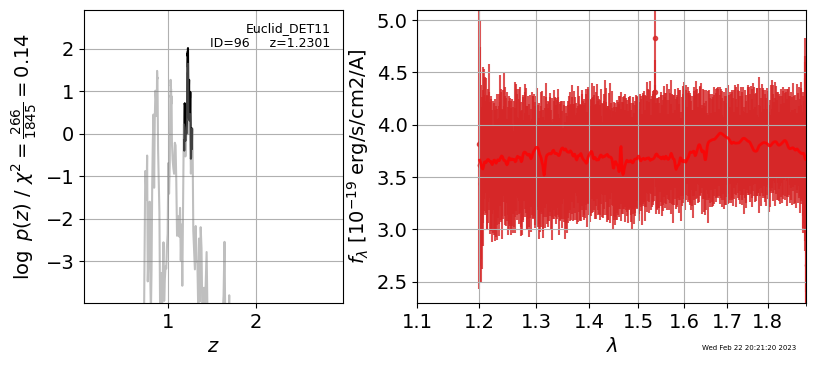

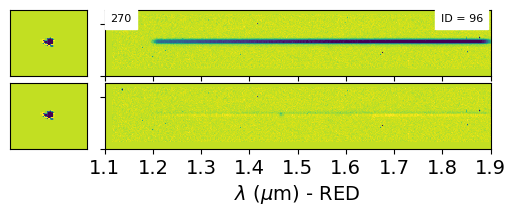

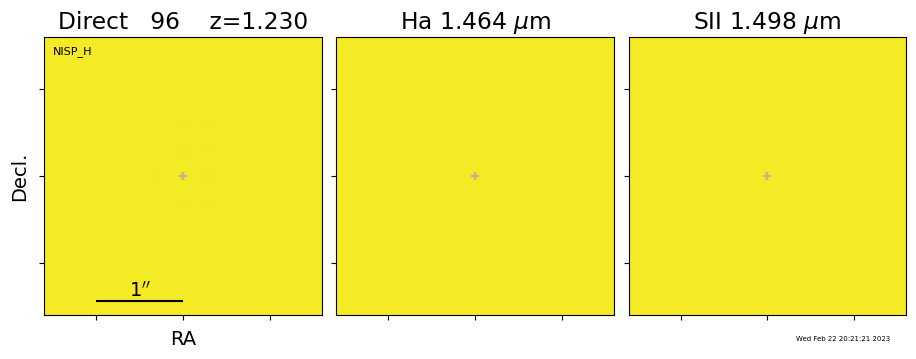

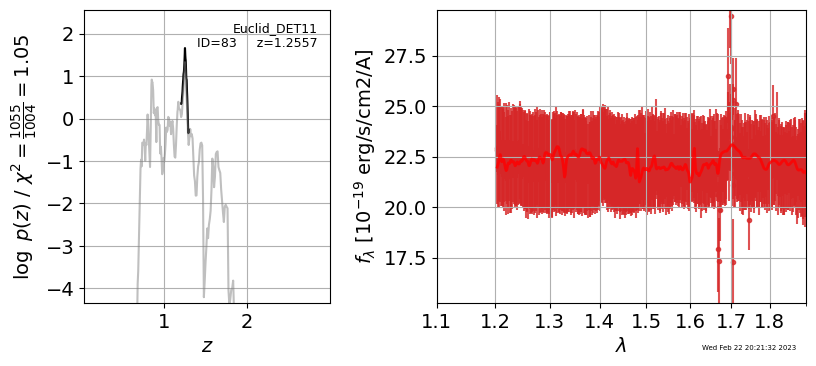

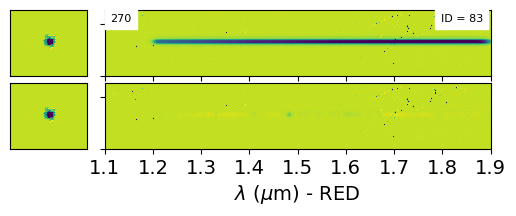

...

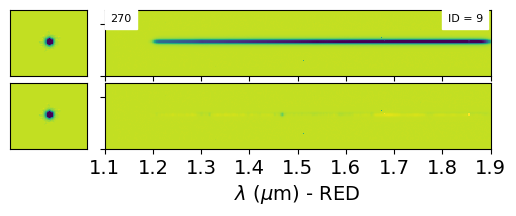

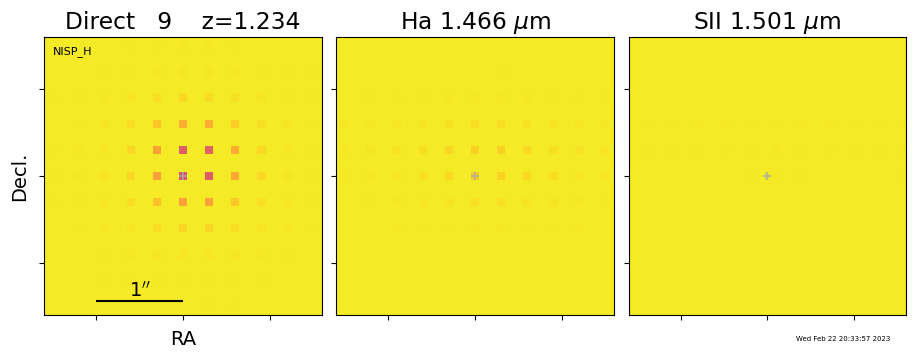

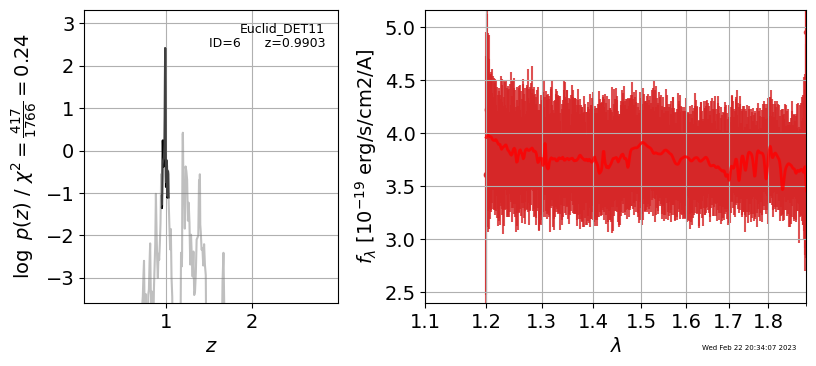

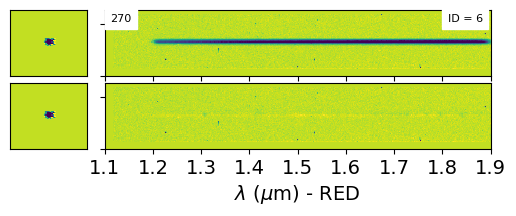

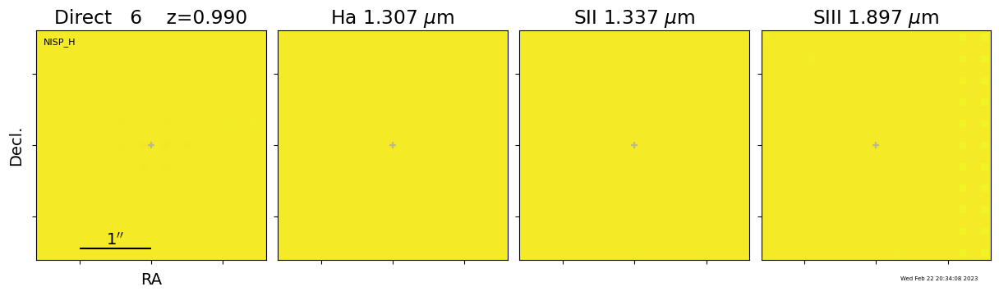

In [105]:
T0 = time.time()

os.chdir(os.path.join(HOME_PATH, root, 'Extractions'))

#fwhm = 395 # km/s
fwhm = 400 # km/s

#t0 = utils.load_templates(fwhm=fwhm, line_complexes=True, fsps_templates=True) # redshift fits, fixed line ratios
#t1 = utils.load_templates(fwhm=fwhm, line_complexes=False, fsps_templates=True) # final fits

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
temp0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
temp1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)

#print(temp0)
#print(len(temp0))
#print(temp1)
#print(len(temp1))

for i,Nl in enumerate(all_Nl):
    
    print("Fitting redshifts for %s" % (all_det[i]))
    euclid = all_euclid[i]
    
    group_name = root + "_" + all_det[i]
    
    t0 = time.time()
    
    if not os.path.exists(all_det[i]):
        os.mkdir(all_det[i])    
    os.chdir(all_det[i])

    for j,id in enumerate(Nl):

        print("id =",id)
        print("%i of %i" % (j+1,len(Nl)))
    
        #beams = OrderedDict()

        is_cgs, spectrum_1d, b = euclid.object_dispersers[id]
        cutout = grizli.model.BeamCutout(euclid, b['A'], min_sens=0,) # min_mask=0) 

        cutout.beam.compute_model()  
        cutout.contam = cutout.beam.cutout_from_full_image(euclid.model)
        if id in euclid.object_dispersers:
            cutout.contam -= cutout.beam.model

        hdu = cutout.write_fits(get_hdu=True)
        ext = 0
        hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']

        beam = 'beam_%05d.grism.A.fits' % (id)
        hdu.writeto(beam,overwrite=True)

        mb = multifit.MultiBeam([beam], fcontam=0.2, group_name=group_name, psf=False, min_sens=0.05)
        mb.write_master_fits()
    
        # kludge
        os.remove(beam)
        ###########################
        
        fitting.run_all(id, temp0, temp1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
                        dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=group_name)
    

    os.chdir("..")
    
    t1 = time.time()
    print()
    print("Finished %s in %.1f seconds" % (all_det[i],t1-t0))
    print()
    
    
T1 = time.time()

print()
print("Finished in %.1f seconds" % (T1-T0))

In [62]:
print(os.getcwd())

/Users/gwalth/data/Roman/grizli/sims/Euclid/Extractions


In [85]:
id = 1
det = 11

full = "DET%i/%s_DET%i_%05d.full.fits" % (det,root,det,id)
row = "DET%i/%s_DET%i_%05d.row.fits" % (det,root,det,id)
oned = "DET%i/%s_DET%i_%05d.1D.fits" % (det,root,det,id)


hdu = pyfits.open(full)
hdu.info()
head = hdu[0].header
ra = head["RA"]
dec = head["DEC"]
print(ra,dec)

hdu = pyfits.open(row)
hdu.info()
#hdu[0].header

hdu = pyfits.open(oned)
hdu.info()
hdu[0].header

Filename: DET11/Euclid_DET11_00001.full.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  ZFIT_STACK    1 BinTableHDU     92   578R x 6C   [D, D, 17D, 289D, D, D]   
  2  ZFIT_BEAM     1 BinTableHDU     87   62R x 6C   [D, D, 17D, 289D, D, D]   
  3  TEMPL         1 BinTableHDU    153   7077R x 3C   [D, D, D]   
  4  COVAR         1 ImageHDU       203   (45, 45)   float64   
  5  SEG           1 ImageHDU         8   (80, 80)   int32   
  6  DSCI        NISP_H ImageHDU        28   (80, 80)   float32   
  7  DWHT        NISP_H ImageHDU        28   (80, 80)   float32   
  8  LINE        PaB ImageHDU        31   (80, 80)   float32   
  9  CONTINUUM   PaB ImageHDU        31   (80, 80)   float32   
 10  CONTAM      PaB ImageHDU        31   (80, 80)   float32   
 11  LINEWHT     PaB ImageHDU        31   (80, 80)   float32   
228.6881728 6.245984804599993
Filename: DET11/Euclid_DET11_00001.row.fits
No.    Name      Ver   

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
ID      =                    1 / Object ID                                      
RA      =          228.6881728 / Right Ascension                                
DEC     =    6.245984804599993 / Declination                                    
TARGET  = 'Euclid_DET11'       / Target Name                                    
MW_EBV  =                  0.0 / Galactic extinction E(B-V)                     
N_G102  =                    0 / Number of exposures                            
T_G102  =                    0 / Total exposure time                            
PA_G102 =                    0 / Number of PAs                                  
N_G141  =                   

In [86]:
#print(primer)
print(primer.colnames)
#print([col for col in primer.colnames if "TU_" in col])
#bands = [col for col in primer.colnames if "_MAG" in col]
bands = [col for col in primer.colnames if "TU_" in col]


Euclid_bands = ['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG']
print(ra,dec)

dr = np.sqrt((primer['RA']-ra)**2*np.cos(dec/180*np.pi)**2 + 
             (primer['DEC']-dec)**2)*3600.

ind = np.argmin(dr)
source_id = primer['SOURCE_ID'][ind]
obj_mag = primer['TU_FNU_H_NISP_MAG'][ind]
print('SOURCE_ID:%d, H_mag=%.2f, dr=%.2f"' % (source_id, obj_mag, np.min(dr)))
print(primer['Z_OBS'][ind])
fnu = primer['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG'][ind]

fnu = np.array(list(fnu))
#print(dir(fnu))
#print(primer[bands][ind])
print(fnu)

Jy = 1e-23 # erg/s/cm^2/Hz

m = -2.5*np.log10(fnu*Jy)-48.60
print(m)

primer_small = primer['SOURCE_ID','RA','DEC','TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 
                      'TU_FNU_H_NISP_MAG']

tbl = Table(rows=primer_small[ind])
#print(tbl.colnames)
print(tbl)
print()

# rename columns
tbl.rename_column("SOURCE_ID","id")   
tbl.rename_column("RA","ra")   
tbl.rename_column("DEC","dec")   

for col in tbl.colnames:
    if "TU_FNU_" in col:
        print(col)
        new_col = col.replace("TU_FNU_","").replace("_MAG","_FLUX")
        print(new_col)
        tbl.rename_column(col,new_col)    
print()
    
# adjust flux and add errors
for col in tbl.colnames:
    if "_FLUX" in col:
        print(col)
        tbl[col] /= 1e-6
        #row[col]
        new_col = col + "ERR"
        tbl[new_col] = 0.5

tbl["z_spec"] = -1.0
        
#print(tbl)

euclid_phot_file = "Euclid_phot.fits"
tbl.write(euclid_phot_file, overwrite=True)            
tbl.show_in_notebook()

['SOURCE_ID', 'HALO_ID', 'KIND', 'RA', 'DEC', 'RA_MAG', 'DEC_MAG', 'Z_OBS', 'REF_MAG_ABS', 'REF_MAG', 'BULGE_FRACTION', 'BULGE_R50', 'DISK_R50', 'BULGE_NSERSIC', 'BULGE_AXIS_RATIO', 'INCLINATION_ANGLE', 'DISK_ANGLE', 'KAPPA', 'GAMMA1', 'GAMMA2', 'SED_TEMPLATE', 'EXT_LAW', 'EBV', 'HALPHA_LOGFLAM_EXT_MAG', 'HBETA_LOGFLAM_EXT_MAG', 'O2_LOGFLAM_EXT_MAG', 'O3_LOGFLAM_EXT_MAG', 'N2_LOGFLAM_EXT_MAG', 'S2_LOGFLAM_EXT_MAG', 'AV', 'TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG', 'TU_FNU_G_KIDS_MAG', 'TU_FNU_R_KIDS_MAG', 'TU_FNU_I_

idx,id,ra,dec,VIS_FLUX,Y_NISP_FLUX,J_NISP_FLUX,H_NISP_FLUX,VIS_FLUXERR,Y_NISP_FLUXERR,J_NISP_FLUXERR,H_NISP_FLUXERR,z_spec
,,,,Jy,Jy,Jy,Jy,,,,,
0,16881,228.68814,6.246,39.19067383350001,89.18469559770439,139.19895913041412,184.60029816415351,0.5,0.5,0.5,0.5,-1.0


In [87]:
# Requires eazy-py:  https://github.com/gbrammer/eazy-py
import eazy
print('\n Eazy-py version: ', eazy.__version__)


 Eazy-py version:  0.5.2.dev63


In [88]:
# Preparation for eazy-py
eazy.symlink_eazy_inputs()

/Users/gwalth/python/miniconda3/envs/grizli39/lib/python3.9/site-packages/eazy/data/templates -> ./templates
/Users/gwalth/python/miniconda3/envs/grizli39/lib/python3.9/site-packages/eazy/data/filters/FILTER.RES.latest -> ./FILTER.RES.latest


In [89]:
### Initialize **eazy.photoz** object

params = {}

translate_file = 'Euclid_phot.translate'
params['CATALOG_FILE'] = 'Euclid_phot.fits'
params['MAIN_OUTPUT_FILE'] = 'Euclid_phot.eazypy'
params['TEMPLATES_FILE'] = 'templates/fsps_full/tweak_fsps_QSF_12_v3.param'

# Galactic extinction
params['MW_EBV'] = 0.0
params['Z_STEP'] = 0.002
params['Z_MAX'] = 3.
params['FIX_ZSPEC']='n'
#params['PRIOR_FILTER'] = 205

ez = eazy.photoz.PhotoZ(param_file=None, translate_file=translate_file, 
                        zeropoint_file=None, params=params, 
                        load_prior=True, load_products=False)

Read default param file: /Users/gwalth/python/miniconda3/envs/grizli39/lib/python3.9/site-packages/eazy/data/zphot.param.default
Read CATALOG_FILE: Euclid_phot.fits
   >>> NOBJ = 1
VIS_FLUX VIS_FLUXERR (410): Euclid_VIS.vis.dat
Y_NISP_FLUX Y_NISP_FLUXERR (411): Euclid_NISP.Y.dat
J_NISP_FLUX J_NISP_FLUXERR (412): Euclid_NISP.J.dat
H_NISP_FLUX H_NISP_FLUXERR (413): Euclid_NISP.H.dat
Set sys_err = 0.01 (positive=True)
Read PRIOR_FILE:  templates/prior_F160W_TAO.dat
Template grid: templates/fsps_full/tweak_fsps_QSF_12_v3.param (this may take some time)


100%|███████████████████████████████████████████| 12/12 [00:05<00:00,  2.13it/s]


Template   0: tweak_fsps_QSF_12_v3_001.dat (NZ=1).
Template   1: tweak_fsps_QSF_12_v3_002.dat (NZ=1).
Template   2: tweak_fsps_QSF_12_v3_003.dat (NZ=1).
Template   3: tweak_fsps_QSF_12_v3_004.dat (NZ=1).
Template   4: tweak_fsps_QSF_12_v3_005.dat (NZ=1).
Template   5: tweak_fsps_QSF_12_v3_006.dat (NZ=1).
Template   6: tweak_fsps_QSF_12_v3_007.dat (NZ=1).
Template   7: tweak_fsps_QSF_12_v3_008.dat (NZ=1).
Template   8: tweak_fsps_QSF_12_v3_009.dat (NZ=1).
Template   9: tweak_fsps_QSF_12_v3_010.dat (NZ=1).
Template  10: tweak_fsps_QSF_12_v3_011.dat (NZ=1).
Template  11: tweak_fsps_QSF_12_v3_012.dat (NZ=1).
Process templates: 6.049 s


689it [00:00, 50523.18it/s]


In [90]:
from grizli.pipeline import photoz
## Grism fitting arguments created in Grizli-Pipeline
#args = np.load('fit_args.npy', allow_pickle=True)[0]

## First-pass redshift templates, similar to the eazy templates but 
## with separate emission lines
#t0 = args['t0'] # read earlier

#############
## Make a helper object for generating photometry in a format that grizli 
## understands. 

## Passing the parameters precomputes a function to quickly interpolate
## the templates through the broad-band filters.  It's not required, 
## but makes the fitting much faster.
## 
## `zgrid` defaults to ez.zgrid, be explicit here to show you can 
## change it. 
print(ez.zgrid)

phot_obj = photoz.EazyPhot(ez, grizli_templates=temp0, zgrid=ez.zgrid) 

[0.01       0.01202202 0.01404809 0.01607822 0.01811241 0.02015067
 0.02219301 0.02423944 0.02628997 0.02834461 0.03040335 0.03246622
 0.03453322 0.03660436 0.03867964 0.04075908 0.04284268 0.04493045
 0.04702241 0.04911854 0.05121888 0.05332343 0.05543218 0.05754516
 0.05966236 0.06178381 0.0639095  0.06603945 0.06817366 0.07031214
 0.07245491 0.07460197 0.07675333 0.07890899 0.08106896 0.08323326
 0.0854019  0.08757488 0.0897522  0.09193388 0.09411994 0.09631037
 0.09850518 0.10070439 0.102908   0.10511602 0.10732847 0.10954534
 0.11176665 0.11399242 0.11622263 0.11845731 0.12069646 0.12294009
 0.12518822 0.12744085 0.129698   0.13195965 0.13422583 0.13649656
 0.13877182 0.14105165 0.14333603 0.145625   0.14791854 0.15021667
 0.1525194  0.15482675 0.1571387  0.1594553  0.16177654 0.16410242
 0.16643295 0.16876815 0.17110802 0.17345259 0.17580184 0.1781558
 0.18051447 0.18287785 0.18524598 0.18761884 0.18999645 0.19237883
 0.19476597 0.1971579  0.1995546  0.20195612 0.20436244 0.20677

100%|███████████████████████████████████████████| 16/16 [00:07<00:00,  2.10it/s]

Template   0: fsps/fsps_QSF_12_v3_nolines_001.dat (NZ=1).
Template   1: fsps/fsps_QSF_12_v3_nolines_002.dat (NZ=1).
Template   2: fsps/fsps_QSF_12_v3_nolines_003.dat (NZ=1).
Template   3: fsps/fsps_QSF_12_v3_nolines_004.dat (NZ=1).
Template   4: fsps/fsps_QSF_12_v3_nolines_005.dat (NZ=1).
Template   5: fsps/fsps_QSF_12_v3_nolines_006.dat (NZ=1).
Template   6: fsps/fsps_QSF_12_v3_nolines_007.dat (NZ=1).
Template   7: fsps/fsps_QSF_12_v3_nolines_008.dat (NZ=1).
Template   8: fsps/fsps_QSF_12_v3_nolines_009.dat (NZ=1).
Template   9: fsps/fsps_QSF_12_v3_nolines_010.dat (NZ=1).
Template  10: fsps/fsps_QSF_12_v3_nolines_011.dat (NZ=1).
Template  11: fsps/fsps_QSF_12_v3_nolines_012.dat (NZ=1).
Template  12: line Ha+NII+SII+SIII+He+PaB (NZ=1).
Template  13: line OIII+Hb+Hg+Hd (NZ=1).
Template  14: line OII+Ne (NZ=1).
Template  15: line Gal-UV-lines (NZ=1).


In [91]:
ez.fit_parallel(n_proc=4)
ez.error_residuals()

print('Get physical parameters')
ez.standard_output()

100%|████████████████████████████████████████| 689/689 [00:00<00:00, 828.39it/s]


Compute best fits
fit_best: 0.0 s (n_proc=1,  NOBJ=1)
Fit 0.9 s (n_proc=4, NOBJ=1)
`error_residuals`: force uncertainties to match residuals
Set sys_err = 0.01 (positive=True)
Get physical parameters
Get best fit coeffs & best redshifts
fit_best: 0.0 s (n_proc=1,  NOBJ=1)
Get parameters (UBVJ=[153, 154, 155, 161], simple=False)


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.63it/s]


Abs Mag filters [271, 272, 274]
Rest-frame filters:
~~~~~~~~~~~~~~~~~~~ 
   0 RestUV/Tophat_1700_200.dat lambda_c= 1.6989e+03 AB-Vega=1.916 w95=190.7
   1 RestUV/Tophat_2200_200.dat lambda_c= 2.1993e+03 AB-Vega=1.691 w95=191.1
   2 RestUV/Tophat_2800_200.dat lambda_c= 2.7996e+03 AB-Vega=1.465 w95=191.2


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 72.55it/s]


(<GTable length=1>
   id      ra    ...          ABSM_272                   ABSM_274         
                 ...                                                      
 int64  float32  ...         float64[5]                 float64[5]        
 ----- --------- ... -------------------------- --------------------------
 16881 228.68814 ... nan .. -22.506682943090006 nan .. -22.088857244237467,
 [<astropy.io.fits.hdu.image.PrimaryHDU object at 0x45602c2b0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x4103d9c10>, <astropy.io.fits.hdu.image.ImageHDU object at 0x428c00970>, <astropy.io.fits.hdu.image.ImageHDU object at 0x41037d4c0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x36fc88c40>])

(<Figure size 800x400 with 2 Axes>,
 OrderedDict([('ix', 0),
              ('id', 16881),
              ('z', 0.86434567),
              ('z_spec', -1.0),
              ('pivot',
               array([ 7103.38180065, 10831.13264076, 13635.42836458, 17679.62443948])),
              ('model',
               array([84.54211668, 82.74909885, 81.49277736, 64.28461179])),
              ('emodel',
               array([1.66984935, 1.0000723 , 0.971785  , 0.85210875])),
              ('fobs',
               array([84.54211668, 82.74909885, 81.49277736, 64.28461179])),
              ('efobs',
               array([1.37044332, 0.94866371, 0.8659056 , 0.66600923])),
              ('valid', array([ True,  True,  True,  True])),
              ('tef', array([0.00616626, 0.004663  , 0.00500476, 0.00664339])),
              ('templz',
               array([1.69655456e+02, 1.75248493e+02, 1.78977184e+02, ...,
                      1.83022814e+08, 1.84719369e+08, 1.86434567e+08])),
              ('templ

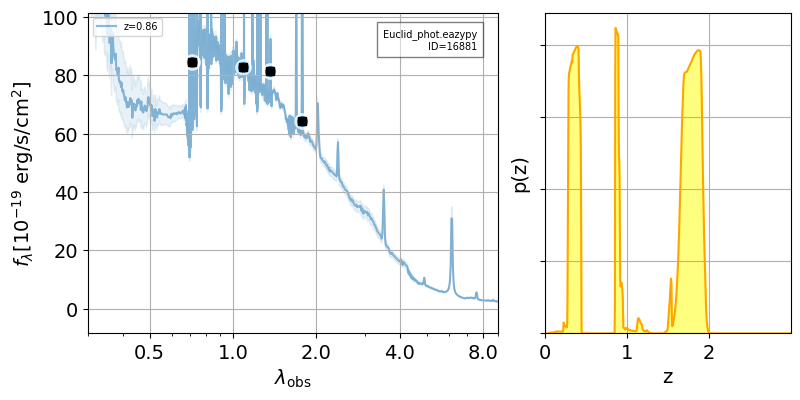

In [92]:
# Show SEDs with best-fit templates and p(z)
ez.show_fit(0, id_is_idx=True)

In [93]:
### Spline templates for dummy grism continuum fits
wspline = np.arange(4200, 2.5e4)
Rspline = 50
df_spl = len(utils.log_zgrid(zr=[wspline[0], wspline[-1]], dz=1./Rspline))
tspline = utils.bspline_templates(wspline, df=df_spl+2, log=True, clip=0.0001)

In [94]:
print(source_id) # primer
print(id)        # sims.catalog

catalog = all_euclid[0].catalog["NUMBER"]
idx = list(catalog).index(id)
print(idx)
#print(list(catalog[indices]))
#print(all_euclid[0].catalog[indices])

16881
1
23


In [95]:
## This isn't necessary for general fitting, but 
## load the grism spectrum here for demonstrating the grism/photometry scaling
group_name = root + "_DET%i" % (det)
beams_file = "%s_DET%i_%05d.beams.fits" % (root,det,id)
mb = multifit.MultiBeam(beams_file, fcontam=0.2, group_name=group_name)

load_master_fits: Euclid_DET11_00001.beams.fits
1 Euclid_DET11_slitless_final.fits RED


In [96]:
# Generate the `phot` dictionary
phot, ii, dd = phot_obj.get_phot_dict(mb.ra, mb.dec)
label = "Euclid Catalog ID: {0}, dr={1:.2f}, zphot={2:.3f}"
print(label.format(ez.cat['id'][ii], dd, ez.zbest[ii]))

print('\n`phot` keys:', list(phot.keys()))
for k in phot:
    print('\n'+k+':\n', phot[k])
    
# Initialize photometry for the MultiBeam object
mb.set_photometry(**phot)

Euclid Catalog ID: 16881, dr=0.13 arcsec, zphot=0.864

`phot` keys: ['source', 'flam', 'eflam', 'filters', 'tempfilt', 'ext_corr', 'pz', 'z_spec']

source:
 unknown

flam:
 [8.45421167e-18 8.27490988e-18 8.14927774e-18 6.42846118e-18]

eflam:
 [1.37044332e-19 9.48663708e-20 8.65905601e-20 6.66009234e-20]

filters:
 ['Euclid_VIS.vis.dat lambda_c= 7.10338e+03 SPV02-from-SVO-service-03.06.22', 'Euclid_NISP.Y.dat lambda_c= 1.08311e+04 SPV02-from-SVO-service-03.06.22', 'Euclid_NISP.J.dat lambda_c= 1.36354e+04 SPV02-from-SVO-service-03.06.22', 'Euclid_NISP.H.dat lambda_c= 1.76796e+04 SPV02-from-SVO-service-03.06.22']

tempfilt:

ext_corr:
 [1. 1. 1. 1.]

pz:
 None

z_spec:
 -1.0


[0.71033818 1.08311326 1.36354284 1.76796244]
[84.54211668 82.74909885 81.49277736 64.28461179]


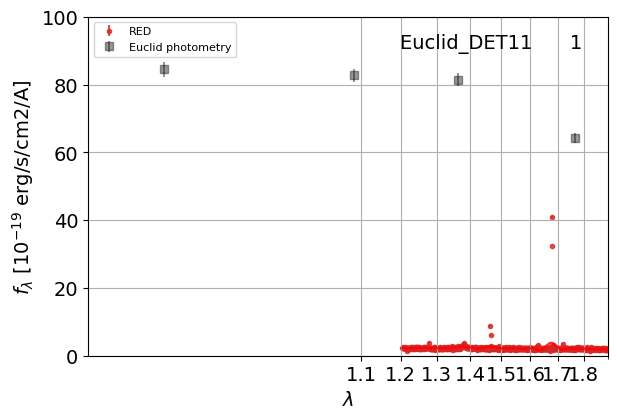

In [97]:
# parametric template fit to get reasonable background
sfit = mb.template_at_z(templates=tspline, fit_background=True, 
                        include_photometry=False)
fig = mb.oned_figure(tfit=sfit)

ax = fig.axes[0]
ax.errorbar(mb.photom_pivot/1.e4, mb.photom_flam/1.e-19, 
            mb.photom_eflam/1.e-19, 
            marker='s', color='k', alpha=0.4, linestyle='None',
            label='Euclid photometry')

ax.legend(loc='upper left', fontsize=8)

ax.set_ylim(0,100)
ax.set_xlim(0.6,1.9)

print(mb.photom_pivot/1.e4)
print(mb.photom_flam/1.e-19)

No rescaling, chi-squared=5662.1


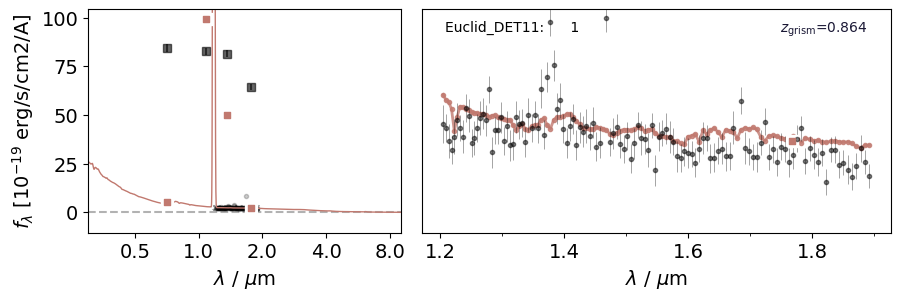

In [98]:
## First example:  no rescaling
z_phot = ez.zbest[0]

# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    
#t1 = args['t1']
tfit = mb.template_at_z(z=z_phot)
print('No rescaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

[0.28048702]
0.86434567
Simple scaling, chi-squared=4855.7


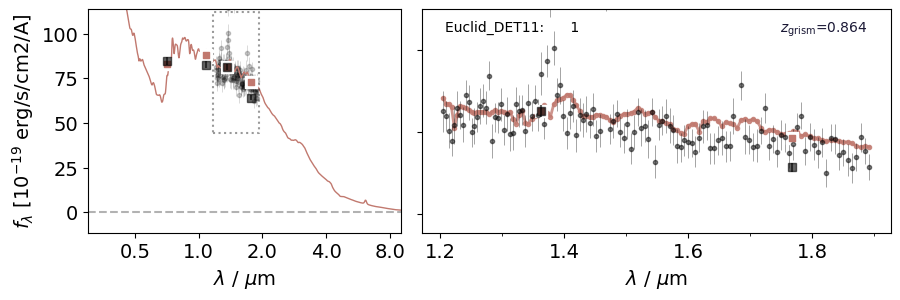

In [99]:
# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')

# Template rescaling, simple multiplicative factor
scl = mb.scale_to_photometry(order=0)

# has funny units of polynomial coefficients times 10**power, 
# see `grizli.fitting.GroupFitter.compute_scale_array`
# Scale value is the inverse, so, e.g., 
# scl.x = [8.89] means scale the grism spectrum by 10/8.89=1.12
print(scl.x) 

mb.pscale = scl.x 

# Redo template fit
tfit = mb.template_at_z(z=z_phot)
print(z_phot)
print('Simple scaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

[0.27865324]
Simple scaling, chi-squared=4857.4


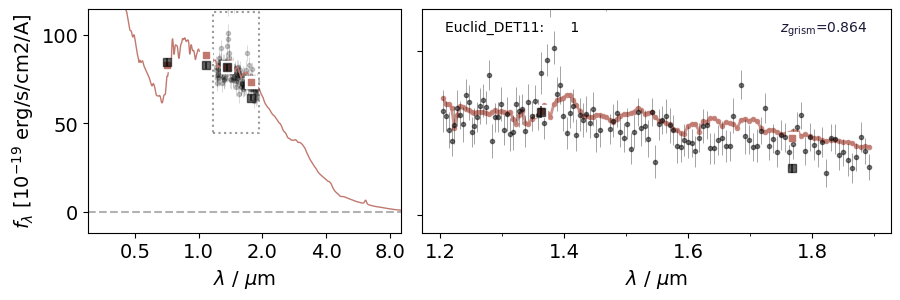

In [100]:
# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    mb.compute_model()

# Template rescaling, linear fit
scl = mb.scale_to_photometry(order=0)

# has funny units of polynomial coefficients times 10**power, 
# see `grizli.fitting.GroupFitter.compute_scale_array`
# Scale value is the inverse, so, e.g., 
# scl.x = [8.89] means scale the grism spectrum by 10/8.89=1.12
print(scl.x) 

mb.pscale = scl.x 

# Redo template fit
tfit = mb.template_at_z(z=z_phot)
print('Simple scaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

load_master_fits: Euclid_DET11_00001.beams.fits
1 Euclid_DET11_slitless_final.fits RED
scale_to_photometry: [0.27]
User templates! N=16 

  0.0500     500.8 (0.0500) 1/168
  0.0584     494.5 (0.0584) 2/168
  0.0669     487.6 (0.0669) 3/168
  0.0755     462.3 (0.0755) 4/168
  0.0841     479.5 (0.0755) 5/168
  0.0929     481.9 (0.0755) 6/168
  0.1016     481.4 (0.0755) 7/168
  0.1105     484.1 (0.0755) 8/168
  0.1194     486.4 (0.0755) 9/168
  0.1284     487.6 (0.0755) 10/168
  0.1375     490.6 (0.0755) 11/168
  0.1466     492.8 (0.0755) 12/168
  0.1558     496.7 (0.0755) 13/168
  0.1651     499.5 (0.0755) 14/168
  0.1744     502.8 (0.0755) 15/168
  0.1839     505.0 (0.0755) 16/168
  0.1934     506.2 (0.0755) 17/168
  0.2030     507.5 (0.0755) 18/168
  0.2126     510.6 (0.0755) 19/168
  0.2224     511.4 (0.0755) 20/168
  0.2322     512.0 (0.0755) 21/168
  0.2421     512.3 (0.0755) 22/168
  0.2521     510.4 (0.0755) 23/168
  0.2621     501.4 (0.0755) 24/168
  0.2723     500.6 (0.0755) 25/

- 0.8259     460.6 (0.8259) 32/243
- 0.8263     460.6 (0.8263) 33/243
- 0.8267     460.5 (0.8267) 34/243
- 0.8271     460.4 (0.8271) 35/243
- 0.8275     460.3 (0.8275) 36/243
- 0.8279     460.3 (0.8279) 37/243
- 0.8283     460.3 (0.8283) 38/243
- 0.8287     460.3 (0.8287) 39/243
- 0.8291     460.2 (0.8291) 40/243
- 0.8295     460.2 (0.8295) 41/243
- 0.8299     460.3 (0.8295) 42/243
- 0.8303     460.4 (0.8295) 43/243
- 0.8307     460.5 (0.8295) 44/243
- 0.8311     460.6 (0.8295) 45/243
- 0.8315     460.6 (0.8295) 46/243
- 0.8319     460.7 (0.8295) 47/243
- 0.8323     460.8 (0.8295) 48/243
- 0.8327     460.9 (0.8295) 49/243
- 0.8331     461.1 (0.8295) 50/243
- 0.8335     461.2 (0.8295) 51/243
- 0.8339     461.4 (0.8295) 52/243
- 0.8343     461.5 (0.8295) 53/243
- 0.8347     461.5 (0.8295) 54/243
- 0.8351     461.6 (0.8295) 55/243
- 0.8355     461.7 (0.8295) 56/243
- 0.8359     461.7 (0.8295) 57/243
- 0.8363     461.8 (0.8295) 58/243
- 0.8367     461.9 (0.8295) 59/243
- 0.8371     462.0 (

- 0.4538     475.8 (0.8295) 223/243
- 0.4542     476.3 (0.8295) 224/243
- 0.4546     476.8 (0.8295) 225/243
- 0.4550     477.2 (0.8295) 226/243
- 0.4554     477.6 (0.8295) 227/243
- 0.4558     477.9 (0.8295) 228/243
- 0.4562     478.2 (0.8295) 229/243
- 0.4566     478.5 (0.8295) 230/243
- 0.4570     478.8 (0.8295) 231/243
- 0.4574     479.1 (0.8295) 232/243
- 0.4578     479.4 (0.8295) 233/243
- 0.4582     479.6 (0.8295) 234/243
- 0.4586     479.9 (0.8295) 235/243
- 0.4590     480.2 (0.8295) 236/243
- 0.4594     480.4 (0.8295) 237/243
- 0.4598     480.7 (0.8295) 238/243
- 0.4602     480.9 (0.8295) 239/243
- 0.4606     481.1 (0.8295) 240/243
- 0.4610     481.3 (0.8295) 241/243
- 0.4614     481.5 (0.8295) 242/243
- 0.4618     481.6 (0.8295) 243/243
User templates! N=16 

  0.7928     471.4 (0.7928) 1/41
  0.7946     471.3 (0.7946) 2/41
  0.7964     471.0 (0.7964) 3/41
  0.7982     470.6 (0.7982) 4/41
  0.8000     470.2 (0.8000) 5/41
  0.8018     469.9 (0.8018) 6/41
  0.8036     469.7 (0.8

 [astropy.io.fits.verify]


(<grizli.multifit.MultiBeam at 0x40c754d30>,
 None,
 <GTable length=411>
        zgrid                chi2        ...        risk       
       float64             float64       ...      float64      
 -------------------- ------------------ ... ------------------
 0.050000000000000044 500.78880351763036 ... 0.8846396810091459
  0.05843368977948704   494.459860749708 ... 0.8824175766791069
 0.060358598270325595 492.91550488478333 ... 0.8819060255461126
  0.06075859827032559  492.5852325414106 ... 0.8817995200266388
  0.06115859827032559  492.2535790968386 ... 0.8816929441937016
  0.06155859827032559 491.92378453988056 ... 0.8815862980051715
                  ...                ... ...                ...
   2.8068046555417765   929.471716775787 ... 0.9812110434146589
    2.837381236033154  945.9750855236846 ... 0.9817682378935164
    2.868203410233467  965.3128371631394 ... 0.9823053386406269
   2.8992731507723843  980.1045927725384 ... 0.9828232201943637
   2.9305924461239057  984.1748

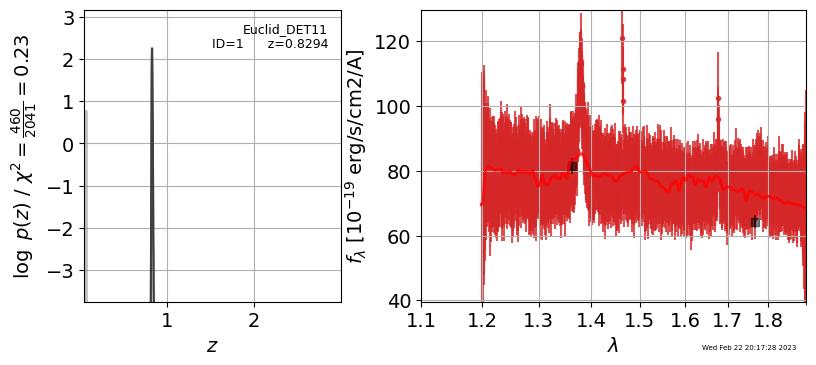

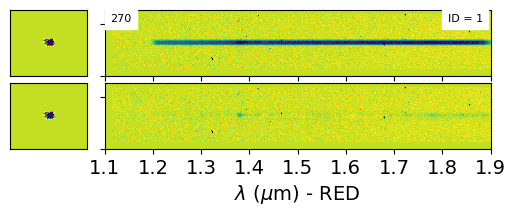

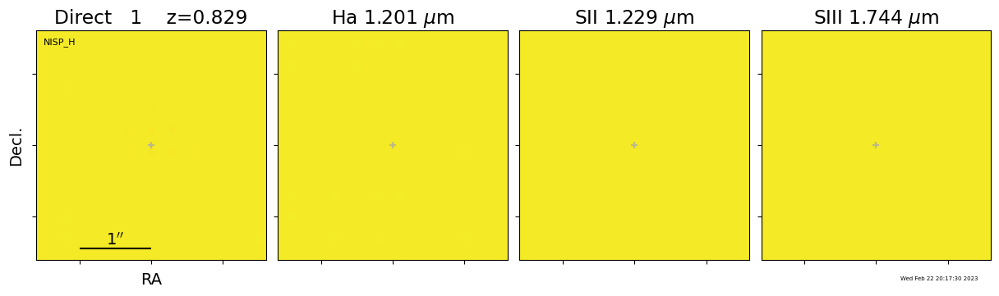

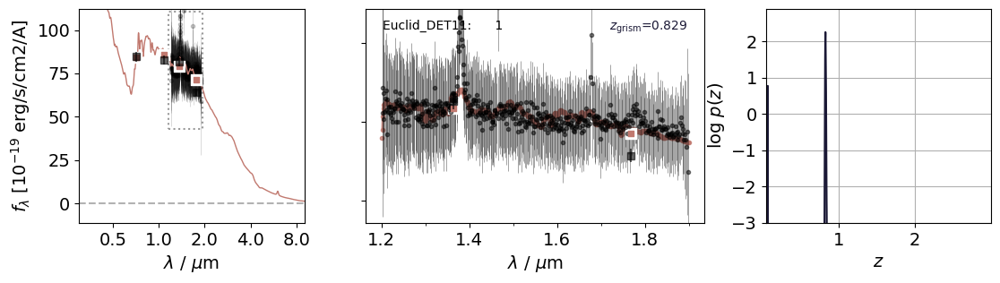

In [101]:
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    mb.compute_model()

# Now run the full redshift fit script with the photometry, which will also do the scaling
order=0
#fitting.run_all_parallel(id, phot=phot, verbose=False, 
#                         scale_photometry=order+1, zr=[0.05, 3.0])

fitting.run_all(id, temp0, temp1, phot=phot, scale_photometry=order+1, fit_only_beams=True, fwhm=fwhm, 
                zr=[0.05, 3.0], dz=[0.008, 0.0004], fitter=['nnls', 'bounded'], group_name=group_name)

#fitting.run_all(id, temp0, temp1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
#                        dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=group_name)
    


Best redshift: 0.8294


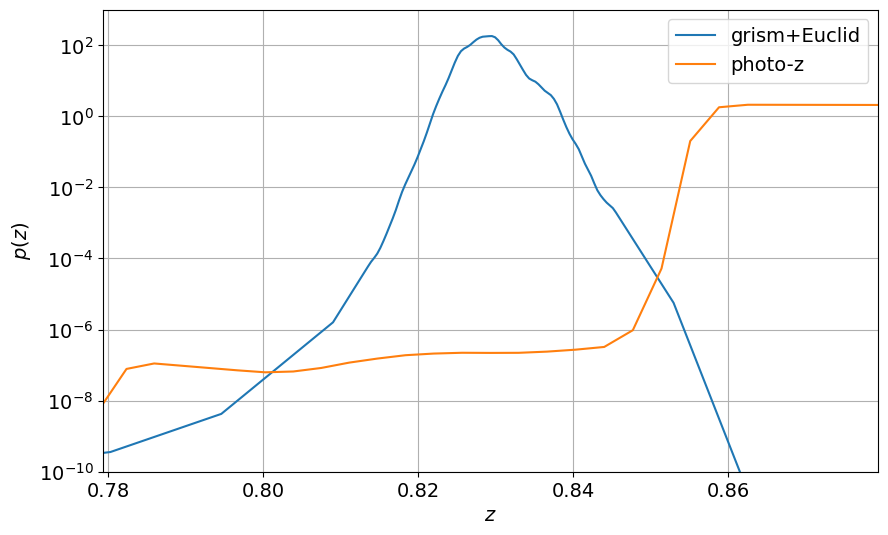

In [104]:
zfit = pyfits.open('{0}_DET{1}_{2:05d}.full.fits'.format(root, det, id))
z_grism = zfit['ZFIT_STACK'].header['Z_MAP']
print('Best redshift: {0:.4f}'.format(z_grism))

# Compare PDFs
pztab = utils.GTable.gread(zfit['ZFIT_STACK'])
plt.plot(pztab['zgrid'], pztab['pdf'], label='grism+Euclid')

plt.plot(ez.zgrid, np.exp(ez.lnp[0,:]), label='photo-z')

plt.semilogy()
plt.xlim(z_grism-0.05, z_grism+0.05); plt.ylim(1.e-10, 1000)
plt.xlabel(r'$z$'); plt.ylabel(r'$p(z)$')
plt.grid()
plt.legend()

## Extract a single 2D spectrum 
Science, model and contamination based on RA and Dec

[top](#Table-of-Contents)

In [ ]:
det_ind = 0 # DET11
Euclid = all_euclid[det_ind]
phot = all_phot[det_ind]

## Find the object ID near coordinates (r0,d0), 
## SExtractor IDs might not be constant across platforms

#r0,d0 = 228.6882041, 6.2969624 # cont src
#r0,d0 = 228.6882147, 6.3239512 #  emission line src
#r0,d0 = 228.6881854, 6.3209442
#r0,d0 = 228.6882128, 6.3028898 
#r0,d0 = 228.6881973, 6.3179116 
r0,d0 = 228.6881976, 6.3149738 


dr = np.sqrt((phot['X_WORLD']-r0)**2*np.cos(d0/180*np.pi)**2 + 
             (phot['Y_WORLD']-d0)**2)*3600.
id = phot['NUMBER'][np.argmin(dr)]
obj_mag = phot['MAG_AUTO'][np.argmin(dr)]
print('ID:%d, mag=%.2f, dr=%.2f"' %(id, obj_mag, np.min(dr)))

beams = OrderedDict()

ix = Euclid.catalog['id'] == id
x0, y0 = Euclid.catalog['x_flt'][ix][0], Euclid.catalog['y_flt'][ix][0]
print(Euclid.direct.instrument, x0, y0)
#print(Roman.wcs.pscale)
#dim = 18*0.135/sim.flt_wcs.pscale 
#beam = grizli.model.BeamCutout(id=id, x=x0, y=y0, 
#                               cutout_dimensions=np.cast[int]((dim, dim)), 
#                               conf=sim.conf, GrismFLT=sim)

print(Euclid.object_dispersers[id])

is_cgs, spectrum_1d, b = Euclid.object_dispersers[id]
#print(b)

cutout = grizli.model.BeamCutout(Euclid, b['A'], min_sens=0,) # min_mask=0) 

cutout.beam.compute_model()  
cutout.contam = cutout.beam.cutout_from_full_image(Euclid.model)
if id in Euclid.object_dispersers:
    cutout.contam -= cutout.beam.model

print(dir(cutout.beam))
#print(cutout.contam)
#print(cutout.beam.model)
#print(dir(cutout.beam))
print(cutout.beam.seg)
print(cutout.beam.seg.shape)

img = cutout.grism.data['SCI']*1
X = img.flatten()
std = np.std(X)
med = np.median(X)

sig = 1.
vmin = med-sig*std
vmax = med+sig*std

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.imshow(cutout.grism.data['SCI']*1, origin='lower',cmap='gray_r',vmin=vmin,vmax=vmax)
p1.set_xlabel("X [pixels]")
p1.set_ylabel("Y [pixels]")

#p1.imshow(cutout.grism.data['ERR']*1)#,vmin=-0.1,vmax=0.1, origin='lower',cmap='gray_r')
    
beams[Euclid.grism.instrument] = cutout

cutout.write_fits() # still learning about the output

## 1D Spectral Extraction
[top](#Table-of-Contents)

In [ ]:
from scipy import integrate

### Plot 1D spectra
fig = plt.figure(figsize=(10,6))
p1 = fig.add_subplot(111)
key = "NISP-GLWv1"
w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)


#sf = f/np.nanmax(f)
sf = f
std = np.nanstd(sf)
med = np.nanmedian(sf)

sig = 2.
y0 = med-sig*std
y1 = med+sig*std

p1.text(0.05,0.9,"ID = %i" % (id),transform=p1.transAxes)
p1.plot(w/1.e4, sf, c="k") # linestyle='steps-mid')

#p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
p1.set_ylabel("Flux [Arbitrary]")
p1.set_xlabel("Wavelength [um]")

p1.set_ylim(y0,y1)

## Display Redshift Fit
[top](#Table-of-Contents)

In [ ]:
det_ind = 0
os.chdir(os.path.join(HOME_PATH, root, 'Extractions',all_det[det_ind]))
group_name = root + "_" + all_det[det_ind]

In [ ]:
display_grizli(group_name, id, w0=1.15, w1=1.95, labels=1)

In [ ]:
#########################
# copy sextractor files #
#########################

# cd ~/data/Roman/grizli/my_roman_sims/Prep

# rsync -avz Roman.param cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep
# rsync -avz Roman.sex   cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep
# rsync -avz default.nnw cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep

In [ ]:
##############################
# compare branch differences #
##############################

# git diff roman_sims_v1_gwalth..master -- *.py

# cd ~/python/grizli_1.3.2/grizli

# rsync -avz grismconf.py cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz model.py     cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz multifit.py  cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz utils.py     cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli


In [ ]:
#########################
# copy grism conf files #
#########################

# cd ~/data/Roman/grizli/grizli/CONF

# rsync -avz Roman.G150-v?-GLW.conf cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/grizli/CONF
# rsync -avz sens_0720_2020.fits    cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/grizli/CONF

# Appendix - Old

## aXeSIM predictions based on conf file
[top](#Table-of-Contents)

In [ ]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

In [ ]:
from grizli import grismconf

In [ ]:
# This one gives the error
import os
os.chdir("/Users/gwalth/data/Roman/grizli/grizli/CONF")
conf = grismconf.load_grism_config("./Euclid.Gred.0.conf")

# This one works!
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman.det1.07242020.conf")
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman_bad/Roman.det1.07242020.conf")

dx = conf.dxlam["A"]
print(dx)
x0,y0 = 1024,1024

dy,lam = conf.get_beam_trace(x=x0,y=y0,dx=dx)
print(dy)
print(lam)

In [ ]:
conf.show_beams()

In [ ]:
# This one gives the error
import os
os.chdir("/Users/gwalth/data/Roman/grizli/grizli/CONF/CONF11")
conf = grismconf.load_grism_config("./NISP_RGS000_21.conf")
#conf = grismconf.load_grism_config("./NISP_RGS000_21.conf.beamA")

# This one works!
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman.det1.07242020.conf")
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman_bad/Roman.det1.07242020.conf")

dx = conf.dxlam["A"]
print(dx)
x0,y0 = 1024,1024

dy,lam = conf.get_beam_trace(x=x0,y=y0,dx=dx)
print(dy)
print(lam)

In [ ]:
conf.show_beams()

In [ ]:
print(os.getcwd())

## Show 2D beam
[top](#Table-of-Contents)

In [ ]:
## Spectrum with lines & noise
#spectrum_file = os.path.join(os.path.dirname(grizli.__file__), 'data/erb2010.dat')
#spectrum_file = '../../../grizli/templates/erb2010.dat'
#erb = np.loadtxt(spectrum_file, unpack=True)
#z = 2.0 # test redshift

## normalize spectrum to unity to use normalization defined in the direct image
#import pysynphot as S
#spec = S.ArraySpectrum(erb[0], erb[1], fluxunits='flam')
#spec = spec.redshift(z).renorm(1., 'flam', S.ObsBandpass('wfc3,ir,f140w'))
#spec.convert('flam') # bug in pysynphot, now units being converted automatically above? (11/10/16)

fig = plt.figure(figsize=(14,4))
for i, key in enumerate(beams.keys()):
    #     beams[key].compute_model(beams[key].thumb, id=beams[key].id, 
    #                              xspec=spec.wave, yspec=spec.flux)
    #print(key)
    #beams[key].beam.compute_model(spectrum_1d=[spec.wave, spec.flux]) 
    #beams[key].beam.compute_model()
    
    gdata = beams[key].grism.data['SCI']*1
    gmodel = beams[key].model
    gcontam = beams[key].contam
    
    print(gdata)
    print(gmodel)
    print(gcontam)
    
    print(np.min(gdata),np.max(gdata))
    print(np.min(gmodel),np.max(gmodel))
    print(np.min(gcontam),np.max(gcontam))
    
    print(gdata.shape)
    print(gmodel.shape)
    print(gcontam.shape)
    
    axl = fig.add_subplot(321+i*2)
    #axl.imshow(beams[key].model + beams[key].grism.data['SCI']*1, interpolation='Nearest', 
    #       origin='lower', vmin=-0.006, vmax=0.16, cmap='gray_r', aspect='auto')
    
    axl.imshow(beams[key].grism.data['SCI']*1, interpolation='Nearest', 
           origin='lower', vmin=-0.1,vmax=0.1, cmap='gray_r', aspect='auto')
    
    
    axr = fig.add_subplot(321+i*2+1)
    #axr.imshow(beams[key].contam + beams[key].grism.data['SCI'] + beams[key].model, 
    #           interpolation='Nearest', 
    #           origin='lower', vmin=-1, vmax=2, cmap='gray_r', aspect='auto')

    axr.imshow(beams[key].contam , 
               interpolation='Nearest', 
               origin='lower', vmin=-0.1,vmax=0.1, cmap='gray_r', aspect='auto')
    
    #axl.set_title('%s - %s' %(key, beams[key].grism.filter))
    #for ax in [axl, axr]:
    #    beams[key].beam.twod_axis_labels(wscale=1.e4, mpl_axis=ax)
    #    beams[key].beam.twod_xlim(1.3,1.75, wscale=1.e4, mpl_axis=ax)
    #    if i < 2:
    #        ax.set_xticklabels([])
    #    else:
    #        ax.set_xlabel(r'$\lambda$')

fig.tight_layout(pad=0.5)

In [ ]:
def ab2flux(mab,eff_wav):
    c = 2.9979E10 # cm/s
    Ang = 1E-8    # cm
    Jy = 1E-23    # erg/s/cm^2/Hz
    
    # mab = -2.5*np.log10(fnu) - 48.6 
    fnu = 10**(-0.4*(mab + 48.6))          # erg/s/cm^2/Hz
    flambda = fnu*(c/(eff_wav*Ang)**2)*Ang # erg/s/cm^2/Ang
   
    #print("%.2f AB" % (mab))
    #print("%.2e erg/s/cm^2/Hz" % (fnu))
    #print("%.2e Jy" % (fnu/Jy))
    #print("%.4f uJy" % (fnu/(1e-6*Jy)))
    #print("%.1f nJy" % (fnu/(1e-9*Jy)))
    #print()
    #print("%.2e erg/s/cm^2/Ang" % (flambda))
    #print()
    
    return flambda

In [ ]:
# determine flux in Ang for the source in the direct image

mab = phot[phot['NUMBER']==id]['MAG_AUTO'][0]

f_scale = ab2flux(mab,15800.)

## Simple SN calculations based on the spcontetc
[top](#Table-of-Contents)

In [ ]:
# Per pix S/N=1
mag_per_pix_w0 = 21.9       # 1.00 um
mag_per_pix_w1 = 21.9       # 1.93 um
mag_per_pix_deepest = 22.7  # 1.34 um

In [ ]:
ab2flux(mag_per_pix_w0,10000.)
ab2flux(mag_per_pix_deepest,13400.)

In [ ]:
print(os.getcwd())
spcontetc_1n = Table.read("../etc/spcontetc_1n_0.2.dat",format="ascii")
spcontetc_8n = Table.read("../etc/spcontetc_8n_0.2.dat",format="ascii")
#spcontetc_1n = Table.read("../etc/spcontetc_1n_0.5.dat",format="ascii")
#spcontetc_8n = Table.read("../etc/spcontetc_8n_0.5.dat",format="ascii")
print(spcontetc_1n)

#|  um  | arcsec |      |exp per Jy|per pix |per resl|1e4 km/s|
fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(5,8):
for n in range(5,7):
    #p.plot(spcontetc_1n['col1'],spcontetc_1n['col%i' % (n)]) # AB
    #p.plot(spcontetc_8n['col1'],spcontetc_8n['col%i' % (n)]) # AB
    
    f1 = ab2flux(spcontetc_1n['col%i' % (n)],spcontetc_1n['col1']*1e4)
    f8 = ab2flux(spcontetc_8n['col%i' % (n)],spcontetc_8n['col1']*1e4)
    
    p.plot(spcontetc_1n['col1'],f1)  
    #p.plot(spcontetc_8n['col1'],f8) 

    

#p.set_ylim(0e-18,2e-18)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
#p.set_ylabel(r'Mag [AB]')

#p.invert_yaxis()
    
plt.show()

Roughly estimated from spcontetc (>1.4 micron):

<span style="color:red">5 sigma limit = 1.75e-18 erg/s/cm^2/Ang</span>

<span style="color:red">1 sigma limit = 1.00e-18 erg/s/cm^2/Ang</span>


## Simple SN calculations based on the pzcaletc
[top](#Table-of-Contents)

In [ ]:
print(os.getcwd())
pzcaletc_1n = Table.read("../etc/pzcaletc_1n.dat",format="ascii")
pzcaletc_8n = Table.read("../etc/pzcaletc_8n.dat",format="ascii")
print(pzcaletc_1n)

fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(2,13):
for n in range(2,3):
    #p.plot(pzcaletc_1n['col1'],pzcaletc_1n['col%i' % (n)]) # W/m^2
    p.plot(pzcaletc_1n['col1'],pzcaletc_1n['col%i' % (n)]*1000.) # erg/s/cm^2
    p.plot(pzcaletc_8n['col1'],pzcaletc_8n['col%i' % (n)]*1000.) # erg/s/cm^2

    
#p.legend(fontsize=14)
#p.set_xlim(w1-0.05, w2+0.05)
#p.set_ylim(-1e-21,3e-20)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$]')
    
plt.show()

## Simple SN calculations based on the apttables2021
[top](#Table-of-Contents)

In [ ]:
print(os.getcwd())
apt_rad0_0_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.0_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
apt_rad0_2_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.2_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
apt_rad0_3_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.3_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
#print(apt_rad0_0_zod1_2)
#print(apt_rad0_2_zod1_2)
#print(apt_rad0_3_zod1_2)

fig = plt.figure()
p = fig.add_subplot(111)

wlist = ['1.05','1.20','1.40','1.60','1.80','2.00']

#for w in wlist:
#    p.plot(apt_rad0_0_zod1_2[w],apt_rad0_0_zod1_2['AB'],label=w) 

p.scatter(apt_rad0_0_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.0')
p.scatter(apt_rad0_2_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.2')
p.scatter(apt_rad0_3_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.3')
    
p.legend(fontsize=14)
p.set_xscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
    
plt.show()

In [ ]:
##############
# My crude ETC
# based on 
# https://roman.gsfc.nasa.gov/science/apttables2021/table-grism.html
##############

# notes:
# might need a fit cutoff to t = 1e7 

from scipy.optimize import leastsq

t = 301.

param = [1,0]
err = 1.0

# y = ax + b
line_fn = lambda p,x: p[1]*x+p[0]

err_fn = lambda p: (line_fn(p,x) - y)/err

wlist = ['1.05','1.20','1.40','1.60','1.80','2.00'] # microns

mag_ab_5sig = []

fig = plt.figure()
p = fig.add_subplot(111)

#x = np.log10(apt_rad0_0_zod1_2['1.20'])
y = apt_rad0_2_zod1_2['AB']
for w in wlist:
    print(w)
    x = np.log10(apt_rad0_2_zod1_2[w])

    sol = leastsq(err_fn,param,full_output=1)
    print(sol[0])

    mag_ab = line_fn(sol[0],np.log10(t))
    print(mag_ab)
    mag_ab_5sig.append(mag_ab)
    print()

    logt = np.arange(2.0,8.6,0.1)
    mag = line_fn(sol[0],logt)
    

    p.plot(10**logt,mag,c="k")
    p.scatter(10**x,y,label=w,s=50,alpha=0.7)
    
p.legend(fontsize=14)
p.set_xscale("log")

p.set_xlim(400,2.5e8)
p.set_ylim(20.8,27.2)

p.invert_yaxis()
plt.show()

In [ ]:
fig = plt.figure(figsize=(10,4))
p1 = fig.add_subplot(121)

warr = 1e4*np.array([float(w0) for w0 in wlist]) # Angstroms


mag_ab_5sig = np.array(mag_ab_5sig)

p1.plot(warr,mag_ab_5sig)
p1.set_xlabel(r'$\lambda$ [Ang]')
p1.set_ylabel(r'mag [AB]')
p1.invert_yaxis()


#p.set_xlim(0,2000)
#p.set_ylim(20,22)
p2 = fig.add_subplot(122)

#flux_5sig = [ab2flux(mag_ab_5sig[i],w0) for i,w0 in enumerate(warr)]
flux_5sig = ab2flux(mag_ab_5sig,warr) 
p2.plot(warr,flux_5sig)

p2.set_xlabel(r'$\lambda$ [Ang]')
p2.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
    
plt.show()

Comparison between spcontetc and apttables2021

In [ ]:
print(os.getcwd())
spcontetc_1n = Table.read("../etc/spcontetc_1n_0.2.dat",format="ascii")
spcontetc_8n = Table.read("../etc/spcontetc_8n_0.2.dat",format="ascii")
#spcontetc_1n = Table.read("../etc/spcontetc_1n_0.5.dat",format="ascii")
#spcontetc_8n = Table.read("../etc/spcontetc_8n_0.5.dat",format="ascii")
print(spcontetc_1n)

fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(5,8):
for n in range(5,7):
    #p.plot(spcontetc_1n['col1'],spcontetc_1n['col%i' % (n)]) # AB
    #p.plot(spcontetc_8n['col1'],spcontetc_8n['col%i' % (n)]) # AB
    
    f1 = ab2flux(spcontetc_1n['col%i' % (n)],spcontetc_1n['col1']*1e4)
    f8 = ab2flux(spcontetc_8n['col%i' % (n)],spcontetc_8n['col1']*1e4)
    
    p.plot(spcontetc_1n['col1'],f1,label='spcontetc 0.2"')  
    #p.plot(spcontetc_8n['col1'],f8) 


p.plot(warr/1e4,flux_5sig,label="apttables2021")

#p.set_ylim(0e-18,2e-18)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
#p.set_ylabel(r'Mag [AB]')

#p.invert_yaxis()
p.legend()
    
plt.show()

In [ ]:
def poly_n(p, x):
    p = np.array(p)
    y = np.zeros((x.shape[0],))
    for n in np.arange(p.shape[0]):
        y += p[n]*x**n
    return y

def solve_for_y(poly_coeffs, y):
    pc = poly_coeffs.copy()
    print(pc)
    pc[0] -= y
    print(pc)
    return np.roots(pc)


print(os.getcwd())
apt_SN_55sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_55sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_75sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_75sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_100sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_100sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))


img_table = Table()
img_table['AB'] = apt_SN_55sec_zod1_2['AB']
img_table['55'] = apt_SN_55sec_zod1_2['F158']
img_table['75'] = apt_SN_75sec_zod1_2['F158']
img_table['100'] = apt_SN_100sec_zod1_2['F158']


#print(img_table)

t = 141

# SNR ~ t^(0.5)
# time
x = np.sqrt(np.array([55.,75.,100.]))
param = [1, 0]
err = 1.0

line_fn = lambda p,x: p[1]*x+p[0]

err_fn = lambda p: (line_fn(p,x) - y)/err

fig = plt.figure()
p = fig.add_subplot(111)

SN = [] # at t

###################
# fit for SNR and t
###################
for i,y in enumerate(img_table['55','75','100']):

    # SNR
    y = np.array(list(y))
    
    sol = leastsq(err_fn,param,full_output=1)
    print(sol[0])
    
    t0 = np.arange(50,200,0.1)
    snr = line_fn(sol[0],np.sqrt(t0))
    
    mag = np.ones(snr.shape)*img_table['AB'][i]

    p.plot(mag,snr,c="k")
    
    SN.append(line_fn(sol[0],np.sqrt(t)))

img_table['141'] = SN



param = [1,1,1,1]
# mag
x = img_table['AB']
#print(x)
err = np.ones(x.shape)
#err[:5] = 0.01
#err[-5:] = 0.01

err_fn2 = lambda p: (poly_n(p,x) - y)/err
#####################
# fit for SNR and mag
#####################

dict = {}

for i,t0 in enumerate(['55','75','100','141']):
    
    # SNR
    y = 2.5*np.log10(img_table[t0])
    
    sol = leastsq(err_fn2,param,full_output=1)
    print(sol[0])
    
    mag = np.arange(16.5,26.5,0.1)
    snr = 10**(0.4*poly_n(sol[0],mag))
    
    p.plot(mag,snr,c="k")
    print(len(sol[0]))
    
    dict['sol%s' % t0] = sol[0]

#################
# solving for s/n
#################
print(dict)
sol0 = dict['sol141']
print(solve_for_y(sol0,2.5*np.log10(10.0)))


p.scatter(img_table['AB'],img_table['55'],label='55 sec')
p.scatter(img_table['AB'],img_table['75'],label='75 sec')
p.scatter(img_table['AB'],img_table['100'],label='100 sec')
p.scatter(img_table['AB'],SN,label='141 sec')


p.plot([17,27],[10,10],"-",c="k",alpha=0.5)
p.plot([17,27],[5,5],"--",c="k",alpha=0.5)
p.plot([17,27],[3,3],"-.",c="k",alpha=0.5)

p.legend(fontsize=14)
p.set_yscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
#p.invert_yaxis()
    
plt.show()

In [ ]:
print(os.getcwd())
apt_SN_55sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_55sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_75sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_75sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_100sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_100sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
#print(apt_rad0_0_zod1_2)
#print(apt_rad0_2_zod1_2)
#print(apt_rad0_3_zod1_2)

fig = plt.figure()
p = fig.add_subplot(111)

flist = ['F062','F087','F106','F129','F158','F184','F146','F213']

#for f in flist:
#    p.scatter(apt_SN_55sec_zod1_2['AB'],apt_SN_55sec_zod1_2[f],label=f) 
    #p.scatter(apt_SN_75sec_zod1_2['AB'],apt_SN_75sec_zod1_2[f],label=f)
    #p.scatter(apt_SN_100sec_zod1_2['AB'],apt_SN_100sec_zod1_2[f],label=f) 

p.scatter(apt_SN_55sec_zod1_2['AB'],apt_SN_55sec_zod1_2['F158'],label='55 sec')
p.scatter(apt_SN_75sec_zod1_2['AB'],apt_SN_75sec_zod1_2['F158'],label='75 sec')
p.scatter(apt_SN_100sec_zod1_2['AB'],apt_SN_100sec_zod1_2['F158'],label='100 sec')


p.plot([17,27],[10,10],"-",c="k",alpha=0.5)
p.plot([17,27],[5,5],"--",c="k",alpha=0.5)
p.plot([17,27],[3,3],"-.",c="k",alpha=0.5)

p.legend(fontsize=14)
p.set_yscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
#p.invert_yaxis()
    
plt.show()

## Roman and Euclid Sensitivity Function

[top](#Table-of-Contents)

In [ ]:
import os
print(os.getcwd())
print(HOME_PATH)
#os.chdir(os.path.join(HOME_PATH, root, 'Extraction'))

### Gabe's Roman sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/Roman.G150.v1.6.sens.fits' # Gabe's
sens_cat1 = Table.read(sens_file)
print(sens_cat1.colnames)

### Anahita's Roman sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

### AstroDeep Euclid sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/Euclid.Gred.1st.sens.0.fits'
sens_cat3 = Table.read(sens_file)
print(sens_cat3.colnames)

### TIPS Euclid sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/CONF11/SENS_A.fits'
sens_cat4 = Table.read(sens_file)
print(sens_cat4.colnames)

In [ ]:
fig = plt.figure()

p1 = fig.add_subplot(111)
#p1.errorbar(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'],yerr=sens_cat1['ERROR'])
#p1.errorbar(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'],yerr=sens_cat2['ERROR'])
p1.plot(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'],label="Roman (Pandeia)")
p1.plot(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'],label="Roman (Anahita's)")
p1.plot(sens_cat3['WAVELENGTH'],sens_cat3['SENSITIVITY'],label="Euclid (AstroDeep)")
p1.plot(sens_cat4['WAVELENGTH'],sens_cat4['SENSITIVITY'],label="Euclid (TIPS)")
#p1.plot(pzcaletc_1n['col1']*1e4,1./(pzcaletc_1n['col%i' % (n)]*1000.)) # erg/s/cm^2
#p1.plot(pzcaletc_8n['col1']*1e4,1./(pzcaletc_8n['col%i' % (n)]*1000.)) # erg/s/cm^2
p1.set_xlim(8750,20750)
p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
p1.legend()

In [ ]:
from scipy import integrate

### Plot 1D spectra
fig = plt.figure(figsize=(6,18))
p1 = fig.add_subplot(311)
p2 = fig.add_subplot(312)
p3 = fig.add_subplot(313)
for i, key in enumerate(beams.keys()):
    print(key)
    print()
    w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
    #w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
    #                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
    # normalize to the magnitude in the direct image
    print("sum = %.2e" % (np.nansum(f)))
    print("mean = %.2e" % (np.nanmean(f)))
    print("median = %.2e" % (np.nanmedian(f)))
    print("std = %.2e" % (np.nanstd(f)))
    print("min = %.2e" % (np.nanmin(f)))
    print("max = %.2e" % (np.nanmax(f)))
    
    
    print("S/N = %.2f" % (np.nanmax(f)/np.sqrt(np.nansum(e**2))))
    print()
    #

    
    # Method 1
    scale = f_scale/np.nansum(f)
    f = f * scale
    e = e * scale
    # Method 2
    #f = (f/np.nanmedian(f)) * f_scale
    # Method 3
    #skysub = f - np.nanmedian(f)
    #f = (skysub/np.nansum(skysub)) * f_scale
    
    print("sum = %.2e" % (np.nansum(f)))
    print("mean = %.2e" % (np.nanmean(f)))
    print("median = %.2e" % (np.nanmedian(f)))
    print("std = %.2e" % (np.nanstd(f)))
    print("min = %.2e" % (np.nanmin(f)))
    print("max = %.2e" % (np.nanmax(f)))
    print("S/N = %.2f" % (np.nanmax(f)/np.sqrt(np.nansum(e**2))))
    print()
    
    
    percent = [1,25,50,75,95,99,99.9]
    for per in percent:
        print("P(%s) = %.2e" % (per,np.nanpercentile(f, per)))
    print()
        
    N = len(f)
        
    print("Chunk  W0  W1  Sum  Mean  Median  STD  Min  Max  S/N")
    
    #chunks = 50. # depends on the width of the line?
    chunks = 70.
    for chunk in np.arange(chunks):
        #print("Chunk = %i" % (chunk+1))
        f_sect = f[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        e_sect = e[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        w_sect = w[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        w_sect0 = w_sect[0]/1.e4
        w_sect1 = w_sect[-1]/1.e4
        
        print("%3i  %.3f  %.3f  %.2e  %.2e  %.2e  %.2e  %.2e  %.2e  %6.1f" % (chunk+1, w_sect0, w_sect1, np.nansum(f_sect), 
              np.nanmean(f_sect), np.nanmedian(f_sect), np.nanstd(f_sect), np.nanmin(f_sect), 
              np.nanmax(f_sect), np.nansum(f_sect)/np.sqrt(np.nansum(e_sect**2))))
        #print()
        
        
    #print("S/N =",np.nanmax(f)/np.nanstd(f))
    
    m_noi = np.nanmean(e)
    S_N = f/m_noi
    
    
    # plot spectrum
    p1.plot(w/1.e4, f, c="k") # linestyle='steps-mid')
    p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
    p1.plot([w[0]/1e4,w[-1]/1e4],[m_noi,m_noi], c="g")

    # plot line
    p2.plot(w/1.e4, f, c="k") # linestyle='steps-mid')
    p2.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
    #print(f)
    
    # S/N of line
    p3.plot(w/1.e4, S_N, c="b") # linestyle='steps-mid')
    
    # Line flux and S/N
    print()
    w1 = 1.24
    w2 = 1.26
    #w1 = 1.36
    #w2 = 1.37
    #w1 = 1.48
    #w2 = 1.52
    i1 = np.argmin(np.abs(w/1.e4-w1))
    i2 = np.argmin(np.abs(w/1.e4-w2))
    print(i1,i2)
    
    win = w2 - w1
    i0 = np.argmin(np.abs(w/1.e4-(w1-win)))
    i3 = np.argmin(np.abs(w/1.e4-(w2+win)))
    print(i0,i3)
    print()
    

    dw = w[1] - w[0]
    print(dw)
    
    
    line_flux = np.sum(f[i0:i1])*dw
    line_error = np.sqrt(np.sum((e[i0:i1]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    print()
        
    
    line_flux = np.sum(f[i1:i2])*dw
    line_error = np.sqrt(np.sum((e[i1:i2]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    
    
    print(integrate.trapz(f[i1:i2],w[i1:i2]))
    
    print()
    
    line_flux = np.sum(f[i2:i3])*dw
    line_error = np.sqrt(np.sum((e[i2:i3]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    print()
        

    
    #y0 = np.nanmin(f)
    #y1 = np.nanmax(f)
    #print(y0,y1)
    
    #z = 1.726
    #lines = [4861.,5007.,6563.]
    #for line in lines:
    #    wobs = line/1e4*(1+z)
    #    p.plot([wobs,wobs],[y0,y1],"--",c="r")
    print()
    print("Size =", len(f))
    print("NaNs = ", np.sum(np.isnan(f)))
    #print(np.nanmedian(f))

#p.legend(fontsize=14)
p1.set_xlim(0.9, 2.05)
#p.set_ylim(0.0,0.025)
#p1.set_ylim(-2e-22,6e-22) # shows noise level
p1.set_xlabel(r'$\lambda$ [micron]')
p1.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')

#p.legend(fontsize=14)
p2.set_xlim(w1-0.05, w2+0.05)
p2.set_ylim(-1e-21,3e-20)
#p2.set_ylim(-1e-21,1e-21)
p2.set_xlabel(r'$\lambda$ [micron]')
p2.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')

p3.set_xlim(w1-0.05, w2+0.05)
p3.set_ylim(-20,120.)
p3.set_xlabel(r'$\lambda$ [micron]')
p3.set_ylabel(r'S/N')

In [ ]:
sens_file = HOME_PATH + '/grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

from scipy import interpolate

R1 = interpolate.interp1d(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'])
w10,w11 = sens_cat1['WAVELENGTH'][0],sens_cat1['WAVELENGTH'][-1]

R2 = interpolate.interp1d(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'])
w20,w21 = sens_cat2['WAVELENGTH'][0],sens_cat2['WAVELENGTH'][-1]

fig = plt.figure()
p1 = fig.add_subplot(111)

for i, key in enumerate(beams.keys()):
    print(key)
    print()
    w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
    #w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
    #                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
    print(w)
    
    # Method 4
    
    i10 = np.argmin(np.abs(w-w10))
    i11 = np.argmin(np.abs(w-w11))
    
    i20 = np.argmin(np.abs(w-w10))
    i21 = np.argmin(np.abs(w-w11))
    
    w1 = w[i10:i11]
    f1 = f[i10:i11]
    e1 = e[i10:i11]
    
    w2 = w[i20:i21]
    f2 = f[i20:i21]
    e2 = e[i20:i21]
    
    response1 = [R1(w_el) for w_el in w1]
    
    response2 = [R2(w_el) for w_el in w2]
    
    flux1 = f1/response1
    noise1 = e1/response1
    
    flux2 = f2/response2
    noise2 = e2/response2
    
    
    # plot spectrum
    p1.plot(w1/1.e4, flux1, c="k") # linestyle='steps-mid')
    #p1.plot(w1/1.e4, noise1, c="r") # linestyle='steps-mid')
    p1.plot(w2/1.e4, flux2, c="g") # linestyle='steps-mid')
    #p1.plot(w2/1.e4, noise2, c="r") # linestyle='steps-mid')

#p.legend(fontsize=14)
p1.set_xlim(0.9, 2.05)
#p.set_ylim(0.0,0.025)
#p1.set_ylim(-2e-22,6e-22) # shows noise level
p1.set_xlabel(r'$\lambda$ [micron]')
p1.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')



In [ ]:
#/Users/gwalth/Dropbox/Research/sims/Galacticus/new_spectra
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/aXeSIM/Roman/aXeSIM_Roman/SIMDATA/new_spectra"
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/bkup_2022.0120/spectra"
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
# ATLAS number 2118, modspec=1752
#primer_number=2118 # old
primer_number=1571 

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (primer_number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (primer_number)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(specdata["wave"],specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]
p1.set_xlim(8750,20750)
p1.set_yscale("log")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
#p1.legend()

In [ ]:
beam = 'beam__%05d.grism.A.fits' % (id)
#new_beam = '{0}_{1:05d}.beams.fits'.format(root, id)
new_beam = beam.replace(".fits","_GLW.fits")

hdu = pyfits.open(beam)
print(hdu[0].header)
hdu.info()


ext = 0
hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']
hdu.writeto(new_beam,clobber=True)
hdu.info()

In [ ]:
#mb = multifit.MultiBeam([old_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb = multifit.MultiBeam([new_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb.write_master_fits()

####################################################################################
# Limited set of red stellar templates
#tstar = grizli.utils.load_templates(fwhm=1200, line_complexes=True, 
#                                    fsps_templates=True, stars=True)

# Fit spectral types.  Just makes the plot now, outputs not saved 
#fig, result, tfit = mb.xfit_star(tstar=tstar, fit_background=False,
#                                 spline_correction=True, spline_args={'Rspline':5})
####################################################################################

#fwhm = 325 # km/s
fwhm = 650 # km/s

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
t0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
t1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)


#fit = mb.xfit_redshift(templates=t0, zr=[0.65, 1.6], dz=[0.004, 0.0002], fitter='nnls')

###################################################################################
#hdu, fig = mb.drizzle_grisms_and_PAs(fcontam=0.2, flambda=False, kernel='point', 
#                                     size=32, zfit=tfit, diff=True)

In [ ]:
print(fit.keys())

## Velocity resolution
[top](#Table-of-Contents)

In [ ]:
# https://wfirst.ipac.caltech.edu/sims/Param_db.html#wfi_grism
# R = 461*wav # wav in microns (2pix)

# Euclid
# R = 380*wav # wav in microns

c = 3e5 # km/s

# R = wav/delta_wav
# u = delta_wav/wav*c
# u = c/R

# u = (z - z0)*c/(1+z0)
# u = dz*c/(1+z0)
# dz = u(1+z0)/c
# dz = delta_wav/wav * (1+z0)

 
R = 380 # Euclud
#R = 461 # Roman

u = lambda wav: c/(R*wav)

winc = 0.25
w = np.arange(1.0,2.0+winc,winc)
for w0 in w:
    print("v = %.2f km/s (%.2f micron)" % (u(w0),w0))

print()   
for w0 in w:
    print("R = %.2f (%.2f micron)" % (R*w0,w0))

print()
z = 1.
print("z = %.2f" % (z))
for w0 in w:
    print("dz = %.6f (%.2f micron)" % (u(w0)*(1+z)/c,w0))

    
# R = wav/delta_wav
# R = 461*wav # microns
# 1/delta_wav = 461
# delta_wav = 1/461. 
print()
print("delta_wav = %.7f microns" % (1/R))
print("delta_wav = %.3f Angstroms" % (1/R*10000.))




In [ ]:
# dz = delta_wav/wav * (1+z0)

dz = 10/12400.* (1+0.88615)
print(dz)

## Fit redshift to source
[top](#Table-of-Contents)

In [ ]:
beam = 'beam__%05d.grism.A.fits' % (id)
#new_beam = '{0}_{1:05d}.beams.fits'.format(root, id)
new_beam = beam.replace(".fits","_GLW.fits")

hdu = pyfits.open(beam)
print(hdu[0].header)
hdu.info()


ext = 0
hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']
hdu.writeto(new_beam,clobber=True)
hdu.info()

In [ ]:
#mb = multifit.MultiBeam([old_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb = multifit.MultiBeam([new_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb.write_master_fits()

####################################################################################
# Limited set of red stellar templates
#tstar = grizli.utils.load_templates(fwhm=1200, line_complexes=True, 
#                                    fsps_templates=True, stars=True)

# Fit spectral types.  Just makes the plot now, outputs not saved 
#fig, result, tfit = mb.xfit_star(tstar=tstar, fit_background=False,
#                                 spline_correction=True, spline_args={'Rspline':5})
####################################################################################

#fwhm = 325 # km/s
fwhm = 650 # km/s

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
t0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
t1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)


#fit = mb.xfit_redshift(templates=t0, zr=[0.65, 1.6], dz=[0.004, 0.0002], fitter='nnls')

###################################################################################
#hdu, fig = mb.drizzle_grisms_and_PAs(fcontam=0.2, flambda=False, kernel='point', 
#                                     size=32, zfit=tfit, diff=True)

In [ ]:
fitting.run_all(id, t0, t1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
                dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=root)

## Compare to primer

In [ ]:
print(root,id)

# Primer redshift
filt = primer["NUMBER"] == primer_number # ATLAS NUMBER
z_true = primer["REDSHIFT"][filt]
print("z_true = %.6f" % (z_true))


# Redshift fit to the spectrum
full_hdu = pyfits.open('{0}_{1:05d}.full.fits'.format(root, id))
head = full_hdu[0].header
z_fit = head['REDSHIFT']
print("z_fit  = %.6f" % (z_fit))

dz = z_true - z_fit
print("dz     = %.6f" % (dz))

In [ ]:
#print(primer)
print(primer.keys())
modspec_number = 8127
#print(primer_number)
#print(primer[modspec_number-1])

filt = primer["NUMBER"] == primer_number # ATLAS NUMBER
print(primer[filt])
print(primer["REDSHIFT"][filt])

filt = primer["SPECTEMP"] == modspec_number # MODSPEC NUMBER
print(primer[filt])

## Coordinates check
[top](#Table-of-Contents)

In [ ]:
fig = plt.figure(figsize=[10,10])

mag_limit = 25

filt_pri = primer['MAG_F1600W'] < mag_limit
filt_sex = phot['MAG_AUTO'] < mag_limit

ax = fig.add_subplot(111)
ax.scatter(primer['RA'][filt_pri], primer['DEC'][filt_pri], s=20,
               edgecolor='green', facecolor='none', alpha=0.8, label="Primer")
ax.scatter(phot['X_WORLD'][filt_sex], phot['Y_WORLD'][filt_sex], s=100,
               edgecolor='orange', facecolor='none', alpha=0.7, label="SExtractor")

ax.set_xlabel("RA [deg]")
ax.set_ylabel("Dec [deg]")
ax.invert_xaxis()

ax.legend(loc=1)

<span style="color:red">
Different sims may have different WCS centers!
</span>
Use this test as a way to check the correct center was used.


aXeSIM conf | hdf5
:----------:|:---:
Roman.G150.wcs_v1.RN0.conf | galacticus_ATLAS_1deg2_subsample.hdf5  
Roman.G150.wcs_v2.RN0.conf | galacticus_ForGreg.hdf5

## SED check

[top](#Table-of-Contents)

In [ ]:
#/Users/gwalth/Dropbox/Research/sims/Galacticus/new_spectra
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/aXeSIM/Roman/aXeSIM_Roman/SIMDATA/new_spectra"
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/bkup_2022.0120/spectra"
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
# ATLAS number 2118, modspec=1752
#number = 2118 # old
number = 1571

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (number)
print(specdat)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(specdata["wave"],specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]
p1.set_xlim(8750,20750)
p1.set_yscale("log")

p1.set_xlabel("Wavelength [Ang]")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
#p1.legend()

In [ ]:
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
AXE_PATH = "/Users/gwalth/data/Roman/grizli/my_roman_sims/Prep/"

axe_image = "Roman_ATLAS_1deg_random2022_2022-01-27T06:04:27_RN0_v6_images.fits"
axe_spec = "Roman_ATLAS_1deg_random2022_2022-01-27T06:04:27_RN0_v6_spectra.fits"

In [ ]:
f = AXE_PATH + axe_spec
pf = pyfits.open(f)
N = len(pf)

#number = 2118 # old
number = 1571

for i in np.arange(N)+1:
    
    head = pf[i].header
    
    specname = head['SPECNAME']
    extname = head['EXTNAME']
    mag_ab = head['MAG_AB']
    
    number_found = int(specname.split("_")[-1])
    if number == number_found:
        print(i,number_found)
    
    # SPECNAME= 'ATLAS_1deg_spec_029260' / Name of spectrum 

    #tab = pf[ext].data
    #flux = tab["flux"]
    #wav = tab["wav_nm"]

In [ ]:
f = AXE_PATH + axe_spec
#f = axe_spec
#ext = 4468 # old
ext = 8127
pf = pyfits.open(f)
print(len(pf))

#print(key)

tab = pf[ext].data

flux = tab["flux"]
wav = tab["wav_nm"]


delta_wav = 1/461. # microns
delta_wav *= 1000. # nm


################################################
# convolve with the resolution of the instrument
################################################
# from iris_snr_sim (essentially from Tuan Do)

delt = 2.0*(delta_wav)/(wav[1]-wav[0])


stddev = delt/2*sqrt(2*log(2))
psf_func = models.Gaussian1D(amplitude=1.0, stddev=stddev)
x = np.arange(4*int(delt)+1)-2*int(delt)
psf = psf_func(x)
psf /= psf.sum() # normalize

new_flux = np.convolve(flux, psf,mode='same')


fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(wav,flux,label="aXeSIM spectra",c="r",alpha=0.5)
p1.plot(wav,new_flux,label="Convolved spectra",c="g",alpha=0.8)
# [nm] [erg/s/cm^2/Ang]

#######################
#######################
#######################

# ATLAS number 2118, modspec=1752
#number = 2118 # old
number = 1571 # new

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (number)
print(specdat)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

p1.plot(specdata["wave"]/10.,specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]

######################
sens_file = HOME_PATH + '/grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

from scipy import interpolate

R = interpolate.interp1d(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'])
w0,w1 = sens_cat2['WAVELENGTH'][0],sens_cat2['WAVELENGTH'][-1]

w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
#print(w)
    
# Method 4

i0 = np.argmin(np.abs(w-w0))
i1 = np.argmin(np.abs(w-w1))

w = w[i0:i1]
f = f[i0:i1]
e = e[i0:i1]
    
response = [R(w_el) for w_el in w]
    
flux2 = f/response
noise2 = e/response
    
# plot spectrum
p1.plot(w/10., flux2, c="orange", label="extracted spectra") # linestyle='steps-mid')
# factor of 10 off, could be WAV_AB being wrong (i.e. 1600 instead of 160)

p1.set_xlim(875.0,2075.0)
#p1.set_ylim(1e-15,1e-21)
p1.set_yscale("log")
p1.set_xlabel("Wavelength [nm]")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual

p1.legend(loc=1)



pf[ext].header

In [ ]:
f = AXE_PATH + axe_image

ext = 3
pf = pyfits.open(f)
print(len(pf))
pf[ext].header

#tab = pf[ext].data

#fig = plt.figure()
#p1 = fig.add_subplot(111)
#p1.plot(tab["wav_nm"],tab["flux"],label="Input spectra")
## [Ang] [erg/s/cm^2/Ang]
#p1.set_xlim(875.0,2075.0)
#p1.set_yscale("log")
##p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
##p1.legend()

In [ ]:
conf_path = "/Users/gwalth/data/Roman/grizli/grizli/templates/fsps/"

#L = glob.glob(conf_path + "*_v3_nolines_???.dat")
L = glob.glob(conf_path + "*_v3_???.dat")

print(L)

fig = plt.figure()
ax1 = fig.add_subplot(111)

for l in L:
    tbl = Table.read(l, format="ascii")
    #print(tbl)

    ax1.plot(tbl["wave"],tbl["flux"])
    
ax1.set_xlim(3000,12500)
ax1.set_ylim(1e-7,1e-1)
ax1.set_yscale("log")
ax1.set_xlabel("Wavelength [Ang]")
plt.show()